<a href="https://colab.research.google.com/github/dolmani38/concept_drift/blob/main/Generative-CDTL_part2_1130.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Concept drift tolerant machine learning method

In [ ]:
import numpy as np
import pandas as pd
import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [ ]:
import random
import os
def seed_everything(seed: int = 46):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    #tf.random.set_seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

In [ ]:
!pip install deepspeed

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 11.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.0/54.0 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 16.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 8.0 MB/s eta 0:00:00
  Created wheel for deepspeed: filename=deepspeed-0.12.3-py3-none-any.whl size=1279166 sha256=4f26018f0431d0087fb77064e131f2f9929ef4848cead306340aa026af9fb8ae
  Stored in directory: /root/.cache/pip/wheels/ee/2b/c5/892ceee06964ce8aa2a98d4260848d0d9a3f1e743862e4b45a
Successfully built deepspeed


In [ ]:
if True:
    from google.colab import drive
    drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
temp_discriminator_flops = 0
temp_G_CDTL_flops = 0

# 실험을 위한 기본적인 function 들...

In [141]:
import sys, os
import math

from torch.autograd import Variable
from argparse import Namespace
#from FRTrain_arch import Generator, DiscriminatorF, DiscriminatorR, weights_init_normal, test_model
#from FRTrain_arch import weights_init_normal, test_model
import warnings
warnings.filterwarnings("ignore")

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

In [142]:
main_figsize=(15,3)

plt.rc('font', size=10)        # 기본 폰트 크기
plt.rc('axes', labelsize=10)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=10)  # x축 눈금 폰트 크기
plt.rc('ytick', labelsize=10)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=10)  # 범례 폰트 크기
plt.rc('figure', titlesize=10) # figure title 폰트 크기


In [143]:
def weights_init_normal(m):
    """Initializes the weight and bias of the model.

    Args:
        m: A torch model to initialize.

    Returns:
        None.
    """

    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find('Linear') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.2)
        torch.nn.init.constant_(m.bias.data, 0)


In [144]:
# Define the Generator
# bucket에 대해 x를 전처리
class Generator(nn.Module):
    #__flops__ = 0

    def __init__(self,input_dim):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        self.fc1 = nn.ModuleList()
        #self.fc1.__setattr__('__flops__',torch.tensor(0))
        #self.fc2 = nn.ModuleList()
        self.fc3 = nn.ModuleList()
        #self.fc3.__setattr__('__flops__',torch.tensor(0))

        for i in range(self.input_dim):
            self.fc1.append(nn.Linear(2, 50))
            #self.fc2.append(nn.BatchNorm1d(num_features=50))
            self.fc3.append(nn.Linear(50, 1))

        #self.fc = nn.Linear(input_dim, input_dim)

    def forward(self,x,b):
        pxy = []
        for i in range(self.input_dim):
            h0 = self.fc1[i](torch.cat((x[:,i].reshape(-1,1),b), 1))
            #h1 = F.relu(self.fc2[i](h0))
            #h2 = self.fc3[i](h1)
            h2 = self.fc3[i](F.relu(h0))
            pxy.append(h2)

        #return self.fc(torch.tensor(torch.cat(pxy, dim=1), requires_grad = True))
        return torch.cat(pxy, dim=1)


In [145]:
# Define the Discriminator
# 비즈니스에 해당하는 모델
class Discriminator(nn.Module):

    def __init__(self, input_dim=5):
        """Initializes Discriminator with torch components."""
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, input_dim*4),
            nn.ReLU(),
            nn.Linear(input_dim*4, input_dim),
            nn.ReLU(),
            nn.Linear(input_dim, 1),
            nn.Sigmoid()
        )
        self.input_dim = input_dim
        self.inference_flops = 0

    def forward(self, input_data):
        """Defines a forward operation of the model.

        Args:
            input_data: The input data.

        Returns:
            The predicted label (y_hat) for the given input data.
        """
        self.inference_flops = self.inference_flops + 435*input_data.shape[0]
        output = self.model(input_data[:,0:self.input_dim])
        return output

    def predict(self, input_data):
        return self.forward(input_data), input_data[:,0:self.input_dim]

In [146]:
from deepspeed.profiling.flops_profiler import get_model_profile

"""
discriminator inference flops for 1 batch (9000,5)= 3,915,000
discriminator inference flops for 1 data (1,5)= 435
G-CDTL inference flops for 1 batch (9000,5)= 19,665,000
G-CDTL inference flops for 1 data (1,5)= 2,185

"""

def test_all_data(model,X_train, X_live, Y_live, train_size, test_size, avaible_range, columns, ShowChart = False,bucket_size_array=[200]):

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    print('X_live.shape',X_live.shape)
    b_dim = X_live.shape[1]-1
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]
        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break


    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = torch.tensor(np.asarray(X_live_set),dtype=torch.float32).to(device)
    Y_live_set = np.asarray(Y_live_set)

    f1s = []
    MISS = {}
    DRF = {}
    for col in columns:
        MISS[col] = []
        DRF[col] = []

    sp = X_live_set.cpu().data.numpy().shape

    print('Search MI & Drift...for X_live_set',sp)

    """
    batch_size = sp[0]
    flops, macs, params = get_model_profile(model=model, # model
                                    input_shape=(sp[1],sp[2]), # input shape to the model. If specified, the model takes a tensor with this shape as the only positional argument.
                                    args=None, # list of positional arguments to the model.
                                    kwargs=None, # dictionary of keyword arguments to the model.
                                    print_profile=False, # prints the model graph with the measured profile attached to each module
                                    detailed=False, # print the detailed profile
                                    as_string=False, # print raw numbers (e.g. 1000) or as human-readable strings (e.g. 1k)
                                    output_file=None, # path to the output file. If None, the profiler prints to stdout.
                                    ignore_modules=None) # the list of modules to ignore in the profiling

    print('Profile - Inference flops:',flops*batch_size)
    """

    inference_flops = 0
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):

        # Inference flops 계산!!!!!!!!!!!!!!
        if isinstance(model, G_CDTL):
            inference_flops = inference_flops + 2185*X_live_unit.shape[0]
        elif isinstance(model, Discriminator):
            inference_flops = inference_flops + 435*X_live_unit.shape[0]

        predicted_y,xs = model.predict(X_live_unit)
        predicted_y = (predicted_y.cpu().data.numpy()> 0.5).astype(float)
        f1_ = f1_score(Y_live_unit,predicted_y)
        #r2 = r2_score(yT[bk*bucket_count:bk*bucket_count+bucket_count],predicted_y.detach().numpy())
        f1s.append(f1_)

        cpu_xs = xs.cpu().data.numpy()
        mi_scores = make_mi_scores(pd.DataFrame(cpu_xs,columns=columns), Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,cpu_xs)
        for ix,col in enumerate(columns):
            MISS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MISS)
    df_drf = pd.DataFrame(DRF)

    if ShowChart:
        plt.figure(figsize=main_figsize)
        plt.plot(f1s,linewidth=1)
        plt.ylabel('F1 Score')
        plt.xlabel(f'bucket ({test_size})')
        plt.show()

        df_mis.plot(figsize=main_figsize,linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

        df_drf.plot(figsize=main_figsize,linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

    print(f'mean of drift:\n{df_drf.mean()}')
    print('Mean F1 for all data:',np.mean(f1s))

    return f1s, df_mis, df_drf,inference_flops

In [147]:

from sklearn.metrics import r2_score,precision_recall_fscore_support,f1_score
import scipy

#https://www.deepspeed.ai/tutorials/flops-profiler/
from deepspeed.profiling.flops_profiler import FlopsProfiler

"""
discriminator train flops (4000 epoch) : 15660000000
generator train flops (4000 epoch) : 63000000000

discriminator train flops / epoch for (9000,5) = 3,915,000
discriminator train flops / epoch for (1,5) = 435
generator train flops / epoch for (9000,5) = 15,750,000
generator train flops / epoch for (1,5) = 1,750
"""
def train_model(train_tensors, test_tensors, train_opt, lambda_f, avaible_range, alpha, columns,ShowChart = False, do_mine=True):
    #seed_everything()

    global temp_discriminator_flops
    global temp_G_CDTL_flops

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    print(device)

    lambda_f = torch.tensor([lambda_f],dtype=torch.float32).to(device)

    XS_train = train_tensors.XS_train.to(device)
    y_train = train_tensors.y_train.to(device)
    #s1_train = train_tensors.s1_train.to(device)

    XS_test = test_tensors.XS_test.to(device)
    y_test = test_tensors.y_test.to(device)
    #s1_test = test_tensors.s1_test.to(device)

    # Saves return values here
    #test_result = []

    val = train_opt.val # Number of data points in validation set
    k = train_opt.k     # Update ratio of generator and discriminator (1:k training).
    n_epochs = train_opt.n_epochs  # Number of training epoch

    b_dim = XS_train.shape[1]-1

    model = None
    g_losses =[]
    a_losses = []
    if lambda_f < 0.0:
        discriminator = Discriminator(b_dim).to(device)
        discriminator.apply(weights_init_normal)

        optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        bce_loss = nn.BCELoss()

        discriminator_prof = FlopsProfiler(discriminator,None)
        discriminator_prof.start_profile()
        temp_loss = 10000
        m_flops = 0
        for epoch in tqdm(range(n_epochs)):
            a_loss = torch.tensor(0.0)
            gen_y = discriminator(XS_train[:,0:b_dim]).reshape(-1,1)
            g_loss = bce_loss(gen_y, y_train.reshape(-1,1)) #+ torch.log(mine_loss.mean()+1)*0.001

            optimizer_D.zero_grad()

            loss = g_loss #(alpha*g_loss + (1-alpha)*a_loss) * 2
            loss.backward()

            optimizer_D.step()

            a_losses.append(a_loss.cpu().data.numpy())
            g_losses.append(g_loss.cpu().data.numpy())

            m_flops = m_flops + 435*XS_train.shape[0]

            if temp_loss < loss:
                break

            temp_loss = loss

        print('Early stop:',epoch)
        model = discriminator

        discriminator_prof.stop_profile()
        total_flops = discriminator_prof.get_total_flops()
        flops = total_flops - temp_discriminator_flops
        temp_discriminator_flops = total_flops
        discriminator_prof.end_profile()

        print('Normal discriminator train flops :',m_flops)

    else:
        # Initializes generator and discriminator
        discriminator = Discriminator(b_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(b_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)

        a_losses,g_losses,epoch, g_flops, d_flops = g_cdtl.train(XS_train,y_train,train_opt,avaible_range,alpha,do_early_stop=False)
        #flops = total_flops - temp_G_CDTL_flops
        #temp_G_CDTL_flops = total_flops
        m_flops = g_flops+d_flops
        model = g_cdtl

    model.eval()
    y_hat, xs = model.predict(XS_test)
    y_hat = (y_hat.cpu().data.numpy()> 0.5).astype(float)
    ty_ = y_test.cpu().data.numpy()
    prf = precision_recall_fscore_support(ty_,y_hat)
    print('precision_recall_fscore:',prf)
    f1 = prf[2][1]
    print('Test f1 score:',f1)
    df_loss = pd.DataFrame({'Generator loss':a_losses,'Predictor loss':g_losses})

    if ShowChart:
        #display(df_loss)
        #df_loss.plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel=f'bucket ({XS_train.shape[0]})',fontsize=15)
        df_loss.astype(np.float32).plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel='bucket')
        plt.legend(loc=1)
        plt.show()

    return f1,model,df_loss,m_flops

In [148]:
plt.style.use('bmh')

def __ks_2samp2(sample1, sample2):
    # Gets all observations
    sample1 = np.sort(sample1)
    sample2 = np.sort(sample2)
    n1 = sample1.shape[0]
    n2 = sample2.shape[0]
    data_all = np.concatenate([sample1, sample2])
    cdf1 = np.searchsorted(sample1, data_all, side='right') / n1
    cdf2 = np.searchsorted(sample2, data_all, side='right') / n2
    # Evaluates the KS statistic
    cddiffs = cdf1 - cdf2
    minS = -np.min(cddiffs)
    maxS = np.max(cddiffs)
    ks_stat =  max(minS, maxS)

    #if ks_stat == minS:
    #    ks_stat = -ks_stat

    # Calculates the P-Value based on the two-sided test
    # The P-Value comes from the KS Distribution Survival Function (SF = 1-CDF)
    m, n = float(n1), float(n2)
    en = m * n / (m + n)
    p_value = 0.0 #stats.kstwobign.sf(math.sqrt(en) * abs(ks_stat))
    #p_value = stats.kstwobign.sf(en * abs(ks_stat))
    return ks_stat,p_value

def __ks_drift(ref_x,inf_x):
    x_drift = np.zeros((ref_x.shape[1],2))
    for i in range(ref_x.shape[1]):
        #s, p = ks_2samp(ref_x[:,i],inf_x[:,i],mode='asymp')
        s, p = __ks_2samp2(ref_x[:,i],inf_x[:,i])
        x_drift[i,0] = s
        x_drift[i,1] = p
    return x_drift

In [149]:
from sklearn.feature_selection import mutual_info_regression, mutual_info_classif

def make_mi_scores(X, y, discrete_features):
    mi_scores = mutual_info_classif(X, y, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

In [150]:
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

def check_mi_drift(X:pd.DataFrame,Y:np.array,train_size:int,test_size:int):

    mi_scores = make_mi_scores(X, Y, discrete_features="auto")
    #print(mi_scores)
    print(f'MI Analysis MI Max {np.max(mi_scores):.5f}, Min {np.min(mi_scores):.5f}, Mean {np.mean(mi_scores):.5f}, Std {np.std(mi_scores):.5f}')

    columns = X.columns
    scaler_c1 = MinMaxScaler()
    # trainset을 가지고 Scaler를 fit하고, testset을 포함한 그 이후의 Data를 모두 transform 한다.
    X = pd.DataFrame(np.concatenate((scaler_c1.fit_transform(X[0:train_size]), scaler_c1.transform(X[train_size:])),axis=0), columns=columns)

    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    print('Dataset structure X_train,',X_train.shape,'X_test,',X_test.shape,'X_live',X_live.shape)
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]

        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            #print(xl.shape)
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = np.asarray(X_live_set)
    Y_live_set = np.asarray(Y_live_set)

    MIS = {}
    DRF = {}
    for col in columns:
        MIS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        X_live_unit = pd.DataFrame(X_live_unit,columns = columns)
        mi_scores = make_mi_scores(X_live_unit, Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,X_live_unit.values)
        for ix,col in enumerate(columns):
            MIS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MIS)
    df_drf = pd.DataFrame(DRF)

    for c_name in df_mis.columns:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        df_mis[c_name].plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
        ax[0].set_title(f'Mutual Information of {c_name}',fontdict={'fontsize':10})

        df_drf[c_name].plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
        ax[1].set_title(f'Drift (KS-test) of {c_name}',fontdict={'fontsize':10})
        ax[1].legend(bbox_to_anchor=(1.0, 1.0))
        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    df_mis.plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
    ax[0].set_title(f'Mutual Information',fontdict={'fontsize':10})

    df_drf.plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
    ax[1].set_title(f'Drift (KS-test)',fontdict={'fontsize':10})
    ax[1].legend(bbox_to_anchor=(1.0, 1.0))
    plt.show()

    return X,Y

In [151]:

def draw_chart(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df.T.plot.box(ax=axis, flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df.T.plot.box(ax=axis, showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df.T.median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def set_legend(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)

def prepare_result_data():
    result_data = {} # Original
    train_data = {}
    result_table = {}
    result_table['Trial']=[]
    result_table['Testset F1']=[]
    result_table['Initial F1']=[]
    result_table['Mean F1']=[]
    result_table['Last F1']=[]
    result_table['Elapsed time']=[]
    result_table['Train flops']=[]
    result_table['Inference flops']=[]
    result_table['flops']=[]

    return result_data,train_data,result_table

def set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,result_data,train_data,result_table,trn_flops,inf_flops):
    result_data[f'T{idx}'] = tad
    result_table['Trial'].append(idx)
    train_data[f'T{idx}'] = (df_loss,df_mis,df_drf)
    result_table['Testset F1'].append(tad[0])
    result_table['Initial F1'].append(tad[1])
    result_table['Mean F1'].append(np.mean(tad))
    result_table['Last F1'].append(tad[-1])
    result_table['Elapsed time'].append(et)
    result_table['Train flops'].append(np.sum(trn_flops))
    result_table['Inference flops'].append(inf_flops)
    result_table['flops'].append(np.sum(trn_flops) + inf_flops)

def set_mean_sem(df):
    df.loc[len(df)] = df.median()
    df.loc[len(df)] = df[0:len(df)-1].std()
    df.at[len(df)-2,'Trial'] = 'median'
    df.at[len(df)-1,'Trial'] = 'std'

In [152]:

def draw_chart2(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))
    #pos = np.asarray(range(1,6)) + (len(legends) - 1)*0.1

    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis,flierprops=flierprops,ylabel='F1 Score',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis,showfliers=False,ylabel='F1 Score',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='F1 Score',fontsize=10,color=color)
    return legends

def draw_chart3(axis,legends,title, df,color,showfliers=True):
    if legends == None:
        legends = []

    legends.append((title,color))
    #pos = list(range(1,len(legends)+1))
    axis.set_xticks([])
    flierprops = dict(marker='.', markerfacecolor=color, markeredgecolor='none')
    if showfliers:
        df[0:df.shape[0]-2].plot.box(ax=axis, flierprops=flierprops,ylabel='flops',fontsize=10,color=color)
    else:
        df[0:df.shape[0]-2].plot.box(ax=axis, showfliers=False,ylabel='flops',fontsize=10,color=color)
    med_df = pd.concat([pd.DataFrame({'med':None},index=[0]), pd.DataFrame({'med':df[0:df.shape[0]-1].median().values})],axis=0).reset_index(drop=True)
    med_df.plot(ax = axis,linestyle='--',linewidth=1,ylabel='flops',fontsize=10,color=color)
    return legends

def set_legend2(axis,legends,title):
    axis.set_title(title,fontdict={'fontsize':10})
    #axis.legend([v for v,c in legends],ncol=len(legends),bbox_to_anchor=(1.05, 1.0), loc='upper left')
    axis.legend([v for v,c in legends],bbox_to_anchor=(1.05, 1.0), loc='upper left')
    leg = axis.get_legend()
    for i,(v,c) in enumerate(legends):
        leg.legendHandles[i].set_color(c)

## G_CDTL

In [153]:
class G_CDTL(nn.Module):
    def __init__(self,generator,discriminator,early_stop_count = 3):
        super(G_CDTL, self).__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.generator_prof = FlopsProfiler(self.generator)
        self.discriminator_prof = FlopsProfiler(self.discriminator)
        self.inference_flops = 0
        self.min_bucket_num = 0
        self.early_stop_count = early_stop_count

    def train(self,data,target,train_opt, avaible_range, alpha, do_early_stop=True):
        self.inference_flops = 0

        # flops counter...
        print('G-CDTL Train:',data.shape)
        self.generator_prof.start_profile()
        self.discriminator_prof.start_profile()

        b_dim = data.shape[1]-1

        self.avaible_range = avaible_range
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        bce_loss = nn.BCELoss()
        p_flops = 0
        """
        optimizer = torch.optim.Adam(self.discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000

        # flops counter...
        #prof.start_profile()
        for itr in range(train_opt.n_epochs):
            predicted_y = self.discriminator(data[:,0:b_dim]).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            p_flops = p_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break
            temp_loss = loss
        """

        mse_loss = nn.MSELoss(reduce=False)  # mean square error

        optimizer = torch.optim.Adam(self.generator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        #p_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(train_opt.n_epochs):
            xs = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/avaible_range) # z0, b
            ml = torch.mean(mse_loss(xs, data[:,0:b_dim]),dim=0)
            loss =  torch.sum(ml) # + torch.std(ml)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            p_flops = p_flops + 1750*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break
            temp_loss = loss


        optimizer_G = torch.optim.Adam(self.generator.parameters(), lr=train_opt.lr_g)
        optimizer_D = torch.optim.Adam(self.discriminator.parameters(), lr=train_opt.lr_g)

        g_losses =[]
        a_losses = []

        temp_loss = 10000

        esc = 0
        self.min_bucket_num = 0.0 #np.min(data[:,b_dim].reshape(-1,1).cpu().data.numpy())

        print('min_bucket_num:',self.min_bucket_num)

        g_flops = 0
        d_flops = 0

        if do_early_stop:
            iter = range(train_opt.n_epochs)
        else:
            iter = tqdm(range(train_opt.n_epochs))


        for epoch in iter:
            xs = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/avaible_range) # z0, b
            ml = torch.mean(mse_loss(xs, data[:,0:b_dim]),dim=0)
            a_loss =  torch.sum(ml) # + torch.std(ml)

            gen_y = self.discriminator(xs).reshape(-1,1)
            g_loss = bce_loss(gen_y, target.reshape(-1,1)) #+ torch.log(mine_loss.mean()+1)*0.001

            optimizer_G.zero_grad()
            optimizer_D.zero_grad()

            loss =  (alpha*g_loss + (1-alpha)*a_loss) * 2
            loss.backward()

            optimizer_G.step()
            optimizer_D.step()

            a_losses.append(a_loss.cpu().data.numpy())
            g_losses.append(g_loss.cpu().data.numpy())

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 5,040,000

            g_flops = g_flops + 1750*data.shape[0]
            d_flops = d_flops + 435*data.shape[0]
            #if do_early_stop:
            # Early stop condition...
            if loss >= temp_loss:
                if esc > self.early_stop_count:
                    break
                esc = esc + 1
            else:
                esc = 0
            temp_loss = loss

        self.generator_prof.stop_profile()
        self.discriminator_prof.stop_profile()
        #g_flops = self.generator_prof.get_total_flops()
        #d_flops = self.discriminator_prof.get_total_flops()
        #print('g_flops:',g_flops,'d_flops',d_flops)
        #train_flops =  g_flops + d_flops

        self.generator_prof.end_profile()
        self.discriminator_prof.end_profile()

        print('G-CDTL train flops:',p_flops,g_flops,d_flops,p_flops+g_flops+d_flops)
        return a_losses,g_losses,epoch,g_flops,p_flops+d_flops

    def eval(self):
        self.generator.eval()
        self.discriminator.eval()

    def predict(self, data):

        # Inference flops 계산!!!!!!!!!!!!!!
        self.inference_flops = self.inference_flops + 995*data.shape[0]

        b_dim = data.shape[1]-1
        ax = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/self.avaible_range)
        y_hat = self.discriminator(ax)

        return y_hat, ax

    def forward(self, data):
        b_dim = data.shape[1]-1
        ax = self.generator(data[:,0:b_dim],(data[:,b_dim].reshape(-1,1)-self.min_bucket_num)/self.avaible_range)
        y_hat = self.discriminator(ax)
        return y_hat

##G-CDTL+AUE2

In [154]:
import copy

class G_CDTL_AUE2():

    def __init__(self, size,retrain_interval,avaible_range, alpha,do_early_stop=True):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = None #[]
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.early_stop_at = []
        self.train_flops = {}
        self.train_flops = []

        self.avaible_range = avaible_range
        self.alpha = alpha
        self.do_early_stop = do_early_stop

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_aue2_flops

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = f_data
            self.target = f_target
            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        # Initializes generator and discriminator
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(input_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)
        #train_opt = Namespace(val=0, n_epochs=4000, k=5, lr_g=0.001, lr_f=0.001, lr_r=0.001)
        a_losses,g_losses,epoch,g_flops, d_flops = g_cdtl.train(data,target,train_opt,self.avaible_range, self.alpha, self.do_early_stop)

        self.train_flops.append(g_flops+d_flops)
        self.early_stop_at.append(epoch)
        self.data = data
        self.target = target

        return g_cdtl

    def add_model(self,model,data,target):
        # model = (model,loss)
        # 여기서 m은 실제 model 이고, loss는 weight를 계산하기 위해서...
        # model[0] -> model
        # model[1] -> loss
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return
        """
        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')
        else:
            #self.models.append(model)
            self.models = model
        """
        self.models = model


    def predict(self,data):
        #b_dim = data.shape[1]-1
        #data = data[:,0:b_dim]
        """
        weights = np.asarray([1/w for w in self.weights])
        normalized_weights = weights / np.linalg.norm(weights)
        """
        """
        # 마지막 model (가장 최신 모델에...) 무조건 0.5의 weight를 부여한다.!
        if len(self.models) > 1:
            aaa = [i for i in range(1,len(self.models))]
            ass = np.sum(aaa) * 2
            normalized_weights = np.append(aaa/ass,0.5)
        else:
            normalized_weights = [1.0]

        aaa = [i for i in range(1,len(self.models)+1)]
        normalized_weights = aaa/np.sum(aaa)

        return np.sum(np.asarray([normalized_weights[i]*m.predict(data)[0].cpu().data.numpy() for i,m in enumerate(self.models)]),axis=0)
        """
        return self.models.predict(data)[0].cpu().data.numpy()

    def get_inference_flops(self):
        #return np.sum([m.inference_flops for m in self.models])
        return self.models.inference_flops

In [155]:
import copy

class G_CDTL_AUE3():

    def __init__(self, size,retrain_interval,avaible_range, alpha,do_early_stop=True):
        self.length = size
        self.retrain_interval = retrain_interval
        self.transfered_model = None
        self.current_model = None
        self.current_retrain_count = 0
        self.epoch = 400
        self.data = None
        self.target = None
        self.train_flops = []
        self.early_stop_at = []

        self.avaible_range = avaible_range
        self.alpha = alpha
        self.do_early_stop = do_early_stop

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):
        global temp_ensemble_dtel
        self.train_opt = train_opt

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target
            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

        # Initializes generator and discriminator
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        generator = Generator(input_dim).to(device)
        if train_opt.weight_init:
            generator.apply(weights_init_normal)

        g_cdtl = G_CDTL(generator,discriminator)
        #train_opt = Namespace(val=0, n_epochs=4000, k=5, lr_g=0.001, lr_f=0.001, lr_r=0.001)
        a_losses,g_losses,epoch,g_flops, d_flops = g_cdtl.train(self.data,self.target,train_opt,self.avaible_range, self.alpha, self.do_early_stop)

        self.train_flops.append(g_flops+d_flops)
        self.early_stop_at.append(epoch)


        return g_cdtl

    def add_model(self,model,data,target):
        global temp_ensemble_dtel
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if self.transfered_model == None:
            self.transfered_model = model
        else:
            self.current_model = model

            #prof = FlopsProfiler(self.transfered_model,None)


            a_losses,g_losses,epoch,g_flops, d_flops = self.transfered_model.train(self.data,self.target,self.train_opt,self.avaible_range, self.alpha, self.do_early_stop)

            self.train_flops.append(g_flops+d_flops)
            self.early_stop_at.append(epoch)

            print('G_CDTL_AUE2 train flops:',g_flops+d_flops)
            #temp_ensemble_dtel = total_flops
            #prof.end_profile()

        self.data = data
        self.target = target


    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        #b_dim = data.shape[1]-1
        #data = data[:,0:b_dim]
        if self.current_model == None:
            return self.transfered_model(data).cpu().data.numpy()

        return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy(), self.current_model(data).cpu().data.numpy()]),axis=0)

    def get_inference_flops(self):
        return np.sum([self.transfered_model.inference_flops,self.current_model.inference_flops])

## SEA

In [156]:
temp_ensemble_sea_flops = 0

class Ensemble_SEA():

    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = []
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.train_flops = []
        self.early_stop_at = []

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_sea_flops
        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target

            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)

        #prof = FlopsProfiler(discriminator)

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        m_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss
        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_sea_flops
        print('Ensemble_SEA train flops:',m_flops)
        #temp_ensemble_sea_flops = total_flops
        self.train_flops.append(m_flops)

        #prof.end_profile()
        self.data = data
        self.target = target
        return discriminator

    def add_model(self,model,data,target):
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')

        else:
            self.models.append(model)

    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        return np.mean(np.asarray([m(data).cpu().data.numpy() for m in self.models]),axis=0)

    def get_inference_flops(self):
        return np.sum([m.inference_flops for m in self.models])

## AUE2

In [157]:
temp_ensemble_aue2_flops = 0

class Ensemble_AUE2():


    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.models = []
        self.data = None
        self.target = None
        self.current_retrain_count = 0
        self.train_flops = []
        self.early_stop_at = []

    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):

        global temp_ensemble_sea_flops
        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target

            return None

        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()
        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)

        #prof = FlopsProfiler(discriminator)

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        m_flops = 0
        # flops counter...
        #prof.start_profile()
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #discriminator train flops / epoch = 3,915,000
            #generator train flops / epoch = 31,500,000
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss
        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_sea_flops
        print('Ensemble_SEA train flops:',m_flops)
        #temp_ensemble_sea_flops = total_flops
        self.train_flops.append(m_flops)

        #prof.end_profile()
        self.data = data
        self.target = target
        return discriminator

    def add_model(self,model,data,target):
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if len(self.models) >= self.length:
            # Full of ensemble
            raise Exception('Full of ensemble')

        else:
            self.models.append(model)

    def predict(self,data):
        aaa = [i for i in range(1,len(self.models)+1)]
        ass = np.sum(aaa)
        normalized_weights = aaa/ass

        return np.sum(np.asarray([normalized_weights[i]*m(data).cpu().data.numpy() for i,m in enumerate(self.models)]),axis=0)


    def get_inference_flops(self):
        return np.sum([m.inference_flops for m in self.models])


## DTEL

In [158]:
import copy

temp_ensemble_dtel = 0

class Ensemble_DTEL():

    def __init__(self, size,retrain_interval=5):
        self.length = size
        self.retrain_interval = retrain_interval
        self.transfered_model = None
        self.current_model = None
        self.current_retrain_count = 0
        self.epoch = 400
        self.data = None
        self.target = None
        self.train_flops = []
        self.early_stop_at = []


    def train_new_model(self,input_dim,epoch,data,target,f_data,f_target,train_opt):
        global temp_ensemble_dtel
        self.train_opt = train_opt

        if self.current_retrain_count % self.retrain_interval > 0:
            self.data = data
            self.target = target
            return None

        self.epoch = epoch
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        bce_loss = nn.BCELoss()

        discriminator = Discriminator(input_dim).to(device)
        discriminator.apply(weights_init_normal)
        #prof = FlopsProfiler(discriminator,None)

        #discriminator = copy.deepcopy(self.transfered_model)

        optimizer = torch.optim.Adam(discriminator.parameters(), lr=train_opt.lr_g)
        temp_loss = 10000
        # flops counter...
        #prof.start_profile()
        m_flops = 0
        for itr in range(epoch):
            predicted_y = discriminator(self.data).reshape(-1,1)
            #print('predicted_y',predicted_y.shape)
            #print('target',target.shape)

            loss = bce_loss(predicted_y, self.target.reshape(-1,1))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            m_flops = m_flops + 435*data.shape[0]
            # Early stop condition...
            if loss > temp_loss:
                break

            temp_loss = loss

        self.early_stop_at.append(itr)
        #prof.stop_profile()
        #total_flops = prof.get_total_flops()
        #flops = total_flops - temp_ensemble_dtel
        print('Ensemble_DTEL train flops:',m_flops)
        #temp_ensemble_dtel = total_flops
        self.train_flops.append(m_flops)
        #prof.end_profile()

        #self.data = data
        #self.target = target

        return discriminator

    def add_model(self,model,data,target):
        global temp_ensemble_dtel
        self.current_retrain_count = self.current_retrain_count + 1

        if model == None:
            return

        if self.transfered_model == None:
            self.transfered_model = model
        else:
            self.current_model = model

            #prof = FlopsProfiler(self.transfered_model,None)

            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
            bce_loss = nn.BCELoss()
            optimizer = torch.optim.Adam(self.transfered_model.parameters(), lr=self.train_opt.lr_g)
            temp_loss = 10000
            # flops counter...
            #prof.start_profile()
            m_flops = 0
            for itr in range(self.epoch):
                #predicted_y = self.transfered_model(self.data[0:len(data)]).reshape(-1,1)
                #loss = bce_loss(predicted_y, self.target[0:len(data)].reshape(-1,1))
                predicted_y = self.transfered_model(self.data).reshape(-1,1)
                loss = bce_loss(predicted_y, self.target.reshape(-1,1))
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                m_flops = m_flops + 435*self.data.shape[0]
                # Early stop condition...
                if loss > temp_loss:
                    break

                temp_loss = loss

            self.early_stop_at.append(itr)
            #prof.stop_profile()
            #total_flops = prof.get_total_flops()
            #flops = total_flops - temp_ensemble_dtel
            print('Ensemble_DTEL train flops:',m_flops)
            #temp_ensemble_dtel = total_flops
            self.train_flops.append(m_flops)
            #prof.end_profile()

        self.data = data
        self.target = target


    def predict(self,data):
        # weight 를 적용하지 않고 mean을 반환
        b_dim = data.shape[1]-1
        data = data[:,0:b_dim]
        if self.current_model == None:
            return self.transfered_model(data).cpu().data.numpy()

        #return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy()*2/3, self.current_model(data).cpu().data.numpy()*1/3]),axis=0)
        return self.transfered_model(data).cpu().data.numpy() #*2/3 + self.current_model(data).cpu().data.numpy()*1/3
        #return np.mean(np.asarray([self.transfered_model(data).cpu().data.numpy(), self.current_model(data).cpu().data.numpy()]),axis=0)


    def get_inference_flops(self):
        return np.sum([self.transfered_model.inference_flops,self.current_model.inference_flops])


In [159]:

def compare_algorithm(train_opt,ensemble,X_train, X_live, Y_live, train_size, test_size, avaible_range, columns, ShowChart = False,bucket_size_array=[200]):

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    print('X_live.shape',X_live.shape)
    b_dim = X_live.shape[1]-1
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    '''
    for i in range(int(X_live[(train_size-test_size):].shape[0]/test_size)):
        xl = X_live[train_size+i*test_size - test_size:train_size+i*test_size]
        yl = Y_live[train_size+i*test_size - test_size:train_size+i*test_size]
        if len(xl) ==  test_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break
    '''
    for i in range(int(X_live.shape[0]/test_size)):
        xl = X_live[i*test_size:i*test_size+train_size]
        yl = Y_live[i*test_size:i*test_size+train_size]
        if len(xl) ==  train_size:
            X_live_set.append(xl)
            Y_live_set.append(yl)
        else:
            truncate_count = xl.shape[0] #truncate_count + len(xl)
            break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = torch.tensor(np.asarray(X_live_set),dtype=torch.float32).to(device)
    Y_live_set = np.asarray(Y_live_set)

    f1s = []
    MISS = {}
    DRF = {}
    for col in columns:
        MISS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        #X_live_unit = X_live_unit[:,0:b_dim]
        predicted_y = (ensemble.predict(X_live_unit) > 0.5).astype(float)
        #predicted_y = (predicted_y.cpu().data.numpy()

        f1_ = f1_score(Y_live_unit,predicted_y)
        #r2 = r2_score(yT[bk*bucket_count:bk*bucket_count+bucket_count],predicted_y.detach().numpy())
        f1s.append(f1_)

        X_live_unit2 = X_live_unit[:,0:b_dim]
        cpu_xs = X_live_unit2.cpu().data.numpy()
        mi_scores = make_mi_scores(pd.DataFrame(cpu_xs,columns=columns), Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,cpu_xs)
        for ix,col in enumerate(columns):
            MISS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

        # 여기서 새로운 liveset으로 새로운 모델 하나를 학습한다.
        Y_live_unit = torch.tensor(np.asarray(Y_live_unit),dtype=torch.float32).to(device)
        #new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
        new_model = ensemble.train_new_model(b_dim,train_opt.n_epochs,X_live_unit[-test_size:],Y_live_unit[-test_size:],X_live_unit,Y_live_unit,train_opt)
        ensemble.add_model(new_model,X_live_unit[-test_size:],Y_live_unit[-test_size:])

    print('Early stop at ',ensemble.early_stop_at)
    print('Train flops ',ensemble.train_flops)

    df_mis = pd.DataFrame(MISS)
    df_drf = pd.DataFrame(DRF)

    if ShowChart:
        plt.figure(figsize=main_figsize)
        plt.plot(f1s,linewidth=1)
        plt.ylabel('F1 Score')
        plt.xlabel(f'bucket ({test_size})')
        plt.show()

        df_mis.plot(figsize=main_figsize,linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

        df_drf.plot(figsize=main_figsize,linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})',fontsize=15)
        plt.legend(loc=1)
        plt.show()

    print(f'Mean of drift:\n{df_drf.mean()}')
    print('Mean F1 for all data:',np.mean(f1s))

    return f1s, df_mis, df_drf, ensemble.train_flops, ensemble.get_inference_flops()

In [160]:
# importing the modules
from IPython.display import display
import time

def drift_tolerant2(m_epochs,experiment_title,X, Y,train_size, test_size,avaible_range = 400,lambda_f2 = 1.0,trial_count=20,lr_g=0.001,retrain_count=1, weight_init = False,isTest = False):

    seed_everything()

    print('trial_count:',trial_count)
    columns = X.columns[:-1]
    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    train_tensors = Namespace(XS_train = torch.tensor(X_train.values, dtype=torch.float32),
                            y_train = torch.tensor(Y_train, dtype=torch.float32))
    test_tensors = Namespace(XS_test = torch.tensor(X_test.values, dtype=torch.float32),
                            y_test = torch.tensor(Y_test, dtype=torch.float32))

    train_opt = Namespace(val=0, n_epochs=m_epochs, k=5, lr_g=lr_g, lr_f=0.001, lr_r=0.001,weight_init=weight_init)

    lambda_f_set = np.asarray([[-0.1,0.0] for v in range(trial_count)]).reshape(-1,) # np.concatenate([[-0.1 for v in range(trial_count)],[0.0 for v in range(trial_count)]])
    lambda_a2 = 0.0

    print('Lambda : ',lambda_f2)
    # Normal model
    nor_result_data,nor_train_data,nor_result_table = prepare_result_data()
    #G-CDTL
    gcd_result_data,gcd_train_data,gcd_result_table = prepare_result_data()

    #G-CDTL+SEA
    gea_result_data,gea_train_data,gea_result_table = prepare_result_data()
    #SEA
    sea_result_data,sea_train_data,sea_result_table = prepare_result_data()
    #AUE
    aue_result_data,aue_train_data,aue_result_table = prepare_result_data()
    #DTEL
    dte_result_data,dte_train_data,dte_result_table = prepare_result_data()

    org_g_cdtls = []
    org_discriminators = []

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(nor_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
        else:
            idx = len(gcd_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)
            print(f'######################### Retrain {retrain_count} Trial {idx} for G-CDTL ###########################')


        f1,model, df_loss, train_flops = train_model(train_tensors, test_tensors, train_opt, lambda_f = lambda_f, avaible_range = avaible_range, alpha= lambda_f2,columns = columns,ShowChart=False)# 0.00057)

        start = time.time()
        tad,df_mis,df_drf, inference_flops = test_all_data(model,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
        inference_time = time.time() - start
        print('inference_flops:',inference_flops)
        if lambda_f < 0.0:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,nor_result_data,nor_train_data,nor_result_table,[train_flops],inference_flops)
            org_discriminators.append((model,df_loss['Predictor loss'][-1:].values[0]))
            org_flops = train_flops
        else:
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,inference_time,gcd_result_data,gcd_train_data,gcd_result_table,[train_flops],inference_flops)
            org_g_cdtls.append((model,df_loss['Predictor loss'][-1:].values[0]))
            gdc_flops = train_flops

            print('Normal model median        :',np.median(nor_result_table['Mean F1']))
            print('Drift tolerant model median:',np.median(gcd_result_table['Mean F1']))



    if isTest:
        original_statistics_df = pd.DataFrame(nor_result_table)
        drift_statistics_df = pd.DataFrame(gcd_result_table)
        return original_statistics_df,drift_statistics_df

    for idx,lambda_f in enumerate(lambda_f_set):
        if lambda_f < 0.0:
            idx = len(sea_result_table['Testset F1'])
            print(f'######################### Retrain {retrain_count} Trial {idx} for Normal model ###########################')
            retrain_interval = int(len(tad)/(retrain_count+1)) + 1
            # 중간에 1회 retrain 하도록 함.
            print('retrain_interval:',retrain_interval)

            ensemble_gcdtl = G_CDTL_AUE2(10,retrain_interval,avaible_range,lambda_f2,do_early_stop=True)
            ensemble_gcdtl.add_model(org_g_cdtls[idx][0],None,None)

            ensemble_sea = Ensemble_SEA(10,retrain_interval)
            ensemble_sea.add_model(org_discriminators[idx][0],None,None)

            ensemble_aue = Ensemble_AUE2(10,retrain_interval)
            ensemble_aue.add_model(org_discriminators[idx][0],None,None)

            ensemble_dte = Ensemble_DTEL(10,retrain_interval)
            ensemble_dte.add_model(org_discriminators[idx][0],None,None)

        else:

            # f1 은 normal model과 같다.

            idx = len(sea_result_table['Testset F1']) #idx-int(len(lambda_f_set)/2)

            print(f'######################### Retrain {retrain_count} Trial {idx} for G_CDTL+AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_gcdtl,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,gea_result_data,gea_train_data,gea_result_table,train_flops+[gdc_flops],inference_flops)
            print('G_CDTL+AUE median:',np.median(gea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for SEA ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_sea,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,sea_result_data,sea_train_data,sea_result_table,train_flops+[org_flops],inference_flops)
            print('SEA median:',np.median(sea_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for AUE ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_aue,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,aue_result_data,aue_train_data,aue_result_table,train_flops+[org_flops],inference_flops)
            print('AUE median:',np.median(aue_result_table['Mean F1']))

            print(f'######################### Retrain {retrain_count} Trial {idx} for DTEL ###########################')
            start = time.time()
            tad,df_mis,df_drf,train_flops,inference_flops = compare_algorithm(train_opt,ensemble_dte,X_train[columns],X_live,Y_live,train_size, test_size, avaible_range, columns)
            et = time.time() - start
            set_result_data(idx,f1,tad,df_loss,df_mis,df_drf,et,dte_result_data,dte_train_data,dte_result_table,train_flops+[org_flops],inference_flops)
            print('DTEL median:',np.median(dte_result_table['Mean F1']))


    Orginal_df = pd.DataFrame(nor_result_data)
    Driftto_df = pd.DataFrame(gcd_result_data)

    GEA_df = pd.DataFrame(gea_result_data)
    SEA_df = pd.DataFrame(sea_result_data)
    AUE_df = pd.DataFrame(aue_result_data)
    DTEL_df = pd.DataFrame(dte_result_data)

    original_statistics_df = pd.DataFrame(nor_result_table)
    drift_statistics_df = pd.DataFrame(gcd_result_table)

    gea_statistics_df = pd.DataFrame(gea_result_table)
    sea_statistics_df = pd.DataFrame(sea_result_table)
    aue_statistics_df = pd.DataFrame(aue_result_table)
    dte_statistics_df = pd.DataFrame(dte_result_table)

    set_mean_sem(original_statistics_df)
    set_mean_sem(drift_statistics_df)

    set_mean_sem(gea_statistics_df)
    set_mean_sem(sea_statistics_df)
    set_mean_sem(aue_statistics_df)
    set_mean_sem(dte_statistics_df)

    if retrain_count == 1:

        #G-CDTL 과 Normal model 의 plot
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL')
        plt.tight_layout()
        plt.show()
        #G-CDTL 과 Normal model 의 plot, outlier 제거
        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'Comparison of F1 trends of Normal model and G-CDTL without outlier')
        plt.tight_layout()
        plt.show()
        # Best case를 찾는다.
        max_mean_trial = int(drift_statistics_df[drift_statistics_df['Mean F1']==np.max(drift_statistics_df['Mean F1'])]['Trial'].values[0])
        print('max_mean_trial=',max_mean_trial)

        # Best case에 대한 G-CDTL
        fig, ax = plt.subplots(figsize=main_figsize)
        Driftto_df[[f'T{max_mean_trial}']].plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='green',label=f'Drift tolerant model (T{max_mean_trial})')
        Orginal_df.T.median().plot(ax=ax,linewidth=1,ylabel='F1 Score',xlabel='bucket',color='blue',label='Normal model')
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        ax.set_title('Max F1 score of G-CDTL with normal model median',fontdict={'fontsize':10})
        plt.tight_layout()
        plt.show()

        # Best case에 대한 G-CDTL의 loss
        og_loss,og_mis,og_drf = nor_train_data['T0']
        df_loss,df_mis,df_drf = gcd_train_data[f'T{max_mean_trial}']

        ax = df_loss.astype(np.float32).plot(figsize=main_figsize,linewidth=1,ylabel='loss',xlabel='bucket')
        ax.set_title(f'Training loss at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        # Best case에서 Generator 이전, 이후의 MI
        fig, ax = plt.subplots(figsize=main_figsize, nrows=1, ncols=2)
        og_mis.astype(np.float32).plot(ax = ax[0],linewidth=1,ylabel='MI',xlabel='bucket',legend=None)
        ax[0].set_title(f'MI of original feature',fontdict={'fontsize':10})
        df_mis.astype(np.float32).plot(ax = ax[1],linewidth=1,ylabel='MI',xlabel='bucket')
        ax[1].set_title(f'MI of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()
        # Best case에서 Generator 이전, 이후의 Drift
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        og_drf.astype(np.float32).plot(ax=ax[0],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket',legend=None)
        ax[0].set_title(f'Drift of original feature',fontdict={'fontsize':10})
        df_drf.astype(np.float32).plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel='bucket')
        ax[1].set_title(f'Drift of generated feature at trial {max_mean_trial}',fontdict={'fontsize':10})
        plt.legend(bbox_to_anchor=(1.0, 1.0))
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=True)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
        set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=main_figsize)
        lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
        lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
        lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
        lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
        #lg = draw_chart(ax,lg,'G-CDTL+Retrain',GEA_df,'green',showfliers=False)
        lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
        set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
        plt.tight_layout()
        plt.show()


    if retrain_count == 1:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
        # mean f1
        box = ax[0].boxplot(
                    [original_statistics_df['Mean F1'][0:trial_count].values,
                    sea_statistics_df['Mean F1'][0:trial_count].values,
                    aue_statistics_df['Mean F1'][0:trial_count].values,
                    dte_statistics_df['Mean F1'][0:trial_count].values,
                    [i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[0].axhline(y = np.median(drift_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

        # Elapsed time
        median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
        print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
        box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                    drift_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[1].axhline(y = np.median(drift_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

        # flops
        median_time = np.median(original_statistics_df['Inference flops'][0:trial_count].values)
        print('Base flops (inference flops of normal model, median):',median_time)
        box = ax[2].boxplot([original_statistics_df['Inference flops'][0:trial_count].values/median_time,
                    sea_statistics_df['flops'][0:trial_count].values/median_time,
                    aue_statistics_df['flops'][0:trial_count].values/median_time,
                    dte_statistics_df['flops'][0:trial_count].values/median_time,
                    drift_statistics_df['Inference flops'][0:trial_count].values/median_time] ,
                    showmeans=True,showfliers=False,
                    labels= ['Normal model','SEA','AUE2','DTEL','G-CDTL'], patch_artist=True)

        #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
        for patch, color in zip(box['boxes'], [c for t,c in lg]):
            patch.set_color(color)

        # specifying horizontal line type
        ax[2].axhline(y = np.median(drift_statistics_df['Inference flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
        ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=True)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=True)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=True)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=True)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=True)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=True)
    set_legend(ax,lg,'F1 score trend for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize)
    lg = draw_chart(ax,None,'Normal model',Orginal_df,'blue',showfliers=False)
    lg = draw_chart(ax,lg,'SEA',SEA_df,'orange',showfliers=False)
    lg = draw_chart(ax,lg,'AUE2',AUE_df,'brown',showfliers=False)
    lg = draw_chart(ax,lg,'DTEL',DTEL_df,'gray',showfliers=False)
    lg = draw_chart(ax,lg,'G-CDTL(Retrain)',GEA_df,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)
    set_legend(ax,lg,'F1 score trend without outlier for each retrain based algorithm')
    plt.tight_layout()
    plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=3)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})

    # flops
    median_time = np.median(original_statistics_df['flops'][0:trial_count].values)
    print('Base flops (train + inference flops of normal model, median):',median_time)
    box = ax[2].boxplot([original_statistics_df['flops'][0:trial_count].values/median_time,
                 sea_statistics_df['flops'][0:trial_count].values/median_time,
                 aue_statistics_df['flops'][0:trial_count].values/median_time,
                 dte_statistics_df['flops'][0:trial_count].values/median_time,
                 gea_statistics_df['flops'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[2].axhline(y = np.median(gea_statistics_df['flops'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[2].set_title('Boxplot of flops for each algorithm',fontdict={'fontsize':10})

    plt.show()

    ############################################################################
    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    # mean f1
    box = ax[0].boxplot(
                [original_statistics_df['Mean F1'][0:trial_count].values,
                 sea_statistics_df['Mean F1'][0:trial_count].values,
                 aue_statistics_df['Mean F1'][0:trial_count].values,
                 dte_statistics_df['Mean F1'][0:trial_count].values,
                 gea_statistics_df['Mean F1'][0:trial_count].values],
                 #[i for i in drift_statistics_df['Mean F1'][0:trial_count].values if i != 0]] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[0].axhline(y = np.median(gea_statistics_df['Mean F1'][0:trial_count].values), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[0].set_title('Boxplot of f1 score for each algorithm',fontdict={'fontsize':10})

    # Elapsed time
    median_time = np.median(original_statistics_df['Elapsed time'][0:trial_count].values)
    print('Base elapsed time (inference elapsed time of normal model, median (ms)):',median_time)
    box = ax[1].boxplot([original_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 sea_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 aue_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 dte_statistics_df['Elapsed time'][0:trial_count].values/median_time,
                 gea_statistics_df['Elapsed time'][0:trial_count].values/median_time] ,
                 showmeans=True,showfliers=False,
                 labels= [t for t,c in lg], patch_artist=True)

    #for element in ['boxes', 'whiskers', 'fliers', 'means', 'medians', 'caps']:
    for patch, color in zip(box['boxes'], [c for t,c in lg]):
        patch.set_color(color)

    # specifying horizontal line type
    ax[1].axhline(y = np.median(gea_statistics_df['Elapsed time'][0:trial_count].values/median_time), color = lg[4][1], linewidth=1, linestyle = ':')
    ax[1].set_title('Boxplot of elapsed time for each algorithm',fontdict={'fontsize':10})
    plt.show()
    ############################################################################

    print('@ Normal model')
    display(original_statistics_df)
    original_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_NM.csv",index=False)
    print('@ G-CDTL')
    display(drift_statistics_df)
    drift_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_G-CDTL.csv",index=False)
    print('@ SEA')
    display(sea_statistics_df)
    sea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_SEA.csv",index=False)
    print('@ AUE2')
    display(aue_statistics_df)
    aue_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_AUE2.csv",index=False)
    print('@ DTEL')
    display(dte_statistics_df)
    dte_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_DTEL.csv",index=False)
    print('@ G-CDTL+Retrain')
    display(gea_statistics_df)
    gea_statistics_df.to_csv(f"/content/drive/MyDrive/Drift/{experiment_title}_GEA.csv",index=False)


    del X_train
    del Y_train
    del X_test
    del Y_test
    del X_live
    del Y_live
    del train_tensors
    del test_tensors
    del train_opt

    del nor_result_data
    del nor_train_data
    del nor_result_table

    del gcd_result_data
    del gcd_train_data
    del gcd_result_table

    del gea_result_data
    del gea_train_data
    del gea_result_table

    del sea_result_data
    del sea_train_data
    del sea_result_table

    del aue_result_data
    del aue_train_data
    del aue_result_table

    del dte_result_data
    del dte_train_data
    del dte_result_table

    del ensemble_gcdtl
    del ensemble_sea
    del ensemble_aue
    del ensemble_dte

    del Orginal_df
    del Driftto_df
    del GEA_df
    del SEA_df
    del AUE_df
    del DTEL_df

    return original_statistics_df, drift_statistics_df, sea_statistics_df, aue_statistics_df, dte_statistics_df, gea_statistics_df

In [161]:
def experiment_all(m_epochs,experiment_title,X, Y,train_size, test_size,avaible_range = 400,lambda_f2 = 1.0,trial_count=20,lr_g=0.001,retrain_count=1, weight_init = False,isTest = False):
    org_df_rt = {}
    gcd_df_rt = {}
    sea_df_rt = {}
    aue_df_rt = {}
    dte_df_rt = {}
    gea_df_rt = {}


    orgf_df_rt = {}
    gcdf_df_rt = {}
    seaf_df_rt = {}
    auef_df_rt = {}
    dtef_df_rt = {}
    geaf_df_rt = {}

    test_f1_score = []

    for RT in range(1,retrain_count+1):
        org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(m_epochs,experiment_title,X, Y, train_size, test_size, avaible_range = avaible_range,
                                                                    lambda_f2=lambda_f2, trial_count=trial_count,lr_g=lr_g,
                                                                    retrain_count=RT,weight_init=weight_init,isTest=isTest)
        test_f1_score = org_df['Testset F1']
        org_df_rt[f'{RT}'] = org_df['Mean F1']
        gcd_df_rt[f'{RT}'] = gcd_df['Mean F1']
        sea_df_rt[f'{RT}'] = sea_df['Mean F1']
        aue_df_rt[f'{RT}'] = aue_df['Mean F1']
        dte_df_rt[f'{RT}'] = dte_df['Mean F1']
        gea_df_rt[f'{RT}'] = gea_df['Mean F1']

        orgf_df_rt[f'{RT}'] = org_df['flops']
        gcdf_df_rt[f'{RT}'] = gcd_df['flops']
        seaf_df_rt[f'{RT}'] = sea_df['flops']
        auef_df_rt[f'{RT}'] = aue_df['flops']
        dtef_df_rt[f'{RT}'] = dte_df['flops']
        geaf_df_rt[f'{RT}'] = gea_df['flops']

    org_df1 = pd.DataFrame(org_df_rt)
    gcd_df1 = pd.DataFrame(gcd_df_rt)

    sea_df1 = pd.DataFrame(sea_df_rt)
    aue_df1 = pd.DataFrame(aue_df_rt)
    dte_df1 = pd.DataFrame(dte_df_rt)
    gea_df1 = pd.DataFrame(gea_df_rt)

    sea_df1.insert(0, "0", org_df1['1'], True)
    aue_df1.insert(0, "0", org_df1['1'], True)
    dte_df1.insert(0, "0", org_df1['1'], True)
    gea_df1.insert(0, "0", gcd_df1['1'], True)

    fig, ax = plt.subplots(figsize=(10,5))
    lg = draw_chart2(ax,None,'SEA',sea_df1,'orange',showfliers=False)
    lg = draw_chart2(ax,lg,'AUE2',aue_df1,'brown',showfliers=False)
    lg = draw_chart2(ax,lg,'DTEL',dte_df1,'gray',showfliers=False)
    lg = draw_chart2(ax,lg,'G-CDTL(Retrain)',gea_df1,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

    #ax.axhline(y = np.mean(org_df1['1'][0:org_df1.shape[0]-2]), color = 'black', linewidth=1, linestyle = ':')

    tf1 = np.mean(test_f1_score[0:org_df1.shape[0]-2])
    print('Test F1 Score:',tf1)
    tcd = np.median(gea_df1['1'][0:gea_df1.shape[0]-2])
    print('G-CDTL, 1-retrain:',tcd)

    ax.axhline(y = tcd, color = 'green', linewidth=1, linestyle = ':')

    set_legend2(ax,lg,'F1 score of retrained models')
    plt.tight_layout()
    plt.show()

    org_df2 = pd.DataFrame(orgf_df_rt)
    gcd_df2 = pd.DataFrame(gcdf_df_rt)

    sea_df2 = pd.DataFrame(seaf_df_rt)
    aue_df2 = pd.DataFrame(auef_df_rt)
    dte_df2 = pd.DataFrame(dtef_df_rt)
    gea_df2 = pd.DataFrame(geaf_df_rt)

    sea_df2.insert(0, "0", org_df2['1'], True)
    aue_df2.insert(0, "0", org_df2['1'], True)
    dte_df2.insert(0, "0", org_df2['1'], True)
    gea_df2.insert(0, "0", gcd_df2['1'], True)

    fig, ax = plt.subplots(figsize=(10,5))
    lg = draw_chart3(ax,None,'SEA',sea_df2,'orange',showfliers=False)
    lg = draw_chart3(ax,lg,'AUE2',aue_df2,'brown',showfliers=False)
    lg = draw_chart3(ax,lg,'DTEL',dte_df2,'purple',showfliers=False)
    lg = draw_chart3(ax,lg,'G-CDTL(Retrain)',gea_df2,'green',showfliers=False)
    #lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

    set_legend2(ax,lg,'retrain flops of retrained models')
    plt.tight_layout()
    plt.show()

# synthetic data 실험
+ synthetic data를 만든다.
+ 해당 data는 data drift가 시간에 따라 변화 된다.
+ 이때, 성능의 감소를 정량적으로 측정하고
+ Bucket을 고려한 몇개의 모델을 적용한다.

## synthetic data의 생성 (Case #1 MI의 감소, Drift의 증가 )

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ 이때 대상 feature z에 대해서 MI 감소, ks-test 통계량 증가



+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature는 가변 data drift

### Dataset 준비

In [ ]:
data_size = 60000
cor = [1.5, 1.2, 0.9 , 0.7, 0.5]

In [ ]:
seed_everything()
#y= np.random.normal(1,2,data_size)
y= (np.random.normal(0.5,0.5,data_size) > 0.5).astype(int)
x = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x[:,ix] = y + np.random.normal(1,cor_,data_size)
    #sns.scatterplot(x=x[:,ix],y=y)

In [ ]:
seed_everything(100)

for i in range(600):
    s = i*100
    #x[s:s+100,3] = y[s:s+100] + np.random.normal(1,5-(i/100),100)
    x[s:s+100,4] = y[s:s+100] + np.random.normal(1,0.5+(i/100),100)
    #x[s:s+100,5] = i
#sns.scatterplot(x=x[0:200,4],y=y[0:200])
#sns.scatterplot(x=x[39800:40000,4],y=y[39800:40000])

### 실험

MI Analysis MI Max 0.20631, Min 0.01523, Mean 0.09755, Std 0.06699
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:09<00:00,  5.55it/s]


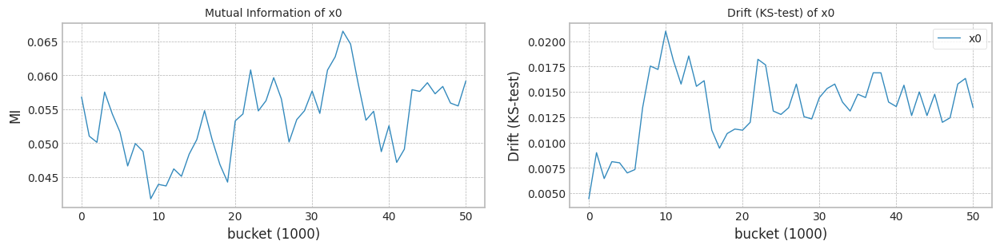

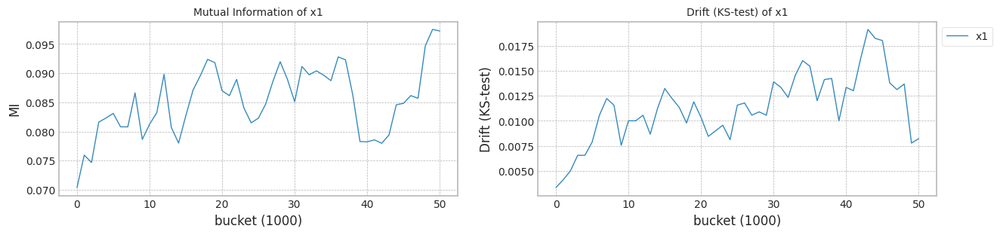

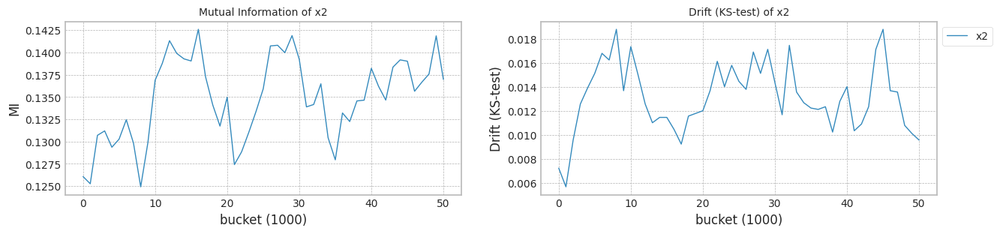

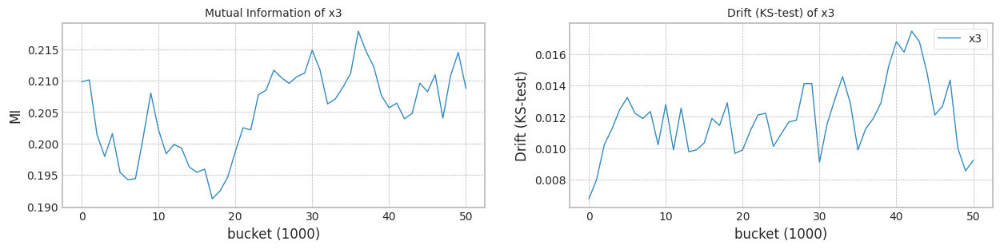

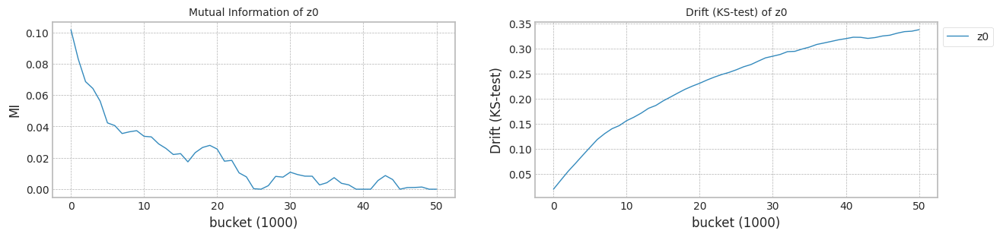

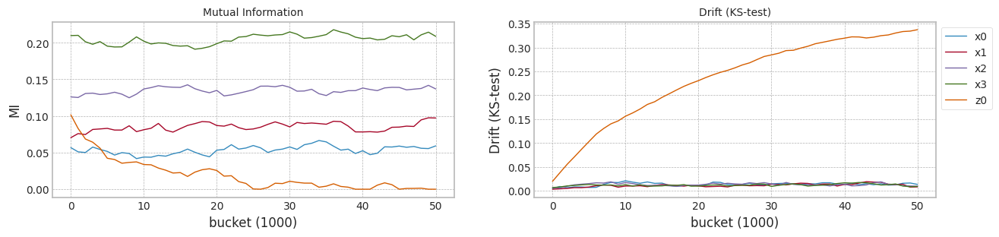

In [ ]:
columns=['x0','x1','x2','x3','z0']
X = pd.DataFrame(x,columns=columns)
Y = y

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X, Y,train_size, test_size)
#model,df = train_classificaion_model(X1,Y1,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.484659,0.586652,0.404131,0.578093,0.421766,0
1,0.642800,0.615744,0.450917,0.526770,0.529014,0
2,0.665316,0.751975,0.535797,0.191399,0.570549,0
3,0.426377,0.459274,0.304506,0.622063,0.396001,0
4,0.634133,0.507616,0.463434,0.520247,0.561748,0
...,...,...,...,...,...,...
59995,0.428835,0.731754,0.362543,0.750707,0.170510,59
59996,0.388504,0.163578,0.250745,0.650929,1.170890,59
59997,0.623148,0.528739,0.508383,0.646257,-0.984624,59
59998,0.427314,0.797644,0.544189,0.600597,1.585603,59


### Main 실험

trial_count: 1
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:22:27,064] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:04<00:05, 193.35it/s]

Early stop: 954
[2023-11-29 00:22:32,005] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:22:41,519] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 00:22:41,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:09, 166.15it/s]

[2023-11-29 00:22:52,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:22:52,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]


mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:23:06,498] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:23:06,500] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:23:15,907] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:23:15,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:14<00:51,  2.17s/it]

G-CDTL train flops: 3500000000 658000000 163560000 4321560000


100%|██████████| 51/51 [00:19<00:00,  2.68it/s]


Early stop at  [375]
Train flops  [4321560000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8384559184734368
G_CDTL+AUE median: 0.8384559184734368
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.34it/s]

Ensemble_SEA train flops: 392370000


100%|██████████| 51/51 [00:10<00:00,  4.85it/s]


Early stop at  [901]
Train flops  [392370000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7843945385102712
SEA median: 0.7843945385102712
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:06,  3.75it/s]

Ensemble_SEA train flops: 132675000


100%|██████████| 51/51 [00:09<00:00,  5.24it/s]


Early stop at  [304]
Train flops  [132675000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.812552295279879
AUE median: 0.812552295279879
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.37it/s]

Ensemble_DTEL train flops: 473715000


 53%|█████▎    | 27/51 [00:06<00:14,  1.70it/s]

Ensemble_DTEL train flops: 144855000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [1088, 332]
Train flops  [473715000, 144855000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8259821807647129
DTEL median: 0.8259821807647129


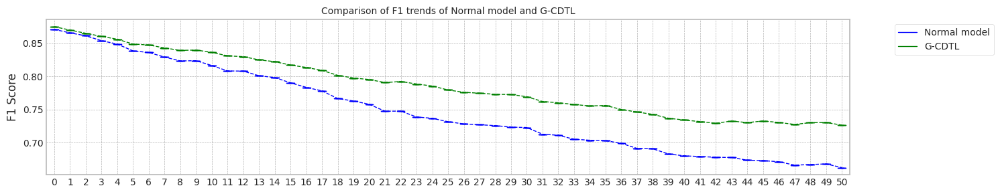

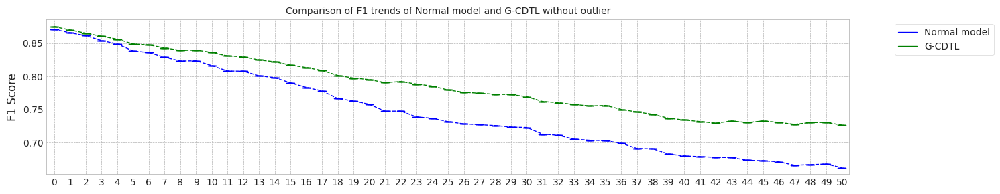

max_mean_trial= 0


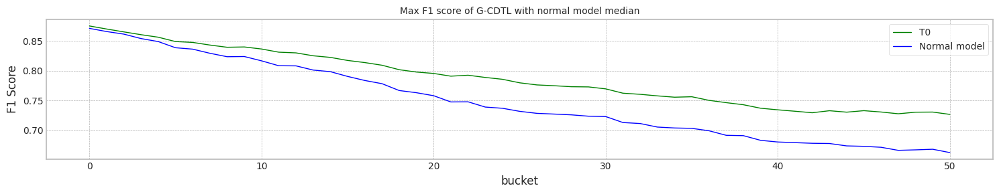

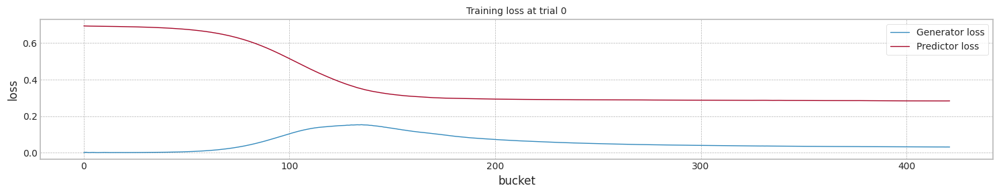

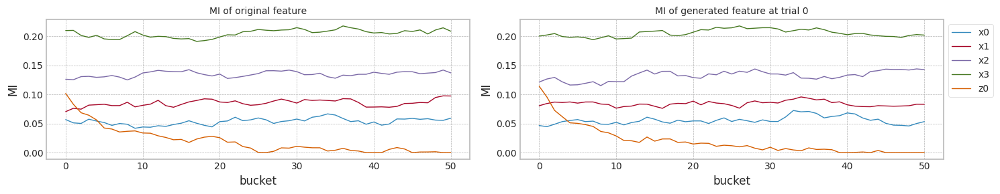

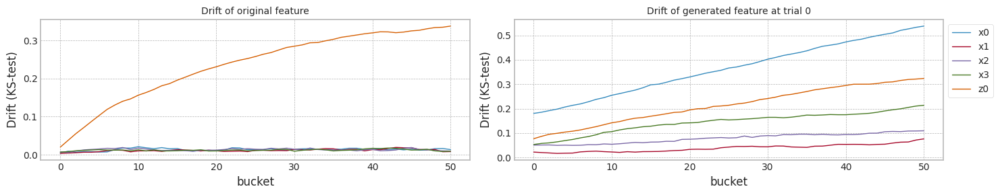

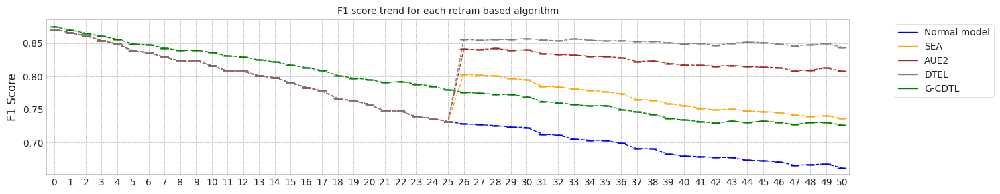

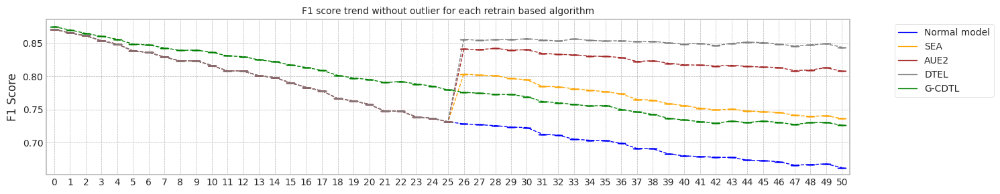

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.496105194091797
Base flops (inference flops of normal model, median): 199665000.0


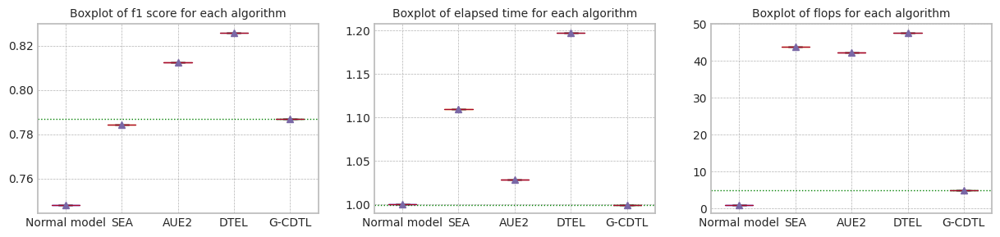

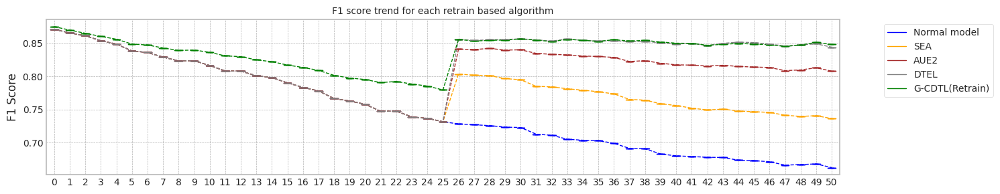

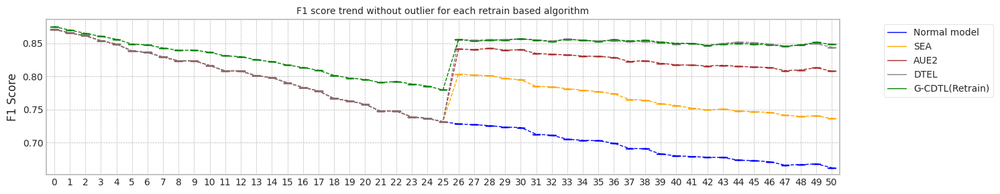

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.496105194091797
Base flops (train + inference flops of normal model, median): 3938490000.0


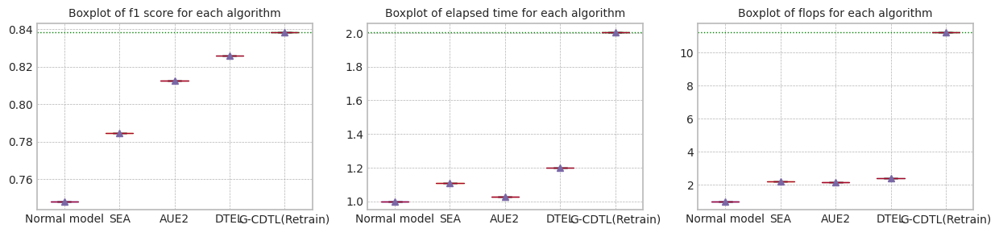

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.496105194091797


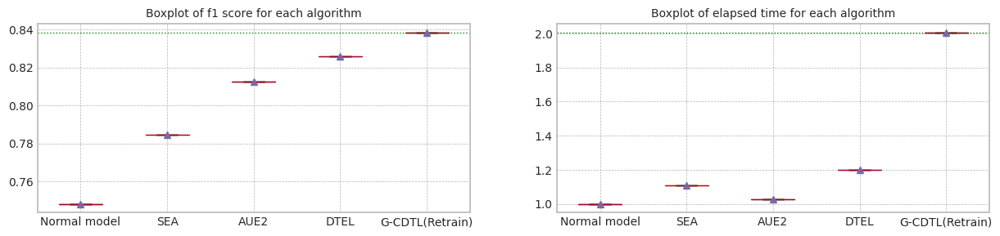

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.66242,9.496105,3.738825e+09,199665000.0,3.938490e+09
1,median,0.871099,0.865787,0.748116,0.66242,9.496105,3.738825e+09,199665000.0,3.938490e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.492044,3.979863e+10,1.002915e+09,4.080154e+10
1,median,0.875177,0.870029,0.786961,0.726602,9.492044,3.979863e+10,1.002915e+09,4.080154e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.784395,0.736534,10.538782,4.131195e+09,4.632315e+09,8.763510e+09
1,median,0.871099,0.865787,0.784395,0.736534,10.538782,4.131195e+09,4.632315e+09,8.763510e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.812552,0.80804,9.764093,3.871500e+09,4.572285e+09,8.443785e+09
1,median,0.871099,0.865787,0.812552,0.80804,9.764093,3.871500e+09,4.572285e+09,8.443785e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.825982,0.844212,11.37188,4.357395e+09,5.159970e+09,9.517365e+09
1,median,0.871099,0.865787,0.825982,0.844212,11.37188,4.357395e+09,5.159970e+09,9.517365e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.838456,0.848383,19.046748,4.412019e+10,223875000.0,4.434406e+10
1,median,0.875177,0.870029,0.838456,0.848383,19.046748,4.412019e+10,223875000.0,4.434406e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case1',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.8,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:26:56,059] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 431.98it/s]

Early stop: 954
[2023-11-29 00:26:58,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.23it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:27:08,079] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:27:08,082] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:09, 168.20it/s]

[2023-11-29 00:27:18,591] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:27:18,592] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.50it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:27:27,915] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:02, 508.49it/s]

Early stop: 512
[2023-11-29 00:27:28,928] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.50it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:27:38,253] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:27:38,256] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:02<00:09, 166.82it/s]

[2023-11-29 00:27:49,127] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:27:49,128] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:27:58,657] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:00<00:03, 496.53it/s]

Early stop: 447
[2023-11-29 00:27:59,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:28:09,072] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:28:09,074] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:02<00:09, 162.62it/s]

[2023-11-29 00:28:11,913] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:28:11,916] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:28:21,508] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:01<00:02, 498.23it/s]

Early stop: 845
[2023-11-29 00:28:23,209] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:28:32,702] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:28:32,705] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:02<00:09, 164.88it/s]

[2023-11-29 00:28:43,402] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:28:43,403] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:28:52,826] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:01<00:02, 487.69it/s]

Early stop: 866
[2023-11-29 00:28:54,607] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.58it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:29:03,797] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:29:03,799] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:09, 167.29it/s]

[2023-11-29 00:29:14,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:29:14,267] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:29:28,515] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:29:28,517] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:29:38,682] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:29:38,683] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:55,  2.32s/it]

G-CDTL train flops: 3500000000 780500000 194010000 4474510000


100%|██████████| 51/51 [00:19<00:00,  2.62it/s]


Early stop at  [445]
Train flops  [4474510000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8351966758056839
G_CDTL+AUE median: 0.8351966758056839
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.49it/s]

Ensemble_SEA train flops: 326250000


100%|██████████| 51/51 [00:10<00:00,  4.92it/s]


Early stop at  [749]
Train flops  [326250000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7845308120623182
SEA median: 0.7845308120623182
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.05it/s]

Ensemble_SEA train flops: 465450000


100%|██████████| 51/51 [00:10<00:00,  4.74it/s]


Early stop at  [1069]
Train flops  [465450000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8121651122948902
AUE median: 0.8121651122948902
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.41it/s]

Ensemble_DTEL train flops: 566805000


 53%|█████▎    | 27/51 [00:07<00:15,  1.53it/s]

Ensemble_DTEL train flops: 144855000


100%|██████████| 51/51 [00:11<00:00,  4.40it/s]


Early stop at  [1302, 332]
Train flops  [566805000, 144855000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8259821807647129
DTEL median: 0.8259821807647129
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.55it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:30:20,759] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:30:20,761] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:30:32,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:30:32,285] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:16<01:02,  2.60s/it]

G-CDTL train flops: 3500000000 1183000000 294060000 4977060000


100%|██████████| 51/51 [00:20<00:00,  2.45it/s]


Early stop at  [675]
Train flops  [4977060000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8343229669940749
G_CDTL+AUE median: 0.8347598213998795
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.51it/s]

Ensemble_SEA train flops: 723840000


100%|██████████| 51/51 [00:11<00:00,  4.38it/s]


Early stop at  [1663]
Train flops  [723840000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7806279098465843
SEA median: 0.7825793609544512
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:09,  2.48it/s]

Ensemble_SEA train flops: 303630000


100%|██████████| 51/51 [00:10<00:00,  4.84it/s]


Early stop at  [697]
Train flops  [303630000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8107047969365159
AUE median: 0.811434954615703
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.56it/s]

Ensemble_DTEL train flops: 441525000


 53%|█████▎    | 27/51 [00:07<00:15,  1.55it/s]

Ensemble_DTEL train flops: 251430000


100%|██████████| 51/51 [00:11<00:00,  4.43it/s]


Early stop at  [1014, 577]
Train flops  [441525000, 251430000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8263683913623626
DTEL median: 0.8261752860635377
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:31:15,434] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:31:15,436] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:31:24,989] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:31:24,990] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:14<00:52,  2.19s/it]

G-CDTL train flops: 3500000000 560000000 139200000 4199200000


100%|██████████| 51/51 [00:18<00:00,  2.71it/s]


Early stop at  [319]
Train flops  [4199200000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8511113700859121
G_CDTL+AUE median: 0.8351966758056839
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.63it/s]

Ensemble_SEA train flops: 281445000


100%|██████████| 51/51 [00:10<00:00,  4.96it/s]


Early stop at  [646]
Train flops  [281445000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7824498684759907
SEA median: 0.7824498684759907
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.21it/s]

Ensemble_SEA train flops: 411075000


100%|██████████| 51/51 [00:10<00:00,  4.80it/s]


Early stop at  [944]
Train flops  [411075000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8107645505263052
AUE median: 0.8107645505263052
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.40it/s]

Ensemble_DTEL train flops: 357570000


 53%|█████▎    | 27/51 [00:08<00:20,  1.16it/s]

Ensemble_DTEL train flops: 661200000


100%|██████████| 51/51 [00:12<00:00,  4.05it/s]


Early stop at  [821, 1519]
Train flops  [357570000, 661200000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8257259176096252
DTEL median: 0.8259821807647129
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:32:07,953] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:32:07,954] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:32:18,495] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:32:18,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.40s/it]

G-CDTL train flops: 3500000000 666750000 165735000 4332485000


100%|██████████| 51/51 [00:20<00:00,  2.54it/s]


Early stop at  [380]
Train flops  [4332485000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.839037727546247
G_CDTL+AUE median: 0.8371172016759654
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  1.86it/s]

Ensemble_SEA train flops: 529395000


100%|██████████| 51/51 [00:10<00:00,  4.64it/s]


Early stop at  [1216]
Train flops  [529395000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7916522165758585
SEA median: 0.7834903402691544
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:08,  2.71it/s]

Ensemble_SEA train flops: 265350000


100%|██████████| 51/51 [00:10<00:00,  5.00it/s]


Early stop at  [609]
Train flops  [265350000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8138307524660384
AUE median: 0.8114648314105977
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.59it/s]

Ensemble_DTEL train flops: 621615000


 53%|█████▎    | 27/51 [00:08<00:21,  1.14it/s]

Ensemble_DTEL train flops: 394545000


100%|██████████| 51/51 [00:12<00:00,  4.04it/s]


Early stop at  [1428, 906]
Train flops  [621615000, 394545000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8258786649785693
DTEL median: 0.8259304228716411
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:33:01,911] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:33:01,913] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:33:11,764] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:33:11,765] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:14<00:54,  2.25s/it]

G-CDTL train flops: 3500000000 602000000 149640000 4251640000


100%|██████████| 51/51 [00:19<00:00,  2.65it/s]


Early stop at  [343]
Train flops  [4251640000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8362723179200645
G_CDTL+AUE median: 0.8362723179200645
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.51it/s]

Ensemble_SEA train flops: 306675000


100%|██████████| 51/51 [00:10<00:00,  4.93it/s]


Early stop at  [704]
Train flops  [306675000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7816697022421403
SEA median: 0.7824498684759907
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.01it/s]

Ensemble_SEA train flops: 466755000


100%|██████████| 51/51 [00:10<00:00,  4.72it/s]


Early stop at  [1072]
Train flops  [466755000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8135988390738379
AUE median: 0.8121651122948902
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.59it/s]

Ensemble_DTEL train flops: 350610000


 53%|█████▎    | 27/51 [00:06<00:15,  1.59it/s]

Ensemble_DTEL train flops: 335385000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [805, 770]
Train flops  [350610000, 335385000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8248745136768104
DTEL median: 0.8258786649785693


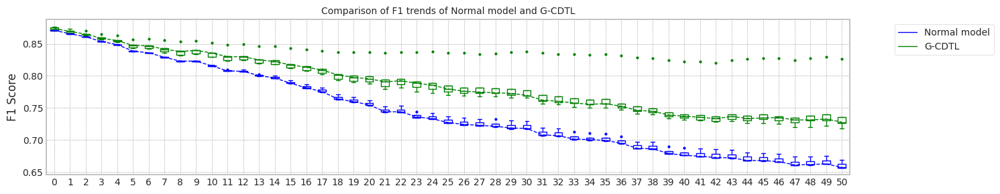

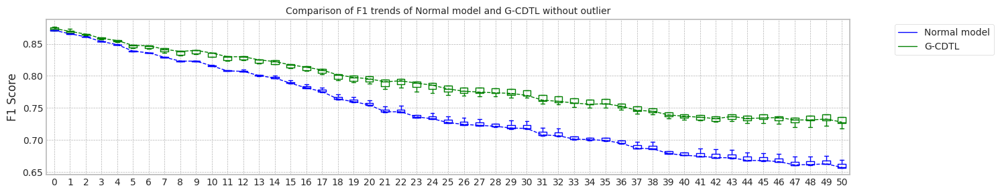

max_mean_trial= 2


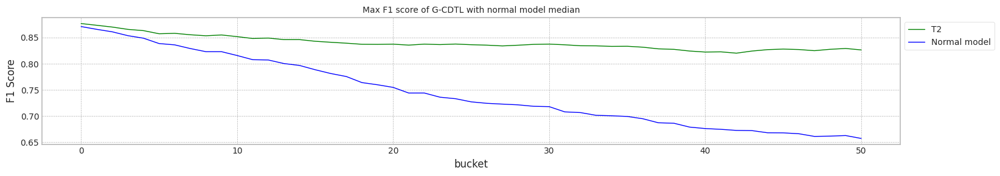

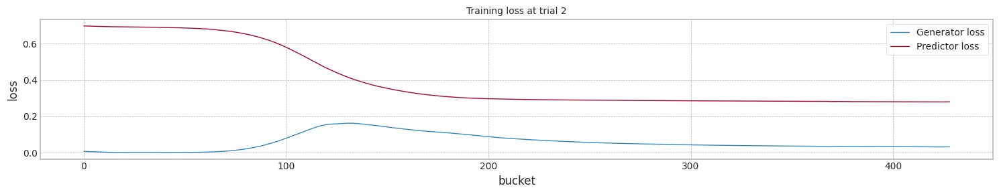

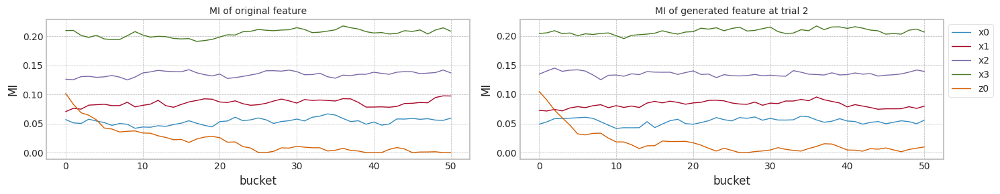

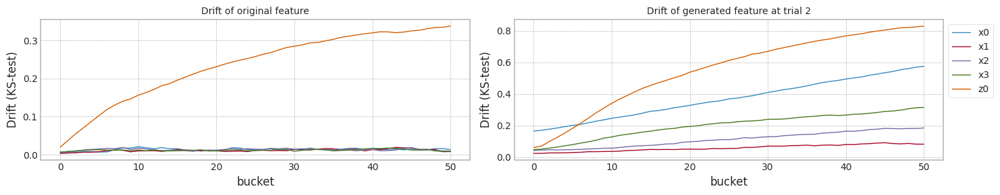

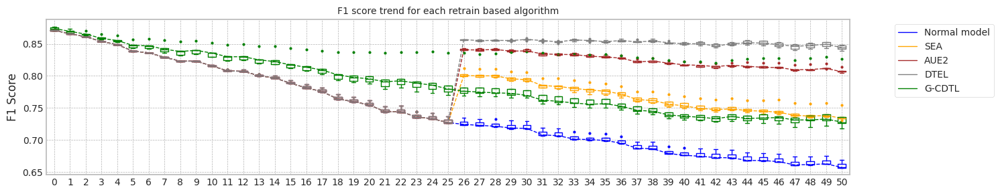

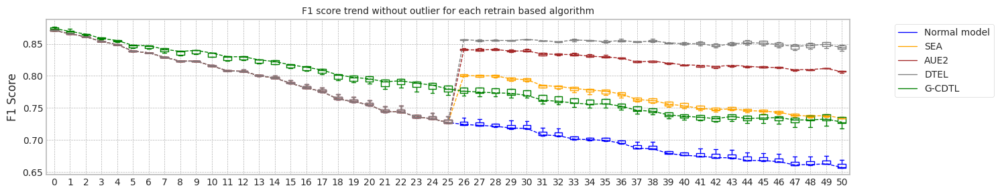

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.478688716888428
Base flops (inference flops of normal model, median): 199665000.0


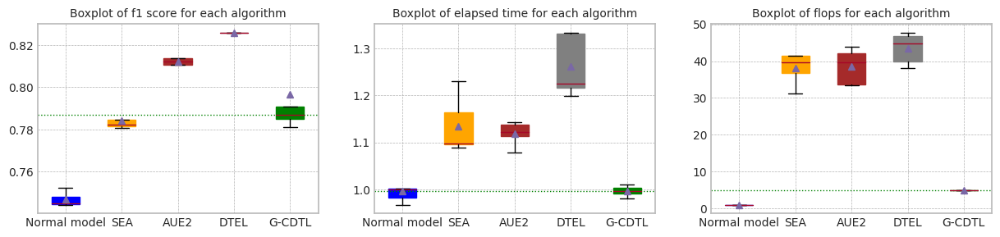

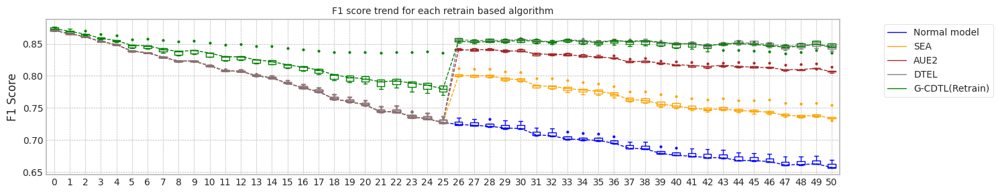

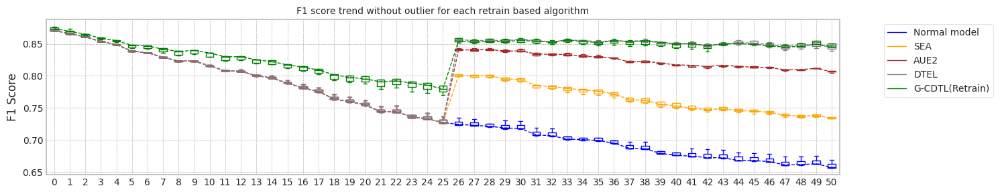

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.478688716888428
Base flops (train + inference flops of normal model, median): 3511755000.0


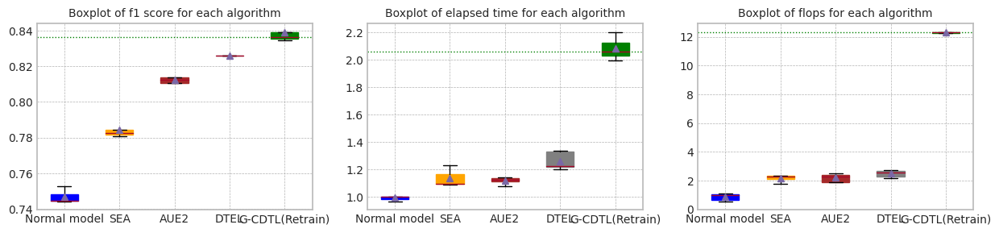

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.478688716888428


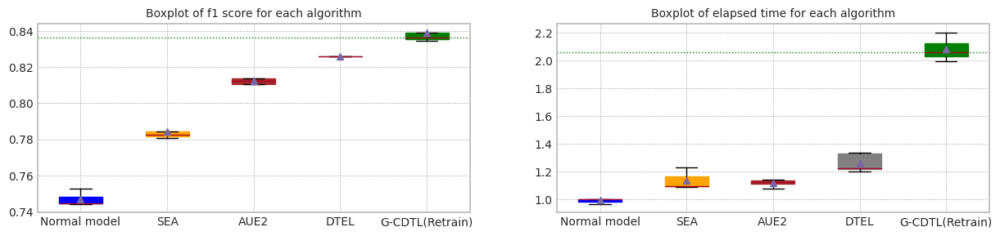

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.784363,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.308354,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.489740,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.478689,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.173087,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.478689,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.229617,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.304532,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.511760,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.573554,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.403723,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.453609,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.453609,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.102949,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.784531,0.735413,10.401523,3.720555e+09,4.566195e+09,8.286750e+09
1,1.0,0.871143,0.866126,0.780628,0.730893,11.668683,4.118145e+09,3.233355e+09,7.351500e+09
2,2.0,0.870401,0.865446,0.782450,0.734048,10.317592,3.675750e+09,2.536485e+09,6.212235e+09
3,3.0,0.871195,0.865883,0.791652,0.754496,11.026484,3.923700e+09,4.342605e+09,8.266305e+09
4,4.0,0.870160,0.865308,0.781670,0.733615,10.381996,3.700980e+09,4.202100e+09,7.903080e+09
5,median,0.871099,0.865787,0.782450,0.734048,10.401523,3.720555e+09,4.202100e+09,7.903080e+09
6,std,0.000483,0.000332,0.004412,0.009536,0.583916,1.898691e+08,8.599232e+08,8.653049e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.812165,0.805137,10.789419,3.859755e+09,4.905060e+09,8.764815e+09
1,1.0,0.871143,0.866126,0.810705,0.807757,10.555290,3.697935e+09,3.012810e+09,6.710745e+09
2,2.0,0.870401,0.865446,0.810765,0.806538,10.643610,3.805380e+09,2.865780e+09,6.671160e+09
3,3.0,0.871195,0.865883,0.813831,0.806351,10.219802,3.659655e+09,4.278225e+09,7.937880e+09
4,4.0,0.870160,0.865308,0.813599,0.814189,10.832704,3.861060e+09,4.561845e+09,8.422905e+09
5,median,0.871099,0.865787,0.812165,0.806538,10.643610,3.805380e+09,4.278225e+09,7.937880e+09
6,std,0.000483,0.000332,0.001493,0.003585,0.244002,9.319432e+07,9.280213e+08,9.682633e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.825982,0.844212,11.613583,4.105965e+09,5.253060e+09,9.359025e+09
1,1.0,0.871143,0.866126,0.826368,0.848445,11.533910,4.087260e+09,3.503925e+09,7.591185e+09
2,2.0,0.870401,0.865446,0.825726,0.847439,12.626434,4.413075e+09,3.575265e+09,7.988340e+09
3,3.0,0.871195,0.865883,0.825879,0.839612,12.642336,4.410465e+09,5.130825e+09,9.541290e+09
4,4.0,0.870160,0.865308,0.824875,0.841897,11.371492,4.080300e+09,4.882875e+09,8.963175e+09
5,median,0.871099,0.865787,0.825879,0.844212,11.613583,4.105965e+09,4.882875e+09,8.963175e+09
6,std,0.000483,0.000332,0.000552,0.003701,0.624016,1.758502e+08,8.593874e+08,8.582868e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.835197,0.836124,19.490259,4.313257e+10,223875000.0,4.335644e+10
1,1.0,0.873993,0.869518,0.834323,0.850318,20.869698,4.363512e+10,223875000.0,4.385900e+10
2,2.0,0.876834,0.873531,0.851111,0.850994,18.873484,4.285726e+10,223875000.0,4.308114e+10
3,3.0,0.871205,0.866786,0.839038,0.845728,20.104961,4.299054e+10,223875000.0,4.321442e+10
4,4.0,0.871522,0.867111,0.836272,0.845807,19.243783,4.290970e+10,223875000.0,4.313358e+10
5,median,0.873993,0.869518,0.836272,0.845807,19.490259,4.299054e+10,223875000.0,4.321442e+10
6,std,0.002400,0.002718,0.006897,0.005937,0.785189,3.140081e+08,0.0,3.140081e+08


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:34:03,938] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 471.15it/s]

Early stop: 954
[2023-11-29 00:34:05,969] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:34:15,395] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:34:15,398] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:09, 158.31it/s]

[2023-11-29 00:34:26,552] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:34:26,553] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:34:36,068] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 486.75it/s]

Early stop: 512
[2023-11-29 00:34:37,125] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:34:46,593] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:34:46,595] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:03<00:09, 155.32it/s]

[2023-11-29 00:34:58,212] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:34:58,213] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:35:07,692] [INFO] [profiler.py:80:start_profile] Flops profiler started


 22%|██▏       | 447/2000 [00:00<00:03, 472.98it/s]

Early stop: 447
[2023-11-29 00:35:08,645] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:35:18,109] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:35:18,111] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:02<00:09, 157.92it/s]

[2023-11-29 00:35:21,035] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:35:21,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:35:30,434] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:01<00:02, 482.42it/s]

Early stop: 845
[2023-11-29 00:35:32,191] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:35:41,581] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:35:41,585] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:02<00:10, 152.94it/s]

[2023-11-29 00:35:52,957] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:35:52,958] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:36:02,501] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:01<00:02, 464.17it/s]

Early stop: 866
[2023-11-29 00:36:04,374] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:36:13,858] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:36:13,861] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:10, 156.53it/s]

[2023-11-29 00:36:24,868] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:36:24,869] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:36:37,685] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:36:37,687] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:36:48,072] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:36:48,074] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:13<01:15,  2.37s/it]

G-CDTL train flops: 3500000000 656250000 163125000 4319375000


 69%|██████▊   | 35/51 [00:16<00:03,  5.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:36:51,402] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:36:51,405] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:37:01,980] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:37:01,981] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:27<00:33,  2.41s/it]

G-CDTL train flops: 3500000000 715750000 177915000 4393665000


100%|██████████| 51/51 [00:30<00:00,  1.68it/s]


Early stop at  [374, 408]
Train flops  [4319375000, 4393665000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8476911555967124
G_CDTL+AUE median: 0.8476911555967124
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:13,  2.41it/s]

Ensemble_SEA train flops: 312765000


 73%|███████▎  | 37/51 [00:09<00:05,  2.34it/s]

Ensemble_SEA train flops: 353655000


100%|██████████| 51/51 [00:11<00:00,  4.35it/s]


Early stop at  [718, 812]
Train flops  [312765000, 353655000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8125398650492064
SEA median: 0.8125398650492064
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:17,  1.84it/s]

Ensemble_SEA train flops: 496770000


 73%|███████▎  | 37/51 [00:09<00:05,  2.58it/s]

Ensemble_SEA train flops: 282750000


100%|██████████| 51/51 [00:12<00:00,  4.20it/s]


Early stop at  [1141, 649]
Train flops  [496770000, 282750000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8369031436926275
AUE median: 0.8369031436926275
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.39it/s]

Ensemble_DTEL train flops: 196185000


 37%|███▋      | 19/51 [00:06<00:22,  1.41it/s]

Ensemble_DTEL train flops: 547665000


 69%|██████▊   | 35/51 [00:08<00:02,  5.48it/s]

Ensemble_DTEL train flops: 368445000


 73%|███████▎  | 37/51 [00:11<00:08,  1.66it/s]

Ensemble_DTEL train flops: 254910000


100%|██████████| 51/51 [00:13<00:00,  3.67it/s]


Early stop at  [450, 1258, 846, 585]
Train flops  [196185000, 547665000, 368445000, 254910000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8417129305693677
DTEL median: 0.8417129305693677
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:37:45,926] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:37:45,929] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:37:56,552] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:37:56,553] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:17,  2.42s/it]

G-CDTL train flops: 3500000000 738500000 183570000 4422070000


 69%|██████▊   | 35/51 [00:17<00:03,  5.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:37:59,856] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:37:59,859] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:38:13,141] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:38:13,142] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:30<00:41,  2.98s/it]

G-CDTL train flops: 3500000000 1433250000 356265000 5289515000


100%|██████████| 51/51 [00:33<00:00,  1.53it/s]


Early stop at  [421, 818]
Train flops  [4422070000, 5289515000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8474216883654604
G_CDTL+AUE median: 0.8475564219810864
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:12,  2.54it/s]

Ensemble_SEA train flops: 306240000


 73%|███████▎  | 37/51 [00:08<00:04,  2.87it/s]

Ensemble_SEA train flops: 239685000


100%|██████████| 51/51 [00:11<00:00,  4.61it/s]


Early stop at  [703, 550]
Train flops  [306240000, 239685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8106594732583834
SEA median: 0.8115996691537949
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:13,  2.45it/s]

Ensemble_SEA train flops: 315375000


 73%|███████▎  | 37/51 [00:09<00:07,  1.88it/s]

Ensemble_SEA train flops: 511995000


100%|██████████| 51/51 [00:12<00:00,  4.22it/s]


Early stop at  [724, 1176]
Train flops  [315375000, 511995000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8350174130245979
AUE median: 0.8359602783586126
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.40it/s]

Ensemble_DTEL train flops: 500250000


 37%|███▋      | 19/51 [00:05<00:20,  1.54it/s]

Ensemble_DTEL train flops: 149640000


 69%|██████▊   | 35/51 [00:08<00:02,  5.47it/s]

Ensemble_DTEL train flops: 411945000


 73%|███████▎  | 37/51 [00:11<00:09,  1.54it/s]

Ensemble_DTEL train flops: 271005000


100%|██████████| 51/51 [00:13<00:00,  3.70it/s]


Early stop at  [1149, 343, 946, 622]
Train flops  [500250000, 149640000, 411945000, 271005000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8424770595711707
DTEL median: 0.8420949950702692
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:38:56,450] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:38:56,452] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:39:07,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:39:07,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:21,  2.56s/it]

G-CDTL train flops: 3500000000 784000000 194880000 4478880000


 69%|██████▊   | 35/51 [00:17<00:03,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:39:11,070] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:39:11,073] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:39:21,830] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:39:21,831] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:28<00:34,  2.45s/it]

G-CDTL train flops: 3500000000 663250000 164865000 4328115000


100%|██████████| 51/51 [00:31<00:00,  1.62it/s]


Early stop at  [447, 378]
Train flops  [4478880000, 4328115000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8523018964868122
G_CDTL+AUE median: 0.8476911555967124
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:03<00:08,  3.63it/s]

Ensemble_SEA train flops: 136155000


 73%|███████▎  | 37/51 [00:08<00:05,  2.51it/s]

Ensemble_SEA train flops: 314940000


100%|██████████| 51/51 [00:10<00:00,  4.73it/s]


Early stop at  [312, 723]
Train flops  [136155000, 314940000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8117334355989994
SEA median: 0.8117334355989994
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:14,  2.23it/s]

Ensemble_SEA train flops: 393240000


 73%|███████▎  | 37/51 [00:09<00:05,  2.46it/s]

Ensemble_SEA train flops: 326250000


100%|██████████| 51/51 [00:11<00:00,  4.38it/s]


Early stop at  [903, 749]
Train flops  [393240000, 326250000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8337890918882465
AUE median: 0.8350174130245979
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.53it/s]

Ensemble_DTEL train flops: 286665000


 37%|███▋      | 19/51 [00:06<00:26,  1.21it/s]

Ensemble_DTEL train flops: 631620000


 69%|██████▊   | 35/51 [00:09<00:02,  5.48it/s]

Ensemble_DTEL train flops: 306240000


 73%|███████▎  | 37/51 [00:11<00:06,  2.04it/s]

Ensemble_DTEL train flops: 133545000


100%|██████████| 51/51 [00:13<00:00,  3.70it/s]


Early stop at  [658, 1451, 703, 306]
Train flops  [286665000, 631620000, 306240000, 133545000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8414057281007123
DTEL median: 0.8417129305693677
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:40:04,317] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:40:04,320] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:40:15,597] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:40:15,599] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:21,  2.56s/it]

G-CDTL train flops: 3500000000 775250000 192705000 4467955000


 69%|██████▊   | 35/51 [00:17<00:03,  5.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:40:18,936] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:40:18,938] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:40:29,537] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:40:29,539] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:28<00:50,  3.37s/it]

G-CDTL train flops: 3500000000 581000000 144420000 4225420000


100%|██████████| 51/51 [00:31<00:00,  1.62it/s]


Early stop at  [442, 331]
Train flops  [4467955000, 4225420000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8477415297746904
G_CDTL+AUE median: 0.8477163426857014
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:21,  1.49it/s]

Ensemble_SEA train flops: 685560000


 73%|███████▎  | 37/51 [00:10<00:05,  2.34it/s]

Ensemble_SEA train flops: 336255000


100%|██████████| 51/51 [00:12<00:00,  3.97it/s]


Early stop at  [1575, 772]
Train flops  [685560000, 336255000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8153099358100039
SEA median: 0.8121366503241029
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:03<00:09,  3.34it/s]

Ensemble_SEA train flops: 165735000


 73%|███████▎  | 37/51 [00:08<00:04,  2.85it/s]

Ensemble_SEA train flops: 229680000


100%|██████████| 51/51 [00:10<00:00,  4.75it/s]


Early stop at  [380, 527]
Train flops  [165735000, 229680000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8365477573644398
AUE median: 0.8357825851945189
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.54it/s]

Ensemble_DTEL train flops: 313200000


 37%|███▋      | 19/51 [00:05<00:19,  1.63it/s]

Ensemble_DTEL train flops: 315810000


 69%|██████▊   | 35/51 [00:08<00:02,  5.43it/s]

Ensemble_DTEL train flops: 453270000


 73%|███████▎  | 37/51 [00:11<00:08,  1.56it/s]

Ensemble_DTEL train flops: 200970000


100%|██████████| 51/51 [00:13<00:00,  3.75it/s]


Early stop at  [719, 725, 1041, 461]
Train flops  [313200000, 315810000, 453270000, 200970000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.842554307703604
DTEL median: 0.8420949950702692
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:41:13,068] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:41:13,070] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 00:41:24,274] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:41:24,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:14<01:57,  3.55s/it]

G-CDTL train flops: 3500000000 717500000 178350000 4395850000


 69%|██████▊   | 35/51 [00:17<00:03,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:41:27,659] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:41:27,661] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 00:41:38,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:41:38,286] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:28<00:33,  2.42s/it]

G-CDTL train flops: 3500000000 570500000 141810000 4212310000


100%|██████████| 51/51 [00:31<00:00,  1.63it/s]


Early stop at  [409, 325]
Train flops  [4395850000, 4212310000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8464207057514246
G_CDTL+AUE median: 0.8476911555967124
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:16,  1.95it/s]

Ensemble_SEA train flops: 457620000


 73%|███████▎  | 37/51 [00:09<00:05,  2.70it/s]

Ensemble_SEA train flops: 255345000


100%|██████████| 51/51 [00:11<00:00,  4.33it/s]


Early stop at  [1051, 586]
Train flops  [457620000, 255345000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8109926530008047
SEA median: 0.8117334355989994
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:18,  1.71it/s]

Ensemble_SEA train flops: 559410000


 73%|███████▎  | 37/51 [00:09<00:05,  2.36it/s]

Ensemble_SEA train flops: 330165000


100%|██████████| 51/51 [00:12<00:00,  4.09it/s]


Early stop at  [1285, 758]
Train flops  [559410000, 330165000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.835105262308877
AUE median: 0.835105262308877
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.45it/s]

Ensemble_DTEL train flops: 307545000


 37%|███▋      | 19/51 [00:05<00:18,  1.71it/s]

Ensemble_DTEL train flops: 254475000


 69%|██████▊   | 35/51 [00:08<00:02,  5.45it/s]

Ensemble_DTEL train flops: 453270000


 73%|███████▎  | 37/51 [00:10<00:09,  1.53it/s]

Ensemble_DTEL train flops: 177480000


100%|██████████| 51/51 [00:13<00:00,  3.78it/s]


Early stop at  [706, 584, 1041, 407]
Train flops  [307545000, 254475000, 453270000, 177480000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8418952714712358
DTEL median: 0.8418952714712358


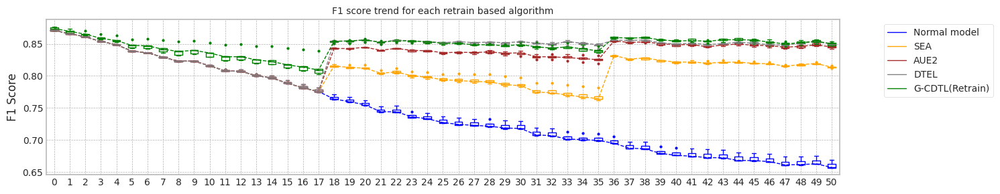

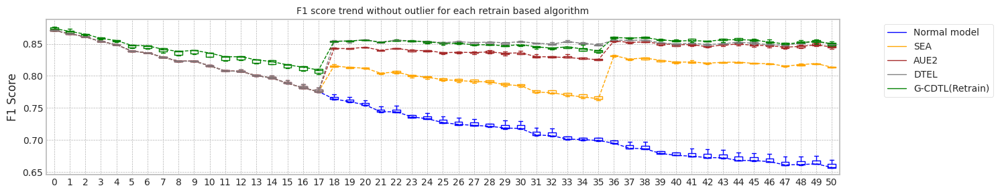

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.445964336395264
Base flops (train + inference flops of normal model, median): 3511755000.0


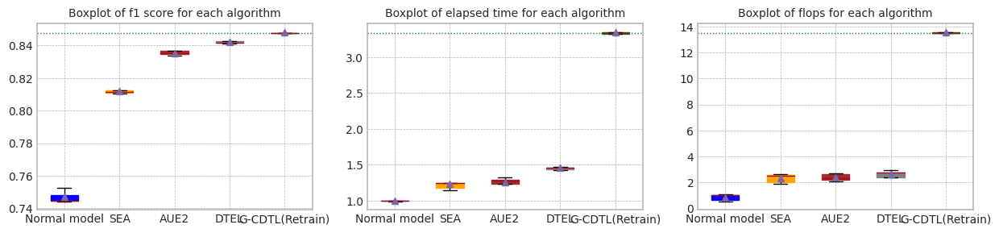

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.445964336395264


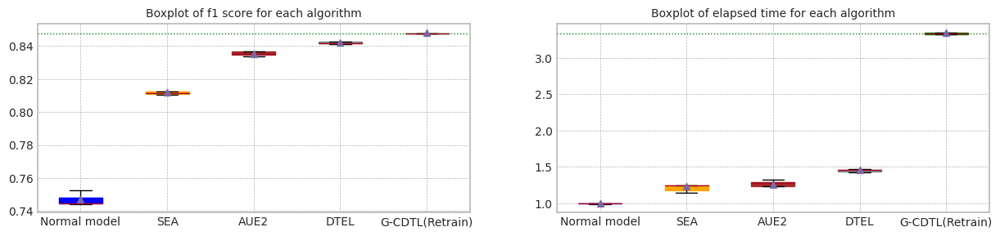

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.405427,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.451993,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.445964,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.374248,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.469006,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.445964,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.038632,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.495794,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.458178,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.377902,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.525948,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.468007,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.468007,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.055463,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.812540,0.813717,11.757145,4.060725e+09,4.996410e+09,9.057135e+09
1,1.0,0.871143,0.866126,0.810659,0.813628,11.109100,3.940230e+09,3.145485e+09,7.085715e+09
2,2.0,0.870401,0.865446,0.811733,0.815775,10.807336,3.845400e+09,2.796180e+09,6.641580e+09
3,3.0,0.871195,0.865883,0.815310,0.813486,12.885550,4.416120e+09,4.925070e+09,9.341190e+09
4,4.0,0.870160,0.865308,0.810993,0.812057,11.799075,4.107270e+09,4.698435e+09,8.805705e+09
5,median,0.871099,0.865787,0.811733,0.813628,11.757145,4.060725e+09,4.698435e+09,8.805705e+09
6,std,0.000483,0.000332,0.001859,0.001328,0.800094,2.170723e+08,1.055071e+09,1.232197e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.836903,0.848122,12.170761,4.173825e+09,5.309175e+09,9.483000e+09
1,1.0,0.871143,0.866126,0.835017,0.845171,12.112015,4.221675e+09,3.626595e+09,7.848270e+09
2,2.0,0.870401,0.865446,0.833789,0.841929,11.661683,4.113795e+09,3.264240e+09,7.378035e+09
3,3.0,0.871195,0.865883,0.836548,0.846907,10.770219,3.789720e+09,4.498335e+09,8.288055e+09
4,4.0,0.870160,0.865308,0.835105,0.843837,12.498256,4.283880e+09,5.074710e+09,9.358590e+09
5,median,0.871099,0.865787,0.835105,0.845171,12.112015,4.173825e+09,4.498335e+09,8.288055e+09
6,std,0.000483,0.000332,0.001263,0.002450,0.669494,1.931039e+08,8.901275e+08,9.257151e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.841713,0.848612,13.908240,4.761510e+09,5.712420e+09,1.047393e+10
1,1.0,0.871143,0.866126,0.842477,0.849678,13.802360,4.727145e+09,3.643560e+09,8.370705e+09
2,2.0,0.870401,0.865446,0.841406,0.852653,13.830315,4.752375e+09,3.627900e+09,8.380275e+09
3,3.0,0.871195,0.865883,0.842554,0.847594,13.630365,4.677555e+09,5.084715e+09,9.762270e+09
4,4.0,0.870160,0.865308,0.841895,0.849856,13.524569,4.587075e+09,5.082105e+09,9.669180e+09
5,median,0.871099,0.865787,0.841895,0.849678,13.802360,4.727145e+09,5.082105e+09,9.669180e+09
6,std,0.000483,0.000332,0.000495,0.001895,0.157144,7.161162e+07,9.434068e+08,9.263764e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.847691,0.847924,30.405516,4.737110e+10,134325000.0,4.750542e+10
1,1.0,0.873993,0.869518,0.847422,0.851384,33.409949,4.836964e+10,134325000.0,4.850397e+10
2,2.0,0.876834,0.873531,0.852302,0.845854,31.585816,4.746506e+10,134325000.0,4.759938e+10
3,3.0,0.871205,0.866786,0.847742,0.850134,31.482696,4.735144e+10,134325000.0,4.748576e+10
4,4.0,0.871522,0.867111,0.846421,0.853301,31.365964,4.726622e+10,134325000.0,4.740054e+10
5,median,0.873993,0.869518,0.847691,0.850134,31.482696,4.737110e+10,134325000.0,4.750542e+10
6,std,0.002400,0.002718,0.002291,0.002913,1.090751,4.554994e+08,0.0,4.554994e+08


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:42:24,314] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 453.01it/s]

Early stop: 954
[2023-11-29 00:42:26,426] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:42:35,937] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:42:35,939] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 421/2000 [00:02<00:10, 146.86it/s]

[2023-11-29 00:42:48,166] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:42:48,168] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:42:57,735] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 455.10it/s]

Early stop: 512
[2023-11-29 00:42:58,866] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.49it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:43:08,199] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:43:08,201] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:03<00:10, 149.31it/s]

[2023-11-29 00:43:20,654] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:43:20,656] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:43:30,113] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:00<00:03, 455.05it/s]

Early stop: 447
[2023-11-29 00:43:31,101] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:43:40,590] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:43:40,591] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:11, 137.47it/s]

[2023-11-29 00:43:43,934] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:43:43,935] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.29it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:43:53,626] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:01<00:02, 435.51it/s]

Early stop: 845
[2023-11-29 00:43:55,573] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:44:05,057] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:44:05,059] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:02<00:11, 141.43it/s]

[2023-11-29 00:44:17,378] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:44:17,379] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:44:26,748] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:01<00:02, 440.55it/s]

Early stop: 866
[2023-11-29 00:44:28,719] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.54it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:44:37,964] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:44:37,966] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:11, 148.53it/s]

[2023-11-29 00:44:49,657] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:44:49,658] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.48it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:45:01,534] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:45:01,537] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:45:12,663] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:45:12,664] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:13<01:33,  2.54s/it]

G-CDTL train flops: 3500000000 602000000 149640000 4251640000


 49%|████▉     | 25/51 [00:15<00:06,  4.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:45:15,071] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:45:15,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:45:26,331] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:45:26,332] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:27<01:29,  3.60s/it]

G-CDTL train flops: 3500000000 691250000 171825000 4363075000


 75%|███████▍  | 38/51 [00:29<00:02,  4.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:45:28,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:45:28,735] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:45:40,066] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:45:40,067] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:41<00:28,  2.59s/it]

G-CDTL train flops: 3500000000 659750000 163995000 4323745000


100%|██████████| 51/51 [00:43<00:00,  1.18it/s]


Early stop at  [343, 394, 376]
Train flops  [4251640000, 4363075000, 4323745000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8514157012046625
G_CDTL+AUE median: 0.8514157012046625
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:19,  1.87it/s]

Ensemble_SEA train flops: 482850000


 51%|█████     | 26/51 [00:08<00:20,  1.24it/s]

Ensemble_SEA train flops: 585075000


 78%|███████▊  | 40/51 [00:12<00:05,  2.18it/s]

Ensemble_SEA train flops: 369315000


100%|██████████| 51/51 [00:14<00:00,  3.54it/s]


Early stop at  [1109, 1344, 848]
Train flops  [482850000, 585075000, 369315000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.831663095880702
SEA median: 0.831663095880702
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:15,  2.31it/s]

Ensemble_SEA train flops: 336255000


 53%|█████▎    | 27/51 [00:07<00:10,  2.28it/s]

Ensemble_SEA train flops: 327555000


 78%|███████▊  | 40/51 [00:10<00:03,  2.98it/s]

Ensemble_SEA train flops: 203580000


100%|██████████| 51/51 [00:12<00:00,  4.09it/s]


Early stop at  [772, 752, 467]
Train flops  [336255000, 327555000, 203580000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8445945486472016
AUE median: 0.8445945486472016
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.57it/s]

Ensemble_DTEL train flops: 248385000


 27%|██▋       | 14/51 [00:05<00:30,  1.22it/s]

Ensemble_DTEL train flops: 615090000


 53%|█████▎    | 27/51 [00:09<00:11,  2.00it/s]

Ensemble_DTEL train flops: 411075000
Ensemble_DTEL train flops: 1305000


 75%|███████▍  | 38/51 [00:11<00:02,  5.39it/s]

Ensemble_DTEL train flops: 284925000


 78%|███████▊  | 40/51 [00:13<00:07,  1.57it/s]

Ensemble_DTEL train flops: 328425000


100%|██████████| 51/51 [00:15<00:00,  3.21it/s]


Early stop at  [570, 1413, 944, 2, 654, 754]
Train flops  [248385000, 615090000, 411075000, 1305000, 284925000, 328425000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8485406119502648
DTEL median: 0.8485406119502648
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:46:27,564] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:46:27,567] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:46:39,810] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:46:39,812] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:14<01:42,  2.77s/it]

G-CDTL train flops: 3500000000 836500000 207930000 4544430000


 49%|████▉     | 25/51 [00:16<00:06,  4.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:46:42,225] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:46:42,228] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:46:54,016] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:46:54,017] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:29<01:04,  2.69s/it]

G-CDTL train flops: 3500000000 729750000 181395000 4411145000


 75%|███████▍  | 38/51 [00:31<00:03,  4.14it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:46:56,511] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:46:56,513] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:47:08,160] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:47:08,162] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:43<00:29,  2.66s/it]

G-CDTL train flops: 3500000000 668500000 166170000 4334670000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [477, 416, 381]
Train flops  [4544430000, 4411145000, 4334670000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8502599133440142
G_CDTL+AUE median: 0.8508378072743383
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:14,  2.49it/s]

Ensemble_SEA train flops: 293625000


 53%|█████▎    | 27/51 [00:07<00:10,  2.25it/s]

Ensemble_SEA train flops: 347130000


 78%|███████▊  | 40/51 [00:11<00:05,  2.00it/s]

Ensemble_SEA train flops: 426300000


100%|██████████| 51/51 [00:13<00:00,  3.89it/s]


Early stop at  [674, 797, 979]
Train flops  [293625000, 347130000, 426300000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8306128405023752
SEA median: 0.8311379681915385
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:11,  3.22it/s]

Ensemble_SEA train flops: 181395000


 53%|█████▎    | 27/51 [00:07<00:12,  1.99it/s]

Ensemble_SEA train flops: 434565000


 78%|███████▊  | 40/51 [00:10<00:05,  2.04it/s]

Ensemble_SEA train flops: 413685000


100%|██████████| 51/51 [00:12<00:00,  3.95it/s]


Early stop at  [416, 998, 950]
Train flops  [181395000, 434565000, 413685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8452621991987659
AUE median: 0.8449283739229838
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.50it/s]

Ensemble_DTEL train flops: 481545000


 27%|██▋       | 14/51 [00:04<00:25,  1.44it/s]

Ensemble_DTEL train flops: 203580000


 53%|█████▎    | 27/51 [00:08<00:08,  2.95it/s]

Ensemble_DTEL train flops: 202710000
Ensemble_DTEL train flops: 1305000


 75%|███████▍  | 38/51 [00:10<00:02,  5.48it/s]

Ensemble_DTEL train flops: 327555000


 78%|███████▊  | 40/51 [00:12<00:06,  1.65it/s]

Ensemble_DTEL train flops: 250560000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [1106, 467, 465, 2, 752, 575]
Train flops  [481545000, 203580000, 202710000, 1305000, 327555000, 250560000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.850147301452725
DTEL median: 0.8493439567014949
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:47:53,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:47:53,471] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:48:02,653] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:48:02,654] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:11<01:18,  2.13s/it]

G-CDTL train flops: 2476250000 694750000 172695000 3343695000


 49%|████▉     | 25/51 [00:13<00:05,  4.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:48:05,115] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:48:05,117] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:48:20,839] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:48:20,840] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:29<01:24,  3.51s/it]

G-CDTL train flops: 3500000000 1734250000 431085000 5665335000


 75%|███████▍  | 38/51 [00:31<00:03,  4.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:48:23,217] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:48:23,219] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:48:26,170] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:48:26,171] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:35<00:09,  1.19it/s]

G-CDTL train flops: 75250000 728000000 180960000 984210000


100%|██████████| 51/51 [00:37<00:00,  1.37it/s]


Early stop at  [396, 990, 415]
Train flops  [3343695000, 5665335000, 984210000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8531736881873212
G_CDTL+AUE median: 0.8514157012046625
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:16,  2.19it/s]

Ensemble_SEA train flops: 362790000


 53%|█████▎    | 27/51 [00:08<00:15,  1.56it/s]

Ensemble_SEA train flops: 619440000


 78%|███████▊  | 40/51 [00:12<00:05,  1.94it/s]

Ensemble_SEA train flops: 432825000


100%|██████████| 51/51 [00:14<00:00,  3.55it/s]


Early stop at  [833, 1423, 994]
Train flops  [362790000, 619440000, 432825000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8331065284825797
SEA median: 0.831663095880702
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:21,  1.69it/s]

Ensemble_SEA train flops: 533745000


 53%|█████▎    | 27/51 [00:08<00:12,  1.98it/s]

Ensemble_SEA train flops: 426735000


 78%|███████▊  | 40/51 [00:11<00:03,  2.77it/s]

Ensemble_SEA train flops: 236640000


100%|██████████| 51/51 [00:13<00:00,  3.73it/s]


Early stop at  [1226, 980, 543]
Train flops  [533745000, 426735000, 236640000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.844489334924601
AUE median: 0.8445945486472016
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.44it/s]

Ensemble_DTEL train flops: 248820000


 27%|██▋       | 14/51 [00:03<00:17,  2.10it/s]

Ensemble_DTEL train flops: 139635000


 53%|█████▎    | 27/51 [00:07<00:11,  2.04it/s]

Ensemble_DTEL train flops: 404115000
Ensemble_DTEL train flops: 1305000


 76%|███████▋  | 39/51 [00:11<00:07,  1.70it/s]

Ensemble_DTEL train flops: 369315000
Ensemble_DTEL train flops: 9570000


100%|██████████| 51/51 [00:13<00:00,  3.78it/s]


Early stop at  [571, 320, 928, 2, 848, 21]
Train flops  [248820000, 139635000, 404115000, 1305000, 369315000, 9570000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8499797773503147
DTEL median: 0.8499797773503147
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:49:12,467] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:49:12,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:49:19,698] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:49:19,699] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:09<01:03,  1.71s/it]

G-CDTL train flops: 1657250000 724500000 180090000 2561840000


 49%|████▉     | 25/51 [00:11<00:05,  4.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:49:22,085] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:49:22,088] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:49:33,818] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:49:33,819] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:23<01:03,  2.66s/it]

G-CDTL train flops: 3500000000 656250000 163125000 4319375000


 75%|███████▍  | 38/51 [00:26<00:03,  4.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:49:36,282] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:49:36,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:49:48,675] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:49:48,677] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:38<00:30,  2.82s/it]

G-CDTL train flops: 3500000000 752500000 187050000 4439550000


100%|██████████| 51/51 [00:40<00:00,  1.25it/s]


Early stop at  [413, 374, 429]
Train flops  [2561840000, 4319375000, 4439550000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8510332269452096
G_CDTL+AUE median: 0.851224464074936
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:28,  1.32it/s]

Ensemble_SEA train flops: 757770000


 53%|█████▎    | 27/51 [00:08<00:09,  2.52it/s]

Ensemble_SEA train flops: 277530000


 78%|███████▊  | 40/51 [00:12<00:05,  1.95it/s]

Ensemble_SEA train flops: 413685000


100%|██████████| 51/51 [00:14<00:00,  3.47it/s]


Early stop at  [1741, 637, 950]
Train flops  [757770000, 277530000, 413685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8319250872553073
SEA median: 0.8317940915680047
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.66it/s]

Ensemble_SEA train flops: 549405000


 53%|█████▎    | 27/51 [00:08<00:13,  1.72it/s]

Ensemble_SEA train flops: 524175000


 78%|███████▊  | 40/51 [00:12<00:05,  2.03it/s]

Ensemble_SEA train flops: 398895000


100%|██████████| 51/51 [00:14<00:00,  3.46it/s]


Early stop at  [1262, 1204, 916]
Train flops  [549405000, 524175000, 398895000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8444633602681811
AUE median: 0.8445419417859013
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.50it/s]

Ensemble_DTEL train flops: 152250000


 27%|██▋       | 14/51 [00:05<00:28,  1.31it/s]

Ensemble_DTEL train flops: 617700000


 49%|████▉     | 25/51 [00:07<00:05,  5.19it/s]

Ensemble_DTEL train flops: 411075000


 53%|█████▎    | 27/51 [00:10<00:16,  1.47it/s]

Ensemble_DTEL train flops: 224895000


 78%|███████▊  | 40/51 [00:13<00:04,  2.35it/s]

Ensemble_DTEL train flops: 311460000
Ensemble_DTEL train flops: 5220000


100%|██████████| 51/51 [00:15<00:00,  3.29it/s]


Early stop at  [349, 1419, 944, 516, 715, 11]
Train flops  [152250000, 617700000, 411075000, 224895000, 311460000, 5220000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8487555994631113
DTEL median: 0.849367688406713
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:50:38,329] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:50:38,331] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 00:50:48,900] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:50:48,901] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:13<01:29,  2.42s/it]

G-CDTL train flops: 2957500000 642250000 159645000 3759395000


 49%|████▉     | 25/51 [00:15<00:05,  4.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:50:51,323] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:50:51,325] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 00:51:04,117] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:51:04,118] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:28<01:09,  2.89s/it]

G-CDTL train flops: 3500000000 873250000 217065000 4590315000


 75%|███████▍  | 38/51 [00:30<00:03,  4.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:51:06,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:51:06,527] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 00:51:18,960] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:51:18,961] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:43<00:47,  3.96s/it]

G-CDTL train flops: 3500000000 729750000 181395000 4411145000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [366, 498, 416]
Train flops  [3759395000, 4590315000, 4411145000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8498606888900995
G_CDTL+AUE median: 0.8510332269452096
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:20,  1.84it/s]

Ensemble_SEA train flops: 461535000


 53%|█████▎    | 27/51 [00:07<00:08,  2.99it/s]

Ensemble_SEA train flops: 182265000


 78%|███████▊  | 40/51 [00:11<00:05,  2.06it/s]

Ensemble_SEA train flops: 384975000


100%|██████████| 51/51 [00:13<00:00,  3.85it/s]


Early stop at  [1060, 418, 884]
Train flops  [461535000, 182265000, 384975000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8317704644148978
SEA median: 0.8317704644148978
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:03<00:14,  2.53it/s]

Ensemble_SEA train flops: 256650000


 53%|█████▎    | 27/51 [00:07<00:11,  2.05it/s]

Ensemble_SEA train flops: 394545000


 78%|███████▊  | 40/51 [00:11<00:06,  1.73it/s]

Ensemble_SEA train flops: 497640000


100%|██████████| 51/51 [00:13<00:00,  3.70it/s]


Early stop at  [589, 906, 1143]
Train flops  [256650000, 394545000, 497640000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8454961921429325
AUE median: 0.8445945486472016
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.38it/s]

Ensemble_DTEL train flops: 338430000


 27%|██▋       | 14/51 [00:04<00:20,  1.77it/s]

Ensemble_DTEL train flops: 153120000


 53%|█████▎    | 27/51 [00:07<00:08,  2.74it/s]

Ensemble_DTEL train flops: 239685000
Ensemble_DTEL train flops: 1305000


 75%|███████▍  | 38/51 [00:09<00:02,  5.38it/s]

Ensemble_DTEL train flops: 303195000


 78%|███████▊  | 40/51 [00:12<00:06,  1.61it/s]

Ensemble_DTEL train flops: 262305000


100%|██████████| 51/51 [00:14<00:00,  3.63it/s]


Early stop at  [777, 351, 550, 2, 696, 602]
Train flops  [338430000, 153120000, 239685000, 1305000, 303195000, 262305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8494342500223349
DTEL median: 0.8494342500223349


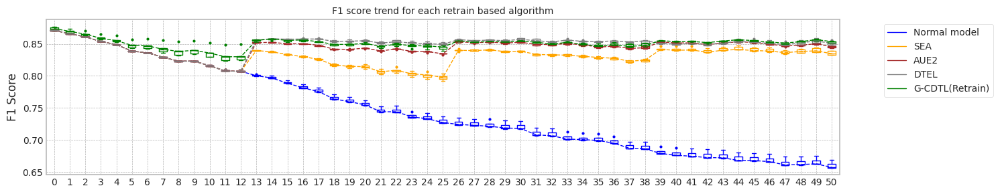

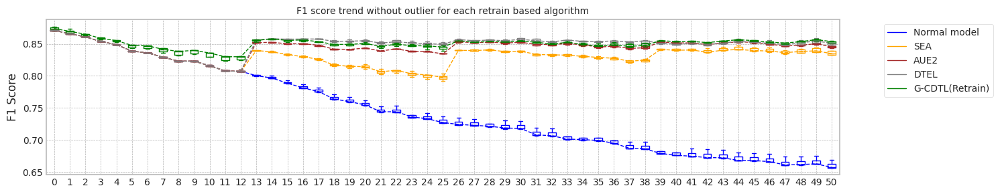

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.467994213104248
Base flops (train + inference flops of normal model, median): 3511755000.0


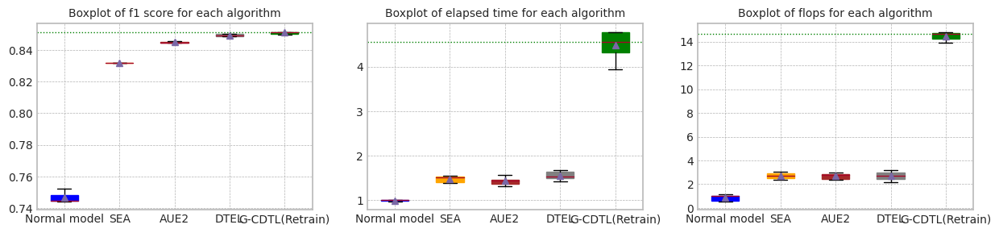

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.467994213104248


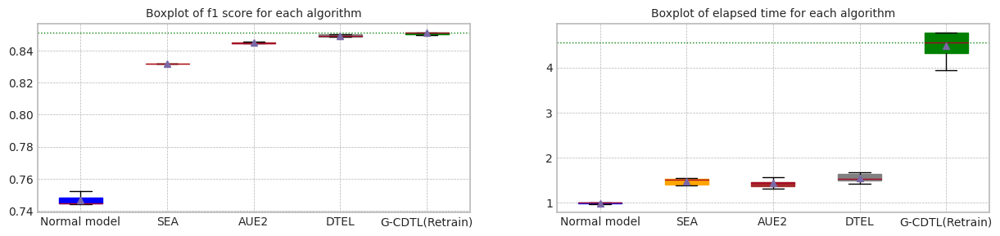

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.491998,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.317711,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.470433,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.467994,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.228281,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.467994,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.116399,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.547730,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.440235,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.672131,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.349451,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.457377,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.457377,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.122211,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.831663,0.834709,14.438992,4.831545e+09,5.872935e+09,1.070448e+10
1,1.0,0.871143,0.866126,0.830613,0.832686,13.157396,4.461360e+09,3.772320e+09,8.233680e+09
2,2.0,0.870401,0.865446,0.833107,0.839073,14.395852,4.809360e+09,3.865845e+09,8.675205e+09
3,3.0,0.871195,0.865883,0.831925,0.832494,14.728182,4.843290e+09,5.457945e+09,1.030124e+10
4,4.0,0.870160,0.865308,0.831770,0.838609,13.265890,4.423080e+09,5.119950e+09,9.543030e+09
5,median,0.871099,0.865787,0.831770,0.834709,14.395852,4.809360e+09,5.119950e+09,9.543030e+09
6,std,0.000483,0.000332,0.000887,0.003163,0.729473,2.121191e+08,9.504784e+08,1.046195e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.844595,0.845499,12.500778,4.261695e+09,5.502750e+09,9.764445e+09
1,1.0,0.871143,0.866126,0.845262,0.846933,12.953258,4.423950e+09,3.934575e+09,8.358525e+09
2,2.0,0.870401,0.865446,0.844489,0.844737,13.694158,4.591425e+09,3.847575e+09,8.439000e+09
3,3.0,0.871195,0.865883,0.844463,0.843767,14.764484,4.866780e+09,5.681100e+09,1.054788e+10
4,4.0,0.870160,0.865308,0.845496,0.848036,13.814770,4.543140e+09,5.439675e+09,9.982815e+09
5,median,0.871099,0.865787,0.844595,0.845499,13.694158,4.543140e+09,5.439675e+09,9.764445e+09
6,std,0.000483,0.000332,0.000483,0.001705,0.869299,2.237895e+08,9.086444e+08,9.742428e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.848541,0.848248,15.940299,5.283510e+09,5.771145e+09,1.105466e+10
1,1.0,0.871143,0.866126,0.850147,0.851467,14.515635,4.861560e+09,3.593970e+09,8.455530e+09
2,2.0,0.870401,0.865446,0.849980,0.856096,13.541503,4.567065e+09,3.076320e+09,7.643385e+09
3,3.0,0.871195,0.865883,0.848756,0.850644,15.522104,5.116905e+09,5.273940e+09,1.039084e+10
4,4.0,0.870160,0.865308,0.849434,0.848451,14.098168,4.692345e+09,4.916805e+09,9.609150e+09
5,median,0.871099,0.865787,0.849434,0.850644,14.515635,4.861560e+09,4.916805e+09,9.609150e+09
6,std,0.000483,0.000332,0.000715,0.003177,0.993696,2.955842e+08,1.143764e+09,1.390720e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.851416,0.851640,43.148538,5.159652e+10,107460000.0,5.170398e+10
1,1.0,0.873993,0.869518,0.850260,0.853537,45.263692,5.194830e+10,107460000.0,5.205576e+10
2,2.0,0.876834,0.873531,0.853174,0.850152,37.337957,4.865130e+10,107460000.0,4.875876e+10
3,3.0,0.871205,0.866786,0.851033,0.854855,40.892953,4.997882e+10,107460000.0,5.008628e+10
4,4.0,0.871522,0.867111,0.849861,0.854174,45.268224,5.141892e+10,107460000.0,5.152638e+10
5,median,0.873993,0.869518,0.851033,0.853537,43.148538,5.141892e+10,107460000.0,5.152638e+10
6,std,0.002400,0.002718,0.001288,0.001936,3.349688,1.377893e+09,0.0,1.377893e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 00:52:08,301] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 413.34it/s]

Early stop: 954
[2023-11-29 00:52:10,615] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:52:20,062] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:52:20,065] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 421/2000 [00:03<00:11, 134.92it/s]

[2023-11-29 00:52:33,187] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:52:33,189] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 00:52:42,577] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 408.28it/s]

Early stop: 512
[2023-11-29 00:52:43,838] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.48it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:52:53,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:52:53,195] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:03<00:11, 134.46it/s]

[2023-11-29 00:53:06,749] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:53:06,751] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 00:53:16,225] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:01<00:03, 415.55it/s]

Early stop: 447
[2023-11-29 00:53:17,307] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.45it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:53:26,707] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:53:26,709] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:11, 134.97it/s]

[2023-11-29 00:53:30,134] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:53:30,135] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 00:53:39,686] [INFO] [profiler.py:80:start_profile] Flops profiler started



 42%|████▏     | 845/2000 [00:02<00:02, 419.73it/s]

Early stop: 845
[2023-11-29 00:53:41,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:53:51,147] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:53:51,149] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:03<00:12, 132.61it/s]

[2023-11-29 00:54:04,366] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:54:04,368] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 00:54:13,803] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:02<00:02, 413.13it/s]

Early stop: 866
[2023-11-29 00:54:15,905] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 00:54:25,286] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:54:25,288] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:02<00:11, 136.95it/s]

[2023-11-29 00:54:38,083] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:54:38,085] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:54:49,621] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:54:49,624] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 00:55:02,240] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:02,241] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:14<01:52,  2.87s/it]

G-CDTL train flops: 3500000000 687750000 170955000 4358705000


 41%|████      | 21/51 [00:16<00:08,  3.41it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:55:04,306] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:55:04,308] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 00:55:17,518] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:17,519] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:30<01:24,  3.02s/it]

G-CDTL train flops: 3500000000 789250000 196185000 4485435000


 63%|██████▎   | 32/51 [00:31<00:05,  3.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:55:19,576] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:55:19,579] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 00:55:33,297] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:33,298] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:45<00:53,  3.12s/it]

G-CDTL train flops: 3500000000 946750000 235335000 4682085000


 84%|████████▍ | 43/51 [00:47<00:02,  3.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:55:35,342] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:55:35,345] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 00:55:48,256] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:55:48,258] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:00<00:29,  4.14s/it]

G-CDTL train flops: 3500000000 700000000 174000000 4374000000


100%|██████████| 51/51 [01:01<00:00,  1.22s/it]


Early stop at  [392, 450, 540, 399]
Train flops  [4358705000, 4485435000, 4682085000, 4374000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8521006075734281
G_CDTL+AUE median: 0.8521006075734281
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.93it/s]

Ensemble_SEA train flops: 402375000


 45%|████▌     | 23/51 [00:08<00:19,  1.45it/s]

Ensemble_SEA train flops: 639015000


 67%|██████▋   | 34/51 [00:11<00:07,  2.39it/s]

Ensemble_SEA train flops: 283185000


 88%|████████▊ | 45/51 [00:14<00:03,  1.91it/s]

Ensemble_SEA train flops: 408465000


100%|██████████| 51/51 [00:16<00:00,  3.17it/s]


Early stop at  [924, 1468, 650, 938]
Train flops  [402375000, 639015000, 283185000, 408465000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8337165712413391
SEA median: 0.8337165712413391
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.21it/s]

Ensemble_SEA train flops: 333645000


 45%|████▌     | 23/51 [00:06<00:12,  2.33it/s]

Ensemble_SEA train flops: 304065000


 67%|██████▋   | 34/51 [00:10<00:08,  2.05it/s]

Ensemble_SEA train flops: 367140000


 86%|████████▋ | 44/51 [00:12<00:03,  2.17it/s]

Ensemble_SEA train flops: 232290000


100%|██████████| 51/51 [00:14<00:00,  3.59it/s]


Early stop at  [766, 698, 843, 533]
Train flops  [333645000, 304065000, 367140000, 232290000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8456097901184714
AUE median: 0.8456097901184714
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.38it/s]

Ensemble_DTEL train flops: 263175000


 24%|██▎       | 12/51 [00:06<00:39,  1.01s/it]

Ensemble_DTEL train flops: 765165000


 41%|████      | 21/51 [00:07<00:06,  4.62it/s]

Ensemble_DTEL train flops: 311895000


 45%|████▌     | 23/51 [00:09<00:14,  1.92it/s]

Ensemble_DTEL train flops: 94395000


 63%|██████▎   | 32/51 [00:11<00:03,  4.96it/s]

Ensemble_DTEL train flops: 160515000


 67%|██████▋   | 34/51 [00:13<00:10,  1.56it/s]

Ensemble_DTEL train flops: 396285000


 84%|████████▍ | 43/51 [00:15<00:01,  4.99it/s]

Ensemble_DTEL train flops: 674250000


 88%|████████▊ | 45/51 [00:20<00:06,  1.10s/it]

Ensemble_DTEL train flops: 486330000


100%|██████████| 51/51 [00:21<00:00,  2.40it/s]


Early stop at  [604, 1758, 716, 216, 368, 910, 1549, 1117]
Train flops  [263175000, 765165000, 311895000, 94395000, 160515000, 396285000, 674250000, 486330000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8508561933975374
DTEL median: 0.8508561933975374
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:56:43,330] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:56:43,333] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 00:56:51,709] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:56:51,710] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:10<01:16,  1.97s/it]

G-CDTL train flops: 1828750000 715750000 177915000 2722415000


 41%|████      | 21/51 [00:12<00:08,  3.75it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:56:53,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:56:53,840] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 00:57:07,695] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:57:07,696] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:26<01:27,  3.14s/it]

G-CDTL train flops: 3500000000 887250000 220545000 4607795000


 63%|██████▎   | 32/51 [00:28<00:05,  3.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:57:09,773] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:57:09,776] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 00:57:13,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:57:13,315] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:32<00:16,  1.01it/s]

G-CDTL train flops: 75250000 789250000 196185000 1060685000


 84%|████████▍ | 43/51 [00:33<00:01,  4.62it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:57:15,359] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:57:15,361] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 00:57:29,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:57:29,446] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:48<00:18,  3.16s/it]

G-CDTL train flops: 3500000000 897750000 223155000 4620905000


100%|██████████| 51/51 [00:49<00:00,  1.03it/s]


Early stop at  [408, 506, 450, 512]
Train flops  [2722415000, 4607795000, 1060685000, 4620905000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8524378791473655
G_CDTL+AUE median: 0.8522692433603968
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.20it/s]

Ensemble_SEA train flops: 329730000


 45%|████▌     | 23/51 [00:07<00:16,  1.73it/s]

Ensemble_SEA train flops: 474150000


 67%|██████▋   | 34/51 [00:10<00:08,  1.90it/s]

Ensemble_SEA train flops: 417600000


 88%|████████▊ | 45/51 [00:13<00:02,  2.76it/s]

Ensemble_SEA train flops: 199665000


100%|██████████| 51/51 [00:14<00:00,  3.40it/s]


Early stop at  [757, 1089, 959, 458]
Train flops  [329730000, 474150000, 417600000, 199665000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8342836472958296
SEA median: 0.8340001092685844
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:20,  1.97it/s]

Ensemble_SEA train flops: 267090000


 45%|████▌     | 23/51 [00:07<00:18,  1.52it/s]

Ensemble_SEA train flops: 554625000


 67%|██████▋   | 34/51 [00:12<00:11,  1.47it/s]

Ensemble_SEA train flops: 603780000


 88%|████████▊ | 45/51 [00:14<00:02,  2.77it/s]

Ensemble_SEA train flops: 204885000


100%|██████████| 51/51 [00:15<00:00,  3.19it/s]


Early stop at  [613, 1274, 1387, 470]
Train flops  [267090000, 554625000, 603780000, 204885000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8458616956977419
AUE median: 0.8457357429081067
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.33it/s]

Ensemble_DTEL train flops: 277965000


 24%|██▎       | 12/51 [00:03<00:20,  1.93it/s]

Ensemble_DTEL train flops: 121800000


 41%|████      | 21/51 [00:05<00:05,  5.06it/s]

Ensemble_DTEL train flops: 528525000


 45%|████▌     | 23/51 [00:08<00:19,  1.42it/s]

Ensemble_DTEL train flops: 100485000


 63%|██████▎   | 32/51 [00:09<00:03,  4.98it/s]

Ensemble_DTEL train flops: 415860000


 67%|██████▋   | 34/51 [00:12<00:11,  1.43it/s]

Ensemble_DTEL train flops: 217065000


 84%|████████▍ | 43/51 [00:14<00:01,  4.85it/s]

Ensemble_DTEL train flops: 427170000


 88%|████████▊ | 45/51 [00:17<00:04,  1.34it/s]

Ensemble_DTEL train flops: 253170000


100%|██████████| 51/51 [00:18<00:00,  2.76it/s]


Early stop at  [638, 279, 1214, 230, 955, 498, 981, 581]
Train flops  [277965000, 121800000, 528525000, 100485000, 415860000, 217065000, 427170000, 253170000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8510205190205063
DTEL median: 0.8509383562090218
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.41it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:58:22,406] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:58:22,409] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 00:58:35,446] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:58:35,447] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:15<01:55,  2.97s/it]

G-CDTL train flops: 3500000000 677250000 168345000 4345595000


 41%|████      | 21/51 [00:16<00:08,  3.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:58:37,496] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:58:37,499] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 00:58:50,668] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:58:50,669] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:30<02:02,  4.22s/it]

G-CDTL train flops: 3500000000 721000000 179220000 4400220000


 63%|██████▎   | 32/51 [00:32<00:05,  3.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:58:52,702] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:58:52,704] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 00:59:07,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:59:07,364] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:47<00:56,  3.32s/it]

G-CDTL train flops: 3500000000 1072750000 266655000 4839405000


 84%|████████▍ | 43/51 [00:48<00:02,  3.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 00:59:09,407] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 00:59:09,411] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 00:59:24,627] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 00:59:24,629] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:04<00:33,  4.84s/it]

G-CDTL train flops: 3500000000 1156750000 287535000 4944285000


100%|██████████| 51/51 [01:05<00:00,  1.29s/it]


Early stop at  [386, 411, 612, 660]
Train flops  [4345595000, 4400220000, 4839405000, 4944285000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.855151078258567
G_CDTL+AUE median: 0.8524378791473655
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:15,  2.49it/s]

Ensemble_SEA train flops: 265350000


 45%|████▌     | 23/51 [00:06<00:11,  2.44it/s]

Ensemble_SEA train flops: 275355000


 67%|██████▋   | 34/51 [00:10<00:09,  1.85it/s]

Ensemble_SEA train flops: 432390000


 88%|████████▊ | 45/51 [00:13<00:02,  2.16it/s]

Ensemble_SEA train flops: 326685000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [609, 632, 993, 750]
Train flops  [265350000, 275355000, 432390000, 326685000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8342292967061502
SEA median: 0.8342292967061502
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:18,  2.07it/s]

Ensemble_SEA train flops: 369750000


 45%|████▌     | 23/51 [00:06<00:09,  3.01it/s]

Ensemble_SEA train flops: 177480000


 67%|██████▋   | 34/51 [00:10<00:09,  1.77it/s]

Ensemble_SEA train flops: 456750000


 88%|████████▊ | 45/51 [00:12<00:01,  3.24it/s]

Ensemble_SEA train flops: 135285000


100%|██████████| 51/51 [00:13<00:00,  3.68it/s]


Early stop at  [849, 407, 1049, 310]
Train flops  [369750000, 177480000, 456750000, 135285000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8451678256033419
AUE median: 0.8456097901184714
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.59it/s]

Ensemble_DTEL train flops: 244905000


 24%|██▎       | 12/51 [00:03<00:21,  1.85it/s]

Ensemble_DTEL train flops: 192270000


 41%|████      | 21/51 [00:05<00:05,  5.13it/s]

Ensemble_DTEL train flops: 150510000


 45%|████▌     | 23/51 [00:06<00:10,  2.71it/s]

Ensemble_DTEL train flops: 70905000


 63%|██████▎   | 32/51 [00:08<00:03,  5.29it/s]

Ensemble_DTEL train flops: 296670000


 67%|██████▋   | 34/51 [00:10<00:10,  1.66it/s]

Ensemble_DTEL train flops: 207495000


 88%|████████▊ | 45/51 [00:13<00:02,  2.46it/s]

Ensemble_DTEL train flops: 267525000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:14<00:00,  3.44it/s]


Early stop at  [562, 441, 345, 162, 681, 476, 614, 2]
Train flops  [244905000, 192270000, 150510000, 70905000, 296670000, 207495000, 267525000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8510807457273186
DTEL median: 0.8510205190205063
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:11,232] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:11,234] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 01:00:20,584] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:00:20,585] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:11<01:24,  2.18s/it]

G-CDTL train flops: 2098250000 747250000 185745000 3031245000


 41%|████      | 21/51 [00:13<00:08,  3.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:22,645] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:22,648] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 01:00:34,026] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:00:34,027] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:24<01:13,  2.62s/it]

G-CDTL train flops: 3500000000 250250000 62205000 3812455000


 63%|██████▎   | 32/51 [00:26<00:05,  3.54it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:36,065] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:36,067] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 01:00:50,643] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:00:50,644] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:41<00:56,  3.30s/it]

G-CDTL train flops: 3500000000 999250000 248385000 4747635000


 84%|████████▍ | 43/51 [00:43<00:02,  3.14it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:00:52,726] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:00:52,728] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 01:01:06,096] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:01:06,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:57<00:18,  3.06s/it]

G-CDTL train flops: 3500000000 679000000 168780000 4347780000


100%|██████████| 51/51 [00:58<00:00,  1.14s/it]


Early stop at  [426, 142, 570, 387]
Train flops  [3031245000, 3812455000, 4747635000, 4347780000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.6694524677538314
G_CDTL+AUE median: 0.8522692433603968
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.90it/s]

Ensemble_SEA train flops: 401940000


 45%|████▌     | 23/51 [00:07<00:14,  1.92it/s]

Ensemble_SEA train flops: 401505000


 67%|██████▋   | 34/51 [00:10<00:08,  2.07it/s]

Ensemble_SEA train flops: 361050000


 88%|████████▊ | 45/51 [00:13<00:02,  2.36it/s]

Ensemble_SEA train flops: 279270000


100%|██████████| 51/51 [00:15<00:00,  3.39it/s]


Early stop at  [923, 922, 829, 641]
Train flops  [401940000, 401505000, 361050000, 279270000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8338981014739341
SEA median: 0.8340636990900421
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:15,  2.58it/s]

Ensemble_SEA train flops: 236205000


 45%|████▌     | 23/51 [00:06<00:09,  2.83it/s]

Ensemble_SEA train flops: 210105000


 67%|██████▋   | 34/51 [00:10<00:11,  1.53it/s]

Ensemble_SEA train flops: 576810000


 88%|████████▊ | 45/51 [00:12<00:01,  3.19it/s]

Ensemble_SEA train flops: 151380000


100%|██████████| 51/51 [00:14<00:00,  3.63it/s]


Early stop at  [542, 482, 1325, 347]
Train flops  [236205000, 210105000, 576810000, 151380000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8459400538429424
AUE median: 0.8457357429081067
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.38it/s]

Ensemble_DTEL train flops: 194880000


 24%|██▎       | 12/51 [00:04<00:27,  1.43it/s]

Ensemble_DTEL train flops: 421080000


 41%|████      | 21/51 [00:06<00:06,  4.92it/s]

Ensemble_DTEL train flops: 323205000


 45%|████▌     | 23/51 [00:08<00:18,  1.48it/s]

Ensemble_DTEL train flops: 258825000


 63%|██████▎   | 32/51 [00:10<00:03,  4.89it/s]

Ensemble_DTEL train flops: 254475000


 67%|██████▋   | 34/51 [00:12<00:09,  1.70it/s]

Ensemble_DTEL train flops: 224460000


 86%|████████▋ | 44/51 [00:16<00:04,  1.43it/s]

Ensemble_DTEL train flops: 438045000
Ensemble_DTEL train flops: 870000


100%|██████████| 51/51 [00:17<00:00,  2.87it/s]


Early stop at  [447, 967, 742, 594, 584, 515, 1006, 1]
Train flops  [194880000, 421080000, 323205000, 258825000, 254475000, 224460000, 438045000, 870000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8483455267371509
DTEL median: 0.8509383562090218
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.48it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:01:56,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:01:56,412] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 01:02:15,828] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:15,829] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:21<02:48,  4.32s/it]

G-CDTL train flops: 1972250000 3141250000 780825000 5894325000


 41%|████      | 21/51 [00:23<00:10,  2.83it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:02:17,893] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:02:17,895] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 01:02:21,202] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:21,203] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:27<00:27,  1.04it/s]

G-CDTL train flops: 70000000 703500000 174870000 948370000


 63%|██████▎   | 32/51 [00:28<00:04,  4.56it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:02:23,289] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:02:23,292] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 01:02:27,733] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:27,735] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:33<00:19,  1.14s/it]

G-CDTL train flops: 56000000 997500000 247950000 1301450000


 84%|████████▍ | 43/51 [00:35<00:01,  4.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:02:29,777] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:02:29,779] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 01:02:43,322] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:02:43,323] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:49<00:18,  3.05s/it]

G-CDTL train flops: 3500000000 707000000 175740000 4382740000


100%|██████████| 51/51 [00:50<00:00,  1.02it/s]


Early stop at  [1794, 401, 569, 403]
Train flops  [5894325000, 948370000, 1301450000, 4382740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8512191689878174
G_CDTL+AUE median: 0.8521006075734281
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:14,  2.76it/s]

Ensemble_SEA train flops: 212715000


 45%|████▌     | 23/51 [00:06<00:16,  1.74it/s]

Ensemble_SEA train flops: 468930000


 67%|██████▋   | 34/51 [00:09<00:05,  2.88it/s]

Ensemble_SEA train flops: 178350000


 88%|████████▊ | 45/51 [00:14<00:04,  1.33it/s]

Ensemble_SEA train flops: 675555000


100%|██████████| 51/51 [00:15<00:00,  3.29it/s]


Early stop at  [488, 1077, 409, 1552]
Train flops  [212715000, 468930000, 178350000, 675555000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8341320404524336
SEA median: 0.8341320404524336
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.26it/s]

Ensemble_SEA train flops: 306240000


 45%|████▌     | 23/51 [00:08<00:25,  1.09it/s]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:11<00:05,  2.89it/s]

Ensemble_SEA train flops: 173565000


 88%|████████▊ | 45/51 [00:14<00:02,  2.18it/s]

Ensemble_SEA train flops: 316680000


100%|██████████| 51/51 [00:16<00:00,  3.18it/s]


Early stop at  [703, 1999, 398, 727]
Train flops  [306240000, 870000000, 173565000, 316680000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8458176387859813
AUE median: 0.8458176387859813
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.50it/s]

Ensemble_DTEL train flops: 485025000


 24%|██▎       | 12/51 [00:07<00:48,  1.25s/it]

Ensemble_DTEL train flops: 772125000


 41%|████      | 21/51 [00:08<00:06,  4.29it/s]

Ensemble_DTEL train flops: 283620000


 45%|████▌     | 23/51 [00:11<00:18,  1.50it/s]

Ensemble_DTEL train flops: 267090000


 63%|██████▎   | 32/51 [00:13<00:04,  4.62it/s]

Ensemble_DTEL train flops: 163560000


 67%|██████▋   | 34/51 [00:15<00:09,  1.78it/s]

Ensemble_DTEL train flops: 265350000


 88%|████████▊ | 45/51 [00:18<00:03,  1.88it/s]

Ensemble_DTEL train flops: 394980000
Ensemble_DTEL train flops: 2610000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [1114, 1774, 651, 613, 375, 609, 907, 5]
Train flops  [485025000, 772125000, 283620000, 267090000, 163560000, 265350000, 394980000, 2610000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8475712307896631
DTEL median: 0.8508561933975374


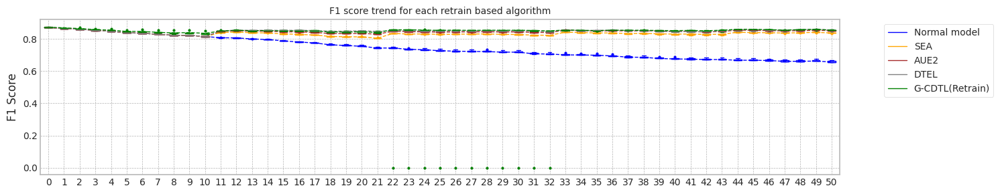

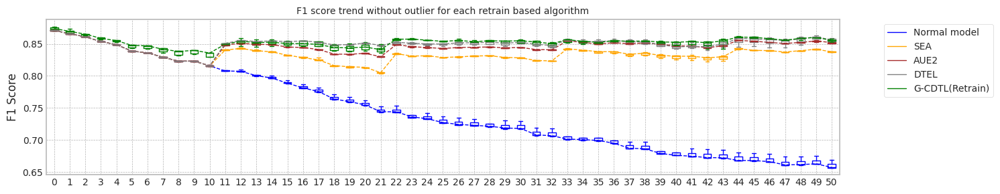

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.382378339767456
Base flops (train + inference flops of normal model, median): 3511755000.0


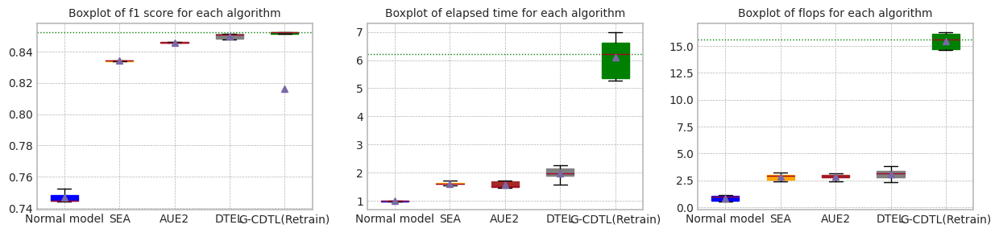

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.382378339767456


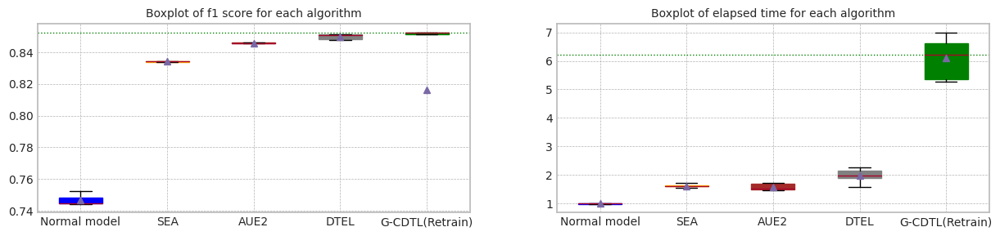

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.429904,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,9.337891,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.382378,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.422319,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.360212,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.382378,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.039490,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.369166,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.454248,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.527527,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.415712,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.477999,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.454248,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.060242,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.833717,0.837645,16.111356,5.127345e+09,6.243120e+09,1.137046e+10
1,1.0,0.871143,0.866126,0.834284,0.837225,15.021944,4.815450e+09,4.200795e+09,9.016245e+09
2,2.0,0.870401,0.865446,0.834229,0.840677,14.503303,4.694085e+09,3.824955e+09,8.519040e+09
3,3.0,0.871195,0.865883,0.833898,0.834921,15.089420,4.838070e+09,5.527110e+09,1.036518e+10
4,4.0,0.870160,0.865308,0.834132,0.837645,15.529429,4.929855e+09,5.701110e+09,1.063096e+10
5,median,0.871099,0.865787,0.834132,0.837645,15.089420,4.838070e+09,5.527110e+09,1.036518e+10
6,std,0.000483,0.000332,0.000239,0.002049,0.603192,1.613611e+08,1.034986e+09,1.179909e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.845610,0.852037,14.251846,4.631445e+09,5.946885e+09,1.057833e+10
1,1.0,0.871143,0.866126,0.845862,0.853077,16.005303,5.024685e+09,4.609695e+09,9.634380e+09
2,2.0,0.870401,0.865446,0.845168,0.850378,13.889686,4.533570e+09,3.864105e+09,8.397675e+09
3,3.0,0.871195,0.865883,0.845940,0.852343,14.075657,4.568805e+09,5.457510e+09,1.002632e+10
4,4.0,0.870160,0.865308,0.845818,0.851078,16.084855,5.060790e+09,6.031710e+09,1.109250e+10
5,median,0.871099,0.865787,0.845818,0.852037,14.251846,4.631445e+09,5.457510e+09,1.002632e+10
6,std,0.000483,0.000332,0.000311,0.001064,1.088408,2.572988e+08,9.283510e+08,1.026544e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.850856,0.859384,21.255866,6.546315e+09,6.957825e+09,1.350414e+10
1,1.0,0.871143,0.866126,0.851021,0.857390,18.519825,5.736345e+09,3.930660e+09,9.667005e+09
2,2.0,0.870401,0.865446,0.851081,0.856224,14.853479,4.825890e+09,3.295995e+09,8.121885e+09
3,3.0,0.871195,0.865883,0.848346,0.854209,17.783125,5.510145e+09,5.457945e+09,1.096809e+10
4,4.0,0.870160,0.865308,0.847571,0.848531,20.218942,6.028665e+09,5.899035e+09,1.192770e+10
5,median,0.871099,0.865787,0.850856,0.856224,18.519825,5.736345e+09,5.457945e+09,1.096809e+10
6,std,0.000483,0.000332,0.001683,0.004147,2.467668,6.366634e+08,1.486568e+09,2.065259e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.852101,0.857924,62.027931,5.655828e+10,62685000.0,5.662097e+10
1,1.0,0.873993,0.869518,0.852438,0.852964,49.525696,5.166986e+10,62685000.0,5.173254e+10
2,2.0,0.876834,0.873531,0.855151,0.854536,65.642722,5.718756e+10,62685000.0,5.725025e+10
3,3.0,0.871205,0.866786,0.669452,0.856291,58.198673,5.459718e+10,62685000.0,5.465986e+10
4,4.0,0.871522,0.867111,0.851219,0.855514,50.264929,5.118494e+10,62685000.0,5.124763e+10
5,median,0.873993,0.869518,0.852101,0.855514,58.198673,5.459718e+10,62685000.0,5.465986e+10
6,std,0.002400,0.002718,0.081976,0.001861,7.116053,2.744501e+09,0.0,2.744501e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:03:42,517] [INFO] [profiler.py:80:start_profile] Flops profiler started


 48%|████▊     | 954/2000 [00:02<00:02, 373.73it/s]

Early stop: 954
[2023-11-29 01:03:45,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3738825000
precision_recall_fscore: (array([0.87213483, 0.86813187]), array([0.86610132, 0.87408719]), array([0.8691076 , 0.87109935]), array([4481, 4519]))
Test f1 score: 0.8710993494321314
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.748115708205009
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:03:54,495] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:03:54,497] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 421/2000 [00:03<00:13, 121.16it/s]

[2023-11-29 01:04:09,294] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:04:09,296] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6646500000 1652130000 39798630000
precision_recall_fscore: (array([0.88498845, 0.86102784]), array([0.85516626, 0.88979863]), array([0.86982181, 0.87517684]), array([4481, 4519]))
Test f1 score: 0.8751768418761563
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.363004
x1    0.038632
x2    0.078501
x3    0.143767
z0    0.214192
dtype: float64
Mean F1 for all data: 0.7869609599889986
inference_flops: 1002915000
Normal model median        : 0.748115708205009
Drift tolerant model median: 0.7869609599889986
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:04:18,853] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 512/2000 [00:01<00:03, 381.09it/s]

Early stop: 512
[2023-11-29 01:04:20,203] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2008395000
precision_recall_fscore: (array([0.87025458, 0.8708536 ]), array([0.86967195, 0.87143173]), array([0.86996317, 0.87114257]), array([4481, 4519]))
Test f1 score: 0.8711425727242562
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7443596555751765
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:04:30,278] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:04:30,280] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▎       | 470/2000 [00:04<00:13, 115.01it/s]

[2023-11-29 01:04:45,745] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:04:45,746] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7418250000 1843965000 40762215000
precision_recall_fscore: (array([0.88380688, 0.85977307]), array([0.85382727, 0.88869219]), array([0.86855846, 0.87399347]), array([4481, 4519]))
Test f1 score: 0.873993471164309
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.125068
x1    0.075181
x2    0.063754
x3    0.201869
z0    0.266760
dtype: float64
Mean F1 for all data: 0.7812187855861649
inference_flops: 1002915000
Normal model median        : 0.7462376818900927
Drift tolerant model median: 0.7840898727875818
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:04:55,363] [INFO] [profiler.py:80:start_profile] Flops profiler started



 22%|██▏       | 447/2000 [00:01<00:04, 322.27it/s]

Early stop: 447
[2023-11-29 01:04:56,759] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 1753920000
precision_recall_fscore: (array([0.870188  , 0.86915269]), array([0.86766347, 0.87165302]), array([0.8689239 , 0.87040106]), array([4481, 4519]))
Test f1 score: 0.8704010606562811
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.23it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7447960725604005
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:05:06,573] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 01:05:06,576] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 428/2000 [00:03<00:13, 117.19it/s]

[2023-11-29 01:05:10,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:05:10,547] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 740250000 6756750000 1679535000 9176535000
precision_recall_fscore: (array([0.8875    , 0.86175214]), array([0.85561259, 0.89245408]), array([0.87126463, 0.87683444]), array([4481, 4519]))
Test f1 score: 0.8768344385259268
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]


mean of drift:
x0    0.368813
x1    0.058041
x2    0.111946
x3    0.201253
z0    0.551983
dtype: float64
Mean F1 for all data: 0.8398465254795796
inference_flops: 1002915000
Normal model median        : 0.7447960725604005
Drift tolerant model median: 0.7869609599889986
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:05:20,154] [INFO] [profiler.py:80:start_profile] Flops profiler started


 42%|████▏     | 845/2000 [00:02<00:03, 373.63it/s]

Early stop: 845
[2023-11-29 01:05:22,422] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3312090000
precision_recall_fscore: (array([0.87216356, 0.86832271]), array([0.86632448, 0.87408719]), array([0.86923421, 0.87119541]), array([4481, 4519]))
Test f1 score: 0.8711954124393473
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.25it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.75255698873246
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:05:32,197] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:05:32,199] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|██        | 403/2000 [00:03<00:13, 114.25it/s]

[2023-11-29 01:05:47,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:05:47,315] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6363000000 1581660000 39444660000
precision_recall_fscore: (array([0.86488265, 0.87885611]), array([0.87993751, 0.86368666]), array([0.87234513, 0.87120536]), array([4481, 4519]))
Test f1 score: 0.8712053571428571
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.25it/s]

mean of drift:
x0    0.098601
x1    0.250993
x2    0.079617
x3    0.170085
z0    0.193878
dtype: float64
Mean F1 for all data: 0.7907378845106955
inference_flops: 1002915000
Normal model median        : 0.7464558903827048
Drift tolerant model median: 0.788849422249847
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:05:57,087] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 866/2000 [00:02<00:02, 380.50it/s]

Early stop: 866
[2023-11-29 01:05:59,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3394305000
precision_recall_fscore: (array([0.87090256, 0.86757589]), array([0.86565499, 0.87275946]), array([0.86827084, 0.87015996]), array([4481, 4519]))
Test f1 score: 0.8701599558742417
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.7448555072647985
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:06:08,749] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:06:08,751] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 363/2000 [00:03<00:13, 120.55it/s]

[2023-11-29 01:06:22,973] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:06:22,974] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5733000000 1425060000 38658060000
precision_recall_fscore: (array([0.86927523, 0.87316748]), array([0.87257309, 0.86988272]), array([0.87092104, 0.871522  ]), array([4481, 4519]))
Test f1 score: 0.8715220042123933
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.203229
x1    0.071983
x2    0.048983
x3    0.128353
z0    0.241815
dtype: float64
Mean F1 for all data: 0.7848658687647468
inference_flops: 1002915000
Normal model median        : 0.7448555072647985
Drift tolerant model median: 0.7869609599889986
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:06:34,244] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:06:34,246] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:06:47,563] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:06:47,564] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:14<03:02,  4.35s/it]

G-CDTL train flops: 3500000000 570500000 141810000 4212310000


 33%|███▎      | 17/51 [00:16<00:14,  2.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:06:49,251] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:06:49,253] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:07:03,244] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:03,245] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:30<01:43,  3.24s/it]

G-CDTL train flops: 3500000000 624750000 155295000 4280045000


 51%|█████     | 26/51 [00:32<00:10,  2.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:07:04,935] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:07:04,938] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:07:20,872] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:20,873] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:48<01:24,  3.66s/it]

G-CDTL train flops: 3500000000 1086750000 270135000 4856885000


 69%|██████▊   | 35/51 [00:49<00:07,  2.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:07:22,572] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:07:22,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:07:36,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:36,367] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:03<00:45,  3.23s/it]

G-CDTL train flops: 3500000000 588000000 146160000 4234160000


 86%|████████▋ | 44/51 [01:05<00:03,  2.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:07:38,039] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:07:38,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:07:54,563] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:07:54,564] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:22<00:18,  3.78s/it]

G-CDTL train flops: 3500000000 1204000000 299280000 5003280000


100%|██████████| 51/51 [01:23<00:00,  1.63s/it]


Early stop at  [325, 356, 620, 335, 687]
Train flops  [4212310000, 4280045000, 4856885000, 4234160000, 5003280000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8563609009195051
G_CDTL+AUE median: 0.8563609009195051
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:13,  3.00it/s]

Ensemble_SEA train flops: 173565000


 37%|███▋      | 19/51 [00:04<00:10,  2.93it/s]

Ensemble_SEA train flops: 169650000


 55%|█████▍    | 28/51 [00:06<00:04,  4.65it/s]

Ensemble_SEA train flops: 27840000


 73%|███████▎  | 37/51 [00:10<00:07,  1.82it/s]

Ensemble_SEA train flops: 426300000


 90%|█████████ | 46/51 [00:13<00:02,  1.71it/s]

Ensemble_SEA train flops: 445005000


100%|██████████| 51/51 [00:14<00:00,  3.51it/s]


Early stop at  [398, 389, 63, 979, 1022]
Train flops  [173565000, 169650000, 27840000, 426300000, 445005000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8309674950902607
SEA median: 0.8309674950902607
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:14,  2.81it/s]

Ensemble_SEA train flops: 197490000


 37%|███▋      | 19/51 [00:06<00:18,  1.72it/s]

Ensemble_SEA train flops: 458055000


 55%|█████▍    | 28/51 [00:09<00:10,  2.13it/s]

Ensemble_SEA train flops: 299715000


 73%|███████▎  | 37/51 [00:12<00:08,  1.61it/s]

Ensemble_SEA train flops: 491985000


 90%|█████████ | 46/51 [00:15<00:02,  1.97it/s]

Ensemble_SEA train flops: 354090000


100%|██████████| 51/51 [00:16<00:00,  3.02it/s]


Early stop at  [453, 1052, 688, 1130, 813]
Train flops  [197490000, 458055000, 299715000, 491985000, 354090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.850481206533659
AUE median: 0.850481206533659
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.52it/s]

Ensemble_DTEL train flops: 348870000


 20%|█▉        | 10/51 [00:05<00:41,  1.01s/it]

Ensemble_DTEL train flops: 579420000


 33%|███▎      | 17/51 [00:06<00:08,  4.04it/s]

Ensemble_DTEL train flops: 148335000


 37%|███▋      | 19/51 [00:09<00:18,  1.70it/s]

Ensemble_DTEL train flops: 291450000


 51%|█████     | 26/51 [00:10<00:05,  4.67it/s]

Ensemble_DTEL train flops: 449355000


 55%|█████▍    | 28/51 [00:13<00:17,  1.29it/s]

Ensemble_DTEL train flops: 234465000


 69%|██████▊   | 35/51 [00:14<00:03,  4.35it/s]

Ensemble_DTEL train flops: 563325000


 73%|███████▎  | 37/51 [00:18<00:11,  1.17it/s]

Ensemble_DTEL train flops: 180525000


 90%|█████████ | 46/51 [00:21<00:02,  1.87it/s]

Ensemble_DTEL train flops: 379320000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:22<00:00,  2.29it/s]


Early stop at  [801, 1331, 340, 669, 1032, 538, 1294, 414, 871, 2]
Train flops  [348870000, 579420000, 148335000, 291450000, 449355000, 234465000, 563325000, 180525000, 379320000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8541822350867064
DTEL median: 0.8541822350867064
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:08:51,188] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:08:51,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:09:06,288] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:06,289] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:16<02:21,  3.45s/it]

G-CDTL train flops: 3500000000 861000000 214020000 4575020000


 33%|███▎      | 17/51 [00:18<00:15,  2.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:07,996] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:07,999] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:09:22,838] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:22,839] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:33<01:49,  3.44s/it]

G-CDTL train flops: 3500000000 813750000 202275000 4516025000


 51%|█████     | 26/51 [00:34<00:11,  2.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:24,538] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:24,540] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:09:38,535] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:38,537] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:49<01:14,  3.26s/it]

G-CDTL train flops: 3500000000 619500000 153990000 4273490000


 69%|██████▊   | 35/51 [00:50<00:06,  2.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:40,191] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:40,194] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:09:54,676] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:09:54,677] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:05<00:46,  3.35s/it]

G-CDTL train flops: 3500000000 668500000 166170000 4334670000


 86%|████████▋ | 44/51 [01:06<00:03,  2.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:09:56,330] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:09:56,332] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:10:10,809] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:10:10,810] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:21<00:16,  3.35s/it]

G-CDTL train flops: 3500000000 687750000 170955000 4358705000


100%|██████████| 51/51 [01:22<00:00,  1.62s/it]


Early stop at  [491, 464, 353, 381, 392]
Train flops  [4575020000, 4516025000, 4273490000, 4334670000, 4358705000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8558009917872595
G_CDTL+AUE median: 0.8560809463533823
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:20,  1.98it/s]

Ensemble_SEA train flops: 361485000


 37%|███▋      | 19/51 [00:05<00:12,  2.52it/s]

Ensemble_SEA train flops: 226635000


 55%|█████▍    | 28/51 [00:09<00:15,  1.52it/s]

Ensemble_SEA train flops: 522870000


 73%|███████▎  | 37/51 [00:13<00:08,  1.71it/s]

Ensemble_SEA train flops: 438915000


 90%|█████████ | 46/51 [00:16<00:02,  1.78it/s]

Ensemble_SEA train flops: 411075000


100%|██████████| 51/51 [00:17<00:00,  2.90it/s]


Early stop at  [830, 520, 1201, 1008, 944]
Train flops  [361485000, 226635000, 522870000, 438915000, 411075000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8364100827346044
SEA median: 0.8336887889124325
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:21,  1.93it/s]

Ensemble_SEA train flops: 362790000


 37%|███▋      | 19/51 [00:06<00:18,  1.75it/s]

Ensemble_SEA train flops: 418035000


 55%|█████▍    | 28/51 [00:10<00:12,  1.89it/s]

Ensemble_SEA train flops: 380625000


 73%|███████▎  | 37/51 [00:13<00:07,  1.84it/s]

Ensemble_SEA train flops: 396720000


 88%|████████▊ | 45/51 [00:17<00:05,  1.02it/s]

Ensemble_SEA train flops: 605955000


100%|██████████| 51/51 [00:18<00:00,  2.75it/s]


Early stop at  [833, 960, 874, 911, 1392]
Train flops  [362790000, 418035000, 380625000, 396720000, 605955000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8491544334403346
AUE median: 0.8498178199869968
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.48it/s]

Ensemble_DTEL train flops: 180960000


 20%|█▉        | 10/51 [00:04<00:27,  1.48it/s]

Ensemble_DTEL train flops: 350610000


 33%|███▎      | 17/51 [00:05<00:07,  4.51it/s]

Ensemble_DTEL train flops: 559410000


 37%|███▋      | 19/51 [00:09<00:32,  1.02s/it]

Ensemble_DTEL train flops: 351045000


 51%|█████     | 26/51 [00:10<00:06,  4.02it/s]

Ensemble_DTEL train flops: 359745000


 55%|█████▍    | 28/51 [00:13<00:17,  1.28it/s]

Ensemble_DTEL train flops: 289275000


 69%|██████▊   | 35/51 [00:15<00:03,  4.33it/s]

Ensemble_DTEL train flops: 307110000


 73%|███████▎  | 37/51 [00:17<00:09,  1.53it/s]

Ensemble_DTEL train flops: 205755000


 90%|█████████ | 46/51 [00:21<00:03,  1.61it/s]

Ensemble_DTEL train flops: 478935000
Ensemble_DTEL train flops: 2610000


100%|██████████| 51/51 [00:22<00:00,  2.28it/s]


Early stop at  [415, 805, 1285, 806, 826, 664, 705, 472, 1100, 5]
Train flops  [180960000, 350610000, 559410000, 351045000, 359745000, 289275000, 307110000, 205755000, 478935000, 2610000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8514413104863829
DTEL median: 0.8528117727865447
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:11:12,186] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:11:12,189] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:11:27,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:11:27,498] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:17<02:23,  3.50s/it]

G-CDTL train flops: 3500000000 869750000 216195000 4585945000


 33%|███▎      | 17/51 [00:18<00:15,  2.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:11:29,155] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:11:29,157] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:11:43,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:11:43,628] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:33<01:47,  3.36s/it]

G-CDTL train flops: 3500000000 673750000 167475000 4341225000


 51%|█████     | 26/51 [00:34<00:11,  2.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:11:45,315] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:11:45,317] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:12:04,676] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:12:04,677] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:54<02:28,  6.18s/it]

G-CDTL train flops: 3500000000 1704500000 423690000 5628190000


 69%|██████▊   | 35/51 [00:55<00:08,  1.84it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:12:06,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:12:06,447] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:12:20,372] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:12:20,373] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:10<00:46,  3.29s/it]

G-CDTL train flops: 3500000000 523250000 130065000 4153315000


 86%|████████▋ | 44/51 [01:11<00:03,  2.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:12:22,046] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:12:22,048] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:12:37,023] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:12:37,024] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:26<00:29,  4.86s/it]

G-CDTL train flops: 3500000000 708750000 176175000 4384925000


100%|██████████| 51/51 [01:27<00:00,  1.72s/it]


Early stop at  [496, 384, 973, 298, 404]
Train flops  [4585945000, 4341225000, 5628190000, 4153315000, 4384925000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8570060470476926
G_CDTL+AUE median: 0.8563609009195051
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:13,  3.00it/s]

Ensemble_SEA train flops: 166605000


 37%|███▋      | 19/51 [00:05<00:11,  2.73it/s]

Ensemble_SEA train flops: 204015000


 55%|█████▍    | 28/51 [00:08<00:11,  2.07it/s]

Ensemble_SEA train flops: 317115000


 73%|███████▎  | 37/51 [00:10<00:05,  2.50it/s]

Ensemble_SEA train flops: 231855000


 90%|█████████ | 46/51 [00:13<00:02,  2.32it/s]

Ensemble_SEA train flops: 266655000


100%|██████████| 51/51 [00:14<00:00,  3.54it/s]


Early stop at  [382, 468, 728, 532, 612]
Train flops  [166605000, 204015000, 317115000, 231855000, 266655000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8401103222164639
SEA median: 0.8364100827346044
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:26,  1.55it/s]

Ensemble_SEA train flops: 501990000


 37%|███▋      | 19/51 [00:07<00:18,  1.69it/s]

Ensemble_SEA train flops: 435870000


 55%|█████▍    | 28/51 [00:09<00:07,  3.01it/s]

Ensemble_SEA train flops: 151380000


 73%|███████▎  | 37/51 [00:15<00:13,  1.03it/s]

Ensemble_SEA train flops: 870000000


 90%|█████████ | 46/51 [00:18<00:02,  1.82it/s]

Ensemble_SEA train flops: 368880000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [1153, 1001, 347, 1999, 847]
Train flops  [501990000, 435870000, 151380000, 870000000, 368880000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8494629915238375
AUE median: 0.8494629915238375
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.42it/s]

Ensemble_DTEL train flops: 1740000


 20%|█▉        | 10/51 [00:02<00:17,  2.32it/s]

Ensemble_DTEL train flops: 266655000


 33%|███▎      | 17/51 [00:04<00:06,  4.95it/s]

Ensemble_DTEL train flops: 663375000


 37%|███▋      | 19/51 [00:08<00:30,  1.05it/s]

Ensemble_DTEL train flops: 195315000


 55%|█████▍    | 28/51 [00:11<00:12,  1.86it/s]

Ensemble_DTEL train flops: 362790000
Ensemble_DTEL train flops: 870000


 69%|██████▊   | 35/51 [00:12<00:03,  4.76it/s]

Ensemble_DTEL train flops: 306240000


 73%|███████▎  | 37/51 [00:15<00:08,  1.59it/s]

Ensemble_DTEL train flops: 174435000


 90%|█████████ | 46/51 [00:18<00:02,  1.85it/s]

Ensemble_DTEL train flops: 381495000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [3, 612, 1524, 448, 833, 1, 703, 400, 876, 2]
Train flops  [1740000, 266655000, 663375000, 195315000, 362790000, 870000, 306240000, 174435000, 381495000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8535932504986757
DTEL median: 0.8535932504986757
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:13:33,010] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:13:33,013] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:13:55,500] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:13:55,501] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:24<03:26,  5.05s/it]

G-CDTL train flops: 3500000000 2255750000 560715000 6316465000


 33%|███▎      | 17/51 [00:25<00:19,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:13:57,178] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:13:57,180] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:14:12,189] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:14:12,190] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:41<01:53,  3.54s/it]

G-CDTL train flops: 3500000000 715750000 177915000 4393665000


 51%|█████     | 26/51 [00:42<00:11,  2.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:14:13,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:14:13,868] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:14:28,154] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:14:28,156] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:56<01:16,  3.32s/it]

G-CDTL train flops: 3500000000 588000000 146160000 4234160000


 69%|██████▊   | 35/51 [00:58<00:07,  2.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:14:29,834] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:14:29,836] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:14:44,207] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:14:44,208] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:13<00:46,  3.33s/it]

G-CDTL train flops: 3500000000 575750000 143115000 4218865000


 86%|████████▋ | 44/51 [01:14<00:03,  2.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:14:45,912] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:14:45,914] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:15:13,692] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:15:13,693] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:42<00:52,  8.70s/it]

G-CDTL train flops: 3500000000 3361750000 835635000 7697385000


100%|██████████| 51/51 [01:43<00:00,  2.03s/it]


Early stop at  [1288, 408, 335, 328, 1920]
Train flops  [6316465000, 4393665000, 4234160000, 4218865000, 7697385000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8556357521435023
G_CDTL+AUE median: 0.8560809463533823
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.45it/s]

Ensemble_SEA train flops: 2175000


 37%|███▋      | 19/51 [00:04<00:12,  2.60it/s]

Ensemble_SEA train flops: 215760000


 55%|█████▍    | 28/51 [00:07<00:10,  2.12it/s]

Ensemble_SEA train flops: 313635000


 73%|███████▎  | 37/51 [00:10<00:06,  2.30it/s]

Ensemble_SEA train flops: 258825000


 90%|█████████ | 46/51 [00:13<00:02,  1.97it/s]

Ensemble_SEA train flops: 346695000


100%|██████████| 51/51 [00:14<00:00,  3.57it/s]


Early stop at  [4, 495, 720, 594, 796]
Train flops  [2175000, 215760000, 313635000, 258825000, 346695000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8295549289061398
SEA median: 0.8336887889124325
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:18,  2.27it/s]

Ensemble_SEA train flops: 274485000


 37%|███▋      | 19/51 [00:07<00:27,  1.17it/s]

Ensemble_SEA train flops: 746025000


 55%|█████▍    | 28/51 [00:10<00:11,  2.04it/s]

Ensemble_SEA train flops: 294930000


 73%|███████▎  | 37/51 [00:15<00:11,  1.23it/s]

Ensemble_SEA train flops: 703395000


 90%|█████████ | 46/51 [00:18<00:02,  1.80it/s]

Ensemble_SEA train flops: 391500000


100%|██████████| 51/51 [00:19<00:00,  2.59it/s]


Early stop at  [630, 1714, 677, 1616, 899]
Train flops  [274485000, 746025000, 294930000, 703395000, 391500000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8491364524234196
AUE median: 0.8493087124820861
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.59it/s]

Ensemble_DTEL train flops: 274050000


 20%|█▉        | 10/51 [00:04<00:31,  1.32it/s]

Ensemble_DTEL train flops: 325815000


 33%|███▎      | 17/51 [00:05<00:08,  4.18it/s]

Ensemble_DTEL train flops: 544620000


 37%|███▋      | 19/51 [00:10<00:32,  1.02s/it]

Ensemble_DTEL train flops: 343650000


 55%|█████▍    | 28/51 [00:13<00:14,  1.64it/s]

Ensemble_DTEL train flops: 454140000
Ensemble_DTEL train flops: 870000


 69%|██████▊   | 35/51 [00:14<00:03,  4.68it/s]

Ensemble_DTEL train flops: 438915000


 73%|███████▎  | 37/51 [00:17<00:11,  1.27it/s]

Ensemble_DTEL train flops: 219240000


 90%|█████████ | 46/51 [00:21<00:03,  1.60it/s]

Ensemble_DTEL train flops: 456315000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:22<00:00,  2.26it/s]


Early stop at  [629, 748, 1251, 789, 1043, 1, 1008, 503, 1048, 2]
Train flops  [274050000, 325815000, 544620000, 343650000, 454140000, 870000, 438915000, 219240000, 456315000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8531249679226638
DTEL median: 0.8533591092106698
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.48it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:13,112] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:13,114] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 01:16:22,779] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:16:22,781] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:11<01:33,  2.27s/it]

G-CDTL train flops: 1760500000 733250000 182265000 2676015000


 33%|███▎      | 17/51 [00:12<00:12,  2.83it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:24,456] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:24,458] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:16:39,506] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:16:39,507] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:28<01:49,  3.44s/it]

G-CDTL train flops: 3500000000 647500000 160950000 4308450000


 51%|█████     | 26/51 [00:29<00:11,  2.20it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:41,200] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:41,202] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 01:16:55,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:16:55,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:44<01:18,  3.41s/it]

G-CDTL train flops: 3500000000 581000000 144420000 4225420000


 69%|██████▊   | 35/51 [00:46<00:07,  2.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:16:57,647] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:16:57,650] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:17:05,508] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:17:05,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:54<00:27,  1.97s/it]

G-CDTL train flops: 75250000 1531250000 380625000 1987125000


 86%|████████▋ | 44/51 [00:55<00:02,  3.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:17:07,200] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:17:07,203] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 01:17:23,045] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:17:23,047] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:11<00:17,  3.59s/it]

G-CDTL train flops: 3500000000 803250000 199665000 4502915000


100%|██████████| 51/51 [01:12<00:00,  1.43s/it]


Early stop at  [418, 369, 331, 874, 458]
Train flops  [2676015000, 4308450000, 4225420000, 1987125000, 4502915000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8546457184839646
G_CDTL+AUE median: 0.8558009917872595
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:23,  1.73it/s]

Ensemble_SEA train flops: 412815000


 37%|███▋      | 19/51 [00:05<00:10,  2.96it/s]

Ensemble_SEA train flops: 155295000


 55%|█████▍    | 28/51 [00:09<00:11,  2.07it/s]

Ensemble_SEA train flops: 321465000


 71%|███████   | 36/51 [00:11<00:07,  2.03it/s]

Ensemble_SEA train flops: 216630000


 88%|████████▊ | 45/51 [00:15<00:05,  1.16it/s]

Ensemble_SEA train flops: 499380000


100%|██████████| 51/51 [00:16<00:00,  3.07it/s]


Early stop at  [948, 356, 738, 497, 1147]
Train flops  [412815000, 155295000, 321465000, 216630000, 499380000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8363818075551455
SEA median: 0.8363818075551455
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:26,  1.55it/s]

Ensemble_SEA train flops: 494160000


 37%|███▋      | 19/51 [00:06<00:13,  2.45it/s]

Ensemble_SEA train flops: 221850000


 55%|█████▍    | 28/51 [00:09<00:08,  2.78it/s]

Ensemble_SEA train flops: 180960000


 73%|███████▎  | 37/51 [00:12<00:08,  1.73it/s]

Ensemble_SEA train flops: 422385000


 90%|█████████ | 46/51 [00:15<00:02,  1.89it/s]

Ensemble_SEA train flops: 360180000


100%|██████████| 51/51 [00:16<00:00,  3.05it/s]


Early stop at  [1135, 509, 415, 970, 827]
Train flops  [494160000, 221850000, 180960000, 422385000, 360180000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8502490376422817
AUE median: 0.8494629915238375
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.51it/s]

Ensemble_DTEL train flops: 273180000


 20%|█▉        | 10/51 [00:03<00:23,  1.76it/s]

Ensemble_DTEL train flops: 140070000


 33%|███▎      | 17/51 [00:04<00:07,  4.64it/s]

Ensemble_DTEL train flops: 612045000


 37%|███▋      | 19/51 [00:08<00:31,  1.02it/s]

Ensemble_DTEL train flops: 241860000


 51%|█████     | 26/51 [00:10<00:06,  3.99it/s]

Ensemble_DTEL train flops: 573765000


 55%|█████▍    | 28/51 [00:14<00:22,  1.04it/s]

Ensemble_DTEL train flops: 230115000


 69%|██████▊   | 35/51 [00:15<00:04,  3.98it/s]

Ensemble_DTEL train flops: 382365000


 73%|███████▎  | 37/51 [00:17<00:09,  1.51it/s]

Ensemble_DTEL train flops: 112665000


 90%|█████████ | 46/51 [00:21<00:03,  1.63it/s]

Ensemble_DTEL train flops: 454140000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:22<00:00,  2.27it/s]


Early stop at  [627, 321, 1406, 555, 1318, 528, 878, 258, 1043, 2]
Train flops  [273180000, 140070000, 612045000, 241860000, 573765000, 230115000, 382365000, 112665000, 454140000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.235017
dtype: float64
Mean F1 for all data: 0.8535836305497515
DTEL median: 0.8535836305497515


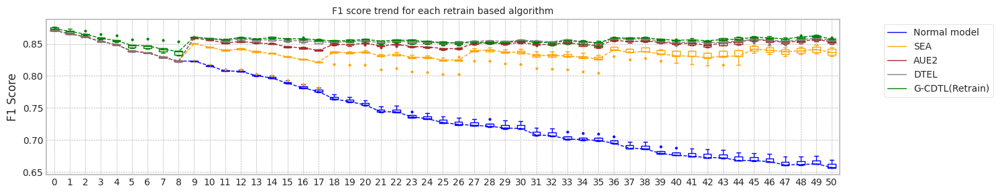

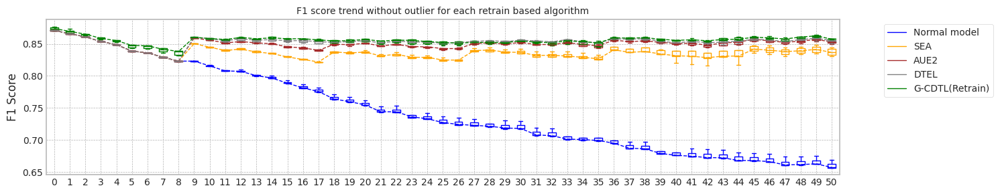

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.757805347442627
Base flops (train + inference flops of normal model, median): 3511755000.0


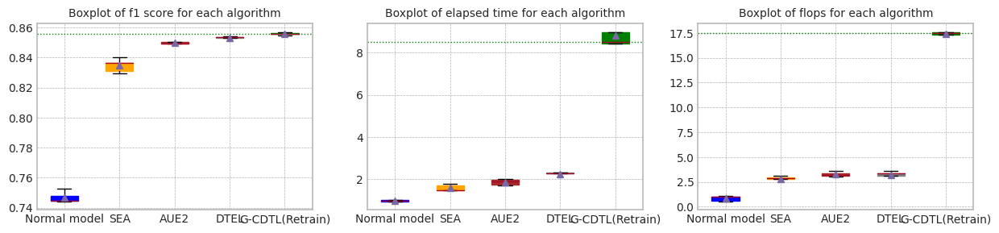

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.757805347442627


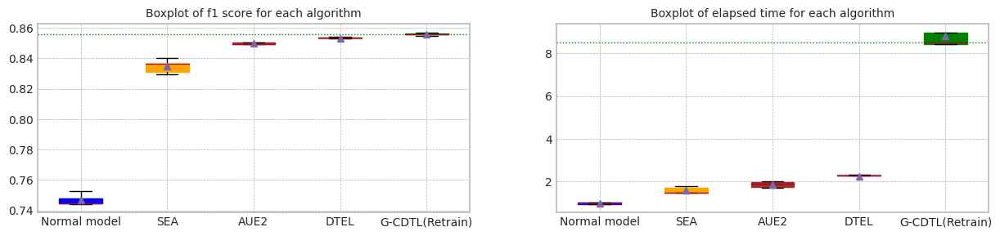

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.748116,0.662420,9.401495,3.738825e+09,199665000.0,3.938490e+09
1,1.0,0.871143,0.866126,0.744360,0.656865,10.055998,2.008395e+09,199665000.0,2.208060e+09
2,2.0,0.870401,0.865446,0.744796,0.656855,9.795512,1.753920e+09,199665000.0,1.953585e+09
3,3.0,0.871195,0.865883,0.752557,0.668899,9.757805,3.312090e+09,199665000.0,3.511755e+09
4,4.0,0.870160,0.865308,0.744856,0.657234,9.361615,3.394305e+09,199665000.0,3.593970e+09
5,median,0.871099,0.865787,0.744856,0.657234,9.757805,3.312090e+09,199665000.0,3.511755e+09
6,std,0.000483,0.000332,0.003483,0.005277,0.291356,8.957029e+08,0.0,8.957029e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.786961,0.726602,9.538157,3.979863e+10,1.002915e+09,4.080154e+10
1,1.0,0.873993,0.869518,0.781219,0.718204,9.593124,4.076222e+10,1.002915e+09,4.176513e+10
2,2.0,0.876834,0.873531,0.839847,0.826417,9.582482,9.176535e+09,1.002915e+09,1.017945e+10
3,3.0,0.871205,0.866786,0.790738,0.735604,9.751762,3.944466e+10,1.002915e+09,4.044758e+10
4,4.0,0.871522,0.867111,0.784866,0.727937,9.560064,3.865806e+10,1.002915e+09,3.966098e+10
5,median,0.873993,0.869518,0.786961,0.727937,9.582482,3.944466e+10,1.002915e+09,4.044758e+10
6,std,0.002400,0.002718,0.024350,0.044848,0.084667,1.365618e+10,0.000000e+00,1.365618e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.830967,0.830261,14.560174,4.636665e+09,5.854230e+09,1.049090e+10
1,1.0,0.871143,0.866126,0.836410,0.833015,17.607986,5.355285e+09,4.842420e+09,1.019770e+10
2,2.0,0.870401,0.865446,0.840110,0.842525,14.450070,4.580550e+09,3.813210e+09,8.393760e+09
3,3.0,0.871195,0.865883,0.829555,0.844449,14.328513,4.531395e+09,5.322225e+09,9.853620e+09
4,4.0,0.870160,0.865308,0.836382,0.836576,16.622814,4.999890e+09,5.872935e+09,1.087282e+10
5,median,0.871099,0.865787,0.836382,0.836576,14.560174,4.636665e+09,5.322225e+09,1.019770e+10
6,std,0.000483,0.000332,0.004342,0.006059,1.505104,3.511155e+08,8.557810e+08,9.534164e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.850481,0.853890,16.913878,5.195640e+09,6.612870e+09,1.180851e+10
1,1.0,0.871143,0.866126,0.849154,0.851140,18.563326,5.558430e+09,5.245230e+09,1.080366e+10
2,2.0,0.870401,0.865446,0.849463,0.853045,19.366024,5.722425e+09,5.154750e+09,1.087718e+10
3,3.0,0.871195,0.865883,0.849136,0.849638,19.700205,5.804640e+09,6.795135e+09,1.259978e+10
4,4.0,0.870160,0.865308,0.850249,0.853448,16.759211,5.073840e+09,6.146550e+09,1.122039e+10
5,median,0.871099,0.865787,0.849463,0.853045,18.563326,5.558430e+09,6.146550e+09,1.122039e+10
6,std,0.000483,0.000332,0.000629,0.001790,1.365091,3.223869e+08,7.604338e+08,7.497347e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.871099,0.865787,0.854182,0.857541,22.329816,6.570675e+09,6.207885e+09,1.277856e+10
1,1.0,0.871143,0.866126,0.851441,0.850802,22.363837,6.479760e+09,4.489200e+09,1.096896e+10
2,2.0,0.870401,0.865446,0.853593,0.855381,19.372139,5.748525e+09,3.576570e+09,9.325095e+09
3,3.0,0.871195,0.865883,0.853125,0.853025,22.554766,6.453225e+09,5.461860e+09,1.191508e+10
4,4.0,0.870160,0.865308,0.853584,0.855022,22.512810,6.415815e+09,5.377035e+09,1.179285e+10
5,median,0.871099,0.865787,0.853584,0.855022,22.363837,6.453225e+09,5.377035e+09,1.179285e+10
6,std,0.000483,0.000332,0.001045,0.002551,1.375440,3.320201e+08,1.012298e+09,1.303981e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.875177,0.870029,0.856361,0.857143,83.145873,6.124474e+10,53730000.0,6.129847e+10
1,1.0,0.873993,0.869518,0.855801,0.859769,82.413858,6.071597e+10,53730000.0,6.076970e+10
2,2.0,0.876834,0.873531,0.857006,0.857392,87.678744,6.175166e+10,53730000.0,6.180539e+10
3,3.0,0.871205,0.866786,0.855636,0.857418,103.512526,6.551860e+10,53730000.0,6.557233e+10
4,4.0,0.871522,0.867111,0.854646,0.858148,72.754550,5.635798e+10,53730000.0,5.641172e+10
5,median,0.873993,0.869518,0.855801,0.857418,83.145873,6.124474e+10,53730000.0,6.129847e+10
6,std,0.002400,0.002718,0.000879,0.001071,11.246180,3.263520e+09,0.0,3.263520e+09


In [ ]:

org_df_rt = {}
gcd_df_rt = {}
sea_df_rt = {}
aue_df_rt = {}
dte_df_rt = {}
gea_df_rt = {}


orgf_df_rt = {}
gcdf_df_rt = {}
seaf_df_rt = {}
auef_df_rt = {}
dtef_df_rt = {}
geaf_df_rt = {}

test_f1_score = []

for RT in range(1,6):
    org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case1',X1, Y1,train_size, test_size,avaible_range = 300,
                                                                lambda_f2=0.8,trial_count=5,lr_g=0.002,
                                                                retrain_count=RT,weight_init=True)
    test_f1_score = org_df['Testset F1']
    org_df_rt[f'{RT}'] = org_df['Mean F1']
    gcd_df_rt[f'{RT}'] = gcd_df['Mean F1']
    sea_df_rt[f'{RT}'] = sea_df['Mean F1']
    aue_df_rt[f'{RT}'] = aue_df['Mean F1']
    dte_df_rt[f'{RT}'] = dte_df['Mean F1']
    gea_df_rt[f'{RT}'] = gea_df['Mean F1']

    orgf_df_rt[f'{RT}'] = org_df['flops']
    gcdf_df_rt[f'{RT}'] = gcd_df['flops']
    seaf_df_rt[f'{RT}'] = sea_df['flops']
    auef_df_rt[f'{RT}'] = aue_df['flops']
    dtef_df_rt[f'{RT}'] = dte_df['flops']
    geaf_df_rt[f'{RT}'] = gea_df['flops']

Test F1 Score: 0.8707996702252515
G-CDTL, 1-retrain: 0.8362723179200645


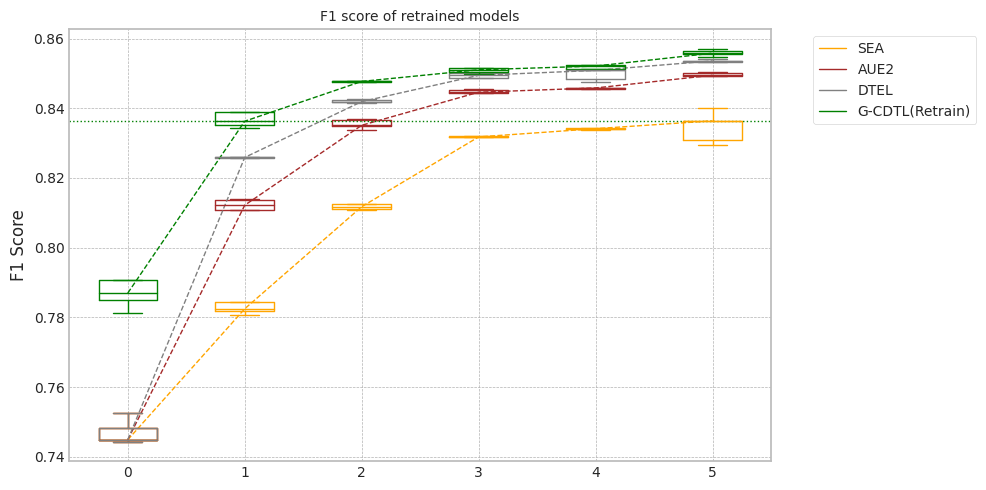

In [ ]:
org_df1 = pd.DataFrame(org_df_rt)
gcd_df1 = pd.DataFrame(gcd_df_rt)

sea_df1 = pd.DataFrame(sea_df_rt)
aue_df1 = pd.DataFrame(aue_df_rt)
dte_df1 = pd.DataFrame(dte_df_rt)
gea_df1 = pd.DataFrame(gea_df_rt)

sea_df1.insert(0, "0", org_df1['1'], True)
aue_df1.insert(0, "0", org_df1['1'], True)
dte_df1.insert(0, "0", org_df1['1'], True)
gea_df1.insert(0, "0", gcd_df1['1'], True)

fig, ax = plt.subplots(figsize=(10,5))
lg = draw_chart2(ax,None,'SEA',sea_df1,'orange',showfliers=False)
lg = draw_chart2(ax,lg,'AUE2',aue_df1,'brown',showfliers=False)
lg = draw_chart2(ax,lg,'DTEL',dte_df1,'gray',showfliers=False)
lg = draw_chart2(ax,lg,'G-CDTL(Retrain)',gea_df1,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

#ax.axhline(y = np.mean(org_df1['1'][0:org_df1.shape[0]-2]), color = 'black', linewidth=1, linestyle = ':')

tf1 = np.mean(test_f1_score[0:org_df1.shape[0]-2])
print('Test F1 Score:',tf1)
tcd = np.median(gea_df1['1'][0:gea_df1.shape[0]-2])
print('G-CDTL, 1-retrain:',tcd)

ax.axhline(y = tcd, color = 'green', linewidth=1, linestyle = ':')

set_legend2(ax,lg,'F1 score of retrained models')
plt.tight_layout()
plt.show()


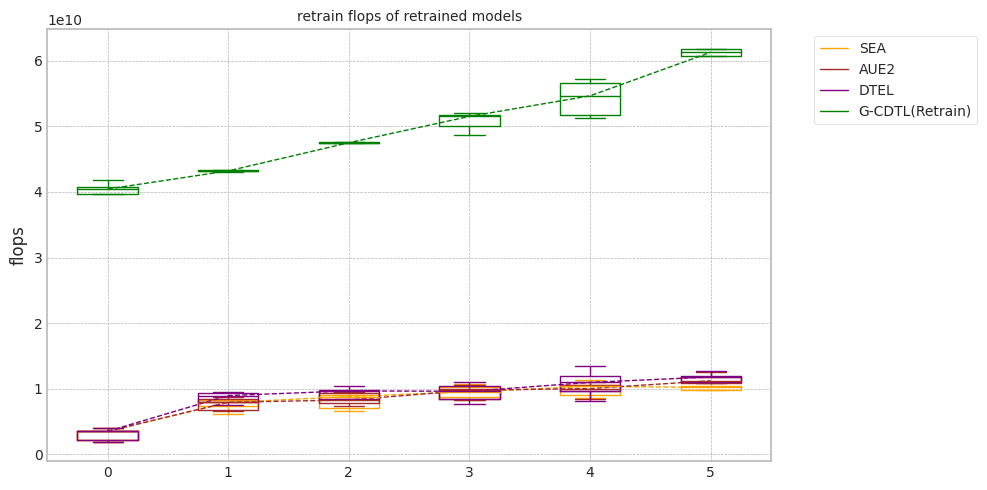

In [ ]:
org_df2 = pd.DataFrame(orgf_df_rt)
gcd_df2 = pd.DataFrame(gcdf_df_rt)

sea_df2 = pd.DataFrame(seaf_df_rt)
aue_df2 = pd.DataFrame(auef_df_rt)
dte_df2 = pd.DataFrame(dtef_df_rt)
gea_df2 = pd.DataFrame(geaf_df_rt)

sea_df2.insert(0, "0", org_df2['1'], True)
aue_df2.insert(0, "0", org_df2['1'], True)
dte_df2.insert(0, "0", org_df2['1'], True)
gea_df2.insert(0, "0", gcd_df2['1'], True)

fig, ax = plt.subplots(figsize=(10,5))
lg = draw_chart3(ax,None,'SEA',sea_df2,'orange',showfliers=False)
lg = draw_chart3(ax,lg,'AUE2',aue_df2,'brown',showfliers=False)
lg = draw_chart3(ax,lg,'DTEL',dte_df2,'purple',showfliers=False)
lg = draw_chart3(ax,lg,'G-CDTL(Retrain)',gea_df2,'green',showfliers=False)
#lg = draw_chart(ax,lg,'G-CDTL',Driftto_df,'green',showfliers=False)

set_legend2(ax,lg,'retrain flops of retrained models')
plt.tight_layout()
plt.show()

## synthetic data의 생성 (Case #2 MI의 증감(상대적), Drift의 고정)

+ $P_t(y|X) \ne P_{t+w}(y|X)$ and $P_t(X) = P_{t+w}(X)$
+ Actual Drift
+ 즉, P(X)의 변화없이, Concept (본 Dataset에서 MI의 변화)만 변경


+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature에 대해 y의 비중이 시간에 따라 감소하도록 생성

### Dataset 준비

In [ ]:
data_size = 60000
cor = np.asarray([1.5, 1.2, 0.9 , 0.7, 2.5])

In [ ]:
seed_everything()

x1 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x1[:,ix] = np.random.normal(1,cor_,data_size)

In [ ]:
x1.shape

(60000, 5)

In [ ]:
import matplotlib.pyplot as plt

seed_everything()

y1_array = []
cor_const = cor[4]
for ii in range(x1.shape[0]):
    cor[4] = cor[4] - cor_const / x1.shape[0]
    e = np.random.normal(0.0, 2.0)
    y1_array.append(np.sum(cor * x1[ii])+e)

In [ ]:
m = 5 #np.mean(y1_array[0:2000])
print(m)
y1 = [1 if y_ > m else 0 for y_ in y1_array]
print(sum(y1))

5
31901


### 실험

MI Analysis MI Max 0.22806, Min 0.00205, Mean 0.07018, Std 0.08508
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:08<00:00,  5.72it/s]


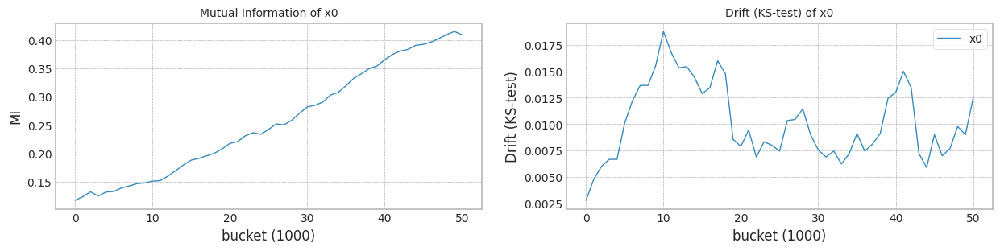

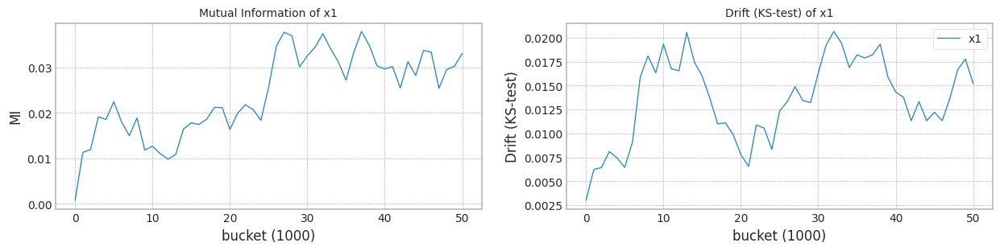

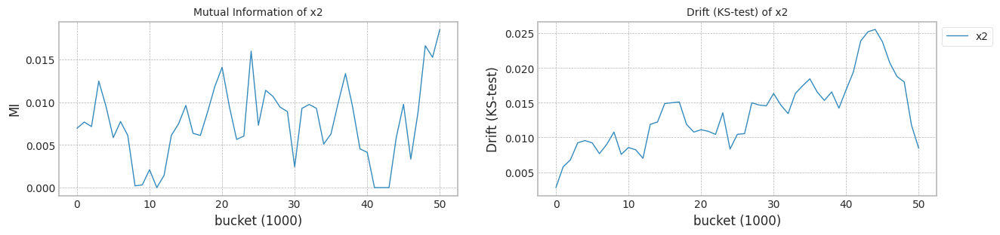

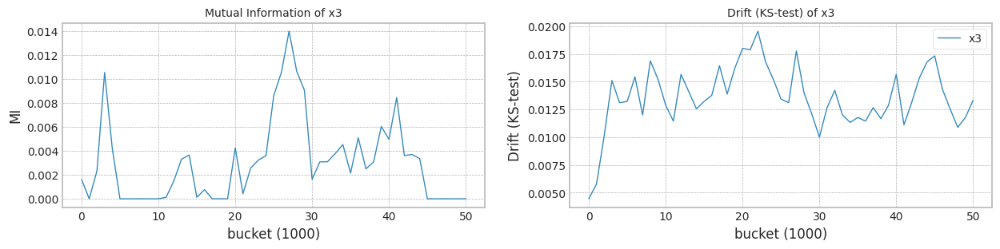

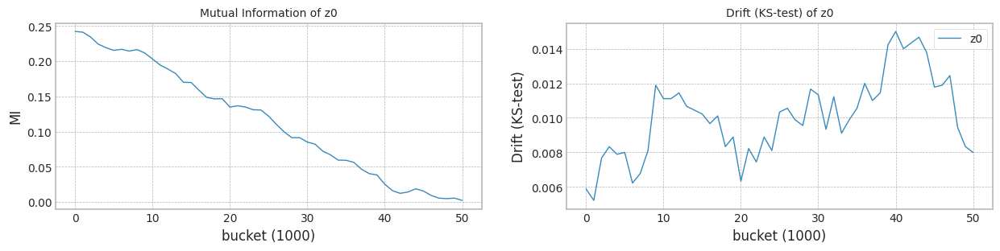

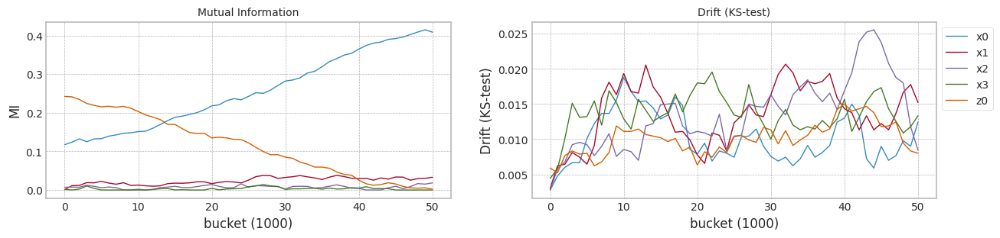

In [ ]:
columns=['x0','x1','x2','x3','z0']
X1 = pd.DataFrame(x1,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X1, y1,train_size, test_size)
#model,df = train_classificaion_model(X1,Y1,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.444809,0.549493,0.334264,0.490066,0
1,0.610533,0.615178,0.580336,0.386537,0.428404,0
2,0.556874,0.639435,0.724770,0.481368,0.025473,0
3,0.344341,0.459348,0.528780,0.367451,0.747377,0
4,0.503142,0.605841,0.465698,0.400521,0.420567,0
...,...,...,...,...,...,...
59995,0.480638,0.384668,0.703331,0.287800,0.697453,59
59996,0.288861,0.418546,0.215280,0.307386,0.782058,59
59997,0.662003,0.594007,0.488092,0.450741,0.571961,59
59998,0.655881,0.383029,0.773189,0.490745,0.517104,59


trial_count: 1
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:27:03,711] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:04<00:01, 358.47it/s]

Early stop: 1611
[2023-11-29 01:27:08,214] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.51it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:27:17,553] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:27:17,555] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:04<00:13, 114.26it/s]

[2023-11-29 01:27:34,167] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:27:34,168] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]


mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.53it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:27:48,391] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:27:48,394] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:28:04,509] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:28:04,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:21<01:25,  3.57s/it]

G-CDTL train flops: 3419500000 897750000 223155000 4540405000


100%|██████████| 51/51 [00:25<00:00,  2.01it/s]


Early stop at  [512]
Train flops  [4540405000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9557518410475129
G_CDTL+AUE median: 0.9557518410475129
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.03it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.90it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9195677382231323
SEA median: 0.9195677382231323
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:20,  1.16it/s]

Ensemble_SEA train flops: 756030000


100%|██████████| 51/51 [00:12<00:00,  4.08it/s]


Early stop at  [1737]
Train flops  [756030000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9386898622496477
AUE median: 0.9386898622496477
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.54it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:11<00:39,  1.65s/it]

Ensemble_DTEL train flops: 728190000


100%|██████████| 51/51 [00:16<00:00,  3.14it/s]


Early stop at  [1999, 1673]
Train flops  [870000000, 728190000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9436617175298717
DTEL median: 0.9436617175298717


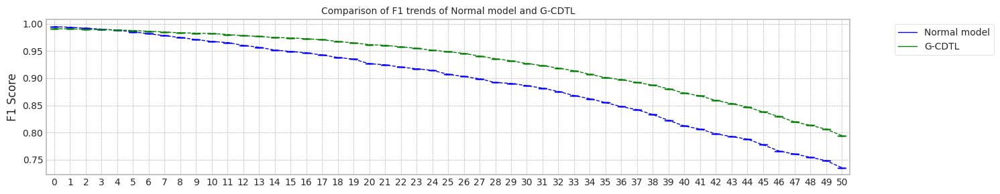

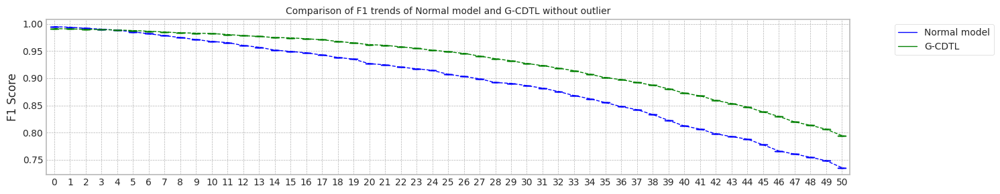

max_mean_trial= 0


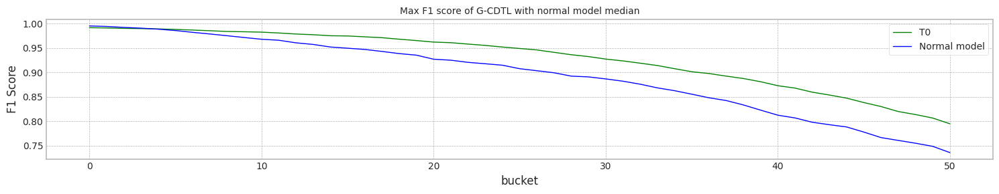

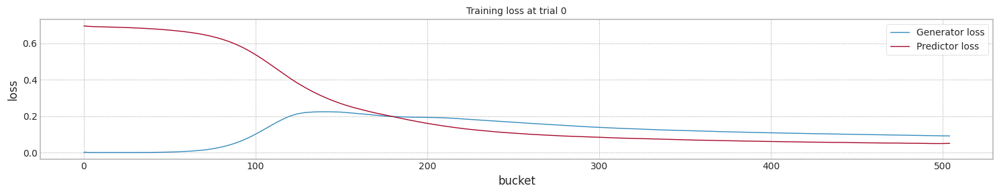

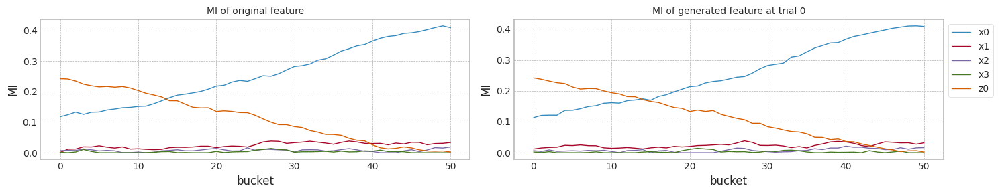

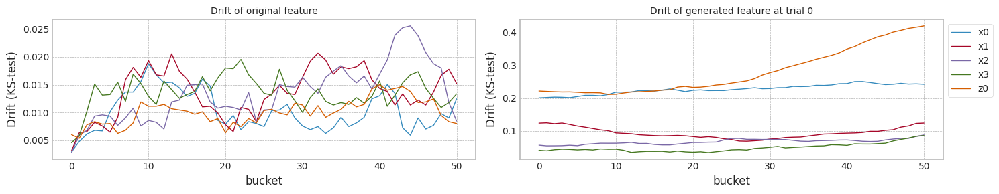

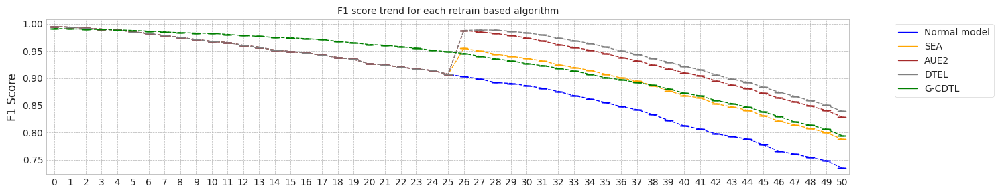

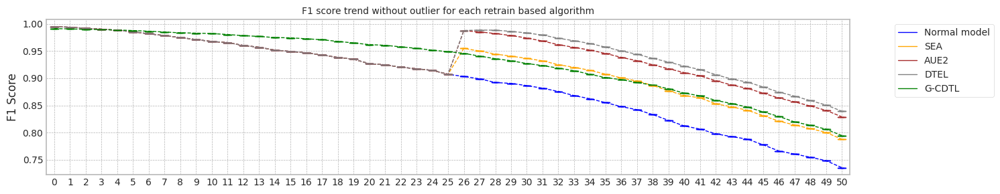

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.324888467788696
Base flops (inference flops of normal model, median): 199665000.0


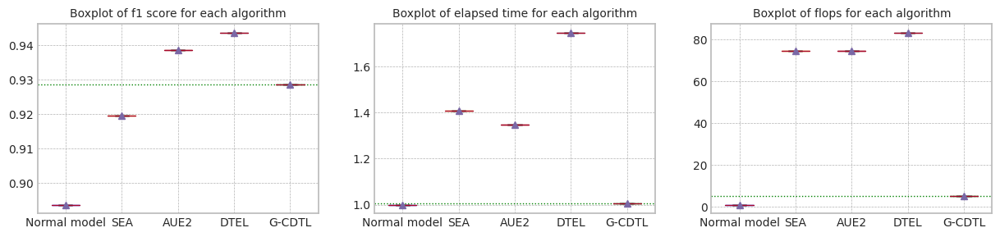

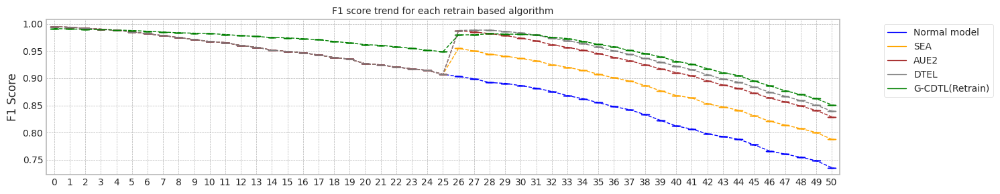

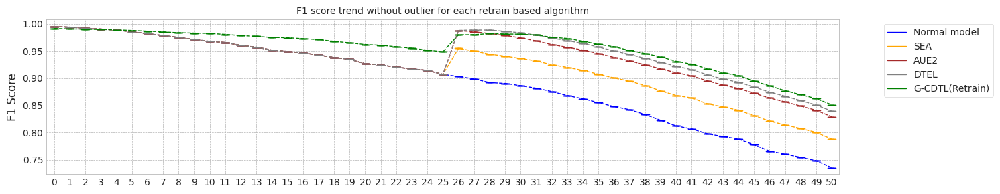

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.324888467788696
Base flops (train + inference flops of normal model, median): 6510645000.0


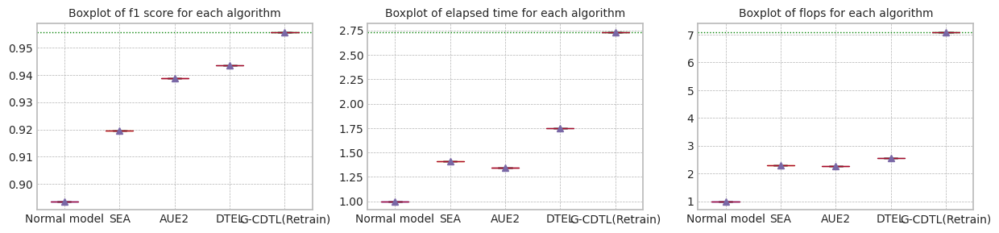

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.324888467788696


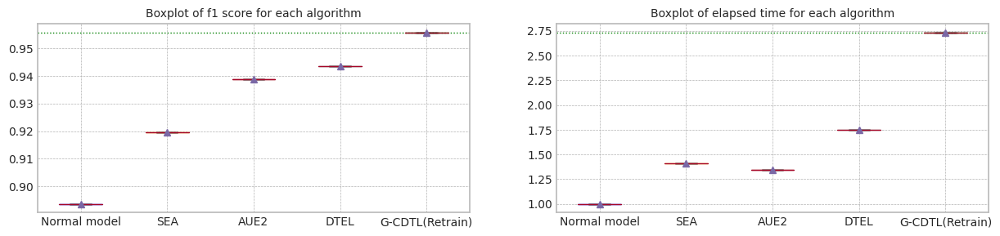

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.324888,6.310980e+09,199665000.0,6.510645e+09
1,median,0.994875,0.993892,0.893682,0.735588,9.324888,6.310980e+09,199665000.0,6.510645e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.393821,4.143082e+10,1.002915e+09,4.243374e+10
1,median,0.991374,0.990734,0.928653,0.794588,9.393821,4.143082e+10,1.002915e+09,4.243374e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.919568,0.787799,13.131788,7.180980e+09,7.682100e+09,1.486308e+10
1,median,0.994875,0.993892,0.919568,0.787799,13.131788,7.180980e+09,7.682100e+09,1.486308e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.93869,0.829094,12.559887,7.067010e+09,7.767795e+09,1.483480e+10
1,median,0.994875,0.993892,0.93869,0.829094,12.559887,7.067010e+09,7.767795e+09,1.483480e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.943662,0.839481,16.297592,7.909170e+09,8.711745e+09,1.662092e+10
1,median,0.994875,0.993892,0.943662,0.839481,16.297592,7.909170e+09,8.711745e+09,1.662092e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.955752,0.8512,25.499095,4.597123e+10,223875000.0,4.619510e+10
1,median,0.991374,0.990734,0.955752,0.8512,25.499095,4.597123e+10,223875000.0,4.619510e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case2',X1, Y1,train_size, test_size,avaible_range = 300,
                                                            lambda_f2=0.8,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:31:58,551] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:04<00:01, 352.54it/s]

Early stop: 1611
[2023-11-29 01:32:03,127] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.57it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:32:12,373] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:32:12,375] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:04<00:13, 112.32it/s]

[2023-11-29 01:32:29,258] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:32:29,259] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:32:38,694] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 349.67it/s]

Early stop: 1134
[2023-11-29 01:32:41,942] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.54it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:32:51,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:32:51,225] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:05<00:12, 110.71it/s]

[2023-11-29 01:33:09,574] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:33:09,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:33:19,202] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 340.88it/s]

Early stop: 1488
[2023-11-29 01:33:23,574] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:33:33,164] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:33:33,166] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:04<00:13, 111.50it/s]

[2023-11-29 01:33:38,236] [INFO] [profiler.py:226:end_profile] Flops profiler finished


[2023-11-29 01:33:38,238] [INFO] [profiler.py:226:end_profile] Flops profiler finished
G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.52it/s]

mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:33:47,556] [INFO] [profiler.py:80:start_profile] Flops profiler started



 95%|█████████▍| 1896/2000 [00:05<00:00, 352.59it/s]

Early stop: 1896
[2023-11-29 01:33:52,939] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.52it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:34:02,270] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:34:02,272] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:04<00:13, 108.67it/s]

[2023-11-29 01:34:19,509] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:34:19,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.50it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:34:28,892] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:04<00:00, 346.86it/s]

Early stop: 1689
[2023-11-29 01:34:33,767] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.57it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:34:43,030] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:34:43,032] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:03<00:14, 110.84it/s]

[2023-11-29 01:34:51,613] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:34:51,614] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:35:05,848] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:35:05,851] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:35:12,163] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:35:12,164] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:11<00:36,  1.51s/it]

G-CDTL train flops: 75250000 1205750000 299715000 1580715000


100%|██████████| 51/51 [00:15<00:00,  3.27it/s]


Early stop at  [688]
Train flops  [1580715000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9529454211563336
G_CDTL+AUE median: 0.9529454211563336
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:22,  1.08it/s]

Ensemble_SEA train flops: 797355000


100%|██████████| 51/51 [00:12<00:00,  3.94it/s]


Early stop at  [1832]
Train flops  [797355000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9155969460515575
SEA median: 0.9155969460515575
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:20,  1.18it/s]

Ensemble_SEA train flops: 722100000


100%|██████████| 51/51 [00:12<00:00,  4.11it/s]


Early stop at  [1659]
Train flops  [722100000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9378824393097898
AUE median: 0.9378824393097898
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.65it/s]

Ensemble_DTEL train flops: 816060000


 53%|█████▎    | 27/51 [00:11<00:38,  1.59s/it]

Ensemble_DTEL train flops: 728190000


100%|██████████| 51/51 [00:15<00:00,  3.21it/s]


Early stop at  [1875, 1673]
Train flops  [816060000, 728190000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9436617175298717
DTEL median: 0.9436617175298717
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:36:03,094] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:36:03,096] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:36:19,946] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:36:19,947] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:21<01:29,  3.73s/it]

G-CDTL train flops: 3500000000 876750000 217935000 4594685000


100%|██████████| 51/51 [00:26<00:00,  1.94it/s]


Early stop at  [500]
Train flops  [4594685000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9507530745409194
G_CDTL+AUE median: 0.9518492478486265
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:22,  1.06it/s]

Ensemble_SEA train flops: 798225000


100%|██████████| 51/51 [00:12<00:00,  3.95it/s]


Early stop at  [1834]
Train flops  [798225000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9192476602823338
SEA median: 0.9174223031669457
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:18,  1.32it/s]

Ensemble_SEA train flops: 616395000


100%|██████████| 51/51 [00:11<00:00,  4.25it/s]


Early stop at  [1416]
Train flops  [616395000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.93748927883238
AUE median: 0.9376858590710848
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.60it/s]

Ensemble_DTEL train flops: 649890000


 53%|█████▎    | 27/51 [00:11<00:38,  1.60s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:15<00:00,  3.21it/s]


Early stop at  [1493, 1999]
Train flops  [649890000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9435331409761736
DTEL median: 0.9435974292530227
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:37:10,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:37:10,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:37:14,610] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:37:14,611] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:09<00:26,  1.08s/it]

G-CDTL train flops: 56000000 805000000 200100000 1061100000


100%|██████████| 51/51 [00:13<00:00,  3.74it/s]


Early stop at  [459]
Train flops  [1061100000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9528377346941299
G_CDTL+AUE median: 0.9528377346941299
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.02it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.91it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9176879871863158
SEA median: 0.9176879871863158
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.01it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.91it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9387208639947016
AUE median: 0.9378824393097898
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.62it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:42,  1.77s/it]

Ensemble_DTEL train flops: 843030000


100%|██████████| 51/51 [00:16<00:00,  3.05it/s]


Early stop at  [1999, 1937]
Train flops  [870000000, 843030000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9435642459084468
DTEL median: 0.9435642459084468
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:38:07,151] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:38:07,153] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:38:25,124] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:38:25,125] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:23<01:35,  3.96s/it]

G-CDTL train flops: 3500000000 1090250000 271005000 4861255000


100%|██████████| 51/51 [00:27<00:00,  1.86it/s]


Early stop at  [622]
Train flops  [4861255000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9533125430596264
G_CDTL+AUE median: 0.9528915779252318
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:22,  1.07it/s]

Ensemble_SEA train flops: 807795000


100%|██████████| 51/51 [00:12<00:00,  3.93it/s]


Early stop at  [1856]
Train flops  [807795000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9153299854224366
SEA median: 0.9166424666189367
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.02it/s]

Ensemble_SEA train flops: 864345000


100%|██████████| 51/51 [00:13<00:00,  3.92it/s]


Early stop at  [1986]
Train flops  [864345000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9396941625699425
AUE median: 0.9383016516522457
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.55it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:42,  1.79s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:16<00:00,  3.02it/s]


Early stop at  [1999, 1999]
Train flops  [870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9437361899472091
DTEL median: 0.9436129817191592
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.53it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:39:17,692] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:39:17,695] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:39:35,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:39:35,546] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:22<01:34,  3.93s/it]

G-CDTL train flops: 3500000000 1067500000 265350000 4832850000


100%|██████████| 51/51 [00:27<00:00,  1.87it/s]


Early stop at  [609]
Train flops  [4832850000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.946975830754785
G_CDTL+AUE median: 0.9528377346941299
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:23,  1.01it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:12<00:00,  3.92it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.907541056936379
SEA median: 0.9155969460515575
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:08<00:33,  1.33s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.89it/s]


Early stop at  [1999]
Train flops  [870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9399847930176555
AUE median: 0.9387208639947016
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.61it/s]

Ensemble_DTEL train flops: 770820000


 53%|█████▎    | 27/51 [00:09<00:29,  1.21s/it]

Ensemble_DTEL train flops: 332775000


100%|██████████| 51/51 [00:14<00:00,  3.63it/s]


Early stop at  [1771, 764]
Train flops  [770820000, 332775000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9428289909143764
DTEL median: 0.9435642459084468


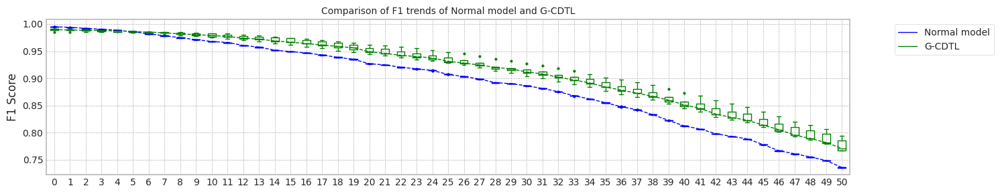

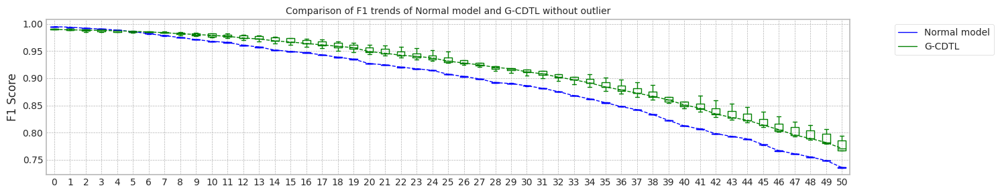

max_mean_trial= 0


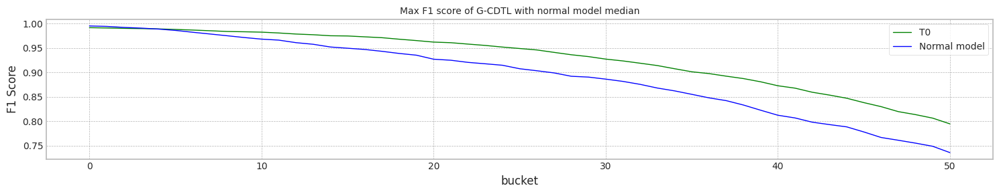

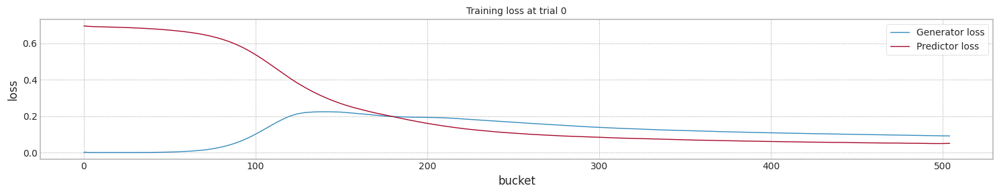

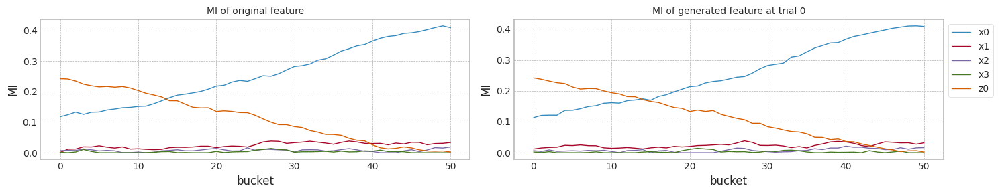

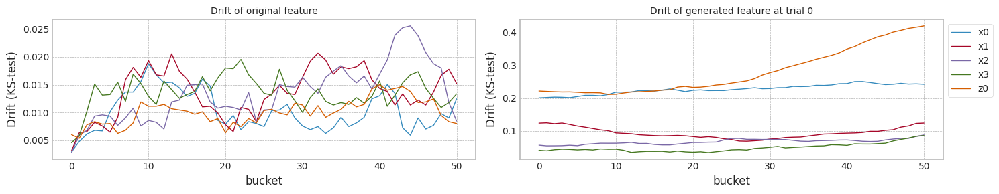

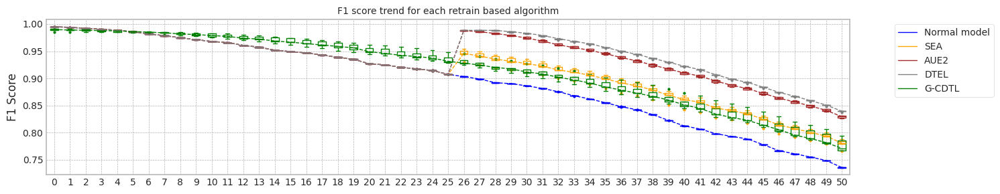

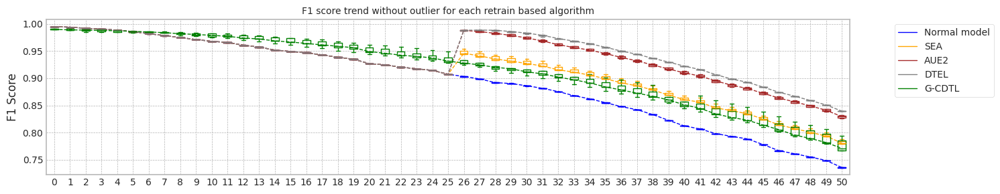

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.265263557434082
Base flops (inference flops of normal model, median): 199665000.0


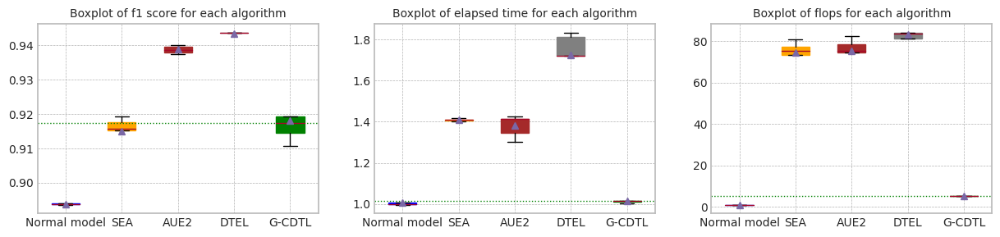

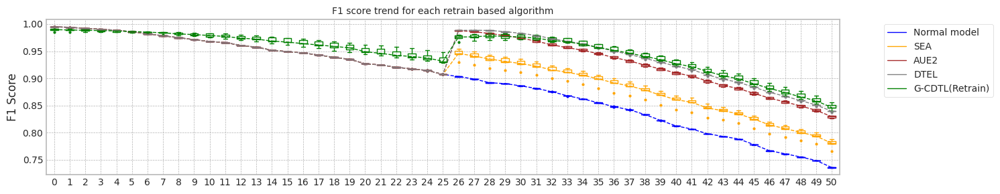

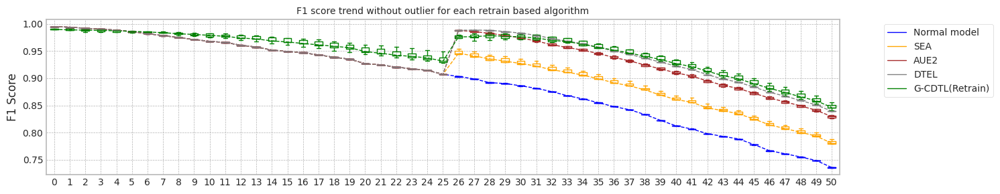

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.265263557434082
Base flops (train + inference flops of normal model, median): 6510645000.0


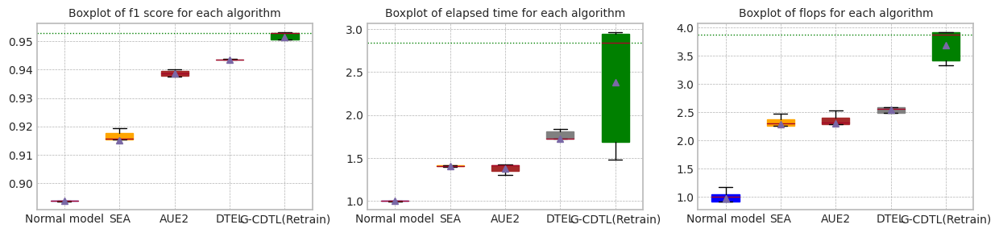

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.265263557434082


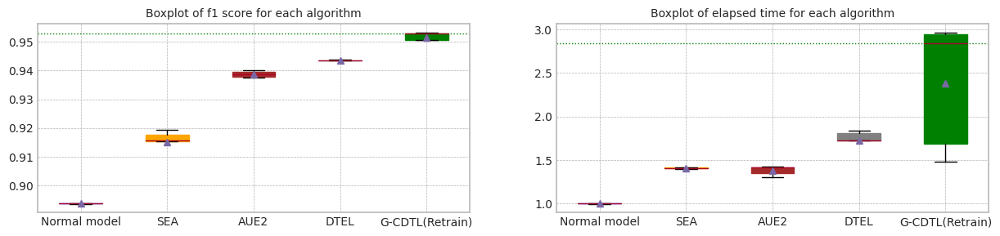

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.228912,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.265264,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.574411,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.313896,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.246232,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.265264,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.142594,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.415196,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.608717,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.297532,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.363218,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.407789,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.407789,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.116187,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.915597,0.780609,13.005244,7.413705e+09,7.609455e+09,1.502316e+10
1,1.0,0.994876,0.993988,0.919248,0.787462,12.978076,7.414575e+09,5.742870e+09,1.315744e+10
2,2.0,0.994390,0.993786,0.917688,0.784412,13.137340,7.486350e+09,7.200555e+09,1.468690e+10
3,3.0,0.994775,0.993983,0.915330,0.779562,13.051400,7.424145e+09,8.735670e+09,1.615982e+10
4,4.0,0.995157,0.994175,0.907541,0.765717,13.075014,7.486350e+09,7.987470e+09,1.547382e+10
5,median,0.994875,0.993983,0.915597,0.780609,13.051400,7.424145e+09,7.609455e+09,1.502316e+10
6,std,0.000277,0.000144,0.004509,0.008347,0.062110,3.794611e+07,1.111713e+09,1.119540e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.937882,0.827364,12.482522,7.338450e+09,7.733865e+09,1.507232e+10
1,1.0,0.994876,0.993988,0.937489,0.826658,12.072017,7.232745e+09,5.760705e+09,1.299345e+10
2,2.0,0.994390,0.993786,0.938721,0.829469,13.106550,7.486350e+09,7.400220e+09,1.488657e+10
3,3.0,0.994775,0.993983,0.939694,0.831383,13.087676,7.480695e+09,8.991885e+09,1.647258e+10
4,4.0,0.995157,0.994175,0.939985,0.831659,13.200209,7.486350e+09,8.187135e+09,1.567348e+10
5,median,0.994875,0.993983,0.938721,0.829469,13.087676,7.480695e+09,7.733865e+09,1.507232e+10
6,std,0.000277,0.000144,0.001091,0.002273,0.491713,1.151803e+08,1.196016e+09,1.290782e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.943662,0.839481,15.951604,8.160600e+09,8.657805e+09,1.681840e+10
1,1.0,0.994876,0.993988,0.943533,0.839633,15.961210,8.136240e+09,6.765990e+09,1.490223e+10
2,2.0,0.994390,0.993786,0.943564,0.839597,16.794113,8.329380e+09,8.345040e+09,1.667442e+10
3,3.0,0.994775,0.993983,0.943736,0.839503,16.991682,8.356350e+09,9.969330e+09,1.832568e+10
4,4.0,0.995157,0.994175,0.942829,0.837194,14.132931,7.719945e+09,8.522520e+09,1.624246e+10
5,median,0.994875,0.993983,0.943564,0.839503,15.961210,8.160600e+09,8.522520e+09,1.667442e+10
6,std,0.000277,0.000144,0.000364,0.001057,1.128956,2.547330e+08,1.140580e+09,1.228942e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.952945,0.845876,15.670562,2.202669e+10,223875000.0,2.225056e+10
1,1.0,0.985570,0.985016,0.950753,0.846385,26.309533,2.504066e+10,223875000.0,2.526454e+10
2,2.0,0.991229,0.990418,0.952838,0.850998,13.705664,2.150708e+10,223875000.0,2.173095e+10
3,3.0,0.989726,0.989077,0.953313,0.855785,27.481925,2.530723e+10,223875000.0,2.553110e+10
4,4.0,0.989262,0.988322,0.946976,0.840309,27.317634,2.527882e+10,223875000.0,2.550270e+10
5,median,0.989726,0.989077,0.952838,0.846385,26.309533,2.504066e+10,223875000.0,2.526454e+10
6,std,0.002347,0.002288,0.002650,0.005826,6.813801,1.897030e+09,0.0,1.897030e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:40:35,609] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:04<00:01, 345.54it/s]

Early stop: 1611
[2023-11-29 01:40:40,279] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:40:49,692] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:40:49,694] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:04<00:14, 106.38it/s]

[2023-11-29 01:41:07,062] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:41:07,064] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:41:16,578] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 346.49it/s]

Early stop: 1134
[2023-11-29 01:41:19,857] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.52it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:41:29,172] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:41:29,174] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:05<00:12, 108.92it/s]

[2023-11-29 01:41:47,758] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:41:47,759] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:41:57,220] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 342.39it/s]

Early stop: 1488
[2023-11-29 01:42:01,570] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.47it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:42:10,985] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:42:10,988] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:05<00:13, 106.12it/s]

[2023-11-29 01:42:16,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:42:16,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:42:25,789] [INFO] [profiler.py:80:start_profile] Flops profiler started



 95%|█████████▍| 1896/2000 [00:05<00:00, 338.63it/s]

Early stop: 1896
[2023-11-29 01:42:31,393] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.49it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:42:40,784] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:42:40,786] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:04<00:13, 107.16it/s]

[2023-11-29 01:42:58,216] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:42:58,217] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.45it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:43:07,665] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:05<00:00, 337.28it/s]

Early stop: 1689
[2023-11-29 01:43:12,680] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.53it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:43:21,983] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:43:21,985] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:03<00:15, 105.68it/s]

[2023-11-29 01:43:30,956] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:43:30,957] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.42it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:43:43,844] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:43:43,846] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:44:01,094] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:44:01,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:20<02:01,  3.81s/it]

G-CDTL train flops: 3500000000 897750000 223155000 4620905000


 69%|██████▊   | 35/51 [00:23<00:03,  5.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:44:04,430] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:44:04,432] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:44:23,030] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:44:23,031] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:42<00:57,  4.10s/it]

G-CDTL train flops: 3500000000 1142750000 284055000 4926805000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [512, 652]
Train flops  [4620905000, 4926805000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9701061662358711
G_CDTL+AUE median: 0.9701061662358711
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:26,  1.22it/s]

Ensemble_SEA train flops: 644235000


 73%|███████▎  | 37/51 [00:12<00:12,  1.16it/s]

Ensemble_SEA train flops: 713400000


100%|██████████| 51/51 [00:15<00:00,  3.28it/s]


Early stop at  [1480, 1639]
Train flops  [644235000, 713400000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9260897106467754
SEA median: 0.9260897106467754
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:28,  1.12it/s]

Ensemble_SEA train flops: 743850000


 73%|███████▎  | 37/51 [00:12<00:09,  1.53it/s]

Ensemble_SEA train flops: 488940000


100%|██████████| 51/51 [00:14<00:00,  3.41it/s]


Early stop at  [1709, 1123]
Train flops  [743850000, 488940000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9482498052398476
AUE median: 0.9482498052398476
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.54it/s]

Ensemble_DTEL train flops: 554625000


 37%|███▋      | 19/51 [00:09<00:43,  1.37s/it]

Ensemble_DTEL train flops: 689040000


 69%|██████▊   | 35/51 [00:12<00:03,  5.02it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:20<00:25,  1.85s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.23it/s]


Early stop at  [1274, 1583, 1999, 1999]
Train flops  [554625000, 689040000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9645810360526201
DTEL median: 0.9645810360526201
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:45:22,754] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:45:22,756] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:45:27,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:45:27,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:08<00:37,  1.19s/it]

G-CDTL train flops: 57750000 883750000 219675000 1161175000


 69%|██████▊   | 35/51 [00:11<00:02,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:45:30,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:45:30,790] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:45:48,735] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:45:48,737] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:29<00:55,  3.95s/it]

G-CDTL train flops: 3500000000 974750000 242295000 4717045000


100%|██████████| 51/51 [00:32<00:00,  1.59it/s]


Early stop at  [504, 556]
Train flops  [1161175000, 4717045000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9692405238806545
G_CDTL+AUE median: 0.9696733450582629
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:06<00:35,  1.08s/it]

Ensemble_SEA train flops: 657720000


 73%|███████▎  | 37/51 [00:13<00:12,  1.10it/s]

Ensemble_SEA train flops: 750375000


100%|██████████| 51/51 [00:15<00:00,  3.24it/s]


Early stop at  [1511, 1724]
Train flops  [657720000, 750375000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9262854651670008
SEA median: 0.9261875879068882
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:07<00:32,  1.02s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:14<00:13,  1.04it/s]

Ensemble_SEA train flops: 813450000


100%|██████████| 51/51 [00:16<00:00,  3.01it/s]


Early stop at  [1999, 1869]
Train flops  [870000000, 813450000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9488254223287457
AUE median: 0.9485376137842967
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.59it/s]

Ensemble_DTEL train flops: 668595000


 37%|███▋      | 19/51 [00:09<00:49,  1.54s/it]

Ensemble_DTEL train flops: 749070000


 69%|██████▊   | 35/51 [00:12<00:02,  5.42it/s]

Ensemble_DTEL train flops: 608130000


 73%|███████▎  | 37/51 [00:19<00:22,  1.61s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.27it/s]


Early stop at  [1536, 1721, 1397, 1999]
Train flops  [668595000, 749070000, 608130000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9647132417932976
DTEL median: 0.964647138922959
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.44it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:46:50,304] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:46:50,307] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:47:08,107] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:47:08,108] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:21<03:02,  5.54s/it]

G-CDTL train flops: 3500000000 904750000 224895000 4629645000


 69%|██████▊   | 35/51 [00:24<00:03,  4.96it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:47:11,563] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:47:11,565] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:47:30,403] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:47:30,405] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:43<00:58,  4.15s/it]

G-CDTL train flops: 3500000000 1109500000 275790000 4885290000


100%|██████████| 51/51 [00:46<00:00,  1.10it/s]


Early stop at  [516, 633]
Train flops  [4629645000, 4885290000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9684988912320437
G_CDTL+AUE median: 0.9692405238806545
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:06<00:37,  1.15s/it]

Ensemble_SEA train flops: 691650000


 73%|███████▎  | 37/51 [00:12<00:10,  1.34it/s]

Ensemble_SEA train flops: 536790000


100%|██████████| 51/51 [00:15<00:00,  3.30it/s]


Early stop at  [1589, 1233]
Train flops  [691650000, 536790000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9266960900374223
SEA median: 0.9262854651670008
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:22,  1.42it/s]

Ensemble_SEA train flops: 530265000


 73%|███████▎  | 37/51 [00:09<00:02,  5.04it/s]

Ensemble_SEA train flops: 13920000


100%|██████████| 51/51 [00:11<00:00,  4.26it/s]


Early stop at  [1218, 31]
Train flops  [530265000, 13920000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9318083675871333
AUE median: 0.9482498052398476
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.30it/s]

Ensemble_DTEL train flops: 552015000


 37%|███▋      | 19/51 [00:09<00:48,  1.51s/it]

Ensemble_DTEL train flops: 811275000


 71%|███████   | 36/51 [00:17<00:21,  1.42s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 3915000


100%|██████████| 51/51 [00:19<00:00,  2.57it/s]


Early stop at  [1268, 1864, 1999, 8]
Train flops  [552015000, 811275000, 870000000, 3915000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.940493393169615
DTEL median: 0.9645810360526201
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:48:24,112] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:48:24,115] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:48:41,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:48:41,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:21<02:05,  3.92s/it]

G-CDTL train flops: 3500000000 880250000 218805000 4599055000


 69%|██████▊   | 35/51 [00:24<00:03,  4.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:48:45,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:48:45,287] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:49:02,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:49:02,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:42<01:22,  5.49s/it]

G-CDTL train flops: 3500000000 857500000 213150000 4570650000


100%|██████████| 51/51 [00:44<00:00,  1.13it/s]


Early stop at  [502, 489]
Train flops  [4599055000, 4570650000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9701880006782331
G_CDTL+AUE median: 0.9696733450582629
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:24,  1.30it/s]

Ensemble_SEA train flops: 588990000


 73%|███████▎  | 37/51 [00:13<00:14,  1.00s/it]

Ensemble_SEA train flops: 849555000


100%|██████████| 51/51 [00:16<00:00,  3.18it/s]


Early stop at  [1353, 1952]
Train flops  [588990000, 849555000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9233104612245646
SEA median: 0.9261875879068882
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:28,  1.10it/s]

Ensemble_SEA train flops: 744720000


 73%|███████▎  | 37/51 [00:13<00:13,  1.03it/s]

Ensemble_SEA train flops: 816930000


100%|██████████| 51/51 [00:16<00:00,  3.08it/s]


Early stop at  [1711, 1877]
Train flops  [744720000, 816930000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9501573658664588
AUE median: 0.9485376137842967
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.37it/s]

Ensemble_DTEL train flops: 771255000


 37%|███▋      | 19/51 [00:11<00:56,  1.77s/it]

Ensemble_DTEL train flops: 870000000


 69%|██████▊   | 35/51 [00:13<00:02,  5.34it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:22<00:26,  1.87s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:24<00:00,  2.05it/s]


Early stop at  [1772, 1999, 1999, 1999]
Train flops  [771255000, 870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9648971388423976
DTEL median: 0.964647138922959
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:50:06,800] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:50:06,803] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 01:50:11,524] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:50:11,525] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:08<00:37,  1.18s/it]

G-CDTL train flops: 63000000 850500000 211410000 1124910000


 69%|██████▊   | 35/51 [00:11<00:02,  5.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:50:14,863] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:50:14,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 01:50:36,597] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:50:36,598] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:33<01:06,  4.75s/it]

G-CDTL train flops: 3500000000 1604750000 398895000 5503645000


100%|██████████| 51/51 [00:36<00:00,  1.42it/s]


Early stop at  [485, 916]
Train flops  [1124910000, 5503645000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9646750725416474
G_CDTL+AUE median: 0.9692405238806545
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:07<00:34,  1.08s/it]

Ensemble_SEA train flops: 843900000


 73%|███████▎  | 37/51 [00:14<00:11,  1.22it/s]

Ensemble_SEA train flops: 612480000


100%|██████████| 51/51 [00:16<00:00,  3.01it/s]


Early stop at  [1939, 1407]
Train flops  [843900000, 612480000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9263985337840585
SEA median: 0.9262854651670008
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:07<00:35,  1.10s/it]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:14<00:18,  1.22s/it]

Ensemble_SEA train flops: 706440000


100%|██████████| 51/51 [00:17<00:00,  2.90it/s]


Early stop at  [1999, 1623]
Train flops  [870000000, 706440000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9526663405935656
AUE median: 0.9488254223287457
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.36it/s]

Ensemble_DTEL train flops: 725145000


 37%|███▋      | 19/51 [00:09<00:47,  1.49s/it]

Ensemble_DTEL train flops: 591600000


 69%|██████▊   | 35/51 [00:12<00:02,  5.39it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:20<00:25,  1.83s/it]

Ensemble_DTEL train flops: 793875000


100%|██████████| 51/51 [00:23<00:00,  2.17it/s]


Early stop at  [1666, 1359, 1999, 1824]
Train flops  [725145000, 591600000, 870000000, 793875000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9646476472973271
DTEL median: 0.9646476472973271


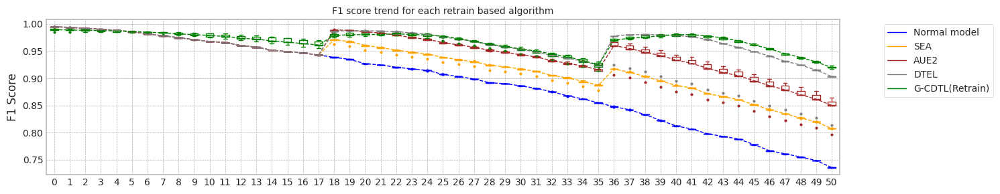

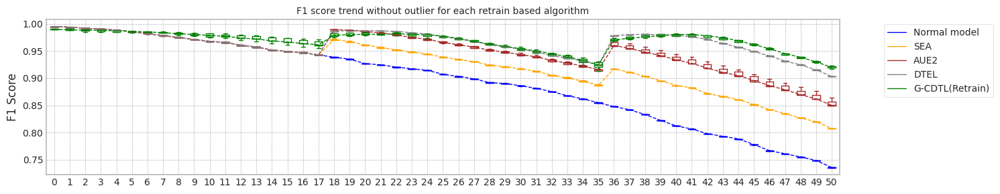

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.370770931243896
Base flops (train + inference flops of normal model, median): 6510645000.0


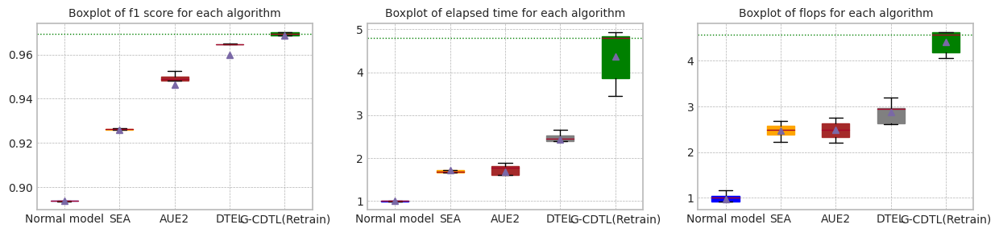

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.370770931243896


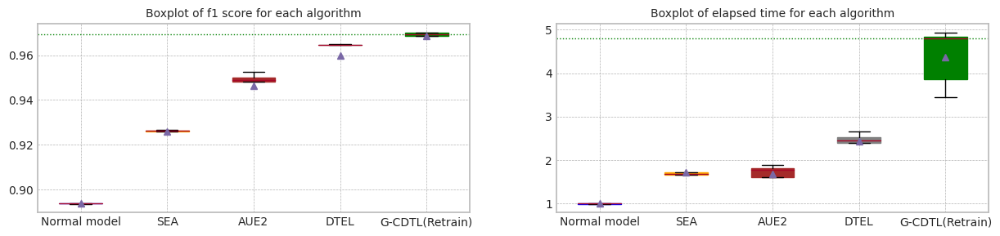

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.393665,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.300170,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.393894,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.370771,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.286111,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.370771,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.052019,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.495376,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.442288,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.454995,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.428190,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.489084,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.454995,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.029276,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.926090,0.807591,15.616642,7.973985e+09,8.259780e+09,1.623376e+10
1,1.0,0.994876,0.993988,0.926285,0.807802,15.809207,8.024445e+09,6.442785e+09,1.446723e+10
2,2.0,0.994390,0.993786,0.926696,0.807587,15.503044,7.844790e+09,7.649040e+09,1.549383e+10
3,3.0,0.994775,0.993983,0.923310,0.807360,16.109899,8.054895e+09,9.456465e+09,1.751136e+10
4,4.0,0.995157,0.994175,0.926399,0.807541,17.017141,8.072730e+09,8.663895e+09,1.673662e+10
5,median,0.994875,0.993983,0.926285,0.807587,15.809207,8.024445e+09,8.259780e+09,1.623376e+10
6,std,0.000277,0.000144,0.001385,0.000158,0.607527,9.151174e+07,1.132814e+09,1.167031e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.948250,0.849994,15.038430,7.849140e+09,8.334600e+09,1.618374e+10
1,1.0,0.994876,0.993988,0.948825,0.850309,17.027149,8.299800e+09,6.917805e+09,1.521760e+10
2,2.0,0.994390,0.993786,0.931808,0.796288,12.031976,7.160535e+09,7.164450e+09,1.432498e+10
3,3.0,0.994775,0.993983,0.950157,0.857336,16.624083,8.178000e+09,9.779235e+09,1.795724e+10
4,4.0,0.995157,0.994175,0.952666,0.864189,17.657179,8.192790e+09,8.983620e+09,1.717641e+10
5,median,0.994875,0.993983,0.948825,0.850309,16.624083,8.178000e+09,8.334600e+09,1.618374e+10
6,std,0.000277,0.000144,0.008300,0.027097,2.254714,4.652274e+08,1.207900e+09,1.459313e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.964581,0.903054,22.942024,9.600015e+09,9.542595e+09,1.914261e+10
1,1.0,0.994876,0.993988,0.964713,0.903980,22.495363,9.512145e+09,7.473300e+09,1.698544e+10
2,2.0,0.994390,0.993786,0.940493,0.813964,19.932835,8.853555e+09,8.317200e+09,1.717076e+10
3,3.0,0.994775,0.993983,0.964897,0.903666,24.909518,9.997605e+09,1.083933e+10,2.083694e+10
4,4.0,0.995157,0.994175,0.964648,0.903457,23.614105,9.596970e+09,9.674400e+09,1.927137e+10
5,median,0.994875,0.993983,0.964648,0.903457,22.942024,9.596970e+09,9.542595e+09,1.914261e+10
6,std,0.000277,0.000144,0.010831,0.040061,1.833316,4.136208e+08,1.302494e+09,1.609769e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.970106,0.919893,45.321127,2.999368e+10,134325000.0,3.012801e+10
1,1.0,0.985570,0.985016,0.969241,0.919474,32.233340,2.632420e+10,134325000.0,2.645852e+10
2,2.0,0.991229,0.990418,0.968499,0.923364,46.267307,2.996091e+10,134325000.0,3.009524e+10
3,3.0,0.989726,0.989077,0.970188,0.921604,45.033123,2.961568e+10,134325000.0,2.975000e+10
4,4.0,0.989262,0.988322,0.964675,0.917031,36.088839,2.707453e+10,134325000.0,2.720886e+10
5,median,0.989726,0.989077,0.969241,0.919893,45.033123,2.961568e+10,134325000.0,2.975000e+10
6,std,0.002347,0.002288,0.002269,0.002378,6.396404,1.755861e+09,0.0,1.755861e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 01:51:43,309] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:05<00:01, 320.36it/s]

Early stop: 1611
[2023-11-29 01:51:48,344] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:51:57,923] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:51:57,925] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:05<00:15, 97.44it/s]

[2023-11-29 01:52:16,573] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:52:16,575] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 01:52:26,378] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 310.20it/s]

Early stop: 1134
[2023-11-29 01:52:30,040] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:52:39,799] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:52:39,801] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:06<00:14, 95.49it/s]

[2023-11-29 01:53:00,502] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:53:00,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.12it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 01:53:10,558] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 307.71it/s]

Early stop: 1488
[2023-11-29 01:53:15,400] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:53:25,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:53:25,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:05<00:14, 100.14it/s]

[2023-11-29 01:53:30,841] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:53:30,843] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]


mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 01:53:40,595] [INFO] [profiler.py:80:start_profile] Flops profiler started


 95%|█████████▍| 1896/2000 [00:06<00:00, 315.91it/s]

Early stop: 1896
[2023-11-29 01:53:46,602] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:53:56,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:53:56,225] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:05<00:15, 96.84it/s]

[2023-11-29 01:54:15,193] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:54:15,194] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.08it/s]


mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 01:54:25,332] [INFO] [profiler.py:80:start_profile] Flops profiler started


 84%|████████▍ | 1689/2000 [00:05<00:00, 316.88it/s]

Early stop: 1689
[2023-11-29 01:54:30,668] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 01:54:40,346] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:54:40,348] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:04<00:16, 99.00it/s]

[2023-11-29 01:54:50,026] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:54:50,027] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.24it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:55:02,374] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:55:02,377] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 01:55:20,672] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:55:20,673] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:20<02:30,  4.06s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


 49%|████▉     | 25/51 [00:23<00:06,  3.73it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:55:23,184] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:55:23,186] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:55:42,105] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:55:42,106] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:42<01:40,  4.20s/it]

G-CDTL train flops: 3500000000 868000000 215760000 4583760000


 75%|███████▍  | 38/51 [00:44<00:03,  3.70it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:55:44,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:55:44,577] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 01:56:02,883] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:56:02,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [01:03<00:44,  4.08s/it]

G-CDTL train flops: 3500000000 791000000 196620000 4487620000


100%|██████████| 51/51 [01:05<00:00,  1.28s/it]


Early stop at  [443, 495, 451]
Train flops  [4470140000, 4583760000, 4487620000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9738529350072703
G_CDTL+AUE median: 0.9738529350072703
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:28,  1.31it/s]

Ensemble_SEA train flops: 557235000


 53%|█████▎    | 27/51 [00:12<00:25,  1.08s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:18<00:10,  1.07it/s]

Ensemble_SEA train flops: 706875000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [1280, 1999, 1624]
Train flops  [557235000, 870000000, 706875000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9295861872506024
SEA median: 0.9295861872506024
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:39,  1.08s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:25,  1.06s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:20<00:11,  1.07s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.30it/s]


Early stop at  [1999, 1999, 1999]
Train flops  [870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9480544029007213
AUE median: 0.9480544029007213
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.27it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:07,  1.83s/it]

Ensemble_DTEL train flops: 709485000


 53%|█████▎    | 27/51 [00:17<00:26,  1.10s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


 75%|███████▍  | 38/51 [00:19<00:02,  4.84it/s]

Ensemble_DTEL train flops: 441090000


 78%|███████▊  | 40/51 [00:26<00:17,  1.55s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:28<00:00,  1.81it/s]


Early stop at  [1999, 1630, 1999, 3, 1013, 1999]
Train flops  [870000000, 709485000, 870000000, 1740000, 441090000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9626261295860568
DTEL median: 0.9626261295860568
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:57:18,510] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:57:18,512] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 01:57:39,051] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:57:39,053] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:23<04:03,  6.42s/it]

G-CDTL train flops: 3500000000 1062250000 264045000 4826295000


 49%|████▉     | 25/51 [00:25<00:07,  3.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:57:41,597] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:57:41,600] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:57:52,519] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:57:52,520] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:36<01:28,  3.53s/it]

G-CDTL train flops: 1384250000 908250000 225765000 2518265000


 75%|███████▍  | 38/51 [00:38<00:03,  4.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:57:55,047] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:57:55,051] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 01:58:13,620] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:58:13,622] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:57<00:45,  4.12s/it]

G-CDTL train flops: 3500000000 757750000 188355000 4446105000


100%|██████████| 51/51 [00:59<00:00,  1.18s/it]


Early stop at  [606, 518, 432]
Train flops  [4826295000, 2518265000, 4446105000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9734251747258318
G_CDTL+AUE median: 0.973639054866551
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:37,  1.02s/it]

Ensemble_SEA train flops: 774300000


 53%|█████▎    | 27/51 [00:13<00:26,  1.09s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:19<00:10,  1.06it/s]

Ensemble_SEA train flops: 709920000


100%|██████████| 51/51 [00:21<00:00,  2.38it/s]


Early stop at  [1779, 1999, 1631]
Train flops  [774300000, 870000000, 709920000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9313902373013396
SEA median: 0.930488212275971
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.10s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:19,  1.21it/s]

Ensemble_SEA train flops: 601170000


 78%|███████▊  | 40/51 [00:17<00:08,  1.26it/s]

Ensemble_SEA train flops: 584640000


100%|██████████| 51/51 [00:19<00:00,  2.56it/s]


Early stop at  [1999, 1381, 1343]
Train flops  [870000000, 601170000, 584640000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9474203908051193
AUE median: 0.9477373968529204
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.07it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:07,  1.82s/it]

Ensemble_DTEL train flops: 698610000


 49%|████▉     | 25/51 [00:12<00:05,  4.49it/s]

Ensemble_DTEL train flops: 635970000


 53%|█████▎    | 27/51 [00:20<00:42,  1.77s/it]

Ensemble_DTEL train flops: 870000000


 76%|███████▋  | 39/51 [00:26<00:16,  1.39s/it]

Ensemble_DTEL train flops: 784740000
Ensemble_DTEL train flops: 3480000


100%|██████████| 51/51 [00:28<00:00,  1.77it/s]


Early stop at  [1999, 1605, 1461, 1999, 1803, 7]
Train flops  [870000000, 698610000, 635970000, 870000000, 784740000, 3480000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9571642068430416
DTEL median: 0.9598951682145491
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:59:28,959] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:59:28,962] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 01:59:48,466] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:59:48,468] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:22<02:39,  4.32s/it]

G-CDTL train flops: 3500000000 943250000 234465000 4677715000


 49%|████▉     | 25/51 [00:24<00:07,  3.64it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:59:50,983] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:59:50,986] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 01:59:56,092] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 01:59:56,094] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:29<00:44,  1.78s/it]

G-CDTL train flops: 98000000 812000000 201840000 1111840000


 75%|███████▍  | 38/51 [00:32<00:02,  4.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 01:59:58,601] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 01:59:58,604] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 02:00:21,326] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:00:21,327] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:54<01:24,  7.03s/it]

G-CDTL train flops: 3500000000 1436750000 357135000 5293885000


100%|██████████| 51/51 [00:57<00:00,  1.12s/it]


Early stop at  [538, 463, 820]
Train flops  [4677715000, 1111840000, 5293885000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9741864951350027
G_CDTL+AUE median: 0.9738529350072703
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:07<00:41,  1.11s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:26,  1.11s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:18<00:08,  1.32it/s]

Ensemble_SEA train flops: 539835000


100%|██████████| 51/51 [00:21<00:00,  2.42it/s]


Early stop at  [1999, 1999, 1240]
Train flops  [870000000, 870000000, 539835000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9306335643034643
SEA median: 0.9306335643034643
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:07<00:41,  1.11s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:12<00:19,  1.26it/s]

Ensemble_SEA train flops: 580725000


 78%|███████▊  | 40/51 [00:18<00:10,  1.09it/s]

Ensemble_SEA train flops: 672945000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [1999, 1334, 1546]
Train flops  [870000000, 580725000, 672945000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9472992062582161
AUE median: 0.9474203908051193
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.37it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:06,  1.80s/it]

Ensemble_DTEL train flops: 664680000


 53%|█████▎    | 27/51 [00:16<00:26,  1.10s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 76%|███████▋  | 39/51 [00:22<00:12,  1.03s/it]

Ensemble_DTEL train flops: 544185000
Ensemble_DTEL train flops: 4350000


100%|██████████| 51/51 [00:24<00:00,  2.09it/s]


Early stop at  [1999, 1527, 1999, 4, 1250, 9]
Train flops  [870000000, 664680000, 870000000, 2175000, 544185000, 4350000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9331714002722035
DTEL median: 0.9571642068430416
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:01:32,281] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:01:32,283] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 02:01:51,478] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:01:51,480] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:21<02:37,  4.25s/it]

G-CDTL train flops: 3500000000 857500000 213150000 4570650000


 49%|████▉     | 25/51 [00:24<00:07,  3.56it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:01:54,024] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:01:54,027] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 02:02:13,961] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:02:13,963] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:44<01:46,  4.43s/it]

G-CDTL train flops: 3500000000 973000000 241860000 4714860000


 75%|███████▍  | 38/51 [00:46<00:03,  3.67it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:02:16,435] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:02:16,437] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 02:02:36,646] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:02:36,648] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [01:07<00:49,  4.47s/it]

G-CDTL train flops: 3500000000 1072750000 266655000 4839405000


100%|██████████| 51/51 [01:09<00:00,  1.35s/it]


Early stop at  [489, 555, 612]
Train flops  [4570650000, 4714860000, 4839405000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9748881034396292
G_CDTL+AUE median: 0.9740197150711365
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.10s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:24,  1.00s/it]

Ensemble_SEA train flops: 772995000


 78%|███████▊  | 40/51 [00:18<00:09,  1.15it/s]

Ensemble_SEA train flops: 651630000


100%|██████████| 51/51 [00:20<00:00,  2.44it/s]


Early stop at  [1999, 1776, 1497]
Train flops  [870000000, 772995000, 651630000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9305429976438995
SEA median: 0.9305882809736818
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.09s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:26,  1.10s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:20<00:12,  1.11s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.26it/s]


Early stop at  [1999, 1999, 1999]
Train flops  [870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9491027591608825
AUE median: 0.9477373968529204
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.13it/s]

Ensemble_DTEL train flops: 151380000


 27%|██▋       | 14/51 [00:07<00:46,  1.25s/it]

Ensemble_DTEL train flops: 838245000


 53%|█████▎    | 27/51 [00:13<00:22,  1.05it/s]

Ensemble_DTEL train flops: 748635000
Ensemble_DTEL train flops: 1740000


 75%|███████▍  | 38/51 [00:15<00:02,  5.01it/s]

Ensemble_DTEL train flops: 572895000


 78%|███████▊  | 40/51 [00:23<00:18,  1.68s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:25<00:00,  2.03it/s]


Early stop at  [347, 1926, 1720, 3, 1316, 1999]
Train flops  [151380000, 838245000, 748635000, 1740000, 572895000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9626487485664299
DTEL median: 0.9598951682145491
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:03:50,325] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:03:50,327] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 02:03:55,287] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:03:55,289] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:07<01:04,  1.70s/it]

G-CDTL train flops: 77000000 808500000 200970000 1086470000


 49%|████▉     | 25/51 [00:09<00:05,  4.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:03:57,791] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:03:57,793] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 02:04:16,564] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:04:16,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:28<01:39,  4.14s/it]

G-CDTL train flops: 3500000000 805000000 200100000 4505100000


 75%|███████▍  | 38/51 [00:30<00:03,  3.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:04:19,002] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:04:19,004] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 02:04:25,373] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:04:25,374] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:37<00:17,  1.56s/it]

G-CDTL train flops: 92750000 1022000000 254040000 1368790000


100%|██████████| 51/51 [00:39<00:00,  1.28it/s]


Early stop at  [461, 459, 583]
Train flops  [1086470000, 4505100000, 1368790000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9744388709190572
G_CDTL+AUE median: 0.9741864951350027
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.11s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:26,  1.09s/it]

Ensemble_SEA train flops: 870000000


 78%|███████▊  | 40/51 [00:19<00:09,  1.20it/s]

Ensemble_SEA train flops: 615090000


100%|██████████| 51/51 [00:21<00:00,  2.41it/s]


Early stop at  [1999, 1999, 1413]
Train flops  [870000000, 870000000, 615090000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9313102952650877
SEA median: 0.9306335643034643
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:06<00:40,  1.10s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:24,  1.01s/it]

Ensemble_SEA train flops: 774735000


 78%|███████▊  | 40/51 [00:18<00:09,  1.22it/s]

Ensemble_SEA train flops: 595515000


100%|██████████| 51/51 [00:20<00:00,  2.46it/s]


Early stop at  [1999, 1780, 1368]
Train flops  [870000000, 774735000, 595515000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9474379574505031
AUE median: 0.9474379574505031
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.42it/s]

Ensemble_DTEL train flops: 870000000


 27%|██▋       | 14/51 [00:10<01:12,  1.96s/it]

Ensemble_DTEL train flops: 799530000


 49%|████▉     | 25/51 [00:12<00:05,  4.59it/s]

Ensemble_DTEL train flops: 870000000


 53%|█████▎    | 27/51 [00:21<00:44,  1.87s/it]

Ensemble_DTEL train flops: 705570000


 75%|███████▍  | 38/51 [00:23<00:02,  4.53it/s]

Ensemble_DTEL train flops: 548100000


 78%|███████▊  | 40/51 [00:30<00:18,  1.66s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.56it/s]


Early stop at  [1999, 1837, 1999, 1621, 1259, 1999]
Train flops  [870000000, 799530000, 870000000, 705570000, 548100000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9735726825244619
DTEL median: 0.9626261295860568


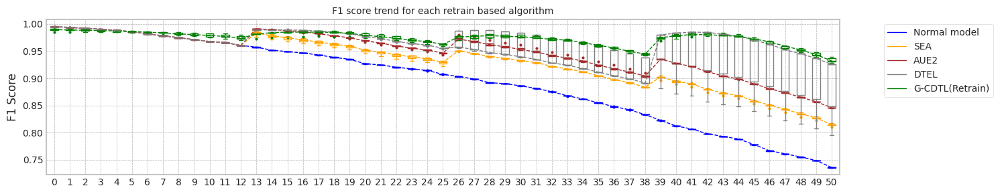

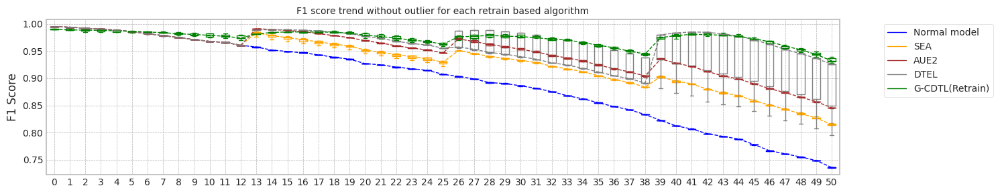

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.656697511672974
Base flops (train + inference flops of normal model, median): 6510645000.0


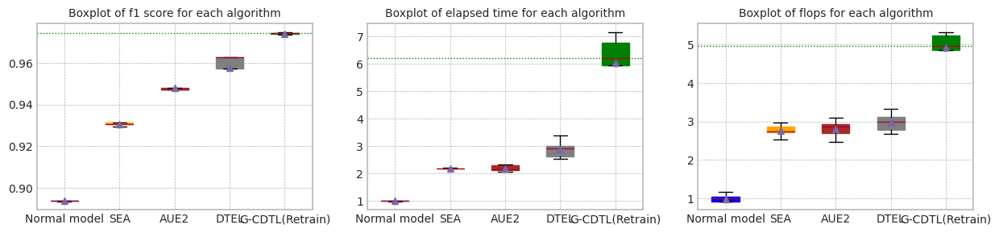

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.656697511672974


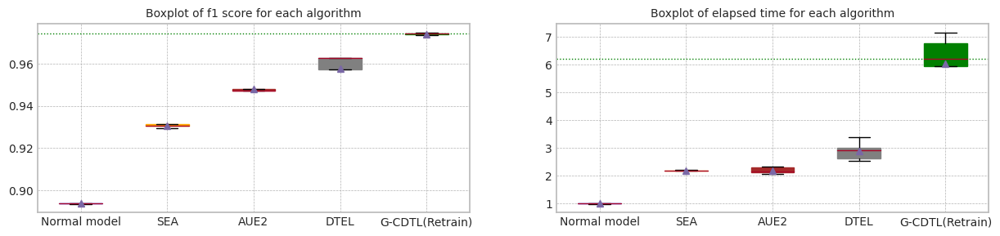

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.562472,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.739250,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.772475,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.602808,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.656698,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.656698,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.088738,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.777356,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,10.032608,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.727358,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,10.110564,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.808489,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.808489,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.169383,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.929586,0.817441,20.248605,8.750460e+09,9.141960e+09,1.789242e+10
1,1.0,0.994876,0.993988,0.931390,0.814130,21.470206,8.970570e+09,7.494615e+09,1.646518e+10
2,2.0,0.994390,0.993786,0.930634,0.809749,21.139359,8.896185e+09,8.806140e+09,1.770232e+10
3,3.0,0.994775,0.993983,0.930543,0.815656,21.011401,8.910975e+09,1.041825e+10,1.932922e+10
4,4.0,0.995157,0.994175,0.931310,0.814782,21.228620,8.971440e+09,9.668310e+09,1.863975e+10
5,median,0.994875,0.993983,0.930634,0.814782,21.139359,8.910975e+09,9.141960e+09,1.789242e+10
6,std,0.000277,0.000144,0.000728,0.002858,0.462487,9.025102e+07,1.086964e+09,1.076080e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.948054,0.845430,22.263714,9.226350e+09,9.817515e+09,1.904386e+10
1,1.0,0.994876,0.993988,0.947420,0.845731,19.979269,8.672160e+09,7.395870e+09,1.606803e+10
2,2.0,0.994390,0.993786,0.947299,0.845921,20.449907,8.740020e+09,8.849640e+09,1.758966e+10
3,3.0,0.994775,0.993983,0.949103,0.845990,22.637016,9.226350e+09,1.093329e+10,2.015964e+10
4,4.0,0.995157,0.994175,0.947438,0.845086,20.786957,8.856600e+09,9.753135e+09,1.860974e+10
5,median,0.994875,0.993983,0.947438,0.845731,20.786957,8.856600e+09,9.753135e+09,1.860974e+10
6,std,0.000277,0.000144,0.000753,0.000374,1.163744,2.657942e+08,1.318795e+09,1.548680e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.962626,0.925844,28.237009,1.037866e+10,9.135870e+09,1.951454e+10
1,1.0,0.994876,0.993988,0.957164,0.848947,28.924185,1.047915e+10,7.602930e+09,1.808208e+10
2,2.0,0.994390,0.993786,0.933171,0.795065,24.412240,9.571740e+09,7.847400e+09,1.741914e+10
3,3.0,0.994775,0.993983,0.962649,0.925718,25.233075,9.799245e+09,1.051221e+10,2.031146e+10
4,4.0,0.995157,0.994175,0.973573,0.925575,32.734912,1.127955e+10,1.034212e+10,2.162168e+10
5,median,0.994875,0.993983,0.962626,0.925575,28.237009,1.037866e+10,9.135870e+09,1.951454e+10
6,std,0.000277,0.000144,0.015021,0.059912,3.309665,6.668781e+08,1.355361e+09,1.691146e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.973853,0.931022,65.313450,3.398750e+10,107460000.0,3.409496e+10
1,1.0,0.985570,0.985016,0.973425,0.939863,60.024372,3.223664e+10,107460000.0,3.234410e+10
2,2.0,0.991229,0.990418,0.974186,0.928522,57.389231,3.152942e+10,107460000.0,3.163688e+10
3,3.0,0.989726,0.989077,0.974888,0.936715,69.167862,3.457089e+10,107460000.0,3.467835e+10
4,4.0,0.989262,0.988322,0.974439,0.932093,39.843842,2.740634e+10,107460000.0,2.751380e+10
5,median,0.989726,0.989077,0.974186,0.932093,60.024372,3.223664e+10,107460000.0,3.234410e+10
6,std,0.002347,0.002288,0.000557,0.004572,11.310617,2.825081e+09,0.0,2.825081e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 02:05:48,283] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:05<00:01, 302.31it/s]


Early stop: 1611
[2023-11-29 02:05:53,619] [INFO] [profiler.py:226:end_profile] Flops profiler finished
Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:06:03,195] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:06:03,197] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:05<00:15, 96.30it/s]

[2023-11-29 02:06:22,674] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:06:22,675] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 02:06:32,428] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 309.88it/s]

Early stop: 1134
[2023-11-29 02:06:36,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.44it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:06:45,555] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:06:45,557] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:06<00:14, 94.30it/s]

[2023-11-29 02:07:06,981] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:07:06,983] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 02:07:16,618] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:04<00:01, 307.46it/s]

Early stop: 1488
[2023-11-29 02:07:21,464] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:07:31,080] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:07:31,083] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:05<00:15, 94.79it/s]

[2023-11-29 02:07:37,060] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:07:37,061] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 02:07:46,819] [INFO] [profiler.py:80:start_profile] Flops profiler started



 95%|█████████▍| 1896/2000 [00:06<00:00, 306.34it/s]

Early stop: 1896
[2023-11-29 02:07:53,014] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:08:02,604] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:08:02,606] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:05<00:15, 95.39it/s]

[2023-11-29 02:08:22,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:08:22,395] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 02:08:32,142] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:05<00:01, 301.71it/s]

Early stop: 1689
[2023-11-29 02:08:37,745] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:08:47,233] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:08:47,235] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:04<00:16, 93.72it/s]

[2023-11-29 02:08:57,312] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:08:57,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.22it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:09:09,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:09:09,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:09:32,283] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:09:32,285] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:25<03:17,  5.08s/it]

G-CDTL train flops: 3500000000 1421000000 353220000 5274220000


 41%|████      | 21/51 [00:26<00:11,  2.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:09:34,390] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:09:34,393] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:09:53,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:09:53,887] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:46<02:02,  4.38s/it]

G-CDTL train flops: 3500000000 897750000 223155000 4620905000


 63%|██████▎   | 32/51 [00:48<00:06,  2.75it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:09:56,003] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:09:56,006] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:10:01,420] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:10:01,421] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:54<00:34,  1.94s/it]

G-CDTL train flops: 71750000 871500000 216630000 1159880000


 84%|████████▍ | 43/51 [00:56<00:01,  4.22it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:10:03,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:10:03,557] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:10:09,389] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:10:09,390] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:02<00:08,  1.44s/it]

G-CDTL train flops: 89250000 917000000 227940000 1234190000


100%|██████████| 51/51 [01:03<00:00,  1.24s/it]


Early stop at  [811, 512, 497, 523]
Train flops  [5274220000, 4620905000, 1159880000, 1234190000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9762295069909148
G_CDTL+AUE median: 0.9762295069909148
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:43,  1.12s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:30,  1.08s/it]

Ensemble_SEA train flops: 806925000


 67%|██████▋   | 34/51 [00:18<00:16,  1.06it/s]

Ensemble_SEA train flops: 696435000


 88%|████████▊ | 45/51 [00:24<00:06,  1.01s/it]

Ensemble_SEA train flops: 743850000


100%|██████████| 51/51 [00:25<00:00,  2.00it/s]


Early stop at  [1999, 1854, 1600, 1709]
Train flops  [870000000, 806925000, 696435000, 743850000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9343975881271892
SEA median: 0.9343975881271892
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:44,  1.13s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:25,  1.08it/s]

Ensemble_SEA train flops: 675990000


 67%|██████▋   | 34/51 [00:17<00:15,  1.09it/s]

Ensemble_SEA train flops: 658590000


 88%|████████▊ | 45/51 [00:23<00:05,  1.03it/s]

Ensemble_SEA train flops: 746460000


100%|██████████| 51/51 [00:24<00:00,  2.07it/s]


Early stop at  [1999, 1553, 1513, 1715]
Train flops  [870000000, 675990000, 658590000, 746460000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.954299273445715
AUE median: 0.954299273445715
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:43,  1.11s/it]

Ensemble_DTEL train flops: 812145000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:08<00:06,  4.52it/s]

Ensemble_DTEL train flops: 700785000


 45%|████▌     | 23/51 [00:16<00:52,  1.88s/it]

Ensemble_DTEL train flops: 870000000


 63%|██████▎   | 32/51 [00:18<00:04,  3.92it/s]

Ensemble_DTEL train flops: 870000000


 67%|██████▋   | 34/51 [00:26<00:32,  1.91s/it]

Ensemble_DTEL train flops: 731670000


 84%|████████▍ | 43/51 [00:28<00:02,  3.85it/s]

Ensemble_DTEL train flops: 801270000


 88%|████████▊ | 45/51 [00:37<00:12,  2.01s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:38<00:00,  1.33it/s]


Early stop at  [1866, 4, 1610, 1999, 1999, 1681, 1841, 1999]
Train flops  [812145000, 2175000, 700785000, 870000000, 870000000, 731670000, 801270000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9696550474874767
DTEL median: 0.9696550474874767
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:11:41,711] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:11:41,713] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:12:01,448] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:01,449] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:22<02:51,  4.39s/it]

G-CDTL train flops: 3500000000 878500000 218370000 4596870000


 41%|████      | 21/51 [00:23<00:10,  2.81it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:12:03,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:12:03,556] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:12:22,909] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:22,910] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:43<02:01,  4.34s/it]

G-CDTL train flops: 3500000000 771750000 191835000 4463585000


 63%|██████▎   | 32/51 [00:45<00:06,  2.82it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:12:24,984] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:12:24,989] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:12:30,124] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:30,125] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:50<00:22,  1.35s/it]

G-CDTL train flops: 82250000 796250000 197925000 1076425000


 84%|████████▍ | 43/51 [00:52<00:01,  4.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:12:32,212] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:12:32,215] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:12:52,816] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:12:52,817] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:13<00:27,  4.54s/it]

G-CDTL train flops: 3500000000 927500000 230550000 4658050000


100%|██████████| 51/51 [01:14<00:00,  1.46s/it]


Early stop at  [501, 440, 454, 529]
Train flops  [4596870000, 4463585000, 1076425000, 4658050000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9758188875027252
G_CDTL+AUE median: 0.97602419724682
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:06<01:02,  1.57s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:13<00:32,  1.15s/it]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:19<00:17,  1.01s/it]

Ensemble_SEA train flops: 740370000


 88%|████████▊ | 45/51 [00:25<00:05,  1.01it/s]

Ensemble_SEA train flops: 722535000


100%|██████████| 51/51 [00:26<00:00,  1.95it/s]


Early stop at  [1999, 1999, 1701, 1660]
Train flops  [870000000, 870000000, 740370000, 722535000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.934773750021158
SEA median: 0.9345856690741736
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:33,  1.15it/s]

Ensemble_SEA train flops: 618570000


 45%|████▌     | 23/51 [00:12<00:32,  1.15s/it]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:18<00:17,  1.03s/it]

Ensemble_SEA train flops: 752985000


 88%|████████▊ | 45/51 [00:23<00:05,  1.07it/s]

Ensemble_SEA train flops: 681210000


100%|██████████| 51/51 [00:24<00:00,  2.06it/s]


Early stop at  [1421, 1999, 1730, 1565]
Train flops  [618570000, 870000000, 752985000, 681210000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9542128335520199
AUE median: 0.9542560534988674
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:44,  1.14s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:08<00:06,  4.47it/s]

Ensemble_DTEL train flops: 724710000


 45%|████▌     | 23/51 [00:13<00:32,  1.17s/it]

Ensemble_DTEL train flops: 162255000


 65%|██████▍   | 33/51 [00:19<00:28,  1.56s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


 84%|████████▍ | 43/51 [00:21<00:01,  4.41it/s]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:30<00:12,  2.08s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.59it/s]


Early stop at  [1999, 4, 1665, 372, 1999, 3, 1999, 1999]
Train flops  [870000000, 2175000, 724710000, 162255000, 870000000, 1740000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9588183449803805
DTEL median: 0.9642366962339286
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:14:19,487] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:14:19,489] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:14:24,847] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:14:24,849] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:07<00:51,  1.33s/it]

G-CDTL train flops: 64750000 838250000 208365000 1111365000


 41%|████      | 21/51 [00:09<00:07,  4.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:14:26,963] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:14:26,965] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:14:52,475] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:14:52,477] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:35<03:48,  7.88s/it]

G-CDTL train flops: 3500000000 1764000000 438480000 5702480000


 63%|██████▎   | 32/51 [00:36<00:07,  2.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:14:54,569] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:14:54,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:15:00,789] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:15:00,790] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:43<00:27,  1.60s/it]

G-CDTL train flops: 73500000 997500000 247950000 1318950000


 84%|████████▍ | 43/51 [00:45<00:01,  4.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:15:02,857] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:15:02,860] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:15:24,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:15:24,078] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:06<00:28,  4.67s/it]

G-CDTL train flops: 3500000000 1058750000 263175000 4821925000


100%|██████████| 51/51 [01:07<00:00,  1.33s/it]


Early stop at  [478, 1007, 569, 604]
Train flops  [1111365000, 5702480000, 1318950000, 4821925000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9767017692546248
G_CDTL+AUE median: 0.9762295069909148
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:45,  1.16s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:29,  1.06s/it]

Ensemble_SEA train flops: 786045000


 67%|██████▋   | 34/51 [00:18<00:17,  1.01s/it]

Ensemble_SEA train flops: 739935000


 88%|████████▊ | 45/51 [00:24<00:06,  1.00s/it]

Ensemble_SEA train flops: 729930000


100%|██████████| 51/51 [00:25<00:00,  1.96it/s]


Early stop at  [1999, 1806, 1700, 1677]
Train flops  [870000000, 786045000, 739935000, 729930000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9343320747037359
SEA median: 0.9343975881271892
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:37,  1.04it/s]

Ensemble_SEA train flops: 702090000


 45%|████▌     | 23/51 [00:11<00:27,  1.02it/s]

Ensemble_SEA train flops: 719490000


 65%|██████▍   | 33/51 [00:18<00:28,  1.56s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:24<00:06,  1.15s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:25<00:00,  1.96it/s]


Early stop at  [1613, 1653, 1999, 1999]
Train flops  [702090000, 719490000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.954128375446742
AUE median: 0.9542128335520199
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:36,  1.07it/s]

Ensemble_DTEL train flops: 668160000
Ensemble_DTEL train flops: 1740000


 41%|████      | 21/51 [00:07<00:06,  4.59it/s]

Ensemble_DTEL train flops: 870000000


 45%|████▌     | 23/51 [00:15<00:50,  1.81s/it]

Ensemble_DTEL train flops: 611175000


 67%|██████▋   | 34/51 [00:20<00:13,  1.26it/s]

Ensemble_DTEL train flops: 518520000
Ensemble_DTEL train flops: 2175000


 84%|████████▍ | 43/51 [00:22<00:01,  4.47it/s]

Ensemble_DTEL train flops: 780390000


 88%|████████▊ | 45/51 [00:30<00:11,  2.00s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.59it/s]


Early stop at  [1535, 3, 1999, 1404, 1191, 4, 1793, 1999]
Train flops  [668160000, 1740000, 870000000, 611175000, 518520000, 2175000, 780390000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9589689289004869
DTEL median: 0.9589689289004869
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:16:51,781] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:16:51,783] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:17:13,121] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:17:13,122] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:23<03:04,  4.74s/it]

G-CDTL train flops: 3500000000 1079750000 268395000 4848145000


 41%|████      | 21/51 [00:25<00:11,  2.66it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:17:15,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:17:15,226] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:17:35,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:17:35,096] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:45<02:04,  4.46s/it]

G-CDTL train flops: 3500000000 873250000 217065000 4590315000


 63%|██████▎   | 32/51 [00:47<00:06,  2.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:17:37,158] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:17:37,160] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:17:44,400] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:17:44,401] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:54<00:44,  2.48s/it]

G-CDTL train flops: 89250000 1130500000 281010000 1500760000


 84%|████████▍ | 43/51 [00:56<00:02,  3.93it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:17:46,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:17:46,526] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:18:07,764] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:18:07,765] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:18<00:28,  4.68s/it]

G-CDTL train flops: 3500000000 1053500000 261870000 4815370000


100%|██████████| 51/51 [01:19<00:00,  1.56s/it]


Early stop at  [616, 498, 645, 601]
Train flops  [4848145000, 4590315000, 1500760000, 4815370000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9760231526100681
G_CDTL+AUE median: 0.9761263298004914
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:45,  1.17s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:13<00:32,  1.16s/it]

Ensemble_SEA train flops: 870000000


 67%|██████▋   | 34/51 [00:19<00:16,  1.03it/s]

Ensemble_SEA train flops: 694260000


 88%|████████▊ | 45/51 [00:23<00:04,  1.44it/s]

Ensemble_SEA train flops: 441090000


100%|██████████| 51/51 [00:24<00:00,  2.06it/s]


Early stop at  [1999, 1999, 1595, 1013]
Train flops  [870000000, 870000000, 694260000, 441090000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9329692678485548
SEA median: 0.9343648314154626
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:45,  1.16s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:25,  1.10it/s]

Ensemble_SEA train flops: 633360000


 67%|██████▋   | 34/51 [00:17<00:14,  1.14it/s]

Ensemble_SEA train flops: 624225000


 88%|████████▊ | 45/51 [00:24<00:06,  1.16s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:25<00:00,  2.01it/s]


Early stop at  [1999, 1455, 1434, 1999]
Train flops  [870000000, 633360000, 624225000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9541830725704106
AUE median: 0.9541979530612152
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:37,  1.03it/s]

Ensemble_DTEL train flops: 699480000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:07<00:06,  4.59it/s]

Ensemble_DTEL train flops: 732975000


 45%|████▌     | 23/51 [00:14<00:45,  1.61s/it]

Ensemble_DTEL train flops: 567240000


 67%|██████▋   | 34/51 [00:21<00:18,  1.11s/it]

Ensemble_DTEL train flops: 831285000
Ensemble_DTEL train flops: 2175000


 84%|████████▍ | 43/51 [00:22<00:01,  4.58it/s]

Ensemble_DTEL train flops: 784740000


 88%|████████▊ | 45/51 [00:31<00:11,  1.99s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:32<00:00,  1.56it/s]


Early stop at  [1607, 4, 1684, 1303, 1910, 4, 1803, 1999]
Train flops  [699480000, 2175000, 732975000, 567240000, 831285000, 2175000, 784740000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9593202328828397
DTEL median: 0.9591445808916633
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  4.92it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:19:34,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:19:34,413] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 02:19:43,283] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:19:43,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:11<01:21,  2.09s/it]

G-CDTL train flops: 82250000 1338750000 332775000 1753775000


 41%|████      | 21/51 [00:13<00:08,  3.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:19:45,426] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:19:45,429] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 02:20:06,181] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:20:06,183] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:34<02:08,  4.59s/it]

G-CDTL train flops: 3500000000 887250000 220545000 4607795000


 63%|██████▎   | 32/51 [00:35<00:06,  2.72it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:20:08,282] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:20:08,284] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 02:20:13,728] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:20:13,729] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:41<00:24,  1.42s/it]

G-CDTL train flops: 56000000 831250000 206625000 1093875000


 84%|████████▍ | 43/51 [00:43<00:01,  4.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:20:15,856] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:20:15,859] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 02:20:37,583] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:20:37,584] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:05<00:28,  4.78s/it]

G-CDTL train flops: 3500000000 1037750000 257955000 4795705000


100%|██████████| 51/51 [01:06<00:00,  1.31s/it]


Early stop at  [764, 506, 474, 592]
Train flops  [1753775000, 4607795000, 1093875000, 4795705000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9744134700872766
G_CDTL+AUE median: 0.9760231526100681
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:06<00:40,  1.05s/it]

Ensemble_SEA train flops: 752985000


 45%|████▌     | 23/51 [00:11<00:25,  1.11it/s]

Ensemble_SEA train flops: 625965000


 67%|██████▋   | 34/51 [00:17<00:17,  1.00s/it]

Ensemble_SEA train flops: 685560000


 88%|████████▊ | 45/51 [00:22<00:04,  1.25it/s]

Ensemble_SEA train flops: 526350000


100%|██████████| 51/51 [00:23<00:00,  2.15it/s]


Early stop at  [1730, 1438, 1575, 1209]
Train flops  [752985000, 625965000, 685560000, 526350000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9337358556825294
SEA median: 0.9343320747037359
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:07<00:46,  1.20s/it]

Ensemble_SEA train flops: 870000000


 45%|████▌     | 23/51 [00:12<00:26,  1.06it/s]

Ensemble_SEA train flops: 646845000


 67%|██████▋   | 34/51 [00:18<00:16,  1.04it/s]

Ensemble_SEA train flops: 675120000


 88%|████████▊ | 45/51 [00:25<00:07,  1.17s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:26<00:00,  1.93it/s]


Early stop at  [1999, 1486, 1551, 1999]
Train flops  [870000000, 646845000, 675120000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9540831575954511
AUE median: 0.9541830725704106
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:07<00:46,  1.20s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 41%|████      | 21/51 [00:08<00:06,  4.47it/s]

Ensemble_DTEL train flops: 484155000


 45%|████▌     | 23/51 [00:16<00:47,  1.69s/it]

Ensemble_DTEL train flops: 870000000


 63%|██████▎   | 32/51 [00:17<00:04,  4.09it/s]

Ensemble_DTEL train flops: 639885000


 67%|██████▋   | 34/51 [00:25<00:28,  1.70s/it]

Ensemble_DTEL train flops: 712095000


 84%|████████▍ | 43/51 [00:26<00:01,  4.08it/s]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:35<00:11,  1.85s/it]

Ensemble_DTEL train flops: 609870000


100%|██████████| 51/51 [00:36<00:00,  1.41it/s]


Early stop at  [1999, 4, 1112, 1999, 1470, 1636, 1999, 1401]
Train flops  [870000000, 2175000, 484155000, 870000000, 639885000, 712095000, 870000000, 609870000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.969709855078517
DTEL median: 0.9593202328828397


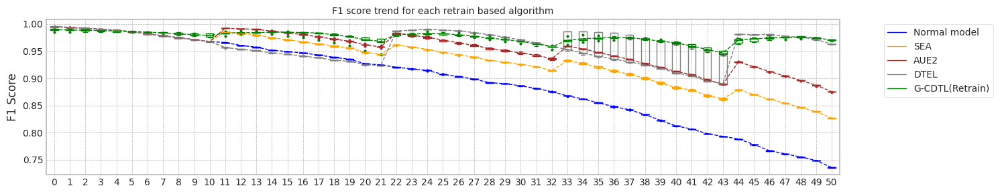

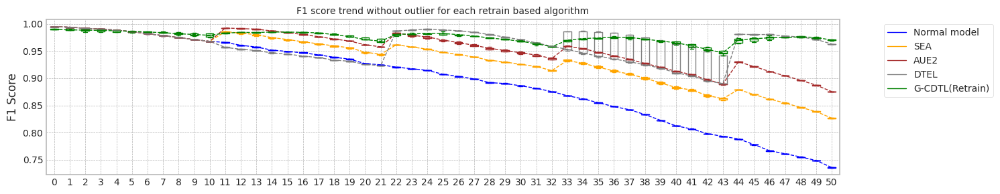

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.558502674102783
Base flops (train + inference flops of normal model, median): 6510645000.0


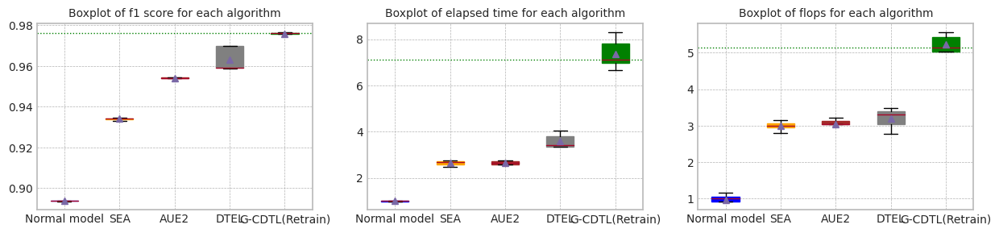

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.558502674102783


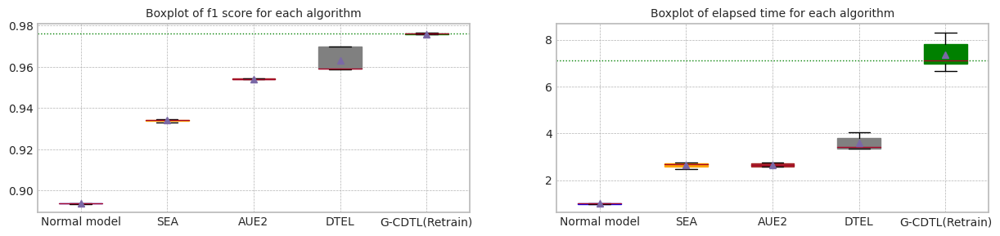

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.558503,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.443442,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.597714,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.572422,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.471229,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.558503,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.067332,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.731510,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.613955,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.733879,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.726424,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.840503,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.731510,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.080163,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.934398,0.826299,25.605523,9.733560e+09,1.019944e+10,1.993300e+10
1,1.0,0.994876,0.993988,0.934774,0.826996,26.243814,9.819255e+09,8.417685e+09,1.823694e+10
2,2.0,0.994390,0.993786,0.934332,0.827195,26.042517,9.742260e+09,9.726600e+09,1.946886e+10
3,3.0,0.994775,0.993983,0.932969,0.825923,24.807083,9.491700e+09,1.107336e+10,2.056506e+10
4,4.0,0.995157,0.994175,0.933736,0.826652,23.829811,9.207210e+09,9.978465e+09,1.918568e+10
5,median,0.994875,0.993983,0.934332,0.826652,25.605523,9.733560e+09,9.978465e+09,1.946886e+10
6,std,0.000277,0.000144,0.000705,0.000515,0.992436,2.510750e+08,9.614756e+08,8.681152e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.954299,0.875385,24.668406,9.567390e+09,1.023294e+10,1.980033e+10
1,1.0,0.994876,0.993988,0.954213,0.875513,24.804852,9.539115e+09,8.337210e+09,1.787632e+10
2,2.0,0.994390,0.993786,0.954128,0.874015,26.033114,9.777930e+09,9.961935e+09,1.973986e+10
3,3.0,0.994775,0.993983,0.954183,0.875670,25.431545,9.613935e+09,1.139526e+10,2.100920e+10
4,4.0,0.995157,0.994175,0.954083,0.875941,26.461757,9.678315e+09,1.064924e+10,2.032755e+10
5,median,0.994875,0.993983,0.954183,0.875513,25.431545,9.613935e+09,1.023294e+10,1.980033e+10
6,std,0.000277,0.000144,0.000083,0.000750,0.772438,9.554238e+07,1.131630e+09,1.165378e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.969655,0.963025,38.536041,1.227440e+10,1.038867e+10,2.266306e+10
1,1.0,0.994876,0.993988,0.958818,0.962805,32.146977,1.098723e+10,7.152270e+09,1.813950e+10
2,2.0,0.994390,0.993786,0.958969,0.963227,32.103321,1.093851e+10,8.897490e+09,1.983600e+10
3,3.0,0.994775,0.993983,0.959320,0.963254,32.760404,1.110642e+10,1.045566e+10,2.156208e+10
4,4.0,0.995157,0.994175,0.969710,0.963016,36.239460,1.167453e+10,1.048306e+10,2.215760e+10
5,median,0.994875,0.993983,0.959320,0.963025,32.760404,1.110642e+10,1.038867e+10,2.156208e+10
6,std,0.000277,0.000144,0.005834,0.000183,2.894842,5.721458e+08,1.461273e+09,1.862574e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.976230,0.971374,63.562151,3.273517e+10,62685000.0,3.279786e+10
1,1.0,0.985570,0.985016,0.975819,0.968295,74.599955,3.524090e+10,62685000.0,3.530359e+10
2,2.0,0.991229,0.990418,0.976702,0.970044,68.050618,3.340070e+10,62685000.0,3.346338e+10
3,3.0,0.989726,0.989077,0.976023,0.971721,79.511802,3.620056e+10,62685000.0,3.626325e+10
4,4.0,0.989262,0.988322,0.974413,0.970176,66.834459,3.269712e+10,62685000.0,3.275981e+10
5,median,0.989726,0.989077,0.976023,0.970176,68.050618,3.340070e+10,62685000.0,3.346338e+10
6,std,0.002347,0.002288,0.000861,0.001348,6.434107,1.583012e+09,0.0,1.583012e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 02:22:10,646] [INFO] [profiler.py:80:start_profile] Flops profiler started


 81%|████████  | 1611/2000 [00:05<00:01, 273.39it/s]

Early stop: 1611
[2023-11-29 02:22:16,545] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 6310980000
precision_recall_fscore: (array([0.99516519, 0.99317794]), array([0.9903769, 0.9965773]), array([0.99276527, 0.99487472]), array([3741, 5259]))
Test f1 score: 0.994874715261959
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8936817573272818
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:22:26,156] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:22:26,158] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 25%|██▌       | 504/2000 [00:05<00:16, 89.70it/s]

[2023-11-29 02:22:47,517] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:22:47,519] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7953750000 1977075000 41430825000
precision_recall_fscore: (array([0.9772549 , 0.99942029]), array([0.99919808, 0.98345693]), array([0.98810468, 0.99137435]), array([3741, 5259]))
Test f1 score: 0.9913743530764808
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]

mean of drift:
x0    0.227109
x1    0.093632
x2    0.067118
x3    0.048782
z0    0.279020
dtype: float64
Mean F1 for all data: 0.9286528576380855
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9286528576380855
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 02:22:57,194] [INFO] [profiler.py:80:start_profile] Flops profiler started



 57%|█████▋    | 1134/2000 [00:03<00:02, 292.56it/s]

Early stop: 1134
[2023-11-29 02:23:01,076] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4443525000
precision_recall_fscore: (array([0.99543134, 0.9929911 ]), array([0.9901096 , 0.99676745]), array([0.99276333, 0.99487569]), array([3741, 5259]))
Test f1 score: 0.9948756879863351
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.43it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893697525044706
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:23:10,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:23:10,555] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 648/2000 [00:07<00:15, 89.18it/s]

[2023-11-29 02:23:33,006] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:23:33,007] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 10221750000 2540835000 44262585000
precision_recall_fscore: (array([1.        , 0.97154997]), array([0.95883454, 1.        ]), array([0.97898472, 0.98556972]), array([3741, 5259]))
Test f1 score: 0.9855697151424287
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]

mean of drift:
x0    0.205251
x1    0.107303
x2    0.065519
x3    0.048743
z0    0.300468
dtype: float64
Mean F1 for all data: 0.9172973647924398
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9229751112152627
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 02:23:42,761] [INFO] [profiler.py:80:start_profile] Flops profiler started



 74%|███████▍  | 1488/2000 [00:05<00:01, 291.99it/s]

Early stop: 1488
[2023-11-29 02:23:47,864] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5829435000
precision_recall_fscore: (array([0.9919829 , 0.99448459]), array([0.99224806, 0.99429549]), array([0.99211546, 0.99439004]), array([3741, 5259]))
Test f1 score: 0.9943900351811353
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.41it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.893568841955213
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:23:57,373] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:23:57,375] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 27%|██▋       | 546/2000 [00:06<00:16, 87.01it/s]

[2023-11-29 02:24:03,874] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:24:03,875] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 409500000 8615250000 2141505000 11166255000
precision_recall_fscore: (array([0.99890591, 0.98334581]), array([0.97620957, 0.9992394 ]), array([0.98742734, 0.9912289 ]), array([3741, 5259]))
Test f1 score: 0.9912288974818447
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.30it/s]


mean of drift:
x0    0.190292
x1    0.113153
x2    0.348355
x3    0.052643
z0    0.214137
dtype: float64
Mean F1 for all data: 0.9192366497574042
inference_flops: 1002915000
Normal model median        : 0.8936817573272818
Drift tolerant model median: 0.9192366497574042
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 02:24:13,597] [INFO] [profiler.py:80:start_profile] Flops profiler started


 95%|█████████▍| 1896/2000 [00:06<00:00, 289.90it/s]

Early stop: 1896
[2023-11-29 02:24:20,144] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7426755000
precision_recall_fscore: (array([0.99383708, 0.99392559]), array([0.99144614, 0.99562654]), array([0.99264017, 0.99477534]), array([3741, 5259]))
Test f1 score: 0.9947753396029259
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.33it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938712889120835
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:24:29,807] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:24:29,809] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 25%|██▌       | 509/2000 [00:05<00:17, 86.17it/s]

[2023-11-29 02:24:51,223] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:24:51,224] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 8032500000 1996650000 41529150000
precision_recall_fscore: (array([0.9726847, 0.9996121]), array([0.99946538, 0.98003423]), array([0.98589321, 0.98972636]), array([3741, 5259]))
Test f1 score: 0.9897263562169946
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.22it/s]

mean of drift:
x0    0.232743
x1    0.121155
x2    0.094547
x3    0.070898
z0    0.210440
dtype: float64
Mean F1 for all data: 0.9144628102878061
inference_flops: 1002915000
Normal model median        : 0.8936896411859939
Drift tolerant model median: 0.9182670072749219
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 02:25:01,089] [INFO] [profiler.py:80:start_profile] Flops profiler started



 84%|████████▍ | 1689/2000 [00:05<00:01, 286.28it/s]


Early stop: 1689
[2023-11-29 02:25:06,997] [INFO] [profiler.py:226:end_profile] Flops profiler finished
Normal discriminator train flops : 6616350000
precision_recall_fscore: (array([0.99490343, 0.9939302 ]), array([0.99144614, 0.99638715]), array([0.99317178, 0.99515716]), array([3741, 5259]))
Test f1 score: 0.9951571550659957
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.8938876883029739
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 02:25:16,561] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:25:16,563] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 414/2000 [00:04<00:17, 88.64it/s]

[2023-11-29 02:25:27,199] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:25:27,200] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6536250000 1624725000 20445975000
precision_recall_fscore: (array([0.97388352, 0.99767937]), array([0.9967923 , 0.98098498]), array([0.98520476, 0.98926174]), array([3741, 5259]))
Test f1 score: 0.9892617449664429
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.27it/s]


mean of drift:
x0    0.225320
x1    0.117394
x2    0.335490
x3    0.445046
z0    0.224534
dtype: float64
Mean F1 for all data: 0.910643452678064
inference_flops: 1002915000
Normal model median        : 0.893697525044706
Drift tolerant model median: 0.9172973647924398
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:25:38,769] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:25:38,772] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:26:00,233] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:00,235] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:23<03:18,  4.83s/it]

G-CDTL train flops: 3500000000 969500000 240990000 4710490000


 33%|███▎      | 17/51 [00:24<00:19,  1.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:01,993] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:01,996] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:26:22,441] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:22,442] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:45<02:29,  4.67s/it]

G-CDTL train flops: 3500000000 808500000 200970000 4509470000


 51%|█████     | 26/51 [00:46<00:13,  1.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:24,141] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:24,144] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:26:45,767] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:45,768] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:08<02:46,  6.94s/it]

G-CDTL train flops: 3500000000 981750000 244035000 4725785000


 69%|██████▊   | 35/51 [01:10<00:09,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:47,448] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:47,451] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:26:54,385] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:26:54,387] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:17<00:25,  1.83s/it]

G-CDTL train flops: 84000000 1055250000 262305000 1401555000


 86%|████████▋ | 44/51 [01:18<00:02,  3.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:26:56,134] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:26:56,136] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:27:05,541] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:27:05,542] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:28<00:11,  2.24s/it]

G-CDTL train flops: 99750000 1436750000 357135000 1893635000


100%|██████████| 51/51 [01:29<00:00,  1.76s/it]


Early stop at  [553, 461, 560, 602, 820]
Train flops  [4710490000, 4509470000, 4725785000, 1401555000, 1893635000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9786878503748764
G_CDTL+AUE median: 0.9786878503748764
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:49,  1.21s/it]

Ensemble_SEA train flops: 870000000


 37%|███▋      | 19/51 [00:11<00:30,  1.05it/s]

Ensemble_SEA train flops: 645975000


 55%|█████▍    | 28/51 [00:18<00:27,  1.21s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:24<00:16,  1.18s/it]

Ensemble_SEA train flops: 853470000


 90%|█████████ | 46/51 [00:30<00:05,  1.16s/it]

Ensemble_SEA train flops: 826935000


100%|██████████| 51/51 [00:31<00:00,  1.62it/s]


Early stop at  [1999, 1484, 1999, 1961, 1900]
Train flops  [870000000, 645975000, 870000000, 853470000, 826935000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9347310464020524
SEA median: 0.9347310464020524
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:39,  1.05it/s]

Ensemble_SEA train flops: 667290000


 37%|███▋      | 19/51 [00:11<00:36,  1.13s/it]

Ensemble_SEA train flops: 810405000


 55%|█████▍    | 28/51 [00:17<00:27,  1.20s/it]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:23<00:24,  1.66s/it]

Ensemble_SEA train flops: 870000000


 90%|█████████ | 46/51 [00:29<00:05,  1.02s/it]

Ensemble_SEA train flops: 714705000


100%|██████████| 51/51 [00:30<00:00,  1.67it/s]


Early stop at  [1533, 1862, 1999, 1999, 1642]
Train flops  [667290000, 810405000, 870000000, 870000000, 714705000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9572858890326973
AUE median: 0.9572858890326973
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:36,  1.11it/s]

Ensemble_DTEL train flops: 609435000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:06<00:08,  4.09it/s]

Ensemble_DTEL train flops: 564630000


 37%|███▋      | 19/51 [00:12<00:43,  1.36s/it]

Ensemble_DTEL train flops: 449790000


 55%|█████▍    | 28/51 [00:16<00:17,  1.29it/s]

Ensemble_DTEL train flops: 489810000
Ensemble_DTEL train flops: 1740000


 69%|██████▊   | 35/51 [00:17<00:03,  4.21it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:27<00:30,  2.15s/it]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:32<00:08,  1.49s/it]

Ensemble_DTEL train flops: 735585000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:34<00:00,  1.50it/s]


Early stop at  [1400, 2, 1297, 1033, 1125, 3, 1999, 1999, 1690, 3]
Train flops  [609435000, 1305000, 564630000, 449790000, 489810000, 1740000, 870000000, 870000000, 735585000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9653331052179359
DTEL median: 0.9653331052179359
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:28:44,776] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:28:44,778] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:28:50,269] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:28:50,270] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:07<00:56,  1.38s/it]

G-CDTL train flops: 71750000 824250000 204885000 1100885000


 33%|███▎      | 17/51 [00:08<00:09,  3.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:28:52,005] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:28:52,007] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:29:09,192] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:29:09,193] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:26<02:59,  5.43s/it]

G-CDTL train flops: 2402750000 1013250000 251865000 3667865000


 51%|█████     | 26/51 [00:27<00:12,  2.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:29:10,895] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:29:10,897] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:29:31,711] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:29:31,713] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:48<01:48,  4.71s/it]

G-CDTL train flops: 3500000000 770000000 191400000 4461400000


 69%|██████▊   | 35/51 [00:50<00:09,  1.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:29:33,486] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:29:33,488] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:29:58,136] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:29:58,137] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:15<01:57,  7.85s/it]

G-CDTL train flops: 3500000000 1394750000 346695000 5241445000


 86%|████████▋ | 44/51 [01:16<00:04,  1.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:29:59,904] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:29:59,907] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:30:21,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:30:21,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:38<00:24,  4.92s/it]

G-CDTL train flops: 3500000000 875000000 217500000 4592500000


100%|██████████| 51/51 [01:39<00:00,  1.95s/it]


Early stop at  [470, 578, 439, 796, 499]
Train flops  [1100885000, 3667865000, 4461400000, 5241445000, 4592500000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9794638733059255
G_CDTL+AUE median: 0.979075861840401
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:42,  1.04s/it]

Ensemble_SEA train flops: 718620000


 37%|███▋      | 19/51 [00:11<00:32,  1.01s/it]

Ensemble_SEA train flops: 685560000


 55%|█████▍    | 28/51 [00:17<00:28,  1.23s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:23<00:15,  1.13s/it]

Ensemble_SEA train flops: 763860000


 90%|█████████ | 46/51 [00:30<00:06,  1.22s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:31<00:00,  1.63it/s]


Early stop at  [1651, 1575, 1999, 1755, 1999]
Train flops  [718620000, 685560000, 870000000, 763860000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9357913224689808
SEA median: 0.9352611844355165
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:50,  1.23s/it]

Ensemble_SEA train flops: 870000000


 37%|███▋      | 19/51 [00:11<00:29,  1.08it/s]

Ensemble_SEA train flops: 605955000


 55%|█████▍    | 28/51 [00:17<00:27,  1.18s/it]

Ensemble_SEA train flops: 846510000


 73%|███████▎  | 37/51 [00:23<00:15,  1.11s/it]

Ensemble_SEA train flops: 770385000


 90%|█████████ | 46/51 [00:29<00:05,  1.12s/it]

Ensemble_SEA train flops: 781695000


100%|██████████| 51/51 [00:30<00:00,  1.66it/s]


Early stop at  [1999, 1392, 1945, 1770, 1796]
Train flops  [870000000, 605955000, 846510000, 770385000, 781695000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9570865482536867
AUE median: 0.957186218643192
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:48,  1.19s/it]

Ensemble_DTEL train flops: 858255000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:07<00:09,  3.75it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:14<00:52,  1.63s/it]

Ensemble_DTEL train flops: 366705000


 55%|█████▍    | 28/51 [00:19<00:21,  1.09it/s]

Ensemble_DTEL train flops: 583770000
Ensemble_DTEL train flops: 1740000


 69%|██████▊   | 35/51 [00:21<00:03,  4.03it/s]

Ensemble_DTEL train flops: 807795000


 73%|███████▎  | 37/51 [00:30<00:29,  2.12s/it]

Ensemble_DTEL train flops: 870000000


 90%|█████████ | 46/51 [00:36<00:06,  1.26s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:37<00:00,  1.35it/s]


Early stop at  [1972, 2, 1999, 842, 1341, 3, 1856, 1999, 1999, 4]
Train flops  [858255000, 1305000, 870000000, 366705000, 583770000, 1740000, 807795000, 870000000, 870000000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9649602104322724
DTEL median: 0.9651466578251042
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:32:04,439] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:32:04,442] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:32:26,483] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:32:26,484] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:23<04:57,  7.08s/it]

G-CDTL train flops: 3500000000 966000000 240120000 4706120000


 33%|███▎      | 17/51 [00:25<00:19,  1.73it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:32:28,256] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:32:28,259] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:32:49,565] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:32:49,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:47<02:35,  4.86s/it]

G-CDTL train flops: 3500000000 871500000 216630000 4588130000


 51%|█████     | 26/51 [00:48<00:14,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:32:51,310] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:32:51,312] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:33:15,580] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:33:15,581] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [01:13<02:06,  5.48s/it]

G-CDTL train flops: 3500000000 1251250000 311025000 5062275000


 69%|██████▊   | 35/51 [01:14<00:10,  1.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:33:17,297] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:33:17,300] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:33:38,059] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:33:38,061] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:35<01:06,  4.77s/it]

G-CDTL train flops: 3500000000 721000000 179220000 4400220000


 86%|████████▋ | 44/51 [01:36<00:03,  1.77it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:33:39,790] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:33:39,793] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:33:46,370] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:33:46,372] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:43<00:08,  1.76s/it]

G-CDTL train flops: 78750000 974750000 242295000 1295795000


100%|██████████| 51/51 [01:44<00:00,  2.06s/it]


Early stop at  [551, 497, 714, 411, 556]
Train flops  [4706120000, 4588130000, 5062275000, 4400220000, 1295795000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9791482821335014
G_CDTL+AUE median: 0.9791482821335014
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:31,  1.30it/s]

Ensemble_SEA train flops: 483720000


 37%|███▋      | 19/51 [00:10<00:37,  1.17s/it]

Ensemble_SEA train flops: 809970000


 55%|█████▍    | 28/51 [00:17<00:28,  1.26s/it]

Ensemble_SEA train flops: 870000000


 73%|███████▎  | 37/51 [00:22<00:14,  1.02s/it]

Ensemble_SEA train flops: 686865000


 90%|█████████ | 46/51 [00:29<00:06,  1.23s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:30<00:00,  1.68it/s]


Early stop at  [1111, 1861, 1999, 1578, 1999]
Train flops  [483720000, 809970000, 870000000, 686865000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9363481843331967
SEA median: 0.9357913224689808
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:42,  1.03s/it]

Ensemble_SEA train flops: 696870000


 37%|███▋      | 19/51 [00:12<00:39,  1.24s/it]

Ensemble_SEA train flops: 870000000


 55%|█████▍    | 28/51 [00:17<00:23,  1.01s/it]

Ensemble_SEA train flops: 672945000


 73%|███████▎  | 37/51 [00:23<00:14,  1.02s/it]

Ensemble_SEA train flops: 685125000


 90%|█████████ | 46/51 [00:29<00:06,  1.20s/it]

Ensemble_SEA train flops: 860430000


100%|██████████| 51/51 [00:30<00:00,  1.67it/s]


Early stop at  [1601, 1999, 1546, 1574, 1977]
Train flops  [696870000, 870000000, 672945000, 685125000, 860430000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9574449692310932
AUE median: 0.9572858890326973
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:50,  1.23s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:07<00:09,  3.69it/s]

Ensemble_DTEL train flops: 476760000


 37%|███▋      | 19/51 [00:14<00:46,  1.45s/it]

Ensemble_DTEL train flops: 546795000


 55%|█████▍    | 28/51 [00:20<00:25,  1.11s/it]

Ensemble_DTEL train flops: 743850000
Ensemble_DTEL train flops: 1740000


 73%|███████▎  | 37/51 [00:26<00:17,  1.25s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 870000


 86%|████████▋ | 44/51 [00:27<00:01,  3.68it/s]

Ensemble_DTEL train flops: 646410000


 90%|█████████ | 46/51 [00:36<00:09,  1.97s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:37<00:00,  1.36it/s]


Early stop at  [1999, 2, 1095, 1256, 1709, 3, 1999, 1, 1485, 1999]
Train flops  [870000000, 1305000, 476760000, 546795000, 743850000, 1740000, 870000000, 870000, 646410000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9564519763031146
DTEL median: 0.9649602104322724
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:35:27,933] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:35:27,936] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:35:56,371] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:35:56,373] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:30<04:19,  6.34s/it]

G-CDTL train flops: 3500000000 1879500000 467190000 5846690000


 33%|███▎      | 17/51 [00:31<00:23,  1.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:35:58,107] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:35:58,110] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:36:19,914] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:19,915] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:53<03:54,  7.09s/it]

G-CDTL train flops: 3500000000 838250000 208365000 4546615000


 51%|█████     | 26/51 [00:55<00:14,  1.71it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:36:21,613] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:36:21,616] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:36:27,386] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:27,388] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [01:01<00:36,  1.60s/it]

G-CDTL train flops: 66500000 847000000 210540000 1124040000


 69%|██████▊   | 35/51 [01:02<00:04,  3.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:36:29,108] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:36:29,111] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:36:35,487] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:35,488] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:09<00:22,  1.59s/it]

G-CDTL train flops: 78750000 929250000 230985000 1238985000


 86%|████████▋ | 44/51 [01:10<00:02,  3.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:36:37,226] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:36:37,228] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:36:46,327] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:36:46,328] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:20<00:10,  2.16s/it]

G-CDTL train flops: 89250000 1286250000 319725000 1695225000


100%|██████████| 51/51 [01:21<00:00,  1.59s/it]


Early stop at  [1073, 478, 483, 530, 734]
Train flops  [5846690000, 4546615000, 1124040000, 1238985000, 1695225000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9793768053624848
G_CDTL+AUE median: 0.9792625437479932
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:15,  2.60it/s]

Ensemble_SEA train flops: 165735000


 35%|███▌      | 18/51 [00:09<00:54,  1.65s/it]

Ensemble_SEA train flops: 870000000


 55%|█████▍    | 28/51 [00:14<00:22,  1.02it/s]

Ensemble_SEA train flops: 640320000


 71%|███████   | 36/51 [00:18<00:16,  1.07s/it]

Ensemble_SEA train flops: 493290000


 88%|████████▊ | 45/51 [00:24<00:09,  1.51s/it]

Ensemble_SEA train flops: 774735000


100%|██████████| 51/51 [00:26<00:00,  1.95it/s]


Early stop at  [380, 1999, 1471, 1133, 1780]
Train flops  [165735000, 870000000, 640320000, 493290000, 774735000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9382656272561997
SEA median: 0.9360697534010887
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:47,  1.17s/it]

Ensemble_SEA train flops: 803010000


 37%|███▋      | 19/51 [00:12<00:36,  1.13s/it]

Ensemble_SEA train flops: 759075000


 55%|█████▍    | 28/51 [00:17<00:20,  1.13it/s]

Ensemble_SEA train flops: 561585000


 73%|███████▎  | 37/51 [00:22<00:12,  1.09it/s]

Ensemble_SEA train flops: 598560000


 90%|█████████ | 46/51 [00:28<00:06,  1.22s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:29<00:00,  1.71it/s]


Early stop at  [1845, 1744, 1290, 1375, 1999]
Train flops  [803010000, 759075000, 561585000, 598560000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9563285703961034
AUE median: 0.957186218643192
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:50,  1.23s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


 33%|███▎      | 17/51 [00:08<00:09,  3.75it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:14<00:46,  1.46s/it]

Ensemble_DTEL train flops: 204015000


 53%|█████▎    | 27/51 [00:18<00:24,  1.02s/it]

Ensemble_DTEL train flops: 450660000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:19<00:03,  4.17it/s]

Ensemble_DTEL train flops: 815625000


 73%|███████▎  | 37/51 [00:29<00:30,  2.17s/it]

Ensemble_DTEL train flops: 870000000


 88%|████████▊ | 45/51 [00:35<00:09,  1.57s/it]

Ensemble_DTEL train flops: 769515000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:36<00:00,  1.40it/s]


Early stop at  [1999, 3, 1999, 468, 1035, 4, 1874, 1999, 1768, 4]
Train flops  [870000000, 1740000, 870000000, 204015000, 450660000, 2175000, 815625000, 870000000, 769515000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9651325027200389
DTEL median: 0.9650463565761557
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:38:21,792] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:38:21,794] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 02:38:48,955] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:38:48,956] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:29<04:08,  6.06s/it]

G-CDTL train flops: 3500000000 1706250000 424125000 5630375000


 33%|███▎      | 17/51 [00:30<00:22,  1.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:38:50,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:38:50,670] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 02:39:11,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:39:11,887] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:51<02:36,  4.88s/it]

G-CDTL train flops: 3500000000 752500000 187050000 4439550000


 51%|█████     | 26/51 [00:53<00:14,  1.74it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:39:13,589] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:39:13,592] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 02:39:34,657] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:39:34,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:14<02:42,  6.78s/it]

G-CDTL train flops: 3500000000 754250000 187485000 4441735000


 69%|██████▊   | 35/51 [01:16<00:09,  1.75it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:39:36,383] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:39:36,386] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 02:39:43,161] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:39:43,162] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:23<00:37,  2.49s/it]

G-CDTL train flops: 77000000 987000000 245340000 1309340000


 86%|████████▋ | 44/51 [01:24<00:02,  3.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 02:39:44,881] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 02:39:44,884] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 02:40:08,809] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 02:40:08,810] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:48<00:26,  5.28s/it]

G-CDTL train flops: 3500000000 1174250000 291885000 4966135000


100%|██████████| 51/51 [01:49<00:00,  2.15s/it]


Early stop at  [974, 429, 430, 563, 670]
Train flops  [5630375000, 4439550000, 4441735000, 1309340000, 4966135000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9791924668469494
G_CDTL+AUE median: 0.9791924668469494
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:44,  1.07s/it]

Ensemble_SEA train flops: 710355000


 37%|███▋      | 19/51 [00:10<00:27,  1.15it/s]

Ensemble_SEA train flops: 538965000


 55%|█████▍    | 28/51 [00:17<00:28,  1.26s/it]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:23<00:26,  1.76s/it]

Ensemble_SEA train flops: 870000000


 90%|█████████ | 46/51 [00:30<00:06,  1.25s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:31<00:00,  1.61it/s]


Early stop at  [1632, 1238, 1999, 1999, 1999]
Train flops  [710355000, 538965000, 870000000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9353858549850839
SEA median: 0.9357913224689808
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:35,  1.16it/s]

Ensemble_SEA train flops: 556800000


 37%|███▋      | 19/51 [00:10<00:31,  1.01it/s]

Ensemble_SEA train flops: 652500000


 55%|█████▍    | 28/51 [00:16<00:24,  1.05s/it]

Ensemble_SEA train flops: 694260000


 71%|███████   | 36/51 [00:21<00:22,  1.49s/it]

Ensemble_SEA train flops: 725145000


 90%|█████████ | 46/51 [00:28<00:06,  1.27s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:29<00:00,  1.73it/s]


Early stop at  [1279, 1499, 1595, 1666, 1999]
Train flops  [556800000, 652500000, 694260000, 725145000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9575094606587795
AUE median: 0.9572858890326973
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:06<00:46,  1.13s/it]

Ensemble_DTEL train flops: 770820000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:07<00:08,  3.84it/s]

Ensemble_DTEL train flops: 64815000


 37%|███▋      | 19/51 [00:10<00:26,  1.19it/s]

Ensemble_DTEL train flops: 460230000


 53%|█████▎    | 27/51 [00:12<00:05,  4.32it/s]

Ensemble_DTEL train flops: 1740000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:13<00:02,  5.34it/s]

Ensemble_DTEL train flops: 710790000


 73%|███████▎  | 37/51 [00:23<00:28,  2.04s/it]

Ensemble_DTEL train flops: 870000000


 90%|█████████ | 46/51 [00:28<00:05,  1.12s/it]

Ensemble_DTEL train flops: 715140000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:29<00:00,  1.71it/s]


Early stop at  [1771, 2, 148, 1057, 3, 4, 1633, 1999, 1643, 3]
Train flops  [770820000, 1305000, 64815000, 460230000, 1740000, 2175000, 710790000, 870000000, 715140000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.010061
dtype: float64
Mean F1 for all data: 0.9655878817372432
DTEL median: 0.9651325027200389


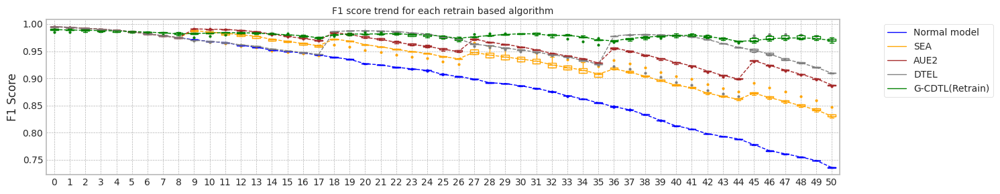

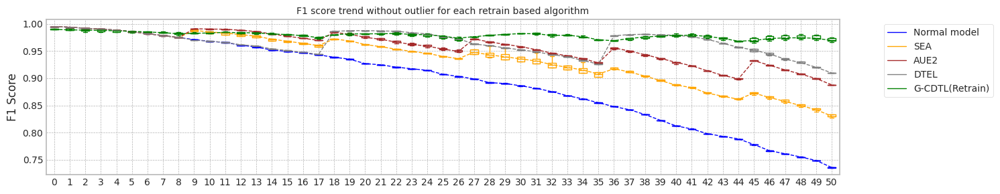

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.54557490348816
Base flops (train + inference flops of normal model, median): 6510645000.0


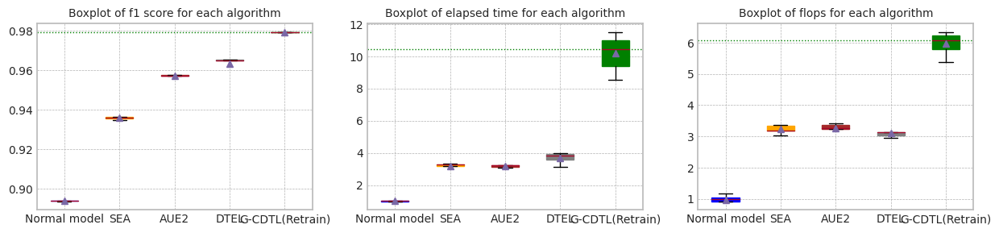

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.54557490348816


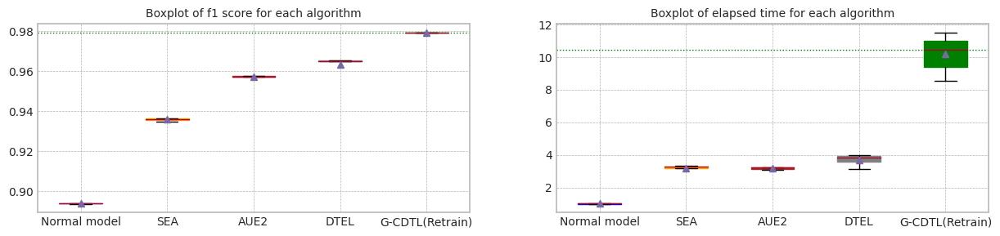

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.893682,0.735588,9.590554,6.310980e+09,199665000.0,6.510645e+09
1,1.0,0.994876,0.993988,0.893698,0.736048,9.458447,4.443525e+09,199665000.0,4.643190e+09
2,2.0,0.994390,0.993786,0.893569,0.735529,9.488317,5.829435e+09,199665000.0,6.029100e+09
3,3.0,0.994775,0.993983,0.893871,0.735823,9.641612,7.426755e+09,199665000.0,7.626420e+09
4,4.0,0.995157,0.994175,0.893888,0.736014,9.545575,6.616350e+09,199665000.0,6.816015e+09
5,median,0.994875,0.993983,0.893698,0.735823,9.545575,6.310980e+09,199665000.0,6.510645e+09
6,std,0.000277,0.000144,0.000136,0.000238,0.074353,1.105135e+09,0.0,1.105135e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.928653,0.794588,9.654038,4.143082e+10,1.002915e+09,4.243374e+10
1,1.0,0.985570,0.985016,0.917297,0.771054,9.729351,4.426258e+10,1.002915e+09,4.526550e+10
2,2.0,0.991229,0.990418,0.919237,0.785431,9.696723,1.116626e+10,1.002915e+09,1.216917e+10
3,3.0,0.989726,0.989077,0.914463,0.767526,9.843629,4.152915e+10,1.002915e+09,4.253206e+10
4,4.0,0.989262,0.988322,0.910643,0.767120,9.738849,2.044598e+10,1.002915e+09,2.144889e+10
5,median,0.989726,0.989077,0.917297,0.771054,9.729351,4.143082e+10,1.002915e+09,4.243374e+10
6,std,0.002347,0.002288,0.006748,0.012279,0.070420,1.497819e+10,0.000000e+00,1.497819e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.934731,0.826966,31.521029,1.068273e+10,1.125040e+10,2.193314e+10
1,1.0,0.994876,0.993988,0.935791,0.829778,31.303232,1.052439e+10,9.224610e+09,1.974900e+10
2,2.0,0.994390,0.993786,0.936348,0.830373,30.406723,1.033690e+10,1.042304e+10,2.075994e+10
3,3.0,0.994775,0.993983,0.938266,0.847690,26.216778,9.560430e+09,1.124388e+10,2.080431e+10
4,4.0,0.995157,0.994175,0.935386,0.833092,31.793347,1.047567e+10,1.134872e+10,2.182438e+10
5,median,0.994875,0.993983,0.935791,0.830373,31.303232,1.047567e+10,1.124388e+10,2.080431e+10
6,std,0.000277,0.000144,0.001345,0.008182,2.312907,4.400951e+08,9.045786e+08,8.958619e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.957286,0.887969,30.659409,1.054875e+10,1.131609e+10,2.186484e+10
1,1.0,0.994876,0.993988,0.957087,0.885931,30.862051,1.049090e+10,9.390780e+09,1.988168e+10
2,2.0,0.994390,0.993786,0.957445,0.887970,30.660167,1.040172e+10,1.068752e+10,2.108924e+10
3,3.0,0.994775,0.993983,0.956329,0.887180,29.893865,1.020858e+10,1.209170e+10,2.230028e+10
4,4.0,0.995157,0.994175,0.957509,0.888199,29.597255,1.011506e+10,1.118776e+10,2.130282e+10
5,median,0.994875,0.993983,0.957286,0.887969,30.659409,1.040172e+10,1.118776e+10,2.130282e+10
6,std,0.000277,0.000144,0.000477,0.000933,0.553991,1.851902e+08,9.991155e+08,9.185480e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.994875,0.993892,0.965333,0.909309,34.102743,1.121038e+10,9.173715e+09,2.038410e+10
1,1.0,0.994876,0.993988,0.964960,0.909794,37.911434,1.184810e+10,7.358025e+09,1.920612e+10
2,2.0,0.994390,0.993786,0.956452,0.971524,37.541142,1.164408e+10,8.699130e+09,2.034321e+10
3,3.0,0.994775,0.993983,0.965133,0.909859,36.452863,1.147226e+10,1.007895e+10,2.155120e+10
4,4.0,0.995157,0.994175,0.965588,0.910157,29.812575,1.021510e+10,9.469515e+09,1.968462e+10
5,median,0.994875,0.993983,0.965133,0.909859,36.452863,1.147226e+10,9.173715e+09,2.034321e+10
6,std,0.000277,0.000144,0.003943,0.027615,3.340074,6.385678e+08,1.023672e+09,8.842852e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.991374,0.990734,0.978688,0.969322,89.754172,3.768691e+10,53730000.0,3.774064e+10
1,1.0,0.985570,0.985016,0.979464,0.975099,99.524677,3.951007e+10,53730000.0,3.956380e+10
2,2.0,0.991229,0.990418,0.979148,0.973367,104.923110,4.049852e+10,53730000.0,4.055224e+10
3,3.0,0.989726,0.989077,0.979377,0.965970,81.311855,3.489753e+10,53730000.0,3.495126e+10
4,4.0,0.989262,0.988322,0.979192,0.969495,109.925741,4.123311e+10,53730000.0,4.128684e+10
5,median,0.989726,0.989077,0.979192,0.969495,99.524677,3.951007e+10,53730000.0,3.956380e+10
6,std,0.002347,0.002288,0.000301,0.003612,11.562933,2.538276e+09,0.0,2.538276e+09


Test F1 Score: 0.9948145866196703
G-CDTL, 1-retrain: 0.9528377346941299


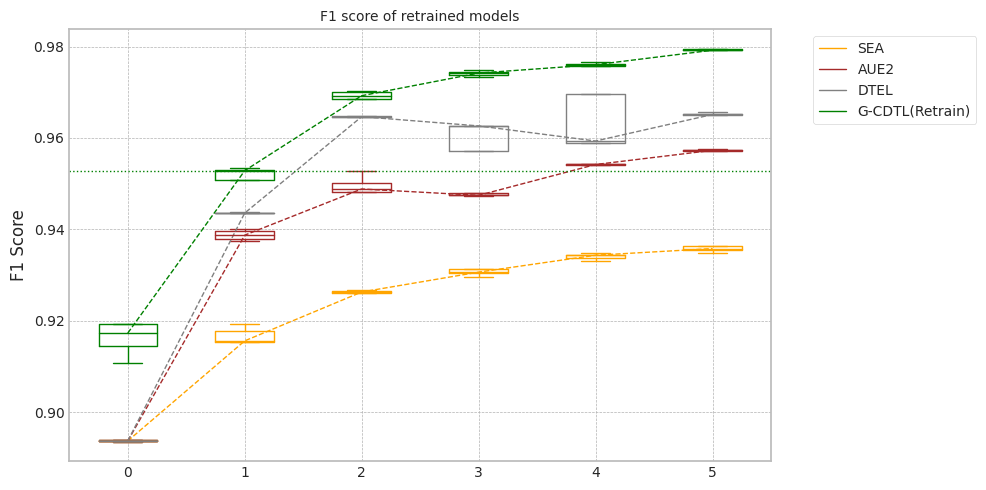

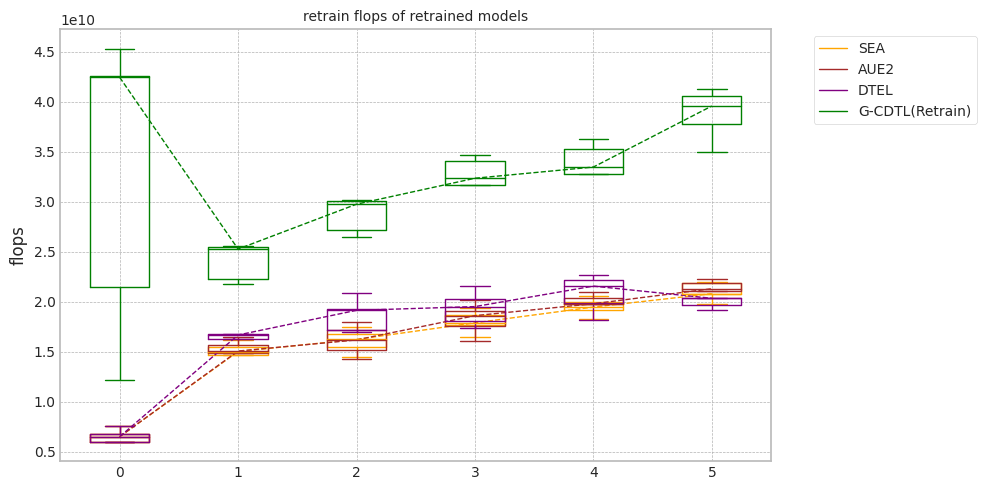

In [ ]:
experiment_all(2000,'case2',X1, Y1,train_size, test_size,avaible_range = 300,
               lambda_f2=0.8,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

## synthetic data의 생성 (Case #3 MI의 증감(상대적), Drift의 증가)

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ 이때 대상 feature $z_0$에 대해서 MI 증가, ks-test 통계량 증가
+ 이에따라 $X_0$의 MI 감소

+ 5개의 feature
+ 각각 importance를 부여
+ 그 중, 1개의 feature는 가변 data drift, MI는 고정

### Dataset 준비

In [ ]:
import matplotlib.pyplot as plt

cor = np.asarray([2.5, 1.2, 0.9 , 0.7, 1.5])
data_size = 60000
seed_everything()

x1 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x1[:,ix] = np.random.normal(1,cor_,data_size)

seed_everything()

y1_array = []
cor_const = cor[0]
for ii in range(x1.shape[0]):
    cor[0] = cor[0] - cor_const / x1.shape[0]
    e = np.random.normal(0.0, 1.0)
    e1 = np.random.normal(0.0,  6*ii/60000)
    x1[ii,4] = x1[ii,4] + e1
    y1_array.append(np.sum(cor * x1[ii])+e)

In [ ]:
m = np.mean(y1_array)
print(m)
y1 = [1 if y_ > m else 0 for y_ in y1_array]
sum(y1)

5.588707982526439


30197

### 실험

MI Analysis MI Max 0.25674, Min 0.00115, Mean 0.07258, Std 0.09686
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:09<00:00,  5.14it/s]


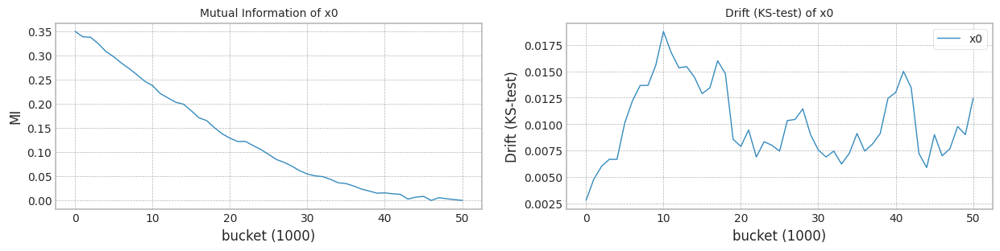

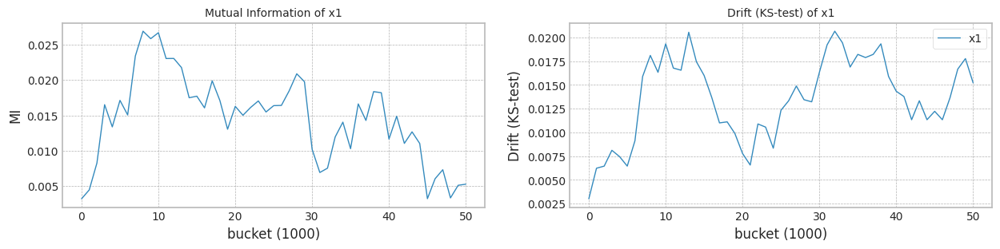

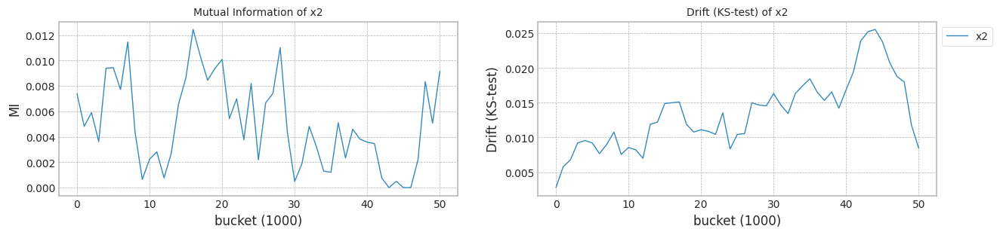

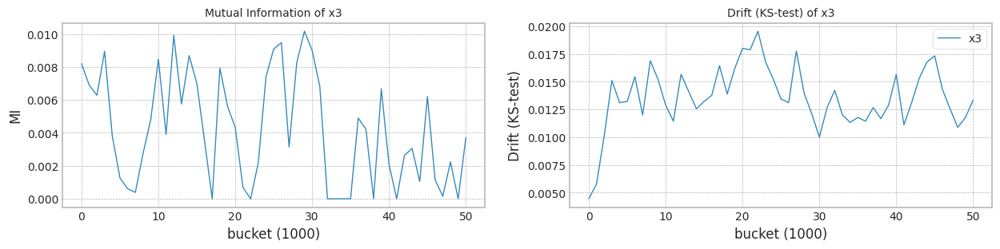

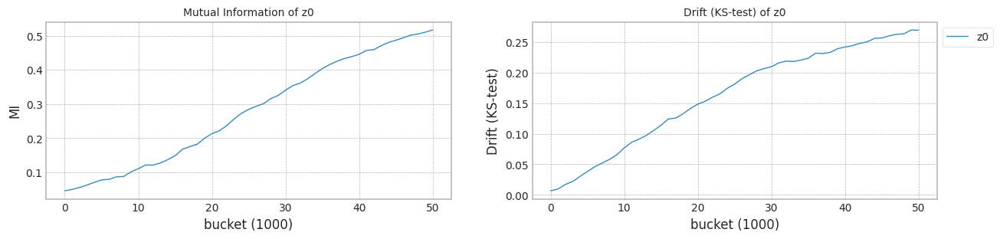

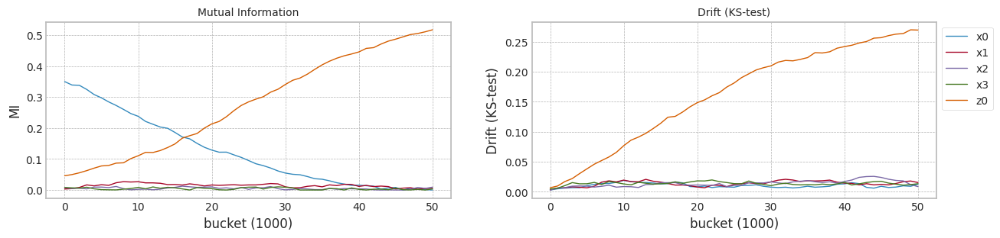

In [ ]:
columns=['x0','x1','x2','x3','z0']
X1 = pd.DataFrame(x1,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X1, y1,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.444809,0.549493,0.334264,0.503728,0
1,0.610533,0.615178,0.580336,0.386537,0.446379,0
2,0.556874,0.639435,0.724770,0.481368,0.071687,0
3,0.344341,0.459348,0.528780,0.367451,0.742993,0
4,0.503142,0.605841,0.465698,0.400521,0.439129,0
...,...,...,...,...,...,...
59995,0.480638,0.384668,0.703331,0.287800,0.877706,59
59996,0.288861,0.418546,0.215280,0.307386,0.776950,59
59997,0.662003,0.594007,0.488092,0.450741,-0.117448,59
59998,0.655881,0.383029,0.773189,0.490745,0.792410,59


trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 13:46:57,733] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 454.06it/s]

Early stop: 1050
[2023-11-29 13:47:00,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:47:10,286] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 13:47:10,288] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:02<00:10, 151.74it/s]

[2023-11-29 13:47:21,975] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:47:21,976] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.85it/s]

mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 13:47:32,591] [INFO] [profiler.py:80:start_profile] Flops profiler started



 41%|████      | 818/2000 [00:01<00:02, 455.84it/s]

Early stop: 818
[2023-11-29 13:47:34,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:47:44,512] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:47:44,514] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:02<00:10, 152.10it/s]

[2023-11-29 13:47:56,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:47:56,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.00it/s]


mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 13:48:06,390] [INFO] [profiler.py:80:start_profile] Flops profiler started


 33%|███▎      | 668/2000 [00:01<00:02, 460.06it/s]

Early stop: 668
[2023-11-29 13:48:07,846] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.12it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:48:17,896] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:48:17,898] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:03<00:09, 153.28it/s]

[2023-11-29 13:48:21,174] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:48:21,175] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.08it/s]

mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 13:48:31,315] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 857/2000 [00:01<00:02, 456.42it/s]

Early stop: 857
[2023-11-29 13:48:33,199] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.14it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:48:43,204] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:48:43,206] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:02<00:10, 148.54it/s]

[2023-11-29 13:48:55,096] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:48:55,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 13:49:05,331] [INFO] [profiler.py:80:start_profile] Flops profiler started


 46%|████▌     | 915/2000 [00:02<00:02, 450.97it/s]

Early stop: 915
[2023-11-29 13:49:07,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.88it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:49:17,921] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:49:17,923] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:02<00:10, 151.44it/s]

[2023-11-29 13:49:23,986] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:49:23,987] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:05<00:05,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:49:39,504] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:49:39,507] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:49:43,097] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:49:43,099] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:09<00:22,  1.05it/s]

G-CDTL train flops: 77000000 962500000 239250000 1278750000


100%|██████████| 51/51 [00:13<00:00,  3.73it/s]


Early stop at  [549]
Train flops  [1278750000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9363882679917808
G_CDTL+AUE median: 0.9363882679917808
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:07<00:21,  1.15it/s]

Ensemble_SEA train flops: 653370000


100%|██████████| 51/51 [00:12<00:00,  4.12it/s]


Early stop at  [1501]
Train flops  [653370000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.906057081440001
SEA median: 0.906057081440001
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.24it/s]

Ensemble_SEA train flops: 335820000


100%|██████████| 51/51 [00:11<00:00,  4.58it/s]


Early stop at  [771]
Train flops  [335820000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9208709129591179
AUE median: 0.9208709129591179
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.23it/s]

Ensemble_DTEL train flops: 382800000


 53%|█████▎    | 27/51 [00:09<00:26,  1.11s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:14<00:00,  3.57it/s]


Early stop at  [879, 1999]
Train flops  [382800000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9286408125130783
DTEL median: 0.9286408125130783
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  4.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:50:31,292] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:50:31,295] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:50:42,688] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:50:42,690] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:16<01:30,  3.62s/it]

G-CDTL train flops: 3500000000 859250000 213585000 4572835000


100%|██████████| 51/51 [00:21<00:00,  2.37it/s]


Early stop at  [490]
Train flops  [4572835000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9339898019028635
G_CDTL+AUE median: 0.9351890349473222
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:13,  1.73it/s]

Ensemble_SEA train flops: 533745000


100%|██████████| 51/51 [00:11<00:00,  4.32it/s]


Early stop at  [1226]
Train flops  [533745000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9073215349678466
SEA median: 0.9066893082039238
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.09it/s]

Ensemble_SEA train flops: 388890000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [893]
Train flops  [388890000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9217369036399637
AUE median: 0.9213039082995409
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.12it/s]

Ensemble_DTEL train flops: 537660000


 53%|█████▎    | 27/51 [00:10<00:29,  1.21s/it]

Ensemble_DTEL train flops: 870000000


100%|██████████| 51/51 [00:14<00:00,  3.44it/s]


Early stop at  [1235, 1999]
Train flops  [537660000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9289237730833838
DTEL median: 0.928782292798231
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:51:31,149] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:51:31,152] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:51:35,043] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:51:35,045] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:09<00:34,  1.37s/it]

G-CDTL train flops: 61250000 1039500000 258390000 1359140000


100%|██████████| 51/51 [00:14<00:00,  3.64it/s]


Early stop at  [593]
Train flops  [1359140000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.935583098477541
G_CDTL+AUE median: 0.935583098477541
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  2.00it/s]

Ensemble_SEA train flops: 437610000


100%|██████████| 51/51 [00:11<00:00,  4.49it/s]


Early stop at  [1005]
Train flops  [437610000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.906437617556084
SEA median: 0.906437617556084
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  1.88it/s]

Ensemble_SEA train flops: 460230000


100%|██████████| 51/51 [00:11<00:00,  4.37it/s]


Early stop at  [1057]
Train flops  [460230000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9210303036905882
AUE median: 0.9210303036905882
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.01it/s]

Ensemble_DTEL train flops: 629010000


 51%|█████     | 26/51 [00:09<00:39,  1.56s/it]

Ensemble_DTEL train flops: 682515000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [1445, 1568]
Train flops  [629010000, 682515000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9284661892439404
DTEL median: 0.9286408125130783
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  4.93it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:52:23,039] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:52:23,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:52:35,046] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:52:35,048] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:17<01:35,  3.81s/it]

G-CDTL train flops: 3500000000 948500000 235770000 4684270000


100%|██████████| 51/51 [00:22<00:00,  2.30it/s]


Early stop at  [541]
Train flops  [4684270000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.93802222514402
G_CDTL+AUE median: 0.9359856832346609
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.55it/s]

Ensemble_SEA train flops: 617700000


100%|██████████| 51/51 [00:12<00:00,  4.21it/s]


Early stop at  [1419]
Train flops  [617700000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9066894221892776
SEA median: 0.9065635198726808
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:12,  1.85it/s]

Ensemble_SEA train flops: 465885000


100%|██████████| 51/51 [00:11<00:00,  4.34it/s]


Early stop at  [1070]
Train flops  [465885000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9213492465465001
AUE median: 0.9211897751185442
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.16it/s]

Ensemble_DTEL train flops: 723840000


 53%|█████▎    | 27/51 [00:10<00:28,  1.21s/it]

Ensemble_DTEL train flops: 651630000


100%|██████████| 51/51 [00:14<00:00,  3.45it/s]


Early stop at  [1663, 1497]
Train flops  [723840000, 651630000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9285017503257156
DTEL median: 0.9285712814193969
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.15it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:53:24,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:53:24,077] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 13:53:35,711] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:53:35,713] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:16<01:32,  3.69s/it]

G-CDTL train flops: 3500000000 826000000 205320000 4531320000


100%|██████████| 51/51 [00:21<00:00,  2.36it/s]


Early stop at  [471]
Train flops  [4531320000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9374760986045484
G_CDTL+AUE median: 0.9363882679917808
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:13,  1.73it/s]

Ensemble_SEA train flops: 525045000


100%|██████████| 51/51 [00:11<00:00,  4.31it/s]


Early stop at  [1206]
Train flops  [525045000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9065335170551364
SEA median: 0.9065335170551364
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:08<00:18,  1.30it/s]

Ensemble_SEA train flops: 779085000


100%|██████████| 51/51 [00:12<00:00,  3.98it/s]


Early stop at  [1790]
Train flops  [779085000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.922365657410436
AUE median: 0.9213492465465001
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.08it/s]

Ensemble_DTEL train flops: 443700000


 53%|█████▎    | 27/51 [00:09<00:25,  1.08s/it]

Ensemble_DTEL train flops: 772560000


100%|██████████| 51/51 [00:14<00:00,  3.61it/s]


Early stop at  [1019, 1775]
Train flops  [443700000, 772560000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9287512587370034
DTEL median: 0.9286408125130783


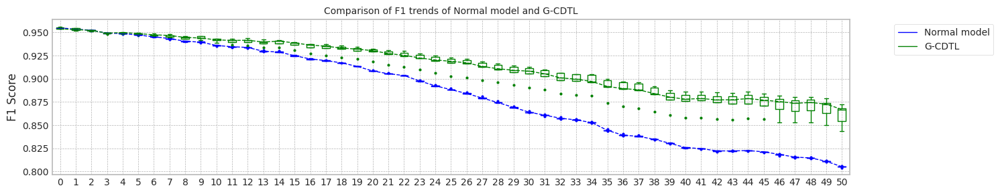

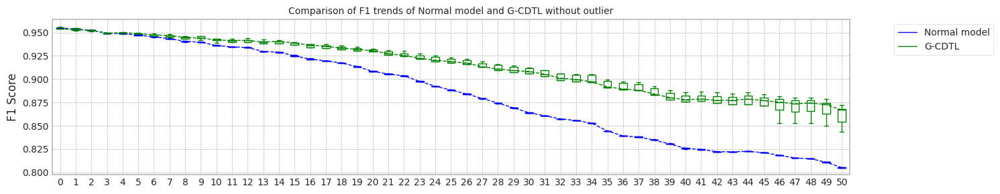

max_mean_trial= 3


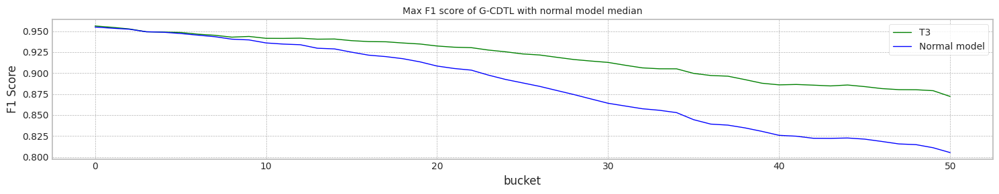

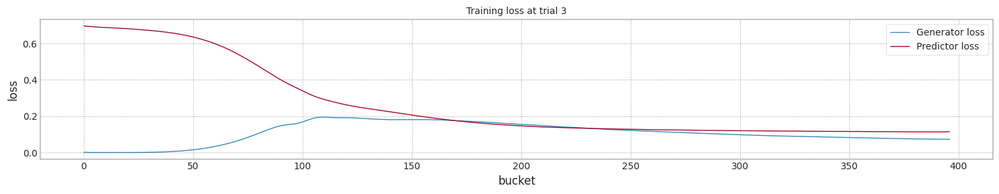

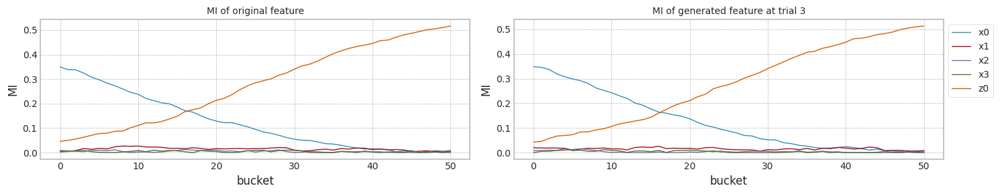

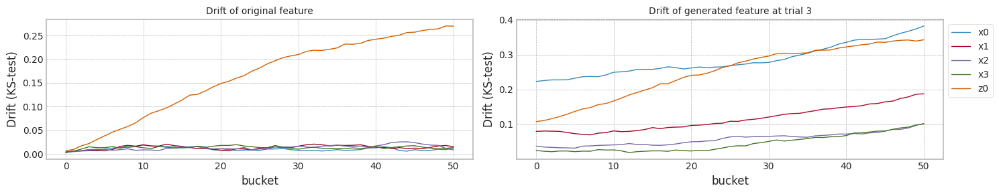

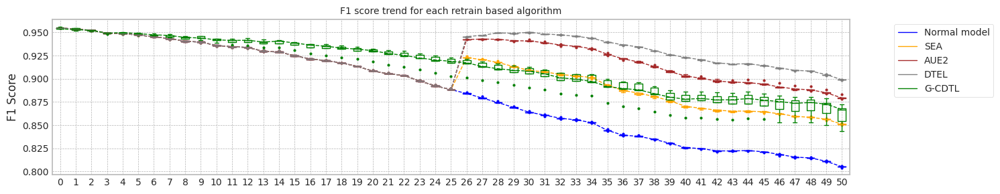

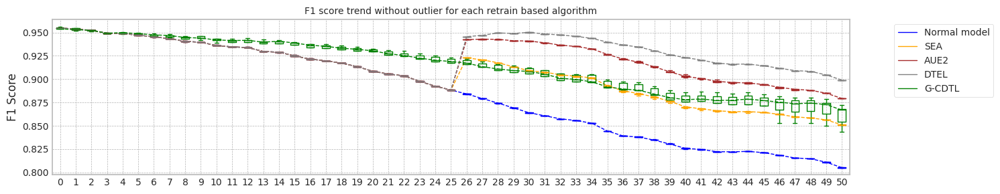

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.10230040550232
Base flops (inference flops of normal model, median): 199665000.0


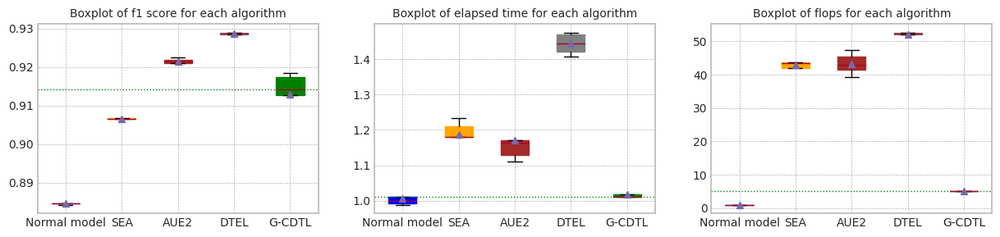

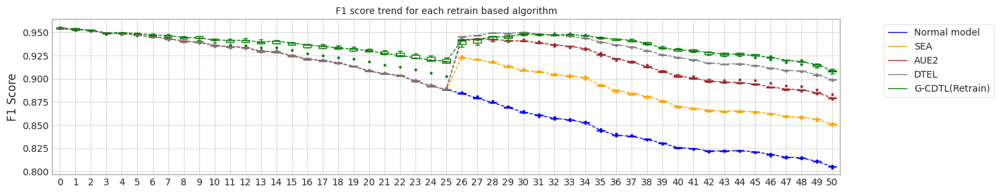

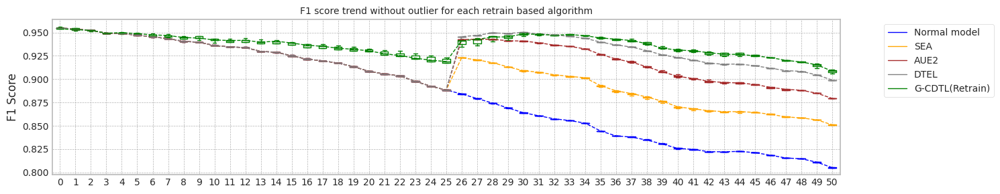

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.10230040550232
Base flops (train + inference flops of normal model, median): 3558735000.0


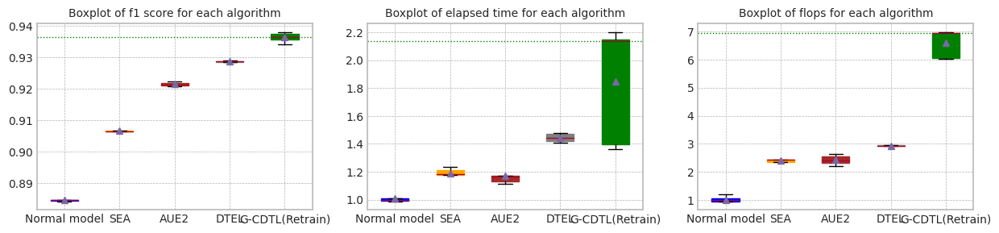

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.10230040550232


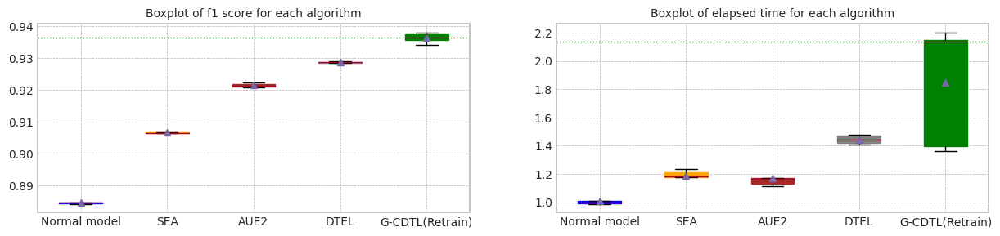

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.216397,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.102300,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.031464,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,9.988451,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.535089,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.102300,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.219126,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.597459,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.274355,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.122884,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.214939,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.214368,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.214939,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.182977,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.906057,0.850187,12.456208,4.239510e+09,5.269155e+09,9.508665e+09
1,1.0,0.954396,0.953533,0.907322,0.852314,11.915078,4.119885e+09,4.241250e+09,8.361135e+09
2,2.0,0.954834,0.953377,0.906438,0.850968,11.451106,4.023750e+09,3.557865e+09,7.581615e+09
3,3.0,0.954910,0.953454,0.906689,0.851160,12.215432,4.203840e+09,4.477890e+09,8.681730e+09
4,4.0,0.954901,0.953539,0.906534,0.850837,11.928427,4.111185e+09,4.612305e+09,8.723490e+09
5,median,0.954901,0.953533,0.906534,0.850968,11.928427,4.119885e+09,4.477890e+09,8.681730e+09
6,std,0.000235,0.000094,0.000462,0.000774,0.376805,8.474387e+07,6.196655e+08,6.959985e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.920871,0.878009,11.226309,3.921960e+09,5.151270e+09,9.073230e+09
1,1.0,0.954396,0.953533,0.921737,0.879308,11.410284,3.975030e+09,4.296060e+09,8.271090e+09
2,2.0,0.954834,0.953377,0.921030,0.879235,11.753560,4.046370e+09,3.780150e+09,7.826520e+09
3,3.0,0.954910,0.953454,0.921349,0.879364,11.829946,4.052025e+09,4.525740e+09,8.577765e+09
4,4.0,0.954901,0.953539,0.922366,0.883060,12.907513,4.365225e+09,5.066010e+09,9.431235e+09
5,median,0.954901,0.953533,0.921349,0.879308,11.753560,4.046370e+09,4.525740e+09,8.577765e+09
6,std,0.000235,0.000094,0.000600,0.001909,0.653334,1.724470e+08,5.666958e+08,6.354875e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.928641,0.899012,14.353645,4.838940e+09,6.170040e+09,1.100898e+10
1,1.0,0.954396,0.953533,0.928924,0.899012,14.903407,4.993800e+09,5.416620e+09,1.041042e+10
2,2.0,0.954834,0.953377,0.928466,0.899140,14.580073,4.897665e+09,4.733235e+09,9.630900e+09
3,3.0,0.954910,0.953454,0.928502,0.898315,14.851740,4.961610e+09,5.537115e+09,1.049872e+10
4,4.0,0.954901,0.953539,0.928751,0.899012,14.221217,4.802400e+09,5.604975e+09,1.040738e+10
5,median,0.954901,0.953533,0.928641,0.899012,14.580073,4.897665e+09,5.537115e+09,1.041042e+10
6,std,0.000235,0.000094,0.000188,0.000331,0.299323,8.038583e+07,5.137953e+08,4.929252e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.936388,0.907632,13.768551,2.121344e+10,223875000.0,2.143731e+10
1,1.0,0.953787,0.952034,0.933990,0.910465,21.607107,2.450752e+10,223875000.0,2.473140e+10
2,2.0,0.953612,0.952352,0.935583,0.905846,14.112960,2.129382e+10,223875000.0,2.151770e+10
3,3.0,0.956214,0.954604,0.938022,0.908471,22.248808,2.461896e+10,223875000.0,2.484283e+10
4,4.0,0.955650,0.954514,0.937476,0.909415,21.723120,2.446600e+10,223875000.0,2.468988e+10
5,median,0.953868,0.953043,0.936388,0.908471,21.607107,2.446600e+10,223875000.0,2.468988e+10
6,std,0.001212,0.001198,0.001597,0.001761,4.345814,1.796091e+09,0.0,1.796091e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 13:54:36,072] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 431.74it/s]

Early stop: 1050
[2023-11-29 13:54:38,512] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.18it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:54:48,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:54:48,473] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:11, 139.89it/s]

[2023-11-29 13:55:01,003] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:55:01,004] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 13:55:11,237] [INFO] [profiler.py:80:start_profile] Flops profiler started


 41%|████      | 818/2000 [00:01<00:02, 435.99it/s]

Early stop: 818
[2023-11-29 13:55:13,122] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.97it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:55:23,486] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:55:23,488] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:02<00:11, 141.30it/s]

[2023-11-29 13:55:35,900] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:55:35,901] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.08it/s]

mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 13:55:46,035] [INFO] [profiler.py:80:start_profile] Flops profiler started



 33%|███▎      | 668/2000 [00:01<00:03, 442.58it/s]

Early stop: 668
[2023-11-29 13:55:47,550] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:55:57,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:55:57,669] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:03<00:10, 139.17it/s]

[2023-11-29 13:56:01,274] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:56:01,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.05it/s]


mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 13:56:11,487] [INFO] [profiler.py:80:start_profile] Flops profiler started


 43%|████▎     | 857/2000 [00:01<00:02, 433.85it/s]

Early stop: 857
[2023-11-29 13:56:13,471] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.16it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:56:23,441] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:56:23,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:02<00:11, 144.83it/s]

[2023-11-29 13:56:35,572] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:56:35,573] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]


mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 13:56:45,795] [INFO] [profiler.py:80:start_profile] Flops profiler started


 46%|████▌     | 915/2000 [00:02<00:02, 441.58it/s]

Early stop: 915
[2023-11-29 13:56:47,872] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.07it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 13:56:58,032] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:56:58,035] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:02<00:11, 140.26it/s]

[2023-11-29 13:57:04,542] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:57:04,543] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:57:18,381] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:57:18,384] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 13:57:30,282] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:57:30,284] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:15<02:04,  3.78s/it]

G-CDTL train flops: 3500000000 775250000 192705000 4467955000


 69%|██████▊   | 35/51 [00:18<00:03,  4.73it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:57:33,918] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:57:33,920] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 13:57:46,311] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:57:46,312] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:31<00:58,  3.93s/it]

G-CDTL train flops: 3500000000 878500000 218370000 4596870000


100%|██████████| 51/51 [00:34<00:00,  1.48it/s]


Early stop at  [442, 501]
Train flops  [4467955000, 4596870000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9426408922160909
G_CDTL+AUE median: 0.9426408922160909
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:17,  1.84it/s]

Ensemble_SEA train flops: 469800000


 71%|███████   | 36/51 [00:11<00:14,  1.01it/s]

Ensemble_SEA train flops: 719055000


100%|██████████| 51/51 [00:14<00:00,  3.55it/s]


Early stop at  [1079, 1652]
Train flops  [469800000, 719055000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9174759726880507
SEA median: 0.9174759726880507
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:27,  1.16it/s]

Ensemble_SEA train flops: 870000000


 71%|███████   | 36/51 [00:12<00:12,  1.19it/s]

Ensemble_SEA train flops: 585510000


100%|██████████| 51/51 [00:15<00:00,  3.33it/s]


Early stop at  [1999, 1345]
Train flops  [870000000, 585510000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9310796841369037
AUE median: 0.9310796841369037
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.15it/s]

Ensemble_DTEL train flops: 366705000


 35%|███▌      | 18/51 [00:07<00:50,  1.52s/it]

Ensemble_DTEL train flops: 870000000


 71%|███████   | 36/51 [00:13<00:13,  1.15it/s]

Ensemble_DTEL train flops: 612915000
Ensemble_DTEL train flops: 2610000


100%|██████████| 51/51 [00:16<00:00,  3.06it/s]


Early stop at  [842, 1999, 1408, 5]
Train flops  [366705000, 870000000, 612915000, 2610000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9275667136477821
DTEL median: 0.9275667136477821
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.15it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:58:39,538] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:58:39,540] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 13:58:42,375] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:58:42,377] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:06<00:34,  1.05s/it]

G-CDTL train flops: 61250000 714000000 177480000 952730000


 69%|██████▊   | 35/51 [00:09<00:03,  5.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:58:45,919] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:58:45,921] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 13:58:58,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:58:58,886] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:22<01:01,  4.09s/it]

G-CDTL train flops: 3500000000 992250000 246645000 4738895000


100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


Early stop at  [407, 566]
Train flops  [952730000, 4738895000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9413564873559581
G_CDTL+AUE median: 0.9419986897860245
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:15,  2.03it/s]

Ensemble_SEA train flops: 375840000


 73%|███████▎  | 37/51 [00:10<00:09,  1.51it/s]

Ensemble_SEA train flops: 620745000


100%|██████████| 51/51 [00:13<00:00,  3.72it/s]


Early stop at  [863, 1426]
Train flops  [375840000, 620745000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9176925831883077
SEA median: 0.9175842779381792
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:21,  1.55it/s]

Ensemble_SEA train flops: 420210000


 73%|███████▎  | 37/51 [00:11<00:09,  1.44it/s]

Ensemble_SEA train flops: 654240000


100%|██████████| 51/51 [00:13<00:00,  3.65it/s]


Early stop at  [965, 1503]
Train flops  [420210000, 654240000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9308134112033718
AUE median: 0.9309465476701377
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.05it/s]

Ensemble_DTEL train flops: 348870000


 35%|███▌      | 18/51 [00:06<00:33,  1.01s/it]

Ensemble_DTEL train flops: 381495000


 69%|██████▊   | 35/51 [00:09<00:03,  5.13it/s]

Ensemble_DTEL train flops: 803880000


 73%|███████▎  | 37/51 [00:13<00:12,  1.08it/s]

Ensemble_DTEL train flops: 197055000


100%|██████████| 51/51 [00:16<00:00,  3.15it/s]


Early stop at  [801, 876, 1847, 452]
Train flops  [348870000, 381495000, 803880000, 197055000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9402343257315402
DTEL median: 0.9339005196896611
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 13:59:49,629] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 13:59:49,632] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 13:59:57,693] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 13:59:57,694] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:11<01:26,  2.62s/it]

G-CDTL train flops: 1904000000 817250000 203145000 2924395000


 69%|██████▊   | 35/51 [00:15<00:03,  4.78it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:00:01,344] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:00:01,347] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:00:13,687] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:00:13,689] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:27<00:39,  2.80s/it]

G-CDTL train flops: 3500000000 757750000 188355000 4446105000


100%|██████████| 51/51 [00:30<00:00,  1.67it/s]


Early stop at  [466, 432]
Train flops  [2924395000, 4446105000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9422502237236008
G_CDTL+AUE median: 0.9422502237236008
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:13,  2.37it/s]

Ensemble_SEA train flops: 297105000


 71%|███████   | 36/51 [00:10<00:13,  1.12it/s]

Ensemble_SEA train flops: 622485000


100%|██████████| 51/51 [00:13<00:00,  3.77it/s]


Early stop at  [682, 1430]
Train flops  [297105000, 622485000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.917171455811101
SEA median: 0.9174759726880507
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:19,  1.66it/s]

Ensemble_SEA train flops: 356265000


 73%|███████▎  | 37/51 [00:11<00:12,  1.16it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:14<00:00,  3.47it/s]


Early stop at  [818, 1999]
Train flops  [356265000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9310076705924152
AUE median: 0.9310076705924152
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.08it/s]

Ensemble_DTEL train flops: 334515000


 37%|███▋      | 19/51 [00:06<00:24,  1.32it/s]

Ensemble_DTEL train flops: 400635000


 71%|███████   | 36/51 [00:11<00:10,  1.40it/s]

Ensemble_DTEL train flops: 461970000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:14<00:00,  3.52it/s]


Early stop at  [768, 920, 1061, 4]
Train flops  [334515000, 400635000, 461970000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9284092078266841
DTEL median: 0.9284092078266841
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.00it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:01:03,283] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:01:03,285] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:01:09,688] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:01:09,690] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:09<01:10,  2.13s/it]

G-CDTL train flops: 1123500000 806750000 200535000 2130785000


 69%|██████▊   | 35/51 [00:13<00:03,  4.58it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:01:13,562] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:01:13,564] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:01:17,989] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:01:17,991] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:18<00:23,  1.55s/it]

G-CDTL train flops: 92750000 1064000000 264480000 1421230000


100%|██████████| 51/51 [00:21<00:00,  2.40it/s]


Early stop at  [460, 607]
Train flops  [2130785000, 1421230000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9422712926968236
G_CDTL+AUE median: 0.9422607582102123
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:06<00:28,  1.14it/s]

Ensemble_SEA train flops: 849990000


 73%|███████▎  | 37/51 [00:12<00:07,  1.87it/s]

Ensemble_SEA train flops: 442830000


100%|██████████| 51/51 [00:14<00:00,  3.42it/s]


Early stop at  [1953, 1017]
Train flops  [849990000, 442830000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9178444752725207
SEA median: 0.9175842779381792
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:16,  1.89it/s]

Ensemble_SEA train flops: 415425000


 73%|███████▎  | 37/51 [00:11<00:10,  1.37it/s]

Ensemble_SEA train flops: 688605000


100%|██████████| 51/51 [00:14<00:00,  3.57it/s]


Early stop at  [954, 1582]
Train flops  [415425000, 688605000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9311096375687007
AUE median: 0.9310436773646594
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.01it/s]

Ensemble_DTEL train flops: 369315000


 37%|███▋      | 19/51 [00:05<00:20,  1.53it/s]

Ensemble_DTEL train flops: 204885000


 69%|██████▊   | 35/51 [00:09<00:03,  5.05it/s]

Ensemble_DTEL train flops: 826065000


 71%|███████   | 36/51 [00:14<00:27,  1.82s/it]

Ensemble_DTEL train flops: 610740000


100%|██████████| 51/51 [00:17<00:00,  2.87it/s]


Early stop at  [848, 470, 1898, 1403]
Train flops  [369315000, 204885000, 826065000, 610740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9394622683680813
DTEL median: 0.9339357380973827
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:02:11,756] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:02:11,759] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:02:27,597] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:02:27,599] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:19<02:43,  4.96s/it]

G-CDTL train flops: 3500000000 1625750000 404115000 5529865000


 69%|██████▊   | 35/51 [00:22<00:03,  4.68it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:02:31,234] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:02:31,238] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:02:50,553] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:02:50,554] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:42<01:30,  6.01s/it]

G-CDTL train flops: 3500000000 2509500000 623790000 6633290000


100%|██████████| 51/51 [00:45<00:00,  1.13it/s]


Early stop at  [928, 1433]
Train flops  [5529865000, 6633290000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9401093009312876
G_CDTL+AUE median: 0.9422502237236008
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:24,  1.33it/s]

Ensemble_SEA train flops: 491115000


 71%|███████   | 36/51 [00:11<00:14,  1.06it/s]

Ensemble_SEA train flops: 654675000


100%|██████████| 51/51 [00:14<00:00,  3.49it/s]


Early stop at  [1128, 1504]
Train flops  [491115000, 654675000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9174504500114263
SEA median: 0.9174759726880507
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:18,  1.80it/s]

Ensemble_SEA train flops: 318855000


 71%|███████   | 36/51 [00:09<00:09,  1.65it/s]

Ensemble_SEA train flops: 361920000


100%|██████████| 51/51 [00:12<00:00,  4.04it/s]


Early stop at  [732, 831]
Train flops  [318855000, 361920000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9304386065558754
AUE median: 0.9310076705924152
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.15it/s]

Ensemble_DTEL train flops: 410640000


 37%|███▋      | 19/51 [00:05<00:21,  1.48it/s]

Ensemble_DTEL train flops: 184005000


 69%|██████▊   | 35/51 [00:09<00:03,  4.95it/s]

Ensemble_DTEL train flops: 379320000


 73%|███████▎  | 37/51 [00:12<00:10,  1.34it/s]

Ensemble_DTEL train flops: 301455000


100%|██████████| 51/51 [00:15<00:00,  3.40it/s]


Early stop at  [943, 422, 871, 692]
Train flops  [410640000, 184005000, 379320000, 301455000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9401720670276187
DTEL median: 0.9394622683680813


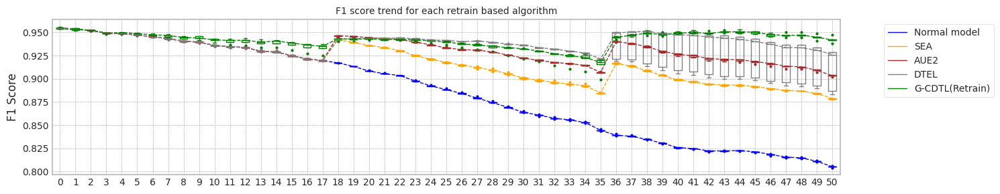

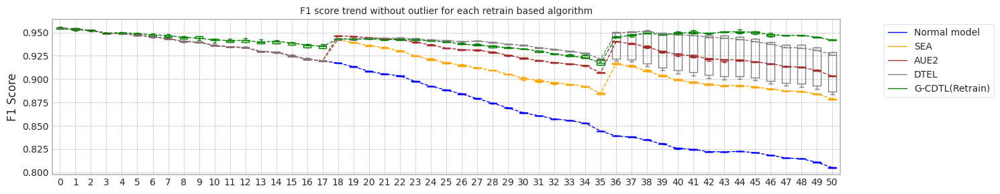

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.0965895652771
Base flops (train + inference flops of normal model, median): 3558735000.0


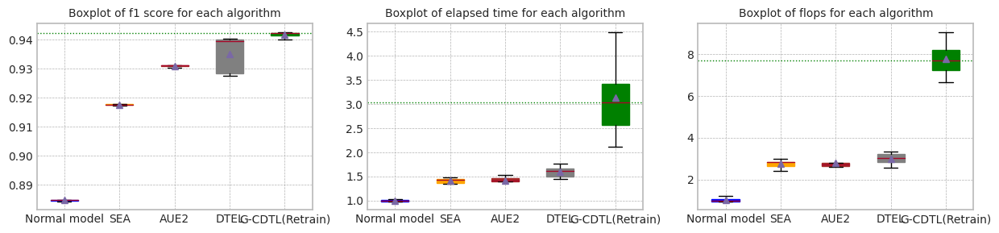

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.0965895652771


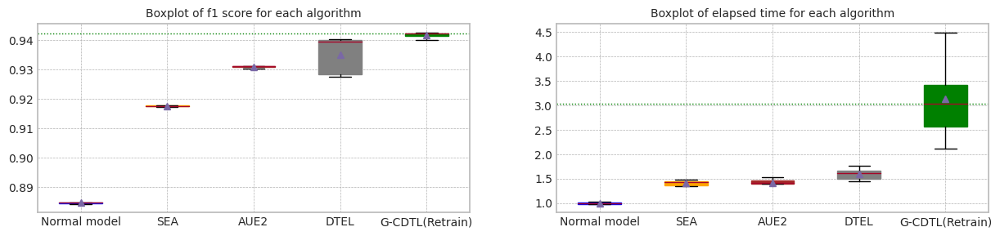

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,9.939114,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.343665,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.096590,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,9.952815,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.142947,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.096590,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.164813,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.211834,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.114491,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.191979,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.199932,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.214098,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.199932,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.041229,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.917476,0.878177,14.413959,4.774995e+09,5.894685e+09,1.066968e+10
1,1.0,0.954396,0.953533,0.917693,0.879003,13.797889,4.582725e+09,4.794135e+09,9.376860e+09
2,2.0,0.954834,0.953377,0.917171,0.879103,13.602865,4.505730e+09,4.129890e+09,8.635620e+09
3,3.0,0.954910,0.953454,0.917844,0.877652,14.995952,4.878960e+09,5.243055e+09,1.012202e+10
4,4.0,0.954901,0.953539,0.917450,0.878802,14.667615,4.731930e+09,5.323095e+09,1.005502e+10
5,median,0.954901,0.953533,0.917476,0.878802,14.413959,4.731930e+09,5.243055e+09,1.005502e+10
6,std,0.000235,0.000094,0.000256,0.000617,0.585341,1.500275e+08,6.583646e+08,7.835716e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.931080,0.903938,15.369924,5.041650e+09,6.361005e+09,1.140266e+10
1,1.0,0.954396,0.953533,0.930813,0.903099,14.031857,4.660590e+09,5.071665e+09,9.732255e+09
2,2.0,0.954834,0.953377,0.931008,0.903960,14.768216,4.812405e+09,4.636230e+09,9.448635e+09
3,3.0,0.954910,0.953454,0.931110,0.903241,14.349631,4.690170e+09,5.253930e+09,9.944100e+09
4,4.0,0.954901,0.953539,0.930439,0.901729,12.688766,4.266915e+09,5.057745e+09,9.324660e+09
5,median,0.954901,0.953533,0.931008,0.903241,14.349631,4.690170e+09,5.071665e+09,9.732255e+09
6,std,0.000235,0.000094,0.000277,0.000908,1.002172,2.821401e+08,6.473825e+08,8.363579e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.927567,0.883566,16.763842,5.438370e+09,6.402765e+09,1.184114e+10
1,1.0,0.954396,0.953533,0.940234,0.928555,16.272640,5.317440e+09,5.391390e+09,1.070883e+10
2,2.0,0.954834,0.953377,0.928409,0.886759,14.571921,4.785435e+09,4.286490e+09,9.071925e+09
3,3.0,0.954910,0.953454,0.939462,0.926154,17.815525,5.597145e+09,5.803335e+09,1.140048e+10
4,4.0,0.954901,0.953539,0.940172,0.928901,15.098347,4.861560e+09,5.253495e+09,1.011506e+10
5,median,0.954901,0.953533,0.939462,0.926154,16.272640,5.317440e+09,5.391390e+09,1.070883e+10
6,std,0.000235,0.000094,0.006569,0.023443,1.299207,3.587277e+08,7.787617e+08,1.090807e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.942641,0.942557,34.588157,2.899951e+10,134325000.0,2.913384e+10
1,1.0,0.953787,0.952034,0.941356,0.941908,25.969827,2.562631e+10,134325000.0,2.576064e+10
2,2.0,0.953612,0.952352,0.942250,0.947406,30.698930,2.730518e+10,134325000.0,2.743951e+10
3,3.0,0.956214,0.954604,0.942271,0.941701,21.339214,2.348670e+10,134325000.0,2.362102e+10
4,4.0,0.955650,0.954514,0.940109,0.938141,45.373780,3.209784e+10,134325000.0,3.223216e+10
5,median,0.953868,0.953043,0.942250,0.941908,30.698930,2.730518e+10,134325000.0,2.743951e+10
6,std,0.001212,0.001198,0.001020,0.003315,9.171156,3.280391e+09,0.0,3.280391e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 14:03:42,047] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 408.12it/s]

Early stop: 1050
[2023-11-29 14:03:44,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:03:54,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:03:54,671] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:11, 131.47it/s]

[2023-11-29 14:04:08,286] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:04:08,289] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.10it/s]


mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 14:04:18,388] [INFO] [profiler.py:80:start_profile] Flops profiler started


 41%|████      | 818/2000 [00:01<00:02, 417.12it/s]

Early stop: 818
[2023-11-29 14:04:20,356] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.05it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:04:30,551] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:04:30,553] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:03<00:11, 134.49it/s]

[2023-11-29 14:04:43,865] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:04:43,867] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.07it/s]

mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 14:04:54,012] [INFO] [profiler.py:80:start_profile] Flops profiler started



 33%|███▎      | 668/2000 [00:01<00:03, 411.79it/s]

Early stop: 668
[2023-11-29 14:04:55,640] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.97it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:05:06,003] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:05:06,006] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:03<00:11, 133.87it/s]

[2023-11-29 14:05:09,767] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:05:09,769] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.09it/s]


mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 14:05:19,877] [INFO] [profiler.py:80:start_profile] Flops profiler started


 43%|████▎     | 857/2000 [00:02<00:02, 413.47it/s]

Early stop: 857
[2023-11-29 14:05:21,955] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:05:32,156] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:05:32,159] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:03<00:12, 130.44it/s]

[2023-11-29 14:05:45,275] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:05:45,278] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]


mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 14:05:55,324] [INFO] [profiler.py:80:start_profile] Flops profiler started


 46%|████▌     | 915/2000 [00:02<00:02, 403.60it/s]

Early stop: 915
[2023-11-29 14:05:57,596] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:06:07,822] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:07,824] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:02<00:12, 131.60it/s]

[2023-11-29 14:06:14,766] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:06:14,770] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.06it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:06:27,637] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:27,640] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:06:40,467] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:06:40,468] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:15<02:35,  4.09s/it]

G-CDTL train flops: 3500000000 736750000 183135000 4419885000


 49%|████▉     | 25/51 [00:17<00:06,  4.03it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:06:43,031] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:43,033] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:06:56,561] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:06:56,562] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:31<01:47,  4.29s/it]

G-CDTL train flops: 3500000000 966000000 240120000 4706120000


 75%|███████▍  | 38/51 [00:33<00:03,  3.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:06:59,193] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:06:59,195] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:07:12,811] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:07:12,812] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:47<00:51,  4.33s/it]

G-CDTL train flops: 3500000000 924000000 229680000 4653680000


100%|██████████| 51/51 [00:50<00:00,  1.02it/s]


Early stop at  [420, 551, 527]
Train flops  [4419885000, 4706120000, 4653680000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9434276737542288
G_CDTL+AUE median: 0.9434276737542288
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.61it/s]

Ensemble_SEA train flops: 506775000


 53%|█████▎    | 27/51 [00:10<00:21,  1.10it/s]

Ensemble_SEA train flops: 870000000


 76%|███████▋  | 39/51 [00:15<00:10,  1.09it/s]

Ensemble_SEA train flops: 611610000


100%|██████████| 51/51 [00:17<00:00,  2.86it/s]


Early stop at  [1164, 1999, 1405]
Train flops  [506775000, 870000000, 611610000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9180718735700873
SEA median: 0.9180718735700873
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:19,  1.87it/s]

Ensemble_SEA train flops: 400200000


 53%|█████▎    | 27/51 [00:07<00:09,  2.55it/s]

Ensemble_SEA train flops: 241425000


 76%|███████▋  | 39/51 [00:13<00:14,  1.20s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:15<00:00,  3.20it/s]


Early stop at  [919, 554, 1999]
Train flops  [400200000, 241425000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9314879916055705
AUE median: 0.9314879916055705
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.20it/s]

Ensemble_DTEL train flops: 372360000


 27%|██▋       | 14/51 [00:06<00:35,  1.05it/s]

Ensemble_DTEL train flops: 567675000


 51%|█████     | 26/51 [00:10<00:18,  1.33it/s]

Ensemble_DTEL train flops: 460230000
Ensemble_DTEL train flops: 2175000


 75%|███████▍  | 38/51 [00:12<00:02,  4.76it/s]

Ensemble_DTEL train flops: 870000000


 78%|███████▊  | 40/51 [00:18<00:14,  1.36s/it]

Ensemble_DTEL train flops: 543315000


100%|██████████| 51/51 [00:21<00:00,  2.43it/s]


Early stop at  [855, 1304, 1057, 4, 1999, 1248]
Train flops  [372360000, 567675000, 460230000, 2175000, 870000000, 543315000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9338782825118
DTEL median: 0.9338782825118
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:08:12,785] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:08:12,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:08:26,766] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:08:26,768] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:16<02:48,  4.44s/it]

G-CDTL train flops: 3500000000 988750000 245775000 4734525000


 49%|████▉     | 25/51 [00:19<00:06,  3.80it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:08:29,438] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:08:29,440] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:08:40,922] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:08:40,923] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:30<01:32,  3.69s/it]

G-CDTL train flops: 2612750000 983500000 244470000 3840720000


 75%|███████▍  | 38/51 [00:33<00:03,  4.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:08:43,533] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:08:43,536] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:08:56,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:08:56,928] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:46<00:50,  4.25s/it]

G-CDTL train flops: 3500000000 831250000 206625000 4537875000


100%|██████████| 51/51 [00:49<00:00,  1.04it/s]


Early stop at  [564, 561, 474]
Train flops  [4734525000, 3840720000, 4537875000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9438762889825715
G_CDTL+AUE median: 0.9436519813684001
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:18,  2.01it/s]

Ensemble_SEA train flops: 362355000


 51%|█████     | 26/51 [00:08<00:16,  1.55it/s]

Ensemble_SEA train flops: 371925000


 78%|███████▊  | 40/51 [00:12<00:05,  1.85it/s]

Ensemble_SEA train flops: 413250000


100%|██████████| 51/51 [00:14<00:00,  3.48it/s]


Early stop at  [832, 854, 949]
Train flops  [362355000, 371925000, 413250000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.917786384296285
SEA median: 0.9179291289331861
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:18,  2.02it/s]

Ensemble_SEA train flops: 367575000


 53%|█████▎    | 27/51 [00:08<00:15,  1.60it/s]

Ensemble_SEA train flops: 514170000


 78%|███████▊  | 40/51 [00:14<00:10,  1.09it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:16<00:00,  3.01it/s]


Early stop at  [844, 1181, 1999]
Train flops  [367575000, 514170000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9318700450617503
AUE median: 0.9316790183336604
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.05it/s]

Ensemble_DTEL train flops: 505035000


 25%|██▌       | 13/51 [00:06<00:50,  1.34s/it]

Ensemble_DTEL train flops: 445005000


 51%|█████     | 26/51 [00:10<00:18,  1.35it/s]

Ensemble_DTEL train flops: 462405000
Ensemble_DTEL train flops: 2175000


 75%|███████▍  | 38/51 [00:13<00:02,  5.01it/s]

Ensemble_DTEL train flops: 652935000


 76%|███████▋  | 39/51 [00:17<00:16,  1.42s/it]

Ensemble_DTEL train flops: 383235000


100%|██████████| 51/51 [00:19<00:00,  2.59it/s]


Early stop at  [1160, 1022, 1062, 4, 1500, 880]
Train flops  [505035000, 445005000, 462405000, 2175000, 652935000, 383235000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9340986545377683
DTEL median: 0.9339884685247841
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  4.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:09:53,476] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:09:53,479] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:10:01,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:10:01,446] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:10<01:39,  2.62s/it]

G-CDTL train flops: 1310750000 994000000 247080000 2551830000


 49%|████▉     | 25/51 [00:13<00:06,  4.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:10:04,132] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:10:04,135] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:10:18,250] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:10:18,251] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:27<01:51,  4.47s/it]

G-CDTL train flops: 3500000000 959000000 238380000 4697380000


 75%|███████▍  | 38/51 [00:29<00:03,  3.87it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:10:20,837] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:10:20,840] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:10:37,818] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:10:37,820] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:46<01:04,  5.34s/it]

G-CDTL train flops: 3500000000 1597750000 397155000 5494905000


100%|██████████| 51/51 [00:49<00:00,  1.03it/s]


Early stop at  [567, 547, 912]
Train flops  [2551830000, 4697380000, 5494905000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9447820700475926
G_CDTL+AUE median: 0.9438762889825715
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:26,  1.45it/s]

Ensemble_SEA train flops: 418035000


 53%|█████▎    | 27/51 [00:08<00:14,  1.67it/s]

Ensemble_SEA train flops: 491550000


 78%|███████▊  | 40/51 [00:13<00:07,  1.51it/s]

Ensemble_SEA train flops: 561585000


100%|██████████| 51/51 [00:15<00:00,  3.23it/s]


Early stop at  [960, 1129, 1290]
Train flops  [418035000, 491550000, 561585000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9184373782514416
SEA median: 0.9180718735700873
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:32,  1.17it/s]

Ensemble_SEA train flops: 536355000


 53%|█████▎    | 27/51 [00:08<00:11,  2.18it/s]

Ensemble_SEA train flops: 303195000


 76%|███████▋  | 39/51 [00:13<00:11,  1.05it/s]

Ensemble_SEA train flops: 626835000


100%|██████████| 51/51 [00:16<00:00,  3.16it/s]


Early stop at  [1232, 696, 1440]
Train flops  [536355000, 303195000, 626835000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9316343456956713
AUE median: 0.9316343456956713
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:23,  1.59it/s]

Ensemble_DTEL train flops: 357135000
Ensemble_DTEL train flops: 1740000


 49%|████▉     | 25/51 [00:06<00:05,  4.98it/s]

Ensemble_DTEL train flops: 618135000


 51%|█████     | 26/51 [00:10<00:34,  1.37s/it]

Ensemble_DTEL train flops: 365835000


 76%|███████▋  | 39/51 [00:16<00:13,  1.10s/it]

Ensemble_DTEL train flops: 740370000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:18<00:00,  2.77it/s]


Early stop at  [820, 3, 1420, 840, 1701, 3]
Train flops  [357135000, 1740000, 618135000, 365835000, 740370000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9291739532795648
DTEL median: 0.9338782825118
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  4.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:11:33,489] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:11:33,492] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:11:38,513] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:11:38,514] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:07<01:05,  1.73s/it]

G-CDTL train flops: 1345750000 234500000 58290000 1638540000


 49%|████▉     | 25/51 [00:10<00:05,  4.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:11:41,132] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:11:41,135] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:11:54,641] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:11:54,643] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:23<01:46,  4.27s/it]

G-CDTL train flops: 3500000000 796250000 197925000 4494175000


 75%|███████▍  | 38/51 [00:26<00:03,  3.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:11:57,220] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:11:57,223] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:12:11,577] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:12:11,578] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:40<00:54,  4.55s/it]

G-CDTL train flops: 3500000000 946750000 235335000 4682085000


100%|██████████| 51/51 [00:43<00:00,  1.18it/s]


Early stop at  [133, 454, 540]
Train flops  [1638540000, 4494175000, 4682085000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8784993473532574
G_CDTL+AUE median: 0.9436519813684001
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.61it/s]

Ensemble_SEA train flops: 509820000


 53%|█████▎    | 27/51 [00:09<00:17,  1.38it/s]

Ensemble_SEA train flops: 632925000


 76%|███████▋  | 39/51 [00:14<00:10,  1.16it/s]

Ensemble_SEA train flops: 555060000


100%|██████████| 51/51 [00:16<00:00,  3.03it/s]


Early stop at  [1171, 1454, 1275]
Train flops  [509820000, 632925000, 555060000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.917904446324305
SEA median: 0.9179881599471962
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:05<00:44,  1.16s/it]

Ensemble_SEA train flops: 786045000


 53%|█████▎    | 27/51 [00:09<00:11,  2.01it/s]

Ensemble_SEA train flops: 344520000


 78%|███████▊  | 40/51 [00:15<00:09,  1.22it/s]

Ensemble_SEA train flops: 747330000


100%|██████████| 51/51 [00:17<00:00,  2.88it/s]


Early stop at  [1806, 791, 1717]
Train flops  [786045000, 344520000, 747330000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9317436113929309
AUE median: 0.9316889785443011
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.16it/s]

Ensemble_DTEL train flops: 44805000


 27%|██▋       | 14/51 [00:03<00:13,  2.81it/s]

Ensemble_DTEL train flops: 145290000


 51%|█████     | 26/51 [00:07<00:20,  1.19it/s]

Ensemble_DTEL train flops: 533310000
Ensemble_DTEL train flops: 2175000


 75%|███████▍  | 38/51 [00:10<00:02,  4.71it/s]

Ensemble_DTEL train flops: 686430000


 78%|███████▊  | 40/51 [00:16<00:16,  1.50s/it]

Ensemble_DTEL train flops: 832590000


100%|██████████| 51/51 [00:19<00:00,  2.66it/s]


Early stop at  [102, 333, 1225, 4, 1577, 1913]
Train flops  [44805000, 145290000, 533310000, 2175000, 686430000, 832590000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9336991003376892
DTEL median: 0.9337886914247446
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  4.98it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:13:10,554] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:13:10,557] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 21.0
[2023-11-29 14:13:18,951] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:13:18,952] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:11<01:13,  1.98s/it]

G-CDTL train flops: 1573250000 826000000 205320000 2604570000


 49%|████▉     | 25/51 [00:13<00:05,  4.34it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:13:21,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:13:21,524] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 34.0
[2023-11-29 14:13:35,147] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:13:35,148] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:27<01:47,  4.31s/it]

G-CDTL train flops: 3500000000 701750000 174435000 4376185000


 75%|███████▍  | 38/51 [00:29<00:03,  3.85it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:13:37,804] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:13:37,808] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 47.0
[2023-11-29 14:13:52,406] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:13:52,408] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 76%|███████▋  | 39/51 [00:44<00:55,  4.63s/it]

G-CDTL train flops: 3500000000 836500000 207930000 4544430000


100%|██████████| 51/51 [00:46<00:00,  1.09it/s]


Early stop at  [471, 400, 477]
Train flops  [2604570000, 4376185000, 4544430000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9456151330018114
G_CDTL+AUE median: 0.9438762889825715
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:26,  1.45it/s]

Ensemble_SEA train flops: 390195000


 51%|█████     | 26/51 [00:08<00:14,  1.68it/s]

Ensemble_SEA train flops: 309720000


 76%|███████▋  | 39/51 [00:14<00:15,  1.31s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:16<00:00,  3.02it/s]


Early stop at  [896, 711, 1999]
Train flops  [390195000, 309720000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9176481431674317
SEA median: 0.917904446324305
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:17,  2.09it/s]

Ensemble_SEA train flops: 333210000


 51%|█████     | 26/51 [00:09<00:24,  1.02it/s]

Ensemble_SEA train flops: 636405000


 76%|███████▋  | 39/51 [00:15<00:15,  1.25s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:17<00:00,  2.90it/s]


Early stop at  [765, 1462, 1999]
Train flops  [333210000, 636405000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9318977883478567
AUE median: 0.9317436113929309
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:26,  1.45it/s]

Ensemble_DTEL train flops: 393675000
Ensemble_DTEL train flops: 1740000


 49%|████▉     | 25/51 [00:06<00:05,  4.77it/s]

Ensemble_DTEL train flops: 828240000


 51%|█████     | 26/51 [00:12<00:50,  2.03s/it]

Ensemble_DTEL train flops: 684255000


 76%|███████▋  | 39/51 [00:17<00:08,  1.40it/s]

Ensemble_DTEL train flops: 407160000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:19<00:00,  2.60it/s]


Early stop at  [904, 3, 1903, 1572, 935, 4]
Train flops  [393675000, 1740000, 828240000, 684255000, 407160000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9294847967676759
DTEL median: 0.9336991003376892


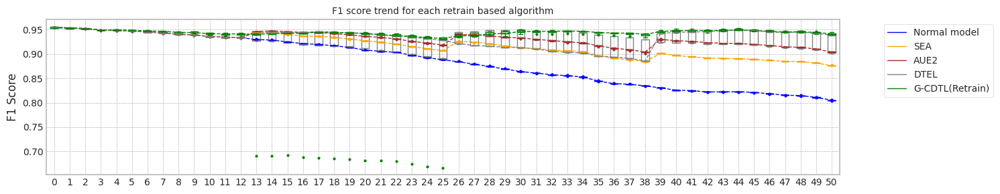

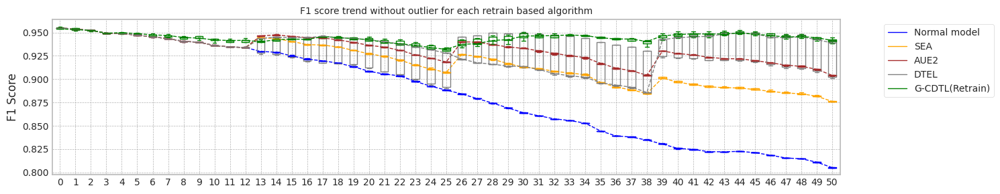

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.182899475097656
Base flops (train + inference flops of normal model, median): 3558735000.0


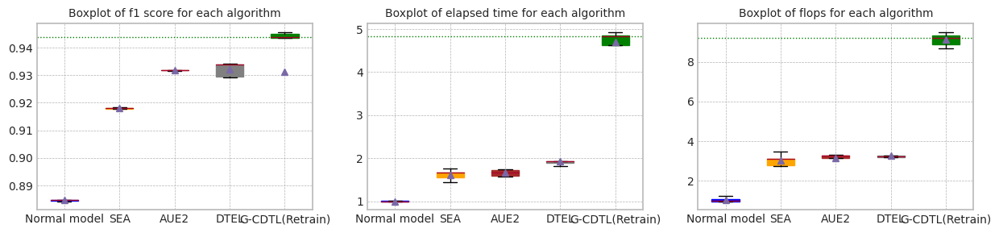

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.182899475097656


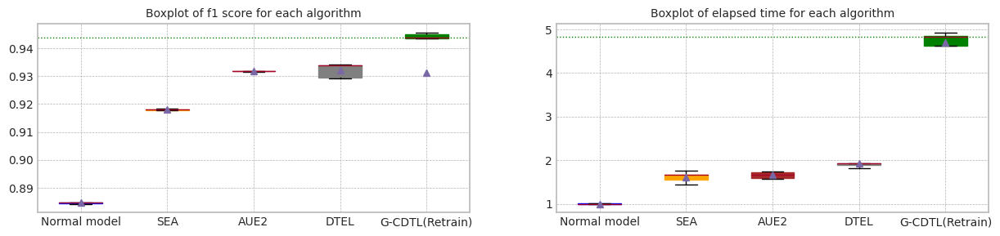

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.022033,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.177904,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.342868,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,10.182899,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.206007,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.182899,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.113982,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.078892,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.126256,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.088734,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.023283,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.156170,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.088734,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.050399,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.918072,0.876407,17.900890,5.574525e+09,6.799920e+09,1.237444e+10
1,1.0,0.954396,0.953533,0.917786,0.875661,14.728717,4.733670e+09,5.050785e+09,9.784455e+09
2,2.0,0.954834,0.953377,0.918437,0.877427,15.879663,5.057310e+09,4.787175e+09,9.844485e+09
3,3.0,0.954910,0.953454,0.917904,0.875834,16.885327,5.283945e+09,5.753745e+09,1.103769e+10
4,4.0,0.954901,0.953539,0.917648,0.876033,16.990868,5.156055e+09,5.852925e+09,1.100898e+10
5,median,0.954901,0.953533,0.917904,0.876033,16.885327,5.156055e+09,5.753745e+09,1.100898e+10
6,std,0.000235,0.000094,0.000304,0.000703,1.211565,3.080200e+08,7.870478e+08,1.063354e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.931488,0.904818,15.986174,5.097765e+09,6.522825e+09,1.162059e+10
1,1.0,0.954396,0.953533,0.931870,0.903994,17.015388,5.337885e+09,5.854665e+09,1.119255e+10
2,2.0,0.954834,0.953377,0.931634,0.903248,16.199511,5.052525e+09,4.982055e+09,1.003458e+10
3,3.0,0.954910,0.953454,0.931744,0.903671,17.803460,5.464035e+09,6.133500e+09,1.159754e+10
4,4.0,0.954901,0.953539,0.931898,0.904573,17.638045,5.425755e+09,6.322290e+09,1.174804e+10
5,median,0.954901,0.953533,0.931744,0.903994,17.015388,5.337885e+09,6.133500e+09,1.159754e+10
6,std,0.000235,0.000094,0.000170,0.000643,0.820969,1.892891e+08,6.011558e+08,7.046399e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.933878,0.941417,21.103892,6.401895e+09,6.900405e+09,1.330230e+10
1,1.0,0.954396,0.953533,0.934099,0.941176,19.734029,6.036930e+09,5.492310e+09,1.152924e+10
2,2.0,0.954834,0.953377,0.929174,0.901115,18.486993,5.671095e+09,4.531395e+09,1.020249e+10
3,3.0,0.954910,0.953454,0.933699,0.938717,19.217057,5.830740e+09,5.828130e+09,1.165887e+10
4,4.0,0.954901,0.953539,0.929485,0.902415,19.710184,5.903385e+09,5.484045e+09,1.138743e+10
5,median,0.954901,0.953533,0.933699,0.938717,19.710184,5.903385e+09,5.492310e+09,1.152924e+10
6,std,0.000235,0.000094,0.002505,0.021213,0.957145,2.757630e+08,8.513063e+08,1.107162e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.943428,0.942167,50.219284,3.371437e+10,107460000.0,3.382183e+10
1,1.0,0.953787,0.952034,0.943876,0.937923,49.172370,3.304780e+10,107460000.0,3.315526e+10
2,2.0,0.953612,0.952352,0.944782,0.940140,49.413489,3.267880e+10,107460000.0,3.278626e+10
3,3.0,0.956214,0.954604,0.878499,0.941448,43.176471,3.074948e+10,107460000.0,3.085694e+10
4,4.0,0.955650,0.954514,0.945615,0.944431,47.028177,3.145987e+10,107460000.0,3.156733e+10
5,median,0.953868,0.953043,0.943876,0.941448,49.172370,3.267880e+10,107460000.0,3.278626e+10
6,std,0.001212,0.001198,0.029495,0.002413,2.842200,1.205046e+09,0.0,1.205046e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 14:14:55,363] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:02<00:02, 393.57it/s]

Early stop: 1050
[2023-11-29 14:14:58,487] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.97it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:15:08,854] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:15:08,856] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:12, 125.78it/s]

[2023-11-29 14:15:23,148] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:15:23,149] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.94it/s]

mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 14:15:33,582] [INFO] [profiler.py:80:start_profile] Flops profiler started



 41%|████      | 818/2000 [00:02<00:03, 384.42it/s]

Early stop: 818
[2023-11-29 14:15:35,716] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.04it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:15:45,936] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:15:45,938] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██        | 423/2000 [00:03<00:12, 121.99it/s]

[2023-11-29 14:16:00,215] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:16:00,217] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.93it/s]

mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 14:16:10,671] [INFO] [profiler.py:80:start_profile] Flops profiler started



 33%|███▎      | 668/2000 [00:01<00:03, 379.05it/s]

Early stop: 668
[2023-11-29 14:16:12,442] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.82it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:16:23,131] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:16:23,134] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:04<00:12, 118.01it/s]

[2023-11-29 14:16:27,392] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:16:27,393] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.93it/s]

mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 14:16:37,842] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 857/2000 [00:02<00:03, 379.50it/s]

Early stop: 857
[2023-11-29 14:16:40,106] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.15it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:16:50,112] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:16:50,115] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:03<00:13, 121.09it/s]

[2023-11-29 14:17:04,501] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:17:04,504] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.01it/s]

mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 14:17:14,791] [INFO] [profiler.py:80:start_profile] Flops profiler started



 46%|████▌     | 915/2000 [00:02<00:02, 385.82it/s]

Early stop: 915
[2023-11-29 14:17:17,169] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.02it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:17:27,439] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:17:27,441] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:03<00:13, 120.39it/s]

[2023-11-29 14:17:35,041] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:17:35,042] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.05it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:17:47,518] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:17:47,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:18:05,725] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:05,726] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:20<03:50,  5.77s/it]

G-CDTL train flops: 3500000000 1720250000 427605000 5647855000


 41%|████      | 21/51 [00:22<00:10,  2.83it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:18:07,956] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:18:07,958] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:18:22,473] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:22,474] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:37<02:15,  4.67s/it]

G-CDTL train flops: 3500000000 918750000 228375000 4647125000


 63%|██████▎   | 32/51 [00:39<00:06,  3.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:18:24,646] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:18:24,649] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:18:39,246] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:39,248] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:53<01:24,  4.67s/it]

G-CDTL train flops: 3500000000 829500000 206190000 4535690000


 84%|████████▍ | 43/51 [00:55<00:02,  3.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:18:41,455] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:18:41,458] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:18:57,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:18:57,282] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:11<00:35,  5.04s/it]

G-CDTL train flops: 3500000000 1107750000 275355000 4883105000


100%|██████████| 51/51 [01:13<00:00,  1.44s/it]


Early stop at  [982, 524, 473, 632]
Train flops  [5647855000, 4647125000, 4535690000, 4883105000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9461616724861327
G_CDTL+AUE median: 0.9461616724861327
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:30,  1.31it/s]

Ensemble_SEA train flops: 441090000


 43%|████▎     | 22/51 [00:08<00:23,  1.23it/s]

Ensemble_SEA train flops: 477195000


 65%|██████▍   | 33/51 [00:13<00:21,  1.22s/it]

Ensemble_SEA train flops: 806925000


 86%|████████▋ | 44/51 [00:18<00:05,  1.21it/s]

Ensemble_SEA train flops: 489810000


100%|██████████| 51/51 [00:19<00:00,  2.63it/s]


Early stop at  [1013, 1096, 1854, 1125]
Train flops  [441090000, 477195000, 806925000, 489810000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.919481701929448
SEA median: 0.919481701929448
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:28,  1.40it/s]

Ensemble_SEA train flops: 401070000


 45%|████▌     | 23/51 [00:09<00:27,  1.02it/s]

Ensemble_SEA train flops: 870000000


 65%|██████▍   | 33/51 [00:14<00:15,  1.18it/s]

Ensemble_SEA train flops: 505905000


 88%|████████▊ | 45/51 [00:19<00:04,  1.27it/s]

Ensemble_SEA train flops: 653370000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [921, 1999, 1162, 1501]
Train flops  [401070000, 870000000, 505905000, 653370000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9327503908386474
AUE median: 0.9327503908386474
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:26,  1.48it/s]

Ensemble_DTEL train flops: 382365000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:05<00:06,  4.84it/s]

Ensemble_DTEL train flops: 556365000


 45%|████▌     | 23/51 [00:09<00:26,  1.05it/s]

Ensemble_DTEL train flops: 312330000


 63%|██████▎   | 32/51 [00:11<00:04,  4.36it/s]

Ensemble_DTEL train flops: 361485000


 67%|██████▋   | 34/51 [00:15<00:16,  1.03it/s]

Ensemble_DTEL train flops: 513300000


 86%|████████▋ | 44/51 [00:20<00:08,  1.20s/it]

Ensemble_DTEL train flops: 794745000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:22<00:00,  2.31it/s]


Early stop at  [878, 2, 1278, 717, 830, 1179, 1826, 4]
Train flops  [382365000, 1305000, 556365000, 312330000, 361485000, 513300000, 794745000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9377179514667412
DTEL median: 0.9377179514667412
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  4.87it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:03,170] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:03,172] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:20:10,830] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:10,832] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:09<01:42,  2.55s/it]

G-CDTL train flops: 1352750000 742000000 184440000 2279190000


 41%|████      | 21/51 [00:11<00:07,  3.81it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:13,025] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:13,028] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:20:27,449] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:27,450] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:26<02:12,  4.58s/it]

G-CDTL train flops: 3500000000 766500000 190530000 4457030000


 63%|██████▎   | 32/51 [00:28<00:06,  3.03it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:29,735] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:29,737] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:20:33,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:33,705] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:32<00:26,  1.49s/it]

G-CDTL train flops: 80500000 819000000 203580000 1103080000


 84%|████████▍ | 43/51 [00:34<00:01,  4.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:20:35,929] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:20:35,932] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:20:51,956] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:20:51,957] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [00:51<00:35,  5.04s/it]

G-CDTL train flops: 3500000000 1158500000 287970000 4946470000


100%|██████████| 51/51 [00:52<00:00,  1.03s/it]


Early stop at  [423, 437, 467, 661]
Train flops  [2279190000, 4457030000, 1103080000, 4946470000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9450719661147021
G_CDTL+AUE median: 0.9456168193004174
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:35,  1.14it/s]

Ensemble_SEA train flops: 512865000


 45%|████▌     | 23/51 [00:08<00:16,  1.66it/s]

Ensemble_SEA train flops: 440655000


 65%|██████▍   | 33/51 [00:14<00:23,  1.31s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:20<00:05,  1.02it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:21<00:00,  2.36it/s]


Early stop at  [1178, 1012, 1999, 1999]
Train flops  [512865000, 440655000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9198124569345061
SEA median: 0.9196470794319771
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.94it/s]

Ensemble_SEA train flops: 354960000


 43%|████▎     | 22/51 [00:08<00:26,  1.10it/s]

Ensemble_SEA train flops: 556365000


 65%|██████▍   | 33/51 [00:12<00:17,  1.03it/s]

Ensemble_SEA train flops: 598560000


 88%|████████▊ | 45/51 [00:17<00:03,  1.64it/s]

Ensemble_SEA train flops: 457620000


100%|██████████| 51/51 [00:18<00:00,  2.77it/s]


Early stop at  [815, 1278, 1375, 1051]
Train flops  [354960000, 556365000, 598560000, 457620000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9327971490802577
AUE median: 0.9327737699594525
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.07it/s]

Ensemble_DTEL train flops: 404115000


 24%|██▎       | 12/51 [00:04<00:24,  1.60it/s]

Ensemble_DTEL train flops: 65685000


 43%|████▎     | 22/51 [00:08<00:22,  1.31it/s]

Ensemble_DTEL train flops: 443265000
Ensemble_DTEL train flops: 1740000


 63%|██████▎   | 32/51 [00:10<00:03,  4.77it/s]

Ensemble_DTEL train flops: 491115000


 67%|██████▋   | 34/51 [00:13<00:14,  1.17it/s]

Ensemble_DTEL train flops: 259260000


 86%|████████▋ | 44/51 [00:19<00:09,  1.31s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:20<00:00,  2.47it/s]


Early stop at  [928, 150, 1018, 3, 1128, 595, 1999, 3]
Train flops  [404115000, 65685000, 443265000, 1740000, 491115000, 259260000, 870000000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.937862813691693
DTEL median: 0.9377903825792171
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  5.01it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:21:56,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:21:56,577] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:22:15,137] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:22:15,138] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:20<03:55,  5.88s/it]

G-CDTL train flops: 3500000000 1632750000 405855000 5538605000


 41%|████      | 21/51 [00:22<00:10,  2.78it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:22:17,367] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:22:17,370] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:22:35,715] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:22:35,716] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:41<02:48,  5.82s/it]

G-CDTL train flops: 3500000000 1534750000 381495000 5416245000


 63%|██████▎   | 32/51 [00:43<00:06,  2.76it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:22:37,969] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:22:37,971] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:22:52,804] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:22:52,806] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:58<01:25,  4.77s/it]

G-CDTL train flops: 3500000000 841750000 209235000 4550985000


 84%|████████▍ | 43/51 [01:00<00:02,  3.09it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:22:54,973] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:22:54,976] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:23:11,443] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:23:11,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:17<00:36,  5.23s/it]

G-CDTL train flops: 3500000000 1162000000 288840000 4950840000


100%|██████████| 51/51 [01:18<00:00,  1.54s/it]


Early stop at  [932, 876, 480, 663]
Train flops  [5538605000, 5416245000, 4550985000, 4950840000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9453300965844081
G_CDTL+AUE median: 0.9453300965844081
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:23,  1.67it/s]

Ensemble_SEA train flops: 453270000


 45%|████▌     | 23/51 [00:07<00:14,  1.93it/s]

Ensemble_SEA train flops: 350175000


 65%|██████▍   | 33/51 [00:13<00:23,  1.32s/it]

Ensemble_SEA train flops: 870000000


 86%|████████▋ | 44/51 [00:19<00:09,  1.33s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:20<00:00,  2.43it/s]


Early stop at  [1041, 804, 1999, 1999]
Train flops  [453270000, 350175000, 870000000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9197389817323876
SEA median: 0.9197389817323876
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:19,  2.01it/s]

Ensemble_SEA train flops: 327990000


 43%|████▎     | 22/51 [00:07<00:17,  1.67it/s]

Ensemble_SEA train flops: 314070000


 67%|██████▋   | 34/51 [00:13<00:16,  1.02it/s]

Ensemble_SEA train flops: 870000000


 86%|████████▋ | 44/51 [00:16<00:04,  1.53it/s]

Ensemble_SEA train flops: 344085000


100%|██████████| 51/51 [00:18<00:00,  2.83it/s]


Early stop at  [753, 721, 1999, 790]
Train flops  [327990000, 314070000, 870000000, 344085000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9326758142954855
AUE median: 0.9327503908386474
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:26,  1.49it/s]

Ensemble_DTEL train flops: 353220000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:05<00:06,  4.76it/s]

Ensemble_DTEL train flops: 599430000


 45%|████▌     | 23/51 [00:09<00:26,  1.07it/s]

Ensemble_DTEL train flops: 211845000


 65%|██████▍   | 33/51 [00:15<00:23,  1.30s/it]

Ensemble_DTEL train flops: 841725000
Ensemble_DTEL train flops: 1740000


 84%|████████▍ | 43/51 [00:17<00:01,  4.21it/s]

Ensemble_DTEL train flops: 673815000


 86%|████████▋ | 44/51 [00:20<00:08,  1.26s/it]

Ensemble_DTEL train flops: 148335000


100%|██████████| 51/51 [00:22<00:00,  2.29it/s]


Early stop at  [811, 2, 1377, 486, 1934, 3, 1548, 340]
Train flops  [353220000, 1305000, 599430000, 211845000, 841725000, 1740000, 673815000, 148335000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9353471859042098
DTEL median: 0.9377179514667412
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:24:16,577] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:24:16,580] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:24:26,507] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:24:26,508] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:12<02:09,  3.24s/it]

G-CDTL train flops: 1832250000 876750000 217935000 2926935000


 41%|████      | 21/51 [00:14<00:08,  3.56it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:24:28,702] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:24:28,705] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:24:43,566] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:24:43,567] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:29<02:16,  4.72s/it]

G-CDTL train flops: 3500000000 766500000 190530000 4457030000


 63%|██████▎   | 32/51 [00:31<00:06,  3.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:24:45,730] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:24:45,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:25:00,665] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:25:00,667] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:46<01:25,  4.77s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


 84%|████████▍ | 43/51 [00:48<00:02,  2.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:25:02,951] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:25:02,954] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:25:26,246] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:25:26,247] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:11<00:51,  7.29s/it]

G-CDTL train flops: 3500000000 2528750000 628575000 6657325000


100%|██████████| 51/51 [01:13<00:00,  1.44s/it]


Early stop at  [500, 437, 438, 1444]
Train flops  [2926935000, 4457030000, 4459215000, 6657325000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9454169619202467
G_CDTL+AUE median: 0.9453735292523274
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:29,  1.35it/s]

Ensemble_SEA train flops: 404115000


 43%|████▎     | 22/51 [00:08<00:21,  1.34it/s]

Ensemble_SEA train flops: 411945000


 65%|██████▍   | 33/51 [00:12<00:16,  1.08it/s]

Ensemble_SEA train flops: 557670000


 88%|████████▊ | 45/51 [00:18<00:05,  1.13it/s]

Ensemble_SEA train flops: 753420000


100%|██████████| 51/51 [00:19<00:00,  2.62it/s]


Early stop at  [928, 946, 1281, 1731]
Train flops  [404115000, 411945000, 557670000, 753420000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9200432183097969
SEA median: 0.9197757193334468
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:20,  1.88it/s]

Ensemble_SEA train flops: 374100000


 45%|████▌     | 23/51 [00:08<00:17,  1.59it/s]

Ensemble_SEA train flops: 460230000


 65%|██████▍   | 33/51 [00:12<00:13,  1.30it/s]

Ensemble_SEA train flops: 425865000


 88%|████████▊ | 45/51 [00:18<00:05,  1.03it/s]

Ensemble_SEA train flops: 848685000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [859, 1057, 978, 1950]
Train flops  [374100000, 460230000, 425865000, 848685000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9326125619204165
AUE median: 0.9327131025670665
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:28,  1.42it/s]

Ensemble_DTEL train flops: 381495000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:05<00:06,  4.77it/s]

Ensemble_DTEL train flops: 455445000


 45%|████▌     | 23/51 [00:09<00:22,  1.24it/s]

Ensemble_DTEL train flops: 210975000


 63%|██████▎   | 32/51 [00:10<00:04,  4.57it/s]

Ensemble_DTEL train flops: 753420000


 65%|██████▍   | 33/51 [00:15<00:29,  1.62s/it]

Ensemble_DTEL train flops: 358005000


 86%|████████▋ | 44/51 [00:21<00:08,  1.19s/it]

Ensemble_DTEL train flops: 733410000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:22<00:00,  2.26it/s]


Early stop at  [876, 2, 1046, 484, 1731, 822, 1685, 4]
Train flops  [381495000, 1305000, 455445000, 210975000, 753420000, 358005000, 733410000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9379586400970118
DTEL median: 0.9377903825792171
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:08,  4.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:26:31,493] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:26:31,495] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 19.0
[2023-11-29 14:26:48,412] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:26:48,413] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:19<03:35,  5.38s/it]

G-CDTL train flops: 2220750000 2049250000 509385000 4779385000


 41%|████      | 21/51 [00:21<00:10,  2.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:26:50,635] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:26:50,638] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 30.0
[2023-11-29 14:27:05,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:27:05,660] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:36<02:19,  4.81s/it]

G-CDTL train flops: 3500000000 717500000 178350000 4395850000


 63%|██████▎   | 32/51 [00:38<00:06,  3.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:27:07,884] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:27:07,887] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 41.0
[2023-11-29 14:27:16,443] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:27:16,444] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:47<00:51,  2.86s/it]

G-CDTL train flops: 57750000 1786750000 444135000 2288635000


 84%|████████▍ | 43/51 [00:49<00:02,  3.62it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:27:18,668] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:27:18,671] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 52.0
[2023-11-29 14:27:34,116] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:27:34,117] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 86%|████████▋ | 44/51 [01:04<00:34,  4.89s/it]

G-CDTL train flops: 3500000000 796250000 197925000 4494175000


100%|██████████| 51/51 [01:06<00:00,  1.30s/it]


Early stop at  [1170, 409, 1020, 454]
Train flops  [4779385000, 4395850000, 2288635000, 4494175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.946085450408646
G_CDTL+AUE median: 0.9454169619202467
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:19,  2.02it/s]

Ensemble_SEA train flops: 316245000


 45%|████▌     | 23/51 [00:07<00:14,  2.00it/s]

Ensemble_SEA train flops: 328860000


 67%|██████▋   | 34/51 [00:13<00:16,  1.01it/s]

Ensemble_SEA train flops: 860865000


 86%|████████▋ | 44/51 [00:18<00:09,  1.33s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [726, 755, 1978, 1999]
Train flops  [316245000, 328860000, 860865000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9193229763724821
SEA median: 0.9197389817323876
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:31,  1.28it/s]

Ensemble_SEA train flops: 429345000


 43%|████▎     | 22/51 [00:10<00:39,  1.35s/it]

Ensemble_SEA train flops: 870000000


 65%|██████▍   | 33/51 [00:15<00:22,  1.27s/it]

Ensemble_SEA train flops: 798660000


 88%|████████▊ | 45/51 [00:21<00:04,  1.22it/s]

Ensemble_SEA train flops: 667725000


100%|██████████| 51/51 [00:22<00:00,  2.29it/s]


Early stop at  [986, 1999, 1835, 1534]
Train flops  [429345000, 870000000, 798660000, 667725000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9332027464737733
AUE median: 0.9327503908386474
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:05<00:53,  1.35s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1305000


 41%|████      | 21/51 [00:07<00:07,  4.27it/s]

Ensemble_DTEL train flops: 409770000


 45%|████▌     | 23/51 [00:11<00:26,  1.05it/s]

Ensemble_DTEL train flops: 388455000


 63%|██████▎   | 32/51 [00:13<00:04,  4.37it/s]

Ensemble_DTEL train flops: 849120000


 65%|██████▍   | 33/51 [00:19<00:31,  1.78s/it]

Ensemble_DTEL train flops: 339300000


 86%|████████▋ | 44/51 [00:24<00:08,  1.23s/it]

Ensemble_DTEL train flops: 765600000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


Early stop at  [1999, 2, 941, 892, 1951, 779, 1759, 3]
Train flops  [870000000, 1305000, 409770000, 388455000, 849120000, 339300000, 765600000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9381988981640609
DTEL median: 0.937862813691693


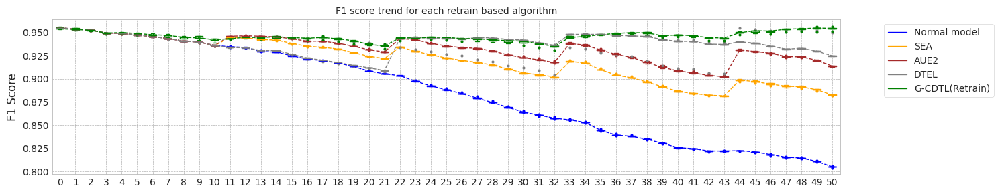

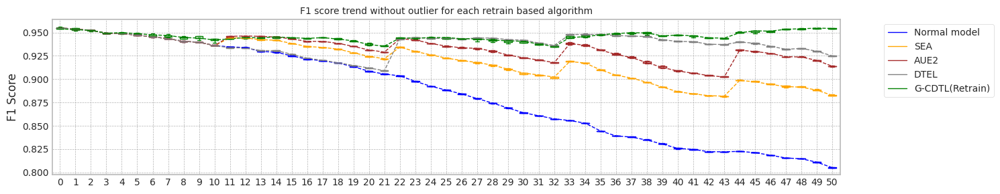

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.252821207046509
Base flops (train + inference flops of normal model, median): 3558735000.0


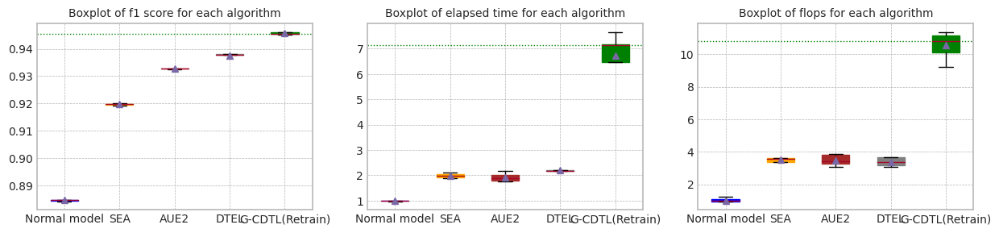

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.252821207046509


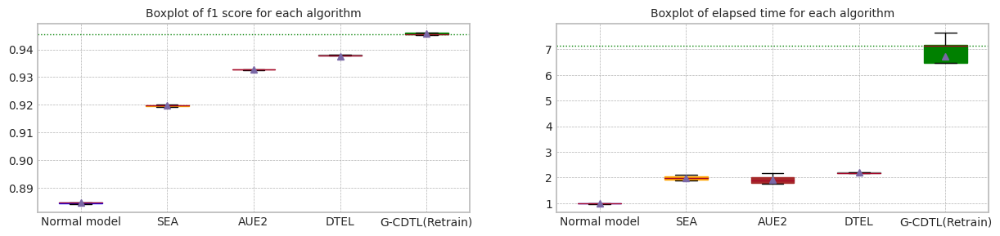

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.349063,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.199574,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.669537,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,9.986040,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.252821,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.252821,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.249739,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.415374,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.429672,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.429888,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.265102,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.188229,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.415374,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.112123,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.919482,0.882543,19.467470,5.801160e+09,7.100940e+09,1.290210e+10
1,1.0,0.954396,0.953533,0.919812,0.882414,21.678966,6.279660e+09,6.671160e+09,1.295082e+10
2,2.0,0.954834,0.953377,0.919739,0.882997,21.058708,6.129585e+09,5.933835e+09,1.206342e+10
3,3.0,0.954910,0.953454,0.920043,0.883587,19.524386,5.713290e+09,6.257475e+09,1.197076e+10
4,4.0,0.954901,0.953539,0.919323,0.881500,20.452673,5.962110e+09,6.733365e+09,1.269548e+10
5,median,0.954901,0.953533,0.919739,0.882543,20.452673,5.962110e+09,6.671160e+09,1.269548e+10
6,std,0.000235,0.000094,0.000283,0.000771,0.962042,2.321473e+08,4.518022e+08,4.670282e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.932750,0.913781,20.507080,6.016485e+09,7.515930e+09,1.353242e+10
1,1.0,0.954396,0.953533,0.932797,0.914057,18.499949,5.553645e+09,6.144810e+09,1.169846e+10
2,2.0,0.954834,0.953377,0.932676,0.913197,18.091380,5.442285e+09,5.446200e+09,1.088848e+10
3,3.0,0.954910,0.953454,0.932613,0.913493,19.392268,5.695020e+09,6.438870e+09,1.213389e+10
4,4.0,0.954901,0.953539,0.933203,0.914393,22.358363,6.351870e+09,7.322790e+09,1.367466e+10
5,median,0.954901,0.953533,0.932750,0.913781,19.392268,5.695020e+09,6.438870e+09,1.213389e+10
6,std,0.000235,0.000094,0.000232,0.000468,1.718749,3.709429e+08,8.547390e+08,1.199348e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.937718,0.924729,22.142631,6.510210e+09,6.541095e+09,1.305130e+10
1,1.0,0.954396,0.953533,0.937863,0.925362,20.736035,6.123060e+09,5.207385e+09,1.133044e+10
2,2.0,0.954834,0.953377,0.935347,0.949569,22.307747,6.417555e+09,4.458750e+09,1.087630e+10
3,3.0,0.954910,0.953454,0.937959,0.924692,22.606522,6.482370e+09,5.467515e+09,1.194988e+10
4,4.0,0.954901,0.953539,0.938199,0.924839,26.021426,7.211430e+09,5.885115e+09,1.309654e+10
5,median,0.954901,0.953533,0.937863,0.924839,22.307747,6.482370e+09,5.467515e+09,1.194988e+10
6,std,0.000235,0.000094,0.001170,0.011033,1.958477,4.010799e+08,7.749768e+08,1.000327e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.946162,0.954473,73.459345,3.964846e+10,62685000.0,3.971114e+10
1,1.0,0.953787,0.952034,0.945072,0.953660,52.532340,3.272046e+10,62685000.0,3.278314e+10
2,2.0,0.953612,0.952352,0.945330,0.954322,78.579948,4.039136e+10,62685000.0,4.045404e+10
3,3.0,0.956214,0.954604,0.945417,0.950979,73.342231,3.843519e+10,62685000.0,3.849788e+10
4,4.0,0.955650,0.954514,0.946085,0.956009,66.337559,3.589273e+10,62685000.0,3.595542e+10
5,median,0.953868,0.953043,0.945417,0.954322,73.342231,3.843519e+10,62685000.0,3.849788e+10
6,std,0.001212,0.001198,0.000484,0.001840,10.107874,3.132247e+09,0.0,3.132247e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 14:28:50,304] [INFO] [profiler.py:80:start_profile] Flops profiler started


 52%|█████▎    | 1050/2000 [00:03<00:02, 343.70it/s]

Early stop: 1050
[2023-11-29 14:28:53,369] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4114665000
precision_recall_fscore: (array([0.94742189, 0.95121469]), array([0.93789288, 0.95878957]), array([0.94263331, 0.95498711]), array([3977, 5023]))
Test f1 score: 0.9549871108467181
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.00it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8842520491756547
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:29:03,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:29:03,670] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 447/2000 [00:03<00:13, 112.50it/s]

[2023-11-29 14:29:19,729] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:29:19,732] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 7056000000 1753920000 40309920000
precision_recall_fscore: (array([0.93622829, 0.95895372]), array([0.94870505, 0.94883536]), array([0.94242538, 0.95386771]), array([3977, 5023]))
Test f1 score: 0.9538677073951766
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.95it/s]

mean of drift:
x0    0.265261
x1    0.092270
x2    0.054987
x3    0.054131
z0    0.262444
dtype: float64
Mean F1 for all data: 0.9142446643844458
inference_flops: 1002915000
Normal model median        : 0.8842520491756547
Drift tolerant model median: 0.9142446643844458
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 14:29:30,133] [INFO] [profiler.py:80:start_profile] Flops profiler started



 41%|████      | 818/2000 [00:02<00:03, 345.96it/s]

Early stop: 818
[2023-11-29 14:29:32,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3206385000
precision_recall_fscore: (array([0.94441637, 0.95259818]), array([0.93990445, 0.95620147]), array([0.94215501, 0.95439642]), array([3977, 5023]))
Test f1 score: 0.9543964232488823
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8853190652178773
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:29:42,745] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:29:42,748] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██        | 423/2000 [00:03<00:14, 108.74it/s]

[2023-11-29 14:29:58,881] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:29:58,882] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6678000000 1659960000 39837960000
precision_recall_fscore: (array([0.93217007, 0.96268505]), array([0.95373397, 0.94505276]), array([0.94282873, 0.95378742]), array([3977, 5023]))
Test f1 score: 0.9537874221418525
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.89it/s]


mean of drift:
x0    0.272695
x1    0.145582
x2    0.356220
x3    0.032937
z0    0.249344
dtype: float64
Mean F1 for all data: 0.9018750373875399
inference_flops: 1002915000
Normal model median        : 0.884785557196766
Drift tolerant model median: 0.908059850885993
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 14:30:09,401] [INFO] [profiler.py:80:start_profile] Flops profiler started


 33%|███▎      | 668/2000 [00:01<00:03, 348.58it/s]

Early stop: 668
[2023-11-29 14:30:11,323] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2619135000
precision_recall_fscore: (array([0.9483066 , 0.95012813]), array([0.93638421, 0.9595859 ]), array([0.94230769, 0.9548336 ]), array([3977, 5023]))
Test f1 score: 0.9548335974643423
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.02it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8845144617193914
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:30:21,575] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:30:21,578] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 24%|██▍       | 482/2000 [00:04<00:14, 107.93it/s]

[2023-11-29 14:30:26,229] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:30:26,231] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 425250000 7607250000 1890945000 9923445000
precision_recall_fscore: (array([0.9346858 , 0.95986285]), array([0.94996228, 0.94744177]), array([0.94226213, 0.95361186]), array([3977, 5023]))
Test f1 score: 0.9536118625388238
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.88it/s]

mean of drift:
x0    0.287107
x1    0.127346
x2    0.061458
x3    0.399946
z0    0.257349
dtype: float64
Mean F1 for all data: 0.9126705257593819
inference_flops: 1002915000
Normal model median        : 0.8845144617193914
Drift tolerant model median: 0.9126705257593819
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 14:30:36,772] [INFO] [profiler.py:80:start_profile] Flops profiler started



 43%|████▎     | 857/2000 [00:02<00:03, 340.96it/s]

Early stop: 857
[2023-11-29 14:30:39,291] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3359070000
precision_recall_fscore: (array([0.94786368, 0.95067088]), array([0.93713855, 0.95918774]), array([0.9424706 , 0.95491032]), array([3977, 5023]))
Test f1 score: 0.9549103161232781
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.06it/s]


mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8846187232669092
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:30:49,468] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:30:49,471] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 20%|█▉        | 396/2000 [00:03<00:14, 107.93it/s]

[2023-11-29 14:31:05,529] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:31:05,530] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6252750000 1554255000 39307005000
precision_recall_fscore: (array([0.9601251 , 0.94325005]), array([0.92632638, 0.96954012]), array([0.94292296, 0.95621441]), array([3977, 5023]))
Test f1 score: 0.9562144119379541
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  4.98it/s]

mean of drift:
x0    0.284514
x1    0.115124
x2    0.057895
x3    0.045505
z0    0.250370
dtype: float64
Mean F1 for all data: 0.9183306240892063
inference_flops: 1002915000
Normal model median        : 0.8845665924931503
Drift tolerant model median: 0.9134575950719139
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 14:31:15,876] [INFO] [profiler.py:80:start_profile] Flops profiler started



 46%|████▌     | 915/2000 [00:02<00:03, 355.60it/s]

Early stop: 915
[2023-11-29 14:31:18,456] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3586140000
precision_recall_fscore: (array([0.94763599, 0.9508488 ]), array([0.93738999, 0.95898865]), array([0.94248515, 0.95490138]), array([3977, 5023]))
Test f1 score: 0.9549013777381307
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.03it/s]

mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.8847034902908313
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 14:31:28,680] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:31:28,682] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 19%|█▉        | 388/2000 [00:03<00:15, 105.83it/s]

[2023-11-29 14:31:37,143] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:31:37,146] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 12285000000 6126750000 1522935000 19934685000
precision_recall_fscore: (array([0.95744681, 0.94422853]), array([0.92783505, 0.96735019]), array([0.94240838, 0.95564952]), array([3977, 5023]))
Test f1 score: 0.9556495230602813
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:10<00:00,  5.01it/s]


mean of drift:
x0    0.217922
x1    0.125381
x2    0.226747
x3    0.445538
z0    0.225512
dtype: float64
Mean F1 for all data: 0.9173754768143839
inference_flops: 1002915000
Normal model median        : 0.8846187232669092
Drift tolerant model median: 0.9142446643844458
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  4.86it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:31:49,296] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:31:49,298] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:32:08,038] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:32:08,039] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:20<04:14,  6.07s/it]

G-CDTL train flops: 3500000000 1358000000 337560000 5195560000


 33%|███▎      | 17/51 [00:22<00:17,  1.91it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:32:09,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:32:09,841] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:32:26,254] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:32:26,256] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:38<02:56,  5.36s/it]

G-CDTL train flops: 3500000000 934500000 232290000 4666790000


 51%|█████     | 26/51 [00:40<00:12,  1.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:32:28,106] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:32:28,108] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:32:42,093] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:32:42,095] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:54<01:50,  4.61s/it]

G-CDTL train flops: 2864750000 803250000 199665000 3867665000


 69%|██████▊   | 35/51 [00:56<00:07,  2.18it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:32:43,945] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:32:43,947] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:33:00,756] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:33:00,758] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:13<01:21,  5.43s/it]

G-CDTL train flops: 3500000000 904750000 224895000 4629645000


 86%|████████▋ | 44/51 [01:14<00:03,  1.98it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:33:02,601] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:33:02,604] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:33:29,318] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:33:29,320] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:41<00:50,  8.43s/it]

G-CDTL train flops: 3500000000 2938250000 730365000 7168615000


100%|██████████| 51/51 [01:43<00:00,  2.02s/it]


Early stop at  [775, 533, 458, 516, 1678]
Train flops  [5195560000, 4666790000, 3867665000, 4629645000, 7168615000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9466799064314227
G_CDTL+AUE median: 0.9466799064314227
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:26,  1.53it/s]

Ensemble_SEA train flops: 468060000


 35%|███▌      | 18/51 [00:07<00:23,  1.38it/s]

Ensemble_SEA train flops: 359310000


 53%|█████▎    | 27/51 [00:09<00:06,  3.92it/s]

Ensemble_SEA train flops: 19575000


 71%|███████   | 36/51 [00:14<00:17,  1.16s/it]

Ensemble_SEA train flops: 702090000


 90%|█████████ | 46/51 [00:20<00:05,  1.03s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:21<00:00,  2.40it/s]


Early stop at  [1075, 825, 44, 1613, 1999]
Train flops  [468060000, 359310000, 19575000, 702090000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9160618642678282
SEA median: 0.9160618642678282
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:26,  1.58it/s]

Ensemble_SEA train flops: 451965000


 37%|███▋      | 19/51 [00:07<00:16,  1.92it/s]

Ensemble_SEA train flops: 317985000


 53%|█████▎    | 27/51 [00:11<00:21,  1.14it/s]

Ensemble_SEA train flops: 483285000


 71%|███████   | 36/51 [00:16<00:17,  1.16s/it]

Ensemble_SEA train flops: 685560000


 90%|█████████ | 46/51 [00:21<00:05,  1.03s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.23it/s]


Early stop at  [1038, 730, 1110, 1575, 1999]
Train flops  [451965000, 317985000, 483285000, 685560000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9371662980494386
AUE median: 0.9371662980494386
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:28,  1.48it/s]

Ensemble_DTEL train flops: 337125000
Ensemble_DTEL train flops: 1740000


 33%|███▎      | 17/51 [00:04<00:07,  4.43it/s]

Ensemble_DTEL train flops: 486330000


 37%|███▋      | 19/51 [00:08<00:27,  1.17it/s]

Ensemble_DTEL train flops: 198360000


 53%|█████▎    | 27/51 [00:12<00:23,  1.03it/s]

Ensemble_DTEL train flops: 542445000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:14<00:03,  4.11it/s]

Ensemble_DTEL train flops: 870000000


 73%|███████▎  | 37/51 [00:19<00:17,  1.28s/it]

Ensemble_DTEL train flops: 238815000


 88%|████████▊ | 45/51 [00:24<00:08,  1.34s/it]

Ensemble_DTEL train flops: 788655000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:25<00:00,  1.97it/s]


Early stop at  [774, 3, 1117, 455, 1246, 4, 1999, 548, 1812, 4]
Train flops  [337125000, 1740000, 486330000, 198360000, 542445000, 2175000, 870000000, 238815000, 788655000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9399157840081391
DTEL median: 0.9399157840081391
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.06it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:34:42,549] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:34:42,552] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:34:58,865] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:34:58,866] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:18<03:42,  5.30s/it]

G-CDTL train flops: 3500000000 813750000 202275000 4516025000


 33%|███▎      | 17/51 [00:19<00:16,  2.06it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:00,714] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:00,717] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:35:13,393] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:35:13,395] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:32<02:19,  4.21s/it]

G-CDTL train flops: 2402750000 834750000 207495000 3444995000


 51%|█████     | 26/51 [00:34<00:10,  2.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:15,212] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:15,215] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:35:31,926] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:35:31,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:51<02:09,  5.38s/it]

G-CDTL train flops: 3500000000 852250000 211845000 4564095000


 69%|██████▊   | 35/51 [00:52<00:08,  1.99it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:33,770] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:33,773] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:35:50,309] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:35:50,310] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:09<01:20,  5.37s/it]

G-CDTL train flops: 3500000000 819000000 203580000 4522580000


 86%|████████▋ | 44/51 [01:11<00:03,  2.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:35:52,086] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:35:52,089] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:36:10,726] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:36:10,728] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:29<00:36,  6.00s/it]

G-CDTL train flops: 3500000000 1130500000 281010000 4911510000


100%|██████████| 51/51 [01:31<00:00,  1.79s/it]


Early stop at  [464, 476, 486, 467, 645]
Train flops  [4516025000, 3444995000, 4564095000, 4522580000, 4911510000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9456149878726038
G_CDTL+AUE median: 0.9461474471520133
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:35,  1.19it/s]

Ensemble_SEA train flops: 449790000


 37%|███▋      | 19/51 [00:07<00:17,  1.80it/s]

Ensemble_SEA train flops: 349740000


 53%|█████▎    | 27/51 [00:12<00:27,  1.16s/it]

Ensemble_SEA train flops: 685125000


 71%|███████   | 36/51 [00:17<00:21,  1.44s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:22<00:06,  1.09s/it]

Ensemble_SEA train flops: 597690000


100%|██████████| 51/51 [00:23<00:00,  2.14it/s]


Early stop at  [1033, 803, 1574, 1999, 1373]
Train flops  [449790000, 349740000, 685125000, 870000000, 597690000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9239114389272733
SEA median: 0.9199866515975508
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:23,  1.75it/s]

Ensemble_SEA train flops: 368445000


 37%|███▋      | 19/51 [00:07<00:16,  1.90it/s]

Ensemble_SEA train flops: 331470000


 53%|█████▎    | 27/51 [00:11<00:28,  1.20s/it]

Ensemble_SEA train flops: 720795000


 73%|███████▎  | 37/51 [00:17<00:12,  1.11it/s]

Ensemble_SEA train flops: 716445000


 88%|████████▊ | 45/51 [00:22<00:08,  1.43s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:23<00:00,  2.13it/s]


Early stop at  [846, 761, 1656, 1646, 1999]
Train flops  [368445000, 331470000, 720795000, 716445000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9372155262374571
AUE median: 0.9371909121434479
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:29,  1.42it/s]

Ensemble_DTEL train flops: 347565000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:05<00:07,  4.29it/s]

Ensemble_DTEL train flops: 318855000


 37%|███▋      | 19/51 [00:09<00:32,  1.03s/it]

Ensemble_DTEL train flops: 528525000


 53%|█████▎    | 27/51 [00:14<00:28,  1.20s/it]

Ensemble_DTEL train flops: 699480000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:15<00:04,  3.89it/s]

Ensemble_DTEL train flops: 730365000


 73%|███████▎  | 37/51 [00:20<00:14,  1.06s/it]

Ensemble_DTEL train flops: 127455000


 88%|████████▊ | 45/51 [00:25<00:08,  1.44s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:26<00:00,  1.90it/s]


Early stop at  [798, 2, 732, 1214, 1607, 4, 1678, 292, 1999, 3]
Train flops  [347565000, 1305000, 318855000, 528525000, 699480000, 2175000, 730365000, 127455000, 870000000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9395432897481842
DTEL median: 0.9397295368781617
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.00it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:37:28,642] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:37:28,644] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:37:44,980] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:37:44,982] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:18<03:43,  5.31s/it]

G-CDTL train flops: 3500000000 745500000 185310000 4430810000


 33%|███▎      | 17/51 [00:19<00:16,  2.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:37:46,788] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:37:46,790] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:37:57,192] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:37:57,193] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:30<01:56,  3.53s/it]

G-CDTL train flops: 1813000000 761250000 189225000 2763475000


 51%|█████     | 26/51 [00:32<00:09,  2.52it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:37:59,070] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:37:59,073] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:38:22,424] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:38:22,426] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:55<02:56,  7.35s/it]

G-CDTL train flops: 3500000000 2084250000 518085000 6102335000


 69%|██████▊   | 35/51 [00:57<00:09,  1.62it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:38:24,287] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:38:24,290] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:38:41,491] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:38:41,492] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:14<01:24,  5.66s/it]

G-CDTL train flops: 3500000000 820750000 204015000 4524765000


 86%|████████▋ | 44/51 [01:16<00:03,  1.95it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:38:43,287] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:38:43,290] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:38:49,556] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:38:49,558] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:22<00:13,  2.30s/it]

G-CDTL train flops: 84000000 1139250000 283185000 1506435000


100%|██████████| 51/51 [01:23<00:00,  1.65s/it]


Early stop at  [425, 434, 1190, 468, 650]
Train flops  [4430810000, 2763475000, 6102335000, 4524765000, 1506435000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9455994152293417
G_CDTL+AUE median: 0.9456149878726038
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:35,  1.17it/s]

Ensemble_SEA train flops: 441525000


 35%|███▌      | 18/51 [00:07<00:26,  1.26it/s]

Ensemble_SEA train flops: 400635000


 53%|█████▎    | 27/51 [00:13<00:31,  1.33s/it]

Ensemble_SEA train flops: 791700000


 71%|███████   | 36/51 [00:16<00:12,  1.22it/s]

Ensemble_SEA train flops: 398895000


 88%|████████▊ | 45/51 [00:22<00:08,  1.43s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:23<00:00,  2.13it/s]


Early stop at  [1014, 920, 1819, 916, 1999]
Train flops  [441525000, 400635000, 791700000, 398895000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9236560701249291
SEA median: 0.9236560701249291
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:24,  1.64it/s]

Ensemble_SEA train flops: 407160000


 37%|███▋      | 19/51 [00:08<00:28,  1.13it/s]

Ensemble_SEA train flops: 692520000


 55%|█████▍    | 28/51 [00:12<00:14,  1.56it/s]

Ensemble_SEA train flops: 420210000


 71%|███████   | 36/51 [00:18<00:20,  1.38s/it]

Ensemble_SEA train flops: 821280000


 90%|█████████ | 46/51 [00:21<00:02,  1.74it/s]

Ensemble_SEA train flops: 336690000


100%|██████████| 51/51 [00:22<00:00,  2.24it/s]


Early stop at  [935, 1591, 965, 1887, 773]
Train flops  [407160000, 692520000, 420210000, 821280000, 336690000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9371230937284245
AUE median: 0.9371662980494386
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:05<00:53,  1.27s/it]

Ensemble_DTEL train flops: 737325000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:06<00:08,  3.94it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:13<00:47,  1.49s/it]

Ensemble_DTEL train flops: 436740000


 53%|█████▎    | 27/51 [00:17<00:25,  1.07s/it]

Ensemble_DTEL train flops: 575940000
Ensemble_DTEL train flops: 1740000


 69%|██████▊   | 35/51 [00:18<00:03,  4.09it/s]

Ensemble_DTEL train flops: 870000000


 71%|███████   | 36/51 [00:24<00:26,  1.74s/it]

Ensemble_DTEL train flops: 197925000


 88%|████████▊ | 45/51 [00:29<00:07,  1.31s/it]

Ensemble_DTEL train flops: 752985000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:30<00:00,  1.66it/s]


Early stop at  [1694, 2, 1999, 1003, 1323, 3, 1999, 454, 1730, 3]
Train flops  [737325000, 1305000, 870000000, 436740000, 575940000, 1740000, 870000000, 197925000, 752985000, 1740000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9394964950857437
DTEL median: 0.9395432897481842
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:40:10,163] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:40:10,165] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:40:32,770] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:40:32,771] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:24<05:05,  7.27s/it]

G-CDTL train flops: 3500000000 1895250000 471105000 5866355000


 33%|███▎      | 17/51 [00:25<00:20,  1.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:40:34,598] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:40:34,600] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:40:51,337] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:40:51,338] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:43<02:05,  3.91s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


 51%|█████     | 26/51 [00:44<00:12,  1.98it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:40:53,137] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:40:53,140] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:41:10,896] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:41:10,898] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:02<02:17,  5.75s/it]

G-CDTL train flops: 3500000000 899500000 223590000 4623090000


 69%|██████▊   | 35/51 [01:04<00:08,  1.94it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:41:12,667] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:41:12,670] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:41:17,404] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:41:17,406] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:09<00:27,  1.84s/it]

G-CDTL train flops: 78750000 841750000 209235000 1129735000


 86%|████████▋ | 44/51 [01:10<00:02,  3.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:41:19,180] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:41:19,182] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:41:44,252] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:41:44,253] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:35<00:46,  7.79s/it]

G-CDTL train flops: 3500000000 2278500000 566370000 6344870000


100%|██████████| 51/51 [01:37<00:00,  1.90s/it]


Early stop at  [1082, 438, 513, 480, 1301]
Train flops  [5866355000, 4459215000, 4623090000, 1129735000, 6344870000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9466776060387235
G_CDTL+AUE median: 0.9461462969556637
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:02<00:12,  3.37it/s]

Ensemble_SEA train flops: 93090000


 37%|███▋      | 19/51 [00:06<00:19,  1.67it/s]

Ensemble_SEA train flops: 401505000


 55%|█████▍    | 28/51 [00:10<00:15,  1.47it/s]

Ensemble_SEA train flops: 475020000


 71%|███████   | 36/51 [00:14<00:15,  1.01s/it]

Ensemble_SEA train flops: 553755000


 88%|████████▊ | 45/51 [00:19<00:08,  1.35s/it]

Ensemble_SEA train flops: 779955000


100%|██████████| 51/51 [00:21<00:00,  2.42it/s]


Early stop at  [213, 922, 1091, 1272, 1792]
Train flops  [93090000, 401505000, 475020000, 553755000, 779955000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9278383908291034
SEA median: 0.9237837545261012
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:26,  1.54it/s]

Ensemble_SEA train flops: 447180000


 35%|███▌      | 18/51 [00:09<00:47,  1.45s/it]

Ensemble_SEA train flops: 870000000


 55%|█████▍    | 28/51 [00:13<00:13,  1.74it/s]

Ensemble_SEA train flops: 345390000


 71%|███████   | 36/51 [00:19<00:21,  1.44s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:24<00:08,  1.47s/it]

Ensemble_SEA train flops: 849120000


100%|██████████| 51/51 [00:26<00:00,  1.95it/s]


Early stop at  [1027, 1999, 793, 1999, 1951]
Train flops  [447180000, 870000000, 345390000, 870000000, 849120000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9366439146729932
AUE median: 0.9371446958889316
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:34,  1.22it/s]

Ensemble_DTEL train flops: 423690000
Ensemble_DTEL train flops: 1740000


 33%|███▎      | 17/51 [00:05<00:07,  4.32it/s]

Ensemble_DTEL train flops: 621180000


 35%|███▌      | 18/51 [00:10<00:55,  1.68s/it]

Ensemble_DTEL train flops: 406725000


 53%|█████▎    | 27/51 [00:14<00:23,  1.03it/s]

Ensemble_DTEL train flops: 507210000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:16<00:03,  4.19it/s]

Ensemble_DTEL train flops: 663375000


 71%|███████   | 36/51 [00:20<00:22,  1.49s/it]

Ensemble_DTEL train flops: 243165000


 88%|████████▊ | 45/51 [00:26<00:08,  1.49s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:27<00:00,  1.84it/s]


Early stop at  [973, 3, 1427, 934, 1165, 4, 1524, 558, 1999, 4]
Train flops  [423690000, 1740000, 621180000, 406725000, 507210000, 2175000, 663375000, 243165000, 870000000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9399886113795578
DTEL median: 0.9397295368781617
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  4.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:02,512] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:02,514] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 17.0
[2023-11-29 14:43:08,701] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:08,702] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:08<01:29,  2.14s/it]

G-CDTL train flops: 119000000 1058750000 263175000 1440925000


 33%|███▎      | 17/51 [00:09<00:10,  3.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:10,563] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:10,566] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 26.0
[2023-11-29 14:43:27,378] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:27,379] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:26<02:55,  5.33s/it]

G-CDTL train flops: 3500000000 708750000 176175000 4384925000


 51%|█████     | 26/51 [00:28<00:12,  2.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:29,188] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:29,190] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 35.0
[2023-11-29 14:43:47,135] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:47,136] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:46<02:19,  5.79s/it]

G-CDTL train flops: 3500000000 890750000 221415000 4612165000


 69%|██████▊   | 35/51 [00:48<00:08,  1.92it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:43:48,940] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:43:48,942] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 44.0
[2023-11-29 14:43:59,978] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:43:59,979] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:59<00:56,  3.74s/it]

G-CDTL train flops: 78750000 1953000000 485460000 2517210000


 86%|████████▋ | 44/51 [01:00<00:02,  2.47it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 14:44:01,843] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 14:44:01,846] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 53.0
[2023-11-29 14:44:25,892] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 14:44:25,894] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:25<00:45,  7.57s/it]

G-CDTL train flops: 3500000000 2045750000 508515000 6054265000


100%|██████████| 51/51 [01:26<00:00,  1.69s/it]


Early stop at  [604, 404, 508, 1115, 1168]
Train flops  [1440925000, 4384925000, 4612165000, 2517210000, 6054265000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.945532866096554
G_CDTL+AUE median: 0.9456149878726038
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:32,  1.28it/s]

Ensemble_SEA train flops: 382800000


 35%|███▌      | 18/51 [00:06<00:20,  1.58it/s]

Ensemble_SEA train flops: 282315000


 53%|█████▎    | 27/51 [00:10<00:21,  1.12it/s]

Ensemble_SEA train flops: 466320000


 73%|███████▎  | 37/51 [00:15<00:11,  1.25it/s]

Ensemble_SEA train flops: 587685000


 90%|█████████ | 46/51 [00:21<00:05,  1.01s/it]

Ensemble_SEA train flops: 789090000


100%|██████████| 51/51 [00:22<00:00,  2.30it/s]


Early stop at  [879, 648, 1071, 1350, 1813]
Train flops  [382800000, 282315000, 466320000, 587685000, 789090000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9239543469848055
SEA median: 0.9239114389272733
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:19,  2.08it/s]

Ensemble_SEA train flops: 283185000


 37%|███▋      | 19/51 [00:06<00:16,  1.98it/s]

Ensemble_SEA train flops: 297975000


 53%|█████▎    | 27/51 [00:10<00:23,  1.03it/s]

Ensemble_SEA train flops: 513735000


 71%|███████   | 36/51 [00:15<00:18,  1.20s/it]

Ensemble_SEA train flops: 671640000


 90%|█████████ | 46/51 [00:21<00:05,  1.10s/it]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:22<00:00,  2.24it/s]


Early stop at  [650, 684, 1180, 1543, 1999]
Train flops  [283185000, 297975000, 513735000, 671640000, 870000000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9372900132714719
AUE median: 0.9371662980494386
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:21,  1.87it/s]

Ensemble_DTEL train flops: 325815000
Ensemble_DTEL train flops: 1305000


 33%|███▎      | 17/51 [00:04<00:07,  4.54it/s]

Ensemble_DTEL train flops: 870000000


 37%|███▋      | 19/51 [00:09<00:37,  1.16s/it]

Ensemble_DTEL train flops: 92220000


 53%|█████▎    | 27/51 [00:15<00:36,  1.52s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 69%|██████▊   | 35/51 [00:17<00:04,  3.67it/s]

Ensemble_DTEL train flops: 469365000


 73%|███████▎  | 37/51 [00:20<00:12,  1.11it/s]

Ensemble_DTEL train flops: 191835000


 88%|████████▊ | 45/51 [00:26<00:08,  1.47s/it]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:27<00:00,  1.84it/s]


Early stop at  [748, 2, 1999, 211, 1999, 4, 1078, 440, 1999, 4]
Train flops  [325815000, 1305000, 870000000, 92220000, 870000000, 2175000, 469365000, 191835000, 870000000, 2175000]
Mean of drift:
x0    0.010179
x1    0.013617
x2    0.013444
x3    0.013580
z0    0.162536
dtype: float64
Mean F1 for all data: 0.9396315743074272
DTEL median: 0.9396315743074272


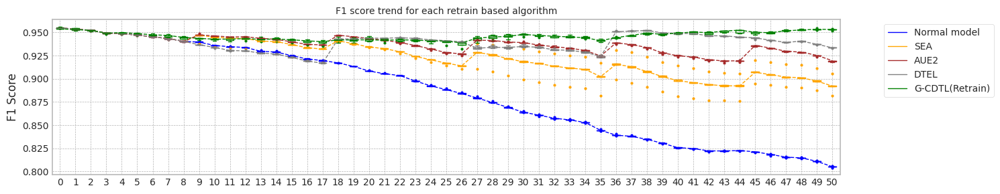

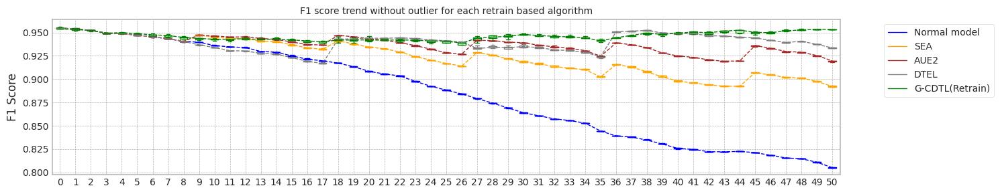

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.21947169303894
Base flops (train + inference flops of normal model, median): 3558735000.0


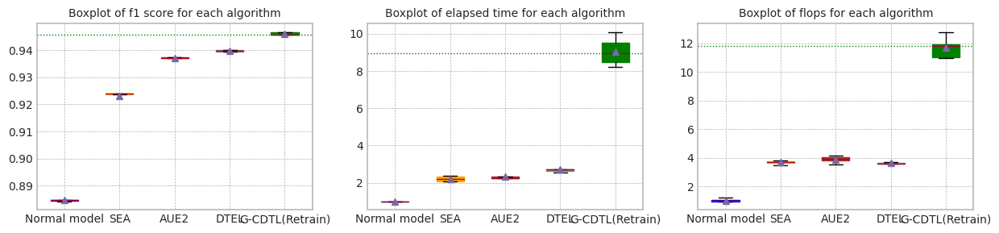

Base elapsed time (inference elapsed time of normal model, median (ms)): 10.21947169303894


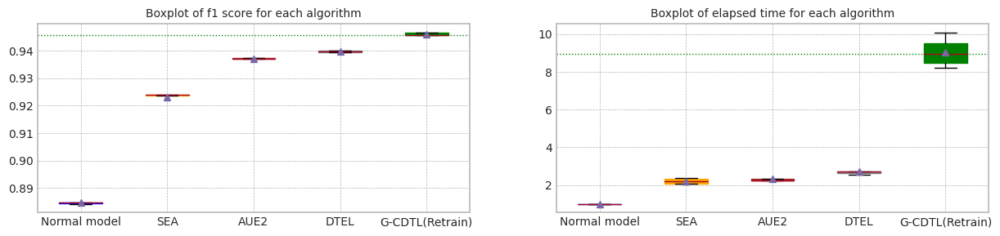

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.884252,0.804117,10.279109,4.114665e+09,199665000.0,4.314330e+09
1,1.0,0.954396,0.953533,0.885319,0.805845,10.219472,3.206385e+09,199665000.0,3.406050e+09
2,2.0,0.954834,0.953377,0.884514,0.805347,10.230561,2.619135e+09,199665000.0,2.818800e+09
3,3.0,0.954910,0.953454,0.884619,0.805126,10.154500,3.359070e+09,199665000.0,3.558735e+09
4,4.0,0.954901,0.953539,0.884703,0.805126,10.203157,3.586140e+09,199665000.0,3.785805e+09
5,median,0.954901,0.953533,0.884619,0.805126,10.219472,3.359070e+09,199665000.0,3.558735e+09
6,std,0.000235,0.000094,0.000395,0.000629,0.045124,5.458204e+08,0.0,5.458204e+08


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.914245,0.866866,10.377592,4.030992e+10,1.002915e+09,4.131284e+10
1,1.0,0.953787,0.952034,0.901875,0.843573,10.496662,3.983796e+10,1.002915e+09,4.084088e+10
2,2.0,0.953612,0.952352,0.912671,0.854573,10.520150,9.923445e+09,1.002915e+09,1.092636e+10
3,3.0,0.956214,0.954604,0.918331,0.872086,10.322227,3.930700e+10,1.002915e+09,4.030992e+10
4,4.0,0.955650,0.954514,0.917375,0.868027,10.249926,1.993468e+10,1.002915e+09,2.093760e+10
5,median,0.953868,0.953043,0.914245,0.866866,10.377592,3.930700e+10,1.002915e+09,4.030992e+10
6,std,0.001212,0.001198,0.006575,0.011744,0.114705,1.408887e+10,0.000000e+00,1.408887e+10


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.916062,0.882002,21.279801,6.005175e+09,7.406745e+09,1.341192e+10
1,1.0,0.954396,0.953533,0.923911,0.892155,23.949814,6.538485e+09,7.031775e+09,1.357026e+10
2,2.0,0.954834,0.953377,0.923656,0.891820,23.997845,6.488895e+09,6.394935e+09,1.288383e+10
3,3.0,0.954910,0.953454,0.927838,0.905471,21.179178,5.889465e+09,6.535440e+09,1.242490e+10
4,4.0,0.954901,0.953539,0.923954,0.892774,22.291913,6.094350e+09,6.967395e+09,1.306174e+10
5,median,0.954901,0.953533,0.923911,0.892155,22.291913,6.094350e+09,6.967395e+09,1.306174e+10
6,std,0.000235,0.000094,0.004292,0.008345,1.379708,2.930570e+08,4.066115e+08,4.522286e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.937166,0.919556,22.937123,6.394935e+09,7.996170e+09,1.439110e+10
1,1.0,0.954396,0.953533,0.937216,0.919665,23.976489,6.593295e+09,7.286250e+09,1.387954e+10
2,2.0,0.954834,0.953377,0.937123,0.918887,22.817782,6.264000e+09,6.369705e+09,1.263370e+10
3,3.0,0.954910,0.953454,0.936644,0.918153,26.246580,6.967830e+09,7.813470e+09,1.478130e+10
4,4.0,0.954901,0.953539,0.937290,0.919556,22.890305,6.222675e+09,7.295385e+09,1.351806e+10
5,median,0.954901,0.953533,0.937166,0.919556,22.937123,6.394935e+09,7.295385e+09,1.387954e+10
6,std,0.000235,0.000094,0.000256,0.000644,1.462044,3.043669e+08,6.325230e+08,8.291738e+08


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.954987,0.953625,0.939916,0.933431,25.909458,7.053960e+09,6.149160e+09,1.320312e+10
1,1.0,0.954396,0.953533,0.939543,0.933464,26.853448,7.213605e+09,5.540160e+09,1.275376e+10
2,2.0,0.954834,0.953377,0.939496,0.933005,30.723142,8.031840e+09,4.814145e+09,1.284598e+10
3,3.0,0.954910,0.953454,0.939989,0.933726,27.735462,7.327575e+09,5.687625e+09,1.301520e+10
4,4.0,0.954901,0.953539,0.939632,0.933627,27.740042,7.281030e+09,5.548425e+09,1.282946e+10
5,median,0.954901,0.953533,0.939632,0.933464,27.735462,7.281030e+09,5.548425e+09,1.284598e+10
6,std,0.000235,0.000094,0.000223,0.000277,1.804324,3.779601e+08,4.794511e+08,1.803323e+08


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.953868,0.953043,0.946680,0.951767,103.134616,4.546296e+10,53730000.0,4.551669e+10
1,1.0,0.953787,0.952034,0.945615,0.953146,91.259824,4.189389e+10,53730000.0,4.194762e+10
2,2.0,0.953612,0.952352,0.945599,0.953296,84.053945,3.926250e+10,53730000.0,3.931624e+10
3,3.0,0.956214,0.954604,0.946678,0.953127,97.108954,4.235795e+10,53730000.0,4.241168e+10
4,4.0,0.955650,0.954514,0.945533,0.954077,86.503912,3.894418e+10,53730000.0,3.899790e+10
5,median,0.953868,0.953043,0.945615,0.953146,91.259824,4.189389e+10,53730000.0,4.194762e+10
6,std,0.001212,0.001198,0.000601,0.000832,7.796249,2.650442e+09,0.0,2.650442e+09


Test F1 Score: 0.9548057650842703
G-CDTL, 1-retrain: 0.9363882679917808


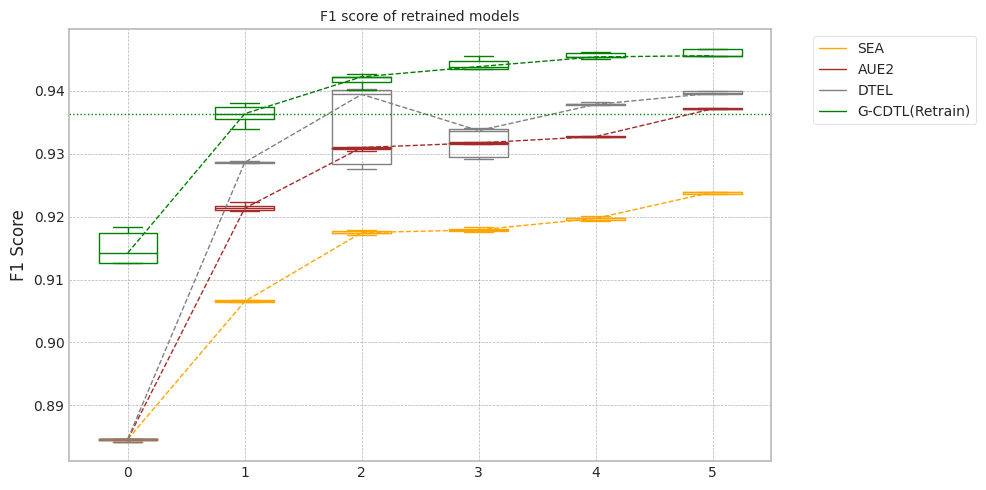

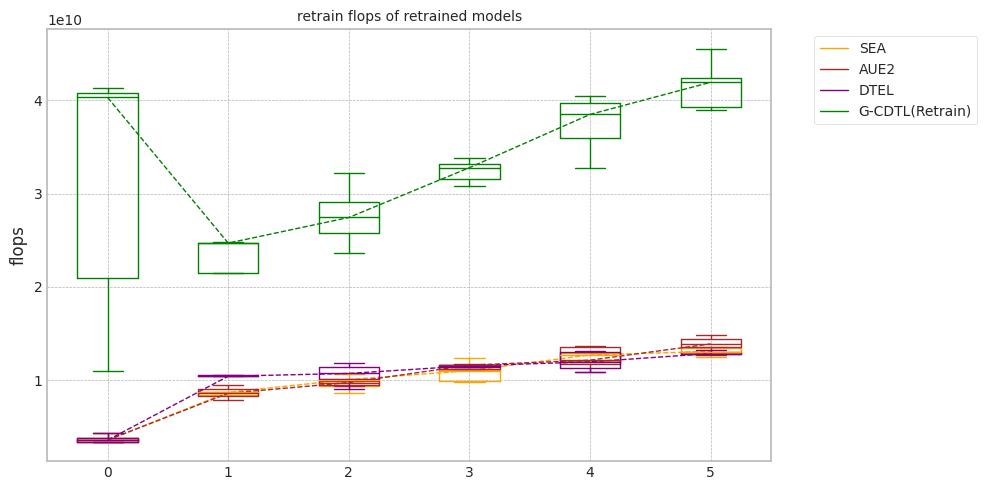

In [ ]:
experiment_all(2000,'case3',X1, Y1,train_size, test_size,avaible_range = 300,
               lambda_f2=0.8,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

## synthetic data의 생성 (Case #4 MI의 고정, Drift의 증가)

+ $P_t(y|X) = P_{t+w}(y|X)$ and $P_t(X) \ne P_{t+w}(X)$
+ Virtual Drift
+ 즉, Concept (본 Dataset에서 MI의 변화)의 변화는 없고, P(X)만 변함.

### Dataset 준비

In [ ]:
seed_everything()

data_size = 60000
cor = np.asarray([1.5, 1.2, 0.9 , 0.7, 0.5])

y3= (np.random.normal(0.5,0.5,data_size) > 0.5).astype(int)
x3 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    '''
    x3[:,ix] = y3 + np.random.normal(1,cor_,data_size)
    '''
    # z0
    if ix == 4:
        for ii in range(len(y3)):
            x3[ii,ix] = y3[ii] + np.random.normal(0.0 + 2*ii/data_size,cor_)
    else:
        x3[:,ix] = y3 + np.random.normal(1,cor_,data_size)

### 실험

MI Analysis MI Max 0.20631, Min 0.04921, Mean 0.12983, Std 0.05780
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (59000, 5)
Truncate 8000 rows from live_set (59000, 5)
Search MI & Drift...for X_live_set (51, 9000, 5)


100%|██████████| 51/51 [00:09<00:00,  5.54it/s]


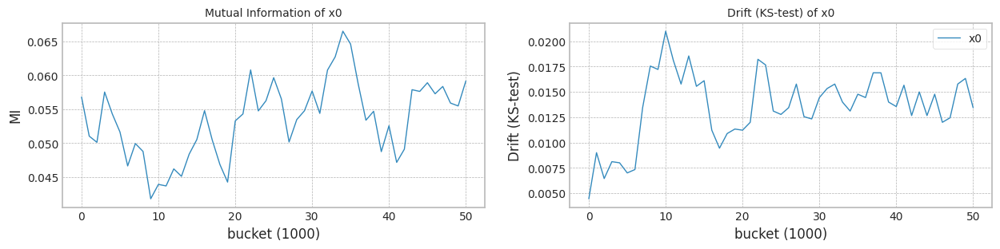

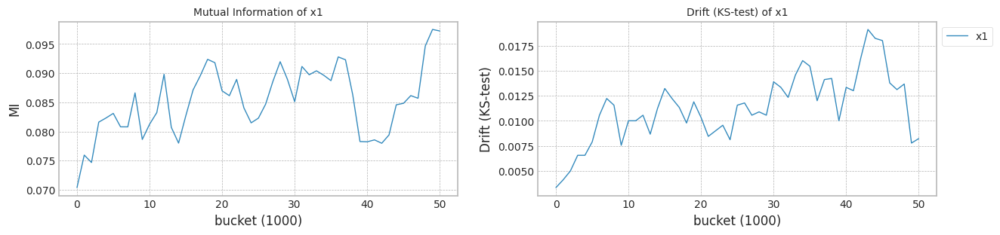

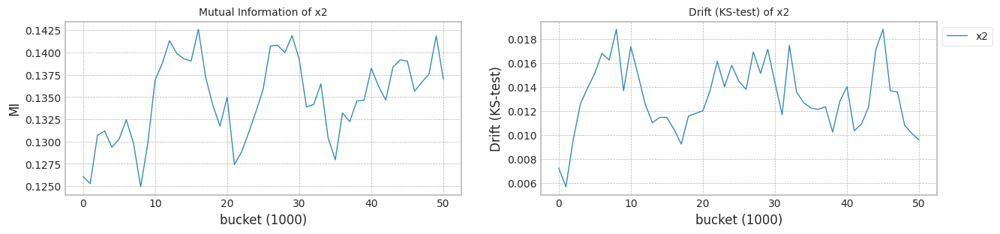

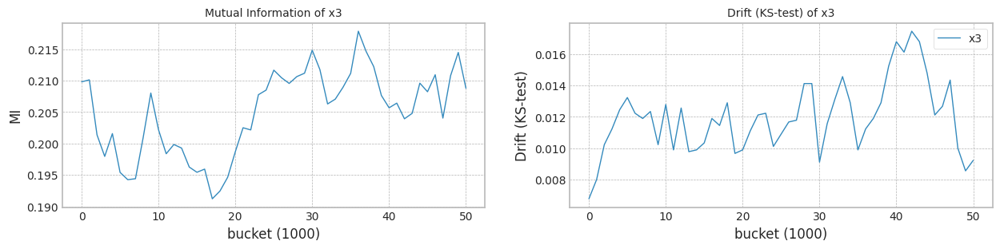

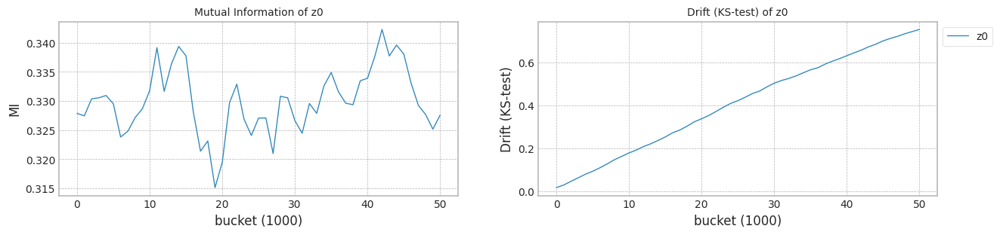

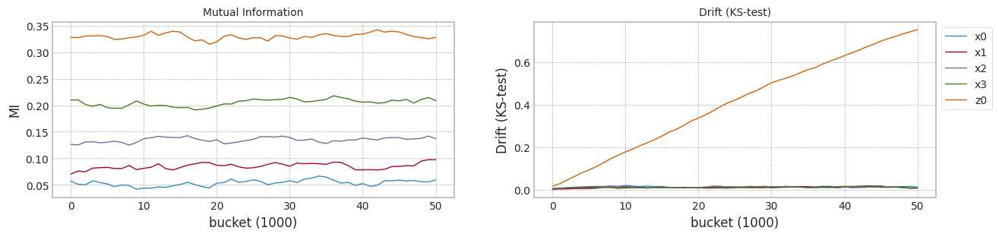

In [ ]:
columns=['x0','x1','x2','x3','z0']
X3 = pd.DataFrame(x3,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X3, y3,train_size, test_size)

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.484659,0.586652,0.404131,0.578093,0.608368,0
1,0.642800,0.615744,0.450917,0.526770,0.605447,0
2,0.665316,0.751975,0.535797,0.191399,0.508040,0
3,0.426377,0.459274,0.304506,0.622063,0.473654,0
4,0.634133,0.507616,0.463434,0.520247,0.636503,0
...,...,...,...,...,...,...
59995,0.428835,0.731754,0.362543,0.750707,1.025053,59
59996,0.388504,0.163578,0.250745,0.650929,0.719542,59
59997,0.623148,0.528739,0.508383,0.646257,1.084968,59
59998,0.427314,0.797644,0.544189,0.600597,0.794855,59


trial_count: 5
Lambda :  0.8
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:00:55,196] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 487.96it/s]

Early stop: 1186
[2023-11-29 21:00:57,635] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.24it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:01:07,416] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:01:07,418] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:10, 162.95it/s]

[2023-11-29 21:01:18,043] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:01:18,044] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]


mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 1 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:01:27,684] [INFO] [profiler.py:80:start_profile] Flops profiler started


 47%|████▋     | 949/2000 [00:01<00:02, 490.20it/s]

Early stop: 949
[2023-11-29 21:01:29,626] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 1 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:01:39,170] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:01:39,172] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:05<00:06, 164.99it/s]

[2023-11-29 21:01:50,700] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:01:50,701] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]

mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 1 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:02:00,436] [INFO] [profiler.py:80:start_profile] Flops profiler started



 69%|██████▉   | 1388/2000 [00:02<00:01, 485.73it/s]

Early stop: 1388
[2023-11-29 21:02:03,299] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 1 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:02:12,902] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:02:12,904] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:02<00:09, 165.00it/s]

[2023-11-29 21:02:23,907] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:02:23,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.30it/s]


mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 1 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:02:33,585] [INFO] [profiler.py:80:start_profile] Flops profiler started


 26%|██▌       | 516/2000 [00:01<00:03, 469.99it/s]

Early stop: 516
[2023-11-29 21:02:34,690] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 1 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:02:44,240] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:02:44,242] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:02<00:09, 160.52it/s]

[2023-11-29 21:02:55,281] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:02:55,282] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.29it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 1 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:03:04,977] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 483.89it/s]

Early stop: 548
[2023-11-29 21:03:06,115] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 1 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:03:15,672] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:03:15,675] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:10, 157.88it/s]

[2023-11-29 21:03:26,350] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:03:26,352] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.23it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.19it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:03:41,136] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:03:41,138] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:03:51,604] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:03:51,606] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.39s/it]

G-CDTL train flops: 3500000000 824250000 204885000 4529135000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [470]
Train flops  [4529135000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9163872281378767
G_CDTL+AUE median: 0.9163872281378767
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.03it/s]

Ensemble_SEA train flops: 458055000


100%|██████████| 51/51 [00:10<00:00,  4.65it/s]


Early stop at  [1052]
Train flops  [458055000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8642683654281395
SEA median: 0.8642683654281395
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:11,  2.02it/s]

Ensemble_SEA train flops: 464580000


100%|██████████| 51/51 [00:10<00:00,  4.64it/s]


Early stop at  [1067]
Train flops  [464580000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8825536722952462
AUE median: 0.8825536722952462
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:17,  1.42it/s]

Ensemble_DTEL train flops: 520260000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:11<00:00,  4.50it/s]


Early stop at  [1195, 13]
Train flops  [520260000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8981691749183477
DTEL median: 0.8981691749183477
######################### Retrain 1 Trial 1 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:05,  5.02it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:04:34,717] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:04:34,720] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:04:37,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:04:37,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:07<00:18,  1.33it/s]

G-CDTL train flops: 71750000 756000000 187920000 1015670000


100%|██████████| 51/51 [00:12<00:00,  4.14it/s]


Early stop at  [431]
Train flops  [1015670000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9122577980076138
G_CDTL+AUE median: 0.9143225130727453
######################### Retrain 1 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.51it/s]

Ensemble_SEA train flops: 672510000


100%|██████████| 51/51 [00:11<00:00,  4.32it/s]


Early stop at  [1545]
Train flops  [672510000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8658274264813188
SEA median: 0.8650478959547292
######################### Retrain 1 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:10,  2.24it/s]

Ensemble_SEA train flops: 364965000


100%|██████████| 51/51 [00:10<00:00,  4.67it/s]


Early stop at  [838]
Train flops  [364965000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8824282312577807
AUE median: 0.8824909517765134
######################### Retrain 1 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:15,  1.62it/s]

Ensemble_DTEL train flops: 452400000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:10<00:00,  4.69it/s]


Early stop at  [1039, 13]
Train flops  [452400000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8980126783978284
DTEL median: 0.8980909266580881
######################### Retrain 1 Trial 2 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.46it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:05:20,568] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:05:20,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:05:30,672] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:05:30,673] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:55,  2.31s/it]

G-CDTL train flops: 3500000000 710500000 176610000 4387110000


100%|██████████| 51/51 [00:19<00:00,  2.62it/s]


Early stop at  [405]
Train flops  [4387110000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.919057124116446
G_CDTL+AUE median: 0.9163872281378767
######################### Retrain 1 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:13,  1.83it/s]

Ensemble_SEA train flops: 506775000


100%|██████████| 51/51 [00:11<00:00,  4.57it/s]


Early stop at  [1164]
Train flops  [506775000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8646364565436395
SEA median: 0.8646364565436395
######################### Retrain 1 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.58it/s]

Ensemble_SEA train flops: 294930000


100%|██████████| 51/51 [00:10<00:00,  4.90it/s]


Early stop at  [677]
Train flops  [294930000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8827176129965382
AUE median: 0.8825536722952462
######################### Retrain 1 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:18,  1.34it/s]

Ensemble_DTEL train flops: 585510000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:11<00:00,  4.52it/s]


Early stop at  [1345, 13]
Train flops  [585510000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8993542614352628
DTEL median: 0.8981691749183477
######################### Retrain 1 Trial 3 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.43it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:06:13,120] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:06:13,122] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:06:23,601] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:06:23,602] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.39s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


100%|██████████| 51/51 [00:19<00:00,  2.56it/s]


Early stop at  [443]
Train flops  [4470140000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9206349312272155
G_CDTL+AUE median: 0.9177221761271613
######################### Retrain 1 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:05<00:09,  2.56it/s]

Ensemble_SEA train flops: 300150000


100%|██████████| 51/51 [00:10<00:00,  4.89it/s]


Early stop at  [689]
Train flops  [300150000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8645535648218546
SEA median: 0.8645950106827471
######################### Retrain 1 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:13,  1.81it/s]

Ensemble_SEA train flops: 522000000


100%|██████████| 51/51 [00:11<00:00,  4.55it/s]


Early stop at  [1199]
Train flops  [522000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8831430428506456
AUE median: 0.8826356426458921
######################### Retrain 1 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:07<00:25,  1.03s/it]

Ensemble_DTEL train flops: 839985000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:12<00:00,  4.18it/s]


Early stop at  [1930, 13]
Train flops  [839985000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8990689658544563
DTEL median: 0.898619070386402
######################### Retrain 1 Trial 4 for Normal model ###########################
retrain_interval: 26
######################### Retrain 1 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 49%|████▉     | 25/51 [00:04<00:04,  5.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:07:07,016] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:07:07,018] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:07:17,595] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:07:17,596] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:15<00:57,  2.41s/it]

G-CDTL train flops: 3500000000 820750000 204015000 4524765000


100%|██████████| 51/51 [00:20<00:00,  2.55it/s]


Early stop at  [468]
Train flops  [4524765000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9211586581310363
G_CDTL+AUE median: 0.919057124116446
######################### Retrain 1 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:06<00:13,  1.74it/s]

Ensemble_SEA train flops: 550275000


100%|██████████| 51/51 [00:11<00:00,  4.55it/s]


Early stop at  [1264]
Train flops  [550275000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8653006336241179
SEA median: 0.8646364565436395
######################### Retrain 1 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 53%|█████▎    | 27/51 [00:07<00:15,  1.50it/s]

Ensemble_SEA train flops: 696000000


100%|██████████| 51/51 [00:11<00:00,  4.33it/s]


Early stop at  [1599]
Train flops  [696000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8846252112680787
AUE median: 0.8827176129965382
######################### Retrain 1 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 51%|█████     | 26/51 [00:06<00:14,  1.74it/s]

Ensemble_DTEL train flops: 402375000
Ensemble_DTEL train flops: 6090000


100%|██████████| 51/51 [00:10<00:00,  4.75it/s]


Early stop at  [924, 13]
Train flops  [402375000, 6090000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8985515284313871
DTEL median: 0.8985515284313871


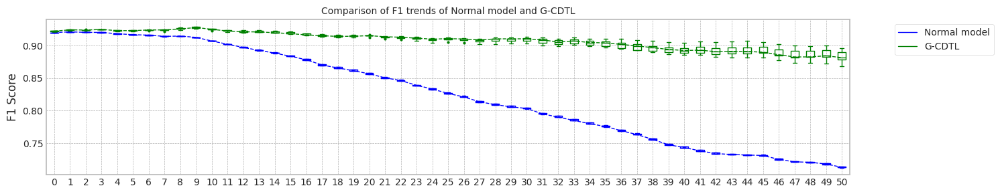

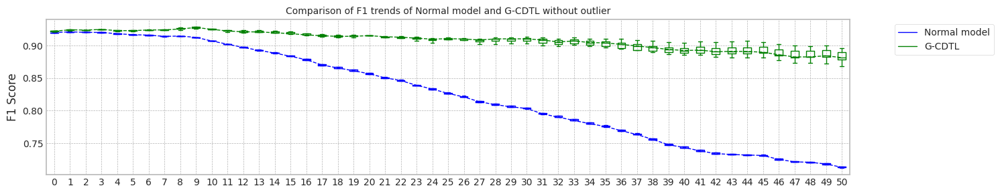

max_mean_trial= 3


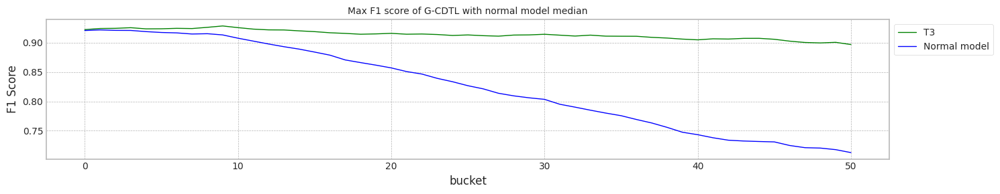

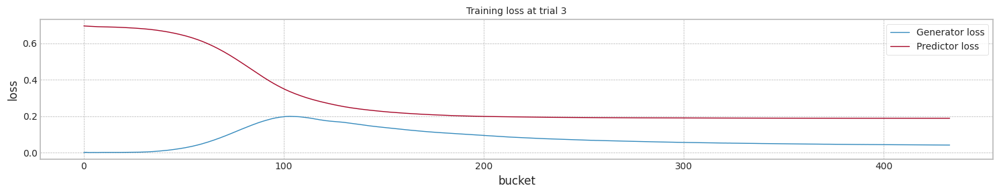

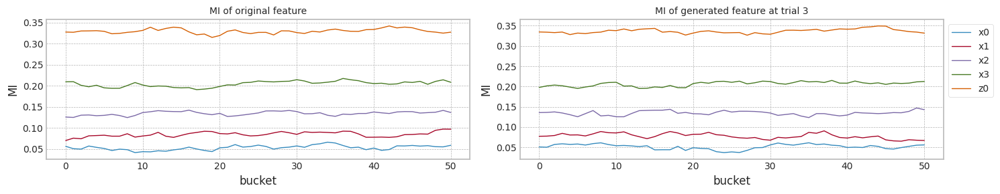

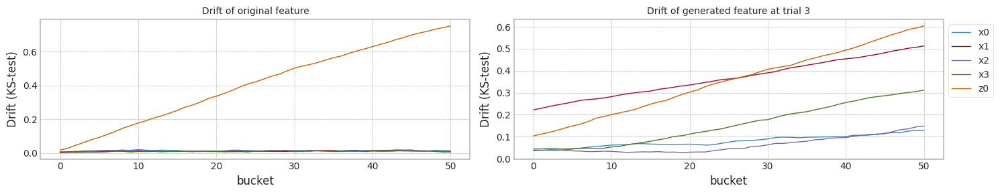

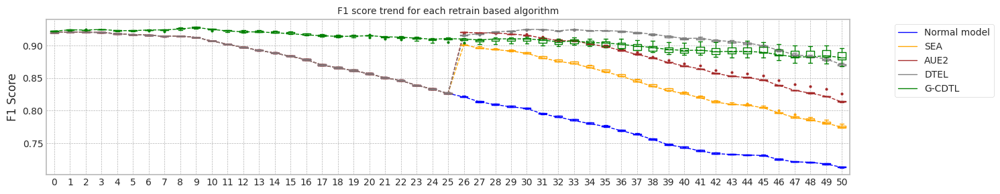

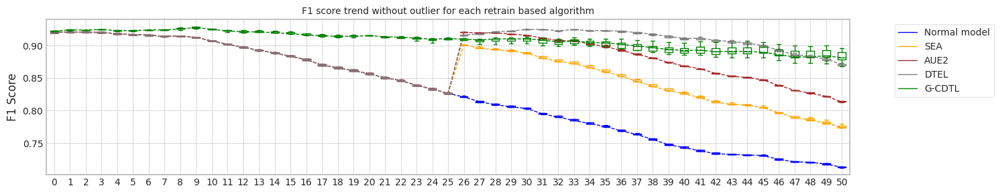

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.539766550064087
Base flops (inference flops of normal model, median): 199665000.0


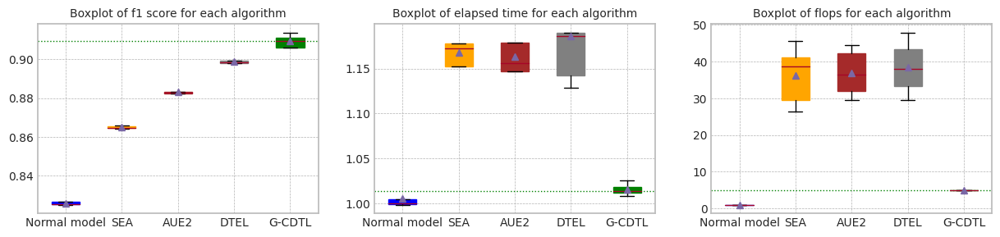

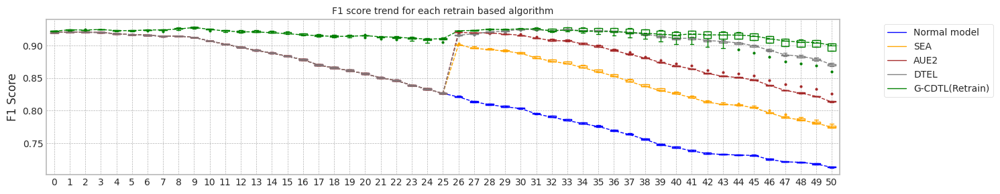

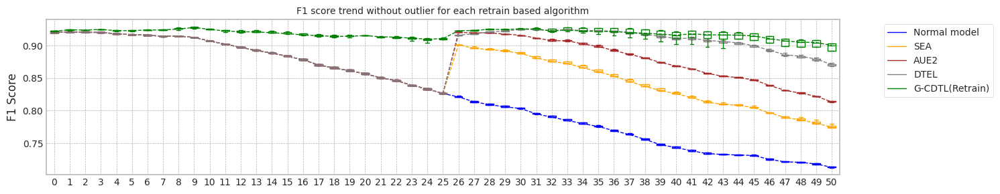

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.539766550064087
Base flops (train + inference flops of normal model, median): 3918915000.0


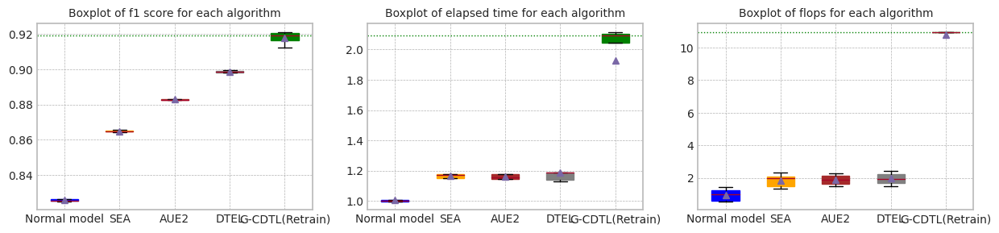

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.539766550064087


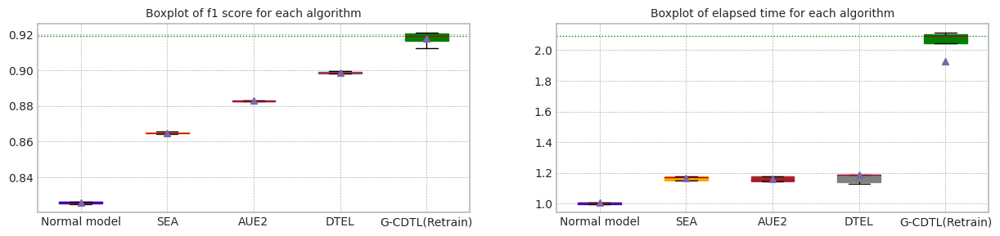

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.764874,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.526696,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.586094,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.533324,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.539767,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.539767,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.100423,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.620220,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.718130,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.657522,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.675470,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.786343,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.675470,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.063633,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.864268,0.773715,10.990540,2.607390e+09,5.606280e+09,8.213670e+09
1,1.0,0.920325,0.921341,0.865827,0.780328,11.846809,2.821845e+09,4.892880e+09,7.714725e+09
2,2.0,0.920255,0.921272,0.864636,0.774507,11.185618,2.656110e+09,6.445830e+09,9.101940e+09
3,3.0,0.920576,0.921592,0.864554,0.773913,10.461848,2.449485e+09,2.825325e+09,5.274810e+09
4,4.0,0.920325,0.921341,0.865301,0.776684,11.235107,2.699610e+09,3.200730e+09,5.900340e+09
5,median,0.920325,0.921341,0.864636,0.774507,11.185618,2.656110e+09,4.892880e+09,7.714725e+09
6,std,0.000125,0.000125,0.000634,0.002778,0.498210,1.360171e+08,1.550220e+09,1.604437e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.882554,0.813465,11.026553,2.613915e+09,5.812470e+09,8.426385e+09
1,1.0,0.920325,0.921341,0.882428,0.813538,10.943206,2.514300e+09,4.785000e+09,7.299300e+09
2,2.0,0.920255,0.921272,0.882718,0.813173,10.445036,2.444265e+09,6.433650e+09,8.877915e+09
3,3.0,0.920576,0.921592,0.883143,0.814495,11.243285,2.671335e+09,3.246840e+09,5.918175e+09
4,4.0,0.920325,0.921341,0.884625,0.825916,11.819377,2.845335e+09,3.546120e+09,6.391455e+09
5,median,0.920325,0.921341,0.882718,0.813538,11.026553,2.613915e+09,4.785000e+09,7.299300e+09
6,std,0.000125,0.000125,0.000898,0.005500,0.499222,1.544991e+08,1.384961e+09,1.270758e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.898169,0.869204,11.353147,2.675685e+09,5.976030e+09,8.651715e+09
1,1.0,0.920325,0.921341,0.898013,0.868784,10.899518,2.607825e+09,4.980315e+09,7.588140e+09
2,2.0,0.920255,0.921272,0.899354,0.873554,11.318870,2.740935e+09,6.832110e+09,9.573045e+09
3,3.0,0.920576,0.921592,0.899069,0.871199,12.240802,2.995410e+09,3.672705e+09,6.668115e+09
4,4.0,0.920325,0.921341,0.898552,0.871055,10.766709,2.557800e+09,3.360375e+09,5.918175e+09
5,median,0.920325,0.921341,0.898552,0.871055,11.318870,2.675685e+09,4.980315e+09,7.588140e+09
6,std,0.000125,0.000125,0.000574,0.001898,0.577024,1.710592e+08,1.479304e+09,1.471753e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.916387,0.892440,20.188006,4.271524e+10,223875000.0,4.293911e+10
1,1.0,0.922875,0.924630,0.912258,0.860170,12.332531,3.920177e+10,223875000.0,3.942564e+10
2,2.0,0.922514,0.924461,0.919057,0.900597,19.531640,4.257321e+10,223875000.0,4.279708e+10
3,3.0,0.921861,0.923788,0.920635,0.903680,19.966835,4.265624e+10,223875000.0,4.288012e+10
4,4.0,0.921318,0.923471,0.921159,0.903562,20.049735,4.271086e+10,223875000.0,4.293474e+10
5,median,0.922514,0.924461,0.919057,0.900597,19.966835,4.265624e+10,223875000.0,4.288012e+10
6,std,0.000668,0.000544,0.003659,0.018421,3.408350,1.549365e+09,0.0,1.549365e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 2 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:08:11,579] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 476.92it/s]

Early stop: 1186
[2023-11-29 21:08:14,072] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 2 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:08:23,570] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:08:23,573] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:10, 154.63it/s]

[2023-11-29 21:08:34,727] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:08:34,728] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]

mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 2 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:08:44,473] [INFO] [profiler.py:80:start_profile] Flops profiler started



 47%|████▋     | 949/2000 [00:02<00:02, 472.08it/s]

Early stop: 949
[2023-11-29 21:08:46,489] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 2 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:08:56,003] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:08:56,006] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:05<00:07, 154.60it/s]

[2023-11-29 21:09:08,367] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:09:08,368] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]

mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 2 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:09:18,015] [INFO] [profiler.py:80:start_profile] Flops profiler started



 69%|██████▉   | 1388/2000 [00:02<00:01, 470.56it/s]

Early stop: 1388
[2023-11-29 21:09:20,971] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.25it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 2 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:09:30,737] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:09:30,740] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:02<00:10, 151.39it/s]

[2023-11-29 21:09:42,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:09:42,267] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]


mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 2 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:09:51,802] [INFO] [profiler.py:80:start_profile] Flops profiler started


 26%|██▌       | 516/2000 [00:01<00:03, 477.83it/s]

Early stop: 516
[2023-11-29 21:09:52,887] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 2 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:10:02,453] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:10:02,455] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:02<00:10, 155.22it/s]

[2023-11-29 21:10:14,059] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:10:14,060] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 2 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:10:23,719] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 464.93it/s]

Early stop: 548
[2023-11-29 21:10:24,904] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.46it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 2 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:10:34,293] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:10:34,296] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:10, 152.50it/s]

[2023-11-29 21:10:45,320] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:10:45,321] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 2 Trial 0 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:10:58,321] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:10:58,323] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:11:09,437] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:11:09,438] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:14<01:20,  2.53s/it]

G-CDTL train flops: 3500000000 866250000 215325000 4581575000


 69%|██████▊   | 35/51 [00:17<00:03,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:11:12,838] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:11:12,840] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:11:23,340] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:11:23,342] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:28<00:33,  2.40s/it]

G-CDTL train flops: 3500000000 672000000 167040000 4339040000


100%|██████████| 51/51 [00:31<00:00,  1.64it/s]


Early stop at  [494, 383]
Train flops  [4581575000, 4339040000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9218912792557893
G_CDTL+AUE median: 0.9218912792557893
######################### Retrain 2 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:11,  2.90it/s]

Ensemble_SEA train flops: 226200000


 73%|███████▎  | 37/51 [00:09<00:07,  1.88it/s]

Ensemble_SEA train flops: 501555000


100%|██████████| 51/51 [00:11<00:00,  4.29it/s]


Early stop at  [519, 1152]
Train flops  [226200000, 501555000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8779880491081776
SEA median: 0.8779880491081776
######################### Retrain 2 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:19,  1.68it/s]

Ensemble_SEA train flops: 567240000


 73%|███████▎  | 37/51 [00:11<00:10,  1.35it/s]

Ensemble_SEA train flops: 796050000


100%|██████████| 51/51 [00:14<00:00,  3.61it/s]


Early stop at  [1303, 1829]
Train flops  [567240000, 796050000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8979229547050712
AUE median: 0.8979229547050712
######################### Retrain 2 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:25,  1.30it/s]

Ensemble_DTEL train flops: 550710000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:10<00:07,  1.89it/s]

Ensemble_DTEL train flops: 480240000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:13<00:00,  3.92it/s]


Early stop at  [1265, 10, 1103, 6]
Train flops  [550710000, 4785000, 480240000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9149785825116578
DTEL median: 0.9149785825116578
######################### Retrain 2 Trial 1 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:12:08,647] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:12:08,649] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:12:11,783] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:12:11,785] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:06<00:27,  1.18it/s]

G-CDTL train flops: 66500000 847000000 210540000 1124040000


 69%|██████▊   | 35/51 [00:09<00:03,  5.32it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:12:15,204] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:12:15,206] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:12:26,510] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:12:26,511] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:21<00:35,  2.56s/it]

G-CDTL train flops: 3500000000 805000000 200100000 4505100000


100%|██████████| 51/51 [00:24<00:00,  2.12it/s]


Early stop at  [483, 459]
Train flops  [1124040000, 4505100000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9223025523776238
G_CDTL+AUE median: 0.9220969158167065
######################### Retrain 2 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:15,  2.02it/s]

Ensemble_SEA train flops: 442395000


 73%|███████▎  | 37/51 [00:10<00:07,  1.79it/s]

Ensemble_SEA train flops: 513735000


100%|██████████| 51/51 [00:12<00:00,  4.00it/s]


Early stop at  [1016, 1180]
Train flops  [442395000, 513735000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8777036061327457
SEA median: 0.8778458276204617
######################### Retrain 2 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:19,  1.61it/s]

Ensemble_SEA train flops: 596385000


 73%|███████▎  | 37/51 [00:09<00:05,  2.60it/s]

Ensemble_SEA train flops: 269265000


100%|██████████| 51/51 [00:12<00:00,  4.07it/s]


Early stop at  [1370, 618]
Train flops  [596385000, 269265000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8979763550384183
AUE median: 0.8979496548717447
######################### Retrain 2 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:14,  2.29it/s]

Ensemble_DTEL train flops: 234900000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:10<00:10,  1.33it/s]

Ensemble_DTEL train flops: 778215000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:13<00:00,  3.91it/s]


Early stop at  [539, 10, 1788, 6]
Train flops  [234900000, 4785000, 778215000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9149507454460383
DTEL median: 0.914964663978848
######################### Retrain 2 Trial 2 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.33it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:13:11,090] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:13:11,092] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:13:22,752] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:13:22,754] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:15<02:01,  3.70s/it]

G-CDTL train flops: 3500000000 890750000 221415000 4612165000


 69%|██████▊   | 35/51 [00:18<00:03,  5.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:13:26,126] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:13:26,129] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:13:29,333] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:13:29,335] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:21<00:12,  1.16it/s]

G-CDTL train flops: 120750000 826000000 205320000 1152070000


100%|██████████| 51/51 [00:24<00:00,  2.09it/s]


Early stop at  [508, 471]
Train flops  [4612165000, 1152070000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9228836993010865
G_CDTL+AUE median: 0.9223025523776238
######################### Retrain 2 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:17,  1.88it/s]

Ensemble_SEA train flops: 344085000


 73%|███████▎  | 37/51 [00:09<00:07,  1.95it/s]

Ensemble_SEA train flops: 443700000


100%|██████████| 51/51 [00:12<00:00,  4.18it/s]


Early stop at  [790, 1019]
Train flops  [344085000, 443700000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8788868960668796
SEA median: 0.8779880491081776
######################### Retrain 2 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:18,  1.78it/s]

Ensemble_SEA train flops: 513735000


 73%|███████▎  | 37/51 [00:11<00:09,  1.40it/s]

Ensemble_SEA train flops: 720795000


100%|██████████| 51/51 [00:13<00:00,  3.68it/s]


Early stop at  [1180, 1656]
Train flops  [513735000, 720795000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8978003642902409
AUE median: 0.8979229547050712
######################### Retrain 2 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:20,  1.61it/s]

Ensemble_DTEL train flops: 409335000
Ensemble_DTEL train flops: 4785000


 71%|███████   | 36/51 [00:09<00:07,  1.90it/s]

Ensemble_DTEL train flops: 294060000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:12<00:00,  4.24it/s]


Early stop at  [940, 10, 675, 6]
Train flops  [409335000, 4785000, 294060000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9153415130811502
DTEL median: 0.9149785825116578
######################### Retrain 2 Trial 3 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.49it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:14:13,689] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:14:13,692] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:14:25,657] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:14:25,658] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:15<01:26,  2.71s/it]

G-CDTL train flops: 3500000000 957250000 237945000 4695195000


 69%|██████▊   | 35/51 [00:18<00:03,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:14:29,042] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:14:29,044] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:14:40,053] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:14:40,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:29<00:35,  2.51s/it]

G-CDTL train flops: 3500000000 670250000 166605000 4336855000


100%|██████████| 51/51 [00:32<00:00,  1.57it/s]


Early stop at  [546, 382]
Train flops  [4695195000, 4336855000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9224778172473296
G_CDTL+AUE median: 0.9223901848124767
######################### Retrain 2 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:21,  1.47it/s]

Ensemble_SEA train flops: 671205000


 73%|███████▎  | 37/51 [00:10<00:06,  2.18it/s]

Ensemble_SEA train flops: 374100000


100%|██████████| 51/51 [00:13<00:00,  3.89it/s]


Early stop at  [1542, 859]
Train flops  [671205000, 374100000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.879250993344658
SEA median: 0.8784374725875286
######################### Retrain 2 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:04<00:18,  1.79it/s]

Ensemble_SEA train flops: 357135000


 73%|███████▎  | 37/51 [00:09<00:05,  2.59it/s]

Ensemble_SEA train flops: 269700000


100%|██████████| 51/51 [00:11<00:00,  4.34it/s]


Early stop at  [820, 619]
Train flops  [357135000, 269700000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8974687957652426
AUE median: 0.8978616594976561
######################### Retrain 2 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:23,  1.42it/s]

Ensemble_DTEL train flops: 487200000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:11<00:10,  1.29it/s]

Ensemble_DTEL train flops: 816495000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:14<00:00,  3.64it/s]


Early stop at  [1119, 10, 1876, 6]
Train flops  [487200000, 4785000, 816495000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9152208528441199
DTEL median: 0.9150997176778888
######################### Retrain 2 Trial 4 for Normal model ###########################
retrain_interval: 18
######################### Retrain 2 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 33%|███▎      | 17/51 [00:03<00:06,  5.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:15:25,199] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:15:25,201] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:15:28,459] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:15:28,460] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:06<00:28,  1.14it/s]

G-CDTL train flops: 71750000 857500000 213150000 1142400000


 69%|██████▊   | 35/51 [00:09<00:03,  5.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:15:31,816] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:15:31,818] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:15:43,268] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:15:43,269] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:21<00:36,  2.59s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


100%|██████████| 51/51 [00:24<00:00,  2.10it/s]


Early stop at  [489, 438]
Train flops  [1142400000, 4459215000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9228516597163773
G_CDTL+AUE median: 0.9224778172473296
######################### Retrain 2 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:04<00:12,  2.52it/s]

Ensemble_SEA train flops: 286230000


 73%|███████▎  | 37/51 [00:09<00:05,  2.45it/s]

Ensemble_SEA train flops: 309720000


100%|██████████| 51/51 [00:11<00:00,  4.40it/s]


Early stop at  [657, 711]
Train flops  [286230000, 309720000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8777298154765003
SEA median: 0.8779880491081776
######################### Retrain 2 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 37%|███▋      | 19/51 [00:05<00:18,  1.75it/s]

Ensemble_SEA train flops: 524175000


 73%|███████▎  | 37/51 [00:10<00:07,  1.91it/s]

Ensemble_SEA train flops: 469800000


100%|██████████| 51/51 [00:12<00:00,  3.95it/s]


Early stop at  [1204, 1079]
Train flops  [524175000, 469800000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8961981917311155
AUE median: 0.8978003642902409
######################### Retrain 2 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 35%|███▌      | 18/51 [00:05<00:22,  1.46it/s]

Ensemble_DTEL train flops: 479370000
Ensemble_DTEL train flops: 4785000


 73%|███████▎  | 37/51 [00:10<00:09,  1.54it/s]

Ensemble_DTEL train flops: 623790000
Ensemble_DTEL train flops: 3045000


100%|██████████| 51/51 [00:13<00:00,  3.82it/s]


Early stop at  [1101, 10, 1433, 6]
Train flops  [479370000, 4785000, 623790000, 3045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9148676677083595
DTEL median: 0.9149785825116578


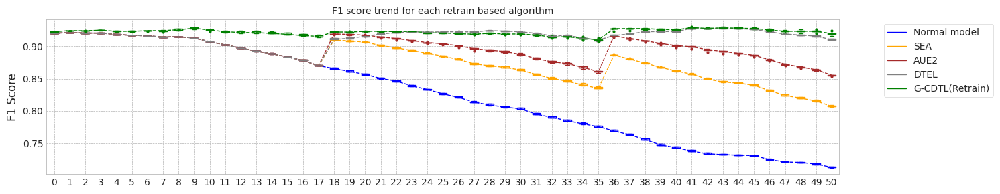

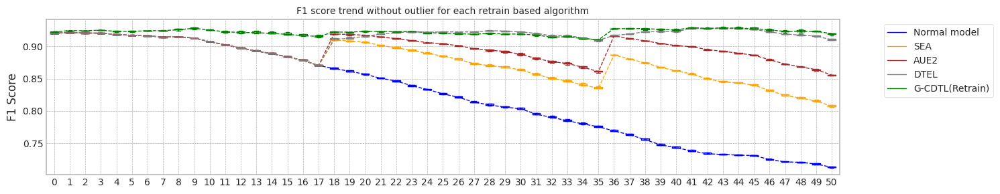

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.497466325759888
Base flops (train + inference flops of normal model, median): 3918915000.0


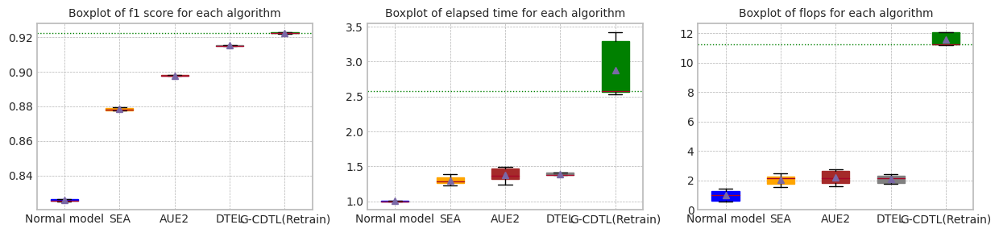

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.497466325759888


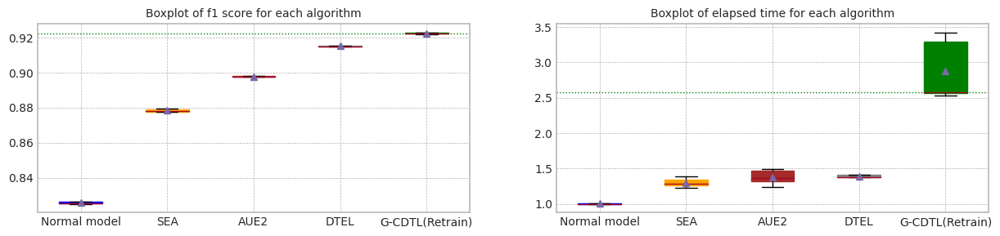

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.483463,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.497466,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.746964,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.550357,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.373329,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.497466,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.137165,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.727109,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.630846,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.516608,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.642629,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.570798,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.630846,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.079347,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.877988,0.807233,11.914931,2.877090e+09,5.966025e+09,8.843115e+09
1,1.0,0.920325,0.921341,0.877704,0.806515,12.776207,3.105465e+09,5.266545e+09,8.372010e+09
2,2.0,0.920255,0.921272,0.878887,0.808780,12.234758,2.937120e+09,6.816885e+09,9.754005e+09
3,3.0,0.920576,0.921592,0.879251,0.809358,13.126746,3.194640e+09,3.660525e+09,6.855165e+09
4,4.0,0.920325,0.921341,0.877730,0.807089,11.630596,2.745285e+09,3.336450e+09,6.081735e+09
5,median,0.920325,0.921341,0.877988,0.807233,12.234758,2.937120e+09,5.266545e+09,8.372010e+09
6,std,0.000125,0.000125,0.000712,0.001211,0.613230,1.795868e+08,1.488832e+09,1.492849e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.897923,0.856329,14.175905,3.512625e+09,6.801225e+09,1.031385e+10
1,1.0,0.920325,0.921341,0.897976,0.855625,12.547087,3.014985e+09,5.375730e+09,8.390715e+09
2,2.0,0.920255,0.921272,0.897800,0.855950,13.884151,3.383865e+09,7.463295e+09,1.084716e+10
3,3.0,0.920576,0.921592,0.897469,0.855273,11.775290,2.776170e+09,3.441720e+09,6.217890e+09
4,4.0,0.920325,0.921341,0.896198,0.854192,12.953816,3.143310e+09,3.934140e+09,7.077450e+09
5,median,0.920325,0.921341,0.897800,0.855625,12.953816,3.143310e+09,5.375730e+09,8.390715e+09
6,std,0.000125,0.000125,0.000740,0.000816,0.980948,2.927890e+08,1.746766e+09,2.001171e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.914979,0.909939,13.054204,3.188115e+09,5.937750e+09,9.125865e+09
1,1.0,0.920325,0.921341,0.914951,0.910070,13.076864,3.170280e+09,5.307870e+09,8.478150e+09
2,2.0,0.920255,0.921272,0.915342,0.912193,12.072598,2.860560e+09,6.542400e+09,9.402960e+09
3,3.0,0.920576,0.921592,0.915221,0.911358,14.040539,3.460860e+09,3.650955e+09,7.111815e+09
4,4.0,0.920325,0.921341,0.914868,0.910336,13.386837,3.260325e+09,3.583530e+09,6.843855e+09
5,median,0.920325,0.921341,0.914979,0.910336,13.076864,3.188115e+09,5.307870e+09,8.478150e+09
6,std,0.000125,0.000125,0.000200,0.000967,0.710922,2.163414e+08,1.339717e+09,1.162401e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.921891,0.916440,31.201179,4.710672e+10,134325000.0,4.724104e+10
1,1.0,0.922875,0.924630,0.922303,0.919793,24.030125,4.381524e+10,134325000.0,4.394956e+10
2,2.0,0.922514,0.924461,0.922884,0.923906,24.459652,4.395034e+10,134325000.0,4.408466e+10
3,3.0,0.921861,0.923788,0.922478,0.918606,32.495048,4.721815e+10,134325000.0,4.735248e+10
4,4.0,0.921318,0.923471,0.922852,0.920208,24.309922,4.378772e+10,134325000.0,4.392204e+10
5,median,0.922514,0.924461,0.922478,0.919793,24.459652,4.395034e+10,134325000.0,4.408466e+10
6,std,0.000668,0.000544,0.000412,0.002727,4.180548,1.815165e+09,0.0,1.815165e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 3 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:16:29,822] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 449.99it/s]

Early stop: 1186
[2023-11-29 21:16:32,465] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.37it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 3 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:16:42,015] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:16:42,017] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:11, 142.82it/s]

[2023-11-29 21:16:53,874] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:16:53,877] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.26it/s]


mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 3 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:17:03,618] [INFO] [profiler.py:80:start_profile] Flops profiler started


 47%|████▋     | 949/2000 [00:02<00:02, 437.94it/s]

Early stop: 949
[2023-11-29 21:17:05,790] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 3 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:17:15,372] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:17:15,374] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:06<00:07, 144.75it/s]

[2023-11-29 21:17:28,438] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:17:28,439] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.32it/s]

mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 3 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:17:38,069] [INFO] [profiler.py:80:start_profile] Flops profiler started



 69%|██████▉   | 1388/2000 [00:03<00:01, 447.63it/s]

Early stop: 1388
[2023-11-29 21:17:41,176] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.38it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 3 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:17:50,697] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:17:50,699] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:02<00:10, 144.46it/s]

[2023-11-29 21:18:03,044] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:18:03,045] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.30it/s]

mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 3 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:18:12,722] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 516/2000 [00:01<00:03, 439.97it/s]

Early stop: 516
[2023-11-29 21:18:13,902] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.36it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 3 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:18:23,469] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:18:23,471] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:03<00:10, 143.95it/s]

[2023-11-29 21:18:35,946] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:18:35,948] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 3 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:18:45,611] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 446.58it/s]

Early stop: 548
[2023-11-29 21:18:46,844] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.33it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 3 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:18:56,473] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:18:56,475] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:11, 143.43it/s]

[2023-11-29 21:19:08,366] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:19:08,367] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.31it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 3 Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.15it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:19:20,544] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:19:20,546] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:19:31,988] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:19:31,990] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:14<01:36,  2.61s/it]

G-CDTL train flops: 3500000000 714000000 177480000 4391480000


 49%|████▉     | 25/51 [00:16<00:06,  4.25it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:19:34,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:19:34,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:19:46,061] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:19:46,062] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 51%|█████     | 26/51 [00:28<01:32,  3.71s/it]

G-CDTL train flops: 3500000000 752500000 187050000 4439550000


 75%|███████▍  | 38/51 [00:30<00:03,  4.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:19:48,553] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:19:48,555] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:20:00,439] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:20:00,440] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:42<00:29,  2.71s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


100%|██████████| 51/51 [00:44<00:00,  1.14it/s]


Early stop at  [407, 429, 443]
Train flops  [4391480000, 4439550000, 4470140000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9240617170441618
G_CDTL+AUE median: 0.9240617170441618
######################### Retrain 3 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.65it/s]

Ensemble_SEA train flops: 552015000


 53%|█████▎    | 27/51 [00:10<00:19,  1.20it/s]

Ensemble_SEA train flops: 852600000


 78%|███████▊  | 40/51 [00:14<00:05,  1.89it/s]

Ensemble_SEA train flops: 452835000


100%|██████████| 51/51 [00:16<00:00,  3.17it/s]


Early stop at  [1268, 1959, 1040]
Train flops  [552015000, 852600000, 452835000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8848162930002603
SEA median: 0.8848162930002603
######################### Retrain 3 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:21,  1.76it/s]

Ensemble_SEA train flops: 504165000


 53%|█████▎    | 27/51 [00:08<00:14,  1.62it/s]

Ensemble_SEA train flops: 561150000


 78%|███████▊  | 40/51 [00:14<00:08,  1.22it/s]

Ensemble_SEA train flops: 855645000


100%|██████████| 51/51 [00:16<00:00,  3.12it/s]


Early stop at  [1158, 1289, 1966]
Train flops  [504165000, 561150000, 855645000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9039040782959006
AUE median: 0.9039040782959006
######################### Retrain 3 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:24,  1.57it/s]

Ensemble_DTEL train flops: 391500000
Ensemble_DTEL train flops: 3915000


 51%|█████     | 26/51 [00:07<00:12,  1.98it/s]

Ensemble_DTEL train flops: 294930000
Ensemble_DTEL train flops: 2610000


 78%|███████▊  | 40/51 [00:12<00:07,  1.56it/s]

Ensemble_DTEL train flops: 608130000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:14<00:00,  3.60it/s]


Early stop at  [899, 8, 677, 5, 1397, 4]
Train flops  [391500000, 3915000, 294930000, 2610000, 608130000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202419139373585
DTEL median: 0.9202419139373585
######################### Retrain 3 Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:20:51,995] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:20:51,997] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:21:04,001] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:21:04,003] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:14<01:41,  2.73s/it]

G-CDTL train flops: 3500000000 796250000 197925000 4494175000


 49%|████▉     | 25/51 [00:16<00:06,  4.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:21:06,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:21:06,446] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:21:18,201] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:21:18,202] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:28<01:04,  2.68s/it]

G-CDTL train flops: 3500000000 729750000 181395000 4411145000


 75%|███████▍  | 38/51 [00:30<00:03,  4.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:21:20,602] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:21:20,605] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:21:32,753] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:21:32,754] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:43<00:30,  2.76s/it]

G-CDTL train flops: 3500000000 799750000 198795000 4498545000


100%|██████████| 51/51 [00:45<00:00,  1.12it/s]


Early stop at  [454, 416, 456]
Train flops  [4494175000, 4411145000, 4498545000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9241313731784774
G_CDTL+AUE median: 0.9240965451113197
######################### Retrain 3 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:28,  1.29it/s]

Ensemble_SEA train flops: 783000000


 53%|█████▎    | 27/51 [00:08<00:09,  2.65it/s]

Ensemble_SEA train flops: 244905000


 78%|███████▊  | 40/51 [00:12<00:05,  2.03it/s]

Ensemble_SEA train flops: 416295000


100%|██████████| 51/51 [00:14<00:00,  3.49it/s]


Early stop at  [1799, 562, 956]
Train flops  [783000000, 244905000, 416295000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8843431958705802
SEA median: 0.8845797444354202
######################### Retrain 3 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:24,  1.58it/s]

Ensemble_SEA train flops: 398460000


 53%|█████▎    | 27/51 [00:07<00:10,  2.35it/s]

Ensemble_SEA train flops: 312330000


 78%|███████▊  | 40/51 [00:11<00:05,  2.10it/s]

Ensemble_SEA train flops: 394980000


100%|██████████| 51/51 [00:13<00:00,  3.77it/s]


Early stop at  [915, 717, 907]
Train flops  [398460000, 312330000, 394980000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9039869639210588
AUE median: 0.9039455211084797
######################### Retrain 3 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.67it/s]

Ensemble_DTEL train flops: 538530000
Ensemble_DTEL train flops: 3915000


 53%|█████▎    | 27/51 [00:07<00:08,  2.90it/s]

Ensemble_DTEL train flops: 211845000
Ensemble_DTEL train flops: 2610000


 78%|███████▊  | 40/51 [00:11<00:04,  2.44it/s]

Ensemble_DTEL train flops: 291015000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:13<00:00,  3.87it/s]


Early stop at  [1237, 8, 486, 5, 668, 4]
Train flops  [538530000, 3915000, 211845000, 2610000, 291015000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202547558811071
DTEL median: 0.9202483349092327
######################### Retrain 3 Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:22:18,913] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:22:18,915] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:22:31,940] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:22:31,942] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:15<02:37,  4.14s/it]

G-CDTL train flops: 3500000000 981750000 244035000 4725785000


 49%|████▉     | 25/51 [00:17<00:06,  4.13it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:22:34,429] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:22:34,431] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:22:46,364] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:22:46,365] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:30<01:05,  2.72s/it]

G-CDTL train flops: 3500000000 719250000 178785000 4398035000


 75%|███████▍  | 38/51 [00:32<00:03,  4.28it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:22:48,791] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:22:48,792] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:22:56,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:22:56,661] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:40<00:20,  1.86s/it]

G-CDTL train flops: 70000000 2026500000 503730000 2600230000


100%|██████████| 51/51 [00:42<00:00,  1.20it/s]


Early stop at  [560, 410, 1157]
Train flops  [4725785000, 4398035000, 2600230000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9245667001335748
G_CDTL+AUE median: 0.9241313731784774
######################### Retrain 3 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:18,  2.03it/s]

Ensemble_SEA train flops: 393675000


 53%|█████▎    | 27/51 [00:07<00:09,  2.43it/s]

Ensemble_SEA train flops: 298845000


 78%|███████▊  | 40/51 [00:10<00:03,  2.83it/s]

Ensemble_SEA train flops: 211845000


100%|██████████| 51/51 [00:12<00:00,  4.00it/s]


Early stop at  [904, 686, 486]
Train flops  [393675000, 298845000, 211845000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8850790003020678
SEA median: 0.8848162930002603
######################### Retrain 3 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:31,  1.17it/s]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:08<00:08,  2.88it/s]

Ensemble_SEA train flops: 195750000


 78%|███████▊  | 40/51 [00:12<00:05,  1.96it/s]

Ensemble_SEA train flops: 403680000


100%|██████████| 51/51 [00:14<00:00,  3.43it/s]


Early stop at  [1999, 449, 927]
Train flops  [870000000, 195750000, 403680000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.904389898128727
AUE median: 0.9039869639210588
######################### Retrain 3 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:19,  1.98it/s]

Ensemble_DTEL train flops: 291015000
Ensemble_DTEL train flops: 3915000


 51%|█████     | 26/51 [00:07<00:18,  1.37it/s]

Ensemble_DTEL train flops: 494160000
Ensemble_DTEL train flops: 2175000


 78%|███████▊  | 40/51 [00:11<00:04,  2.39it/s]

Ensemble_DTEL train flops: 291450000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:13<00:00,  3.80it/s]


Early stop at  [668, 8, 1135, 4, 669, 4]
Train flops  [291015000, 3915000, 494160000, 2175000, 291450000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9196944854978755
DTEL median: 0.9202419139373585
######################### Retrain 3 Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:23:42,571] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:23:42,574] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:23:55,035] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:23:55,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 27%|██▋       | 14/51 [00:15<01:44,  2.82s/it]

G-CDTL train flops: 3500000000 792750000 197055000 4489805000


 49%|████▉     | 25/51 [00:17<00:06,  4.27it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:23:57,438] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:23:57,440] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:24:09,292] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:24:09,294] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:29<01:04,  2.70s/it]

G-CDTL train flops: 3500000000 619500000 153990000 4273490000


 75%|███████▍  | 38/51 [00:31<00:03,  4.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:24:11,739] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:24:11,741] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:24:24,496] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:24:24,497] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:44<00:31,  2.89s/it]

G-CDTL train flops: 3500000000 862750000 214455000 4577205000


100%|██████████| 51/51 [00:46<00:00,  1.09it/s]


Early stop at  [452, 353, 492]
Train flops  [4489805000, 4273490000, 4577205000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9234773905676196
G_CDTL+AUE median: 0.9240965451113197
######################### Retrain 3 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:04<00:22,  1.66it/s]

Ensemble_SEA train flops: 545055000


 53%|█████▎    | 27/51 [00:08<00:10,  2.35it/s]

Ensemble_SEA train flops: 311895000


 78%|███████▊  | 40/51 [00:12<00:06,  1.76it/s]

Ensemble_SEA train flops: 489375000


100%|██████████| 51/51 [00:14<00:00,  3.56it/s]


Early stop at  [1252, 716, 1124]
Train flops  [545055000, 311895000, 489375000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8849191758401946
SEA median: 0.8848677344202275
######################### Retrain 3 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:29,  1.27it/s]

Ensemble_SEA train flops: 782565000


 53%|█████▎    | 27/51 [00:10<00:15,  1.51it/s]

Ensemble_SEA train flops: 596820000


 78%|███████▊  | 40/51 [00:14<00:07,  1.53it/s]

Ensemble_SEA train flops: 590730000


100%|██████████| 51/51 [00:16<00:00,  3.04it/s]


Early stop at  [1798, 1371, 1357]
Train flops  [782565000, 596820000, 590730000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9041270860231387
AUE median: 0.9040570249720987
######################### Retrain 3 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:21,  1.77it/s]

Ensemble_DTEL train flops: 332775000
Ensemble_DTEL train flops: 3915000


 53%|█████▎    | 27/51 [00:07<00:09,  2.48it/s]

Ensemble_DTEL train flops: 283620000
Ensemble_DTEL train flops: 2175000


 78%|███████▊  | 40/51 [00:10<00:04,  2.68it/s]

Ensemble_DTEL train flops: 247515000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:12<00:00,  4.02it/s]


Early stop at  [764, 8, 651, 4, 568, 4]
Train flops  [332775000, 3915000, 283620000, 2175000, 247515000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202152007921115
DTEL median: 0.9202285573647351
######################### Retrain 3 Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Retrain 3 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:02<00:07,  5.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:25:13,151] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:25:13,153] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:25:25,846] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:25:25,848] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 25%|██▌       | 13/51 [00:15<02:33,  4.04s/it]

G-CDTL train flops: 3500000000 810250000 201405000 4511655000


 49%|████▉     | 25/51 [00:17<00:06,  4.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:25:28,396] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:25:28,398] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:25:38,306] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:25:38,307] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:27<00:55,  2.30s/it]

G-CDTL train flops: 3500000000 120750000 30015000 3650765000


 75%|███████▍  | 38/51 [00:29<00:02,  4.40it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:25:40,735] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:25:40,738] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:25:48,141] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:25:48,142] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 78%|███████▊  | 40/51 [00:37<00:19,  1.76s/it]

G-CDTL train flops: 80500000 1858500000 461970000 2400970000


100%|██████████| 51/51 [00:39<00:00,  1.29it/s]


Early stop at  [462, 68, 1061]
Train flops  [4511655000, 3650765000, 2400970000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.6886941079086526
G_CDTL+AUE median: 0.9240617170441618
######################### Retrain 3 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 27%|██▋       | 14/51 [00:05<00:30,  1.23it/s]

Ensemble_SEA train flops: 798225000


 53%|█████▎    | 27/51 [00:09<00:12,  1.87it/s]

Ensemble_SEA train flops: 438045000


 78%|███████▊  | 40/51 [00:13<00:05,  2.06it/s]

Ensemble_SEA train flops: 373665000


100%|██████████| 51/51 [00:15<00:00,  3.28it/s]


Early stop at  [1834, 1006, 858]
Train flops  [798225000, 438045000, 373665000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8850432136699004
SEA median: 0.8849191758401946
######################### Retrain 3 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:03<00:19,  1.90it/s]

Ensemble_SEA train flops: 303195000


 53%|█████▎    | 27/51 [00:06<00:04,  4.84it/s]

Ensemble_SEA train flops: 24795000


 78%|███████▊  | 40/51 [00:11<00:09,  1.16it/s]

Ensemble_SEA train flops: 870000000


100%|██████████| 51/51 [00:13<00:00,  3.66it/s]


Early stop at  [696, 56, 1999]
Train flops  [303195000, 24795000, 870000000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8923835883844882
AUE median: 0.9039869639210588
######################### Retrain 3 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 25%|██▌       | 13/51 [00:04<00:33,  1.13it/s]

Ensemble_DTEL train flops: 632925000
Ensemble_DTEL train flops: 3915000


 53%|█████▎    | 27/51 [00:10<00:20,  1.15it/s]

Ensemble_DTEL train flops: 870000000
Ensemble_DTEL train flops: 2175000


 78%|███████▊  | 40/51 [00:14<00:06,  1.79it/s]

Ensemble_DTEL train flops: 471540000
Ensemble_DTEL train flops: 2175000


100%|██████████| 51/51 [00:16<00:00,  3.04it/s]


Early stop at  [1454, 8, 1999, 4, 1083, 4]
Train flops  [632925000, 3915000, 870000000, 2175000, 471540000, 2175000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.919871331754279
DTEL median: 0.9202152007921115


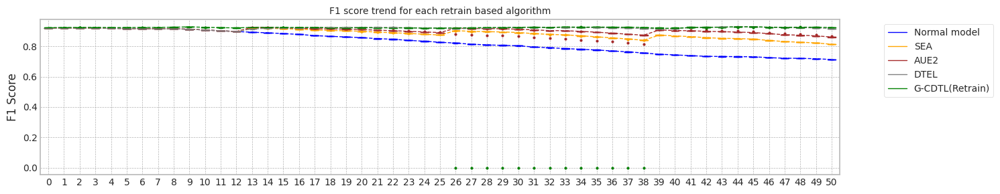

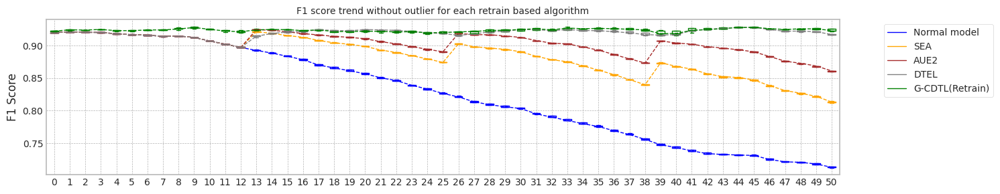

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.551180124282837
Base flops (train + inference flops of normal model, median): 3918915000.0


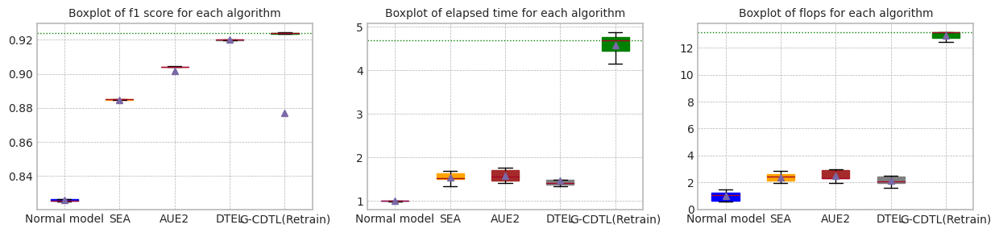

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.551180124282837


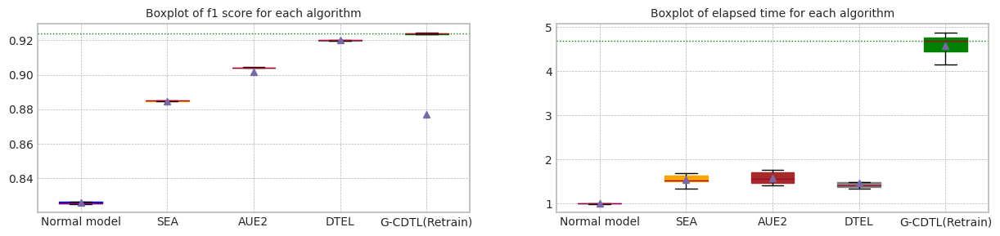

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.533465,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.564592,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.501892,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.551180,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.611638,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.551180,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.040524,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.722657,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.613546,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.660756,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.642739,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.637649,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.642739,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.041168,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.884816,0.813431,16.144046,4.006785e+09,7.201425e+09,1.120821e+10
1,1.0,0.920325,0.921341,0.884343,0.812153,14.642367,3.593535e+09,5.860320e+09,9.453855e+09
2,2.0,0.920255,0.921272,0.885079,0.813358,12.784400,3.053700e+09,7.039170e+09,1.009287e+10
3,3.0,0.920576,0.921592,0.884919,0.812735,14.367510,3.495660e+09,4.067250e+09,7.562910e+09
4,4.0,0.920325,0.921341,0.885043,0.814455,15.580993,3.759270e+09,4.456140e+09,8.215410e+09
5,median,0.920325,0.921341,0.884919,0.813358,14.642367,3.593535e+09,5.860320e+09,9.453855e+09
6,std,0.000125,0.000125,0.000297,0.000861,1.288869,3.530422e+08,1.439038e+09,1.456638e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.903904,0.861294,16.361650,4.070295e+09,7.464600e+09,1.153490e+10
1,1.0,0.920325,0.921341,0.903987,0.859815,13.562370,3.255105e+09,5.721555e+09,8.976660e+09
2,2.0,0.920255,0.921272,0.904390,0.861212,14.917093,3.618765e+09,7.803900e+09,1.142266e+10
3,3.0,0.920576,0.921592,0.904127,0.860061,16.816771,4.119450e+09,4.890705e+09,9.010155e+09
4,4.0,0.920325,0.921341,0.892384,0.867979,13.960854,3.347325e+09,4.243860e+09,7.591185e+09
5,median,0.920325,0.921341,0.903987,0.861212,14.917093,3.618765e+09,5.721555e+09,9.010155e+09
6,std,0.000125,0.000125,0.005244,0.003368,1.434543,4.001189e+08,1.564297e+09,1.716127e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.920242,0.917712,14.181180,3.452595e+09,6.066510e+09,9.519105e+09
1,1.0,0.920325,0.921341,0.920255,0.917729,13.217875,3.199425e+09,4.821540e+09,8.020965e+09
2,2.0,0.920255,0.921272,0.919694,0.916737,13.442220,3.234225e+09,6.540225e+09,9.774450e+09
3,3.0,0.920576,0.921592,0.920215,0.917315,12.725795,3.021510e+09,3.082410e+09,6.103920e+09
4,4.0,0.920325,0.921341,0.919871,0.916562,16.782822,4.132065e+09,3.431715e+09,7.563780e+09
5,median,0.920325,0.921341,0.920215,0.917315,13.442220,3.234225e+09,4.821540e+09,8.020965e+09
6,std,0.000125,0.000125,0.000257,0.000542,1.604593,4.328206e+08,1.537413e+09,1.504098e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.924062,0.922304,44.752592,5.148727e+10,107460000.0,5.159473e+10
1,1.0,0.922875,0.924630,0.924131,0.925670,45.532510,5.158996e+10,107460000.0,5.169742e+10
2,2.0,0.922514,0.924461,0.924567,0.923523,42.526946,4.991015e+10,107460000.0,5.001761e+10
3,3.0,0.921861,0.923788,0.923477,0.925885,46.656879,5.152660e+10,107460000.0,5.163406e+10
4,4.0,0.921318,0.923471,0.688694,0.923341,39.699842,4.874949e+10,107460000.0,4.885695e+10
5,median,0.922514,0.924461,0.924062,0.923523,44.752592,5.148727e+10,107460000.0,5.159473e+10
6,std,0.000668,0.000544,0.105259,0.001563,2.761206,1.275957e+09,0.0,1.275957e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 4 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:26:42,634] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:02<00:01, 409.30it/s]

Early stop: 1186
[2023-11-29 21:26:45,538] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.45it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 4 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:26:54,950] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:26:54,952] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:02<00:12, 134.04it/s]

[2023-11-29 21:27:07,737] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:27:07,739] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.42it/s]

mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 4 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:27:17,204] [INFO] [profiler.py:80:start_profile] Flops profiler started



 47%|████▋     | 949/2000 [00:02<00:02, 421.43it/s]

Early stop: 949
[2023-11-29 21:27:19,462] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.40it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 4 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:27:28,962] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 21:27:28,964] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:06<00:08, 135.97it/s]

[2023-11-29 21:27:42,978] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:27:42,979] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.28it/s]


mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 4 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:27:52,696] [INFO] [profiler.py:80:start_profile] Flops profiler started


 69%|██████▉   | 1388/2000 [00:03<00:01, 417.11it/s]

Early stop: 1388
[2023-11-29 21:27:56,029] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.35it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 4 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:28:05,607] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:28:05,609] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:03<00:11, 134.51it/s]

[2023-11-29 21:28:18,929] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:28:18,930] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 4 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:28:28,519] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 516/2000 [00:01<00:03, 407.24it/s]

Early stop: 516
[2023-11-29 21:28:29,791] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.39it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 4 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:28:39,294] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:28:39,296] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:03<00:11, 132.44it/s]

[2023-11-29 21:28:52,755] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:28:52,757] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]

mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 4 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:29:02,368] [INFO] [profiler.py:80:start_profile] Flops profiler started



 27%|██▋       | 548/2000 [00:01<00:03, 402.25it/s]

Early stop: 548
[2023-11-29 21:29:03,737] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.34it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 4 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:29:13,331] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:13,333] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:12, 132.93it/s]

[2023-11-29 21:29:26,139] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:29:26,140] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.33it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 4 Trial 0 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.36it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:29:37,832] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:37,834] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:29:50,615] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:29:50,617] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:15<01:53,  2.91s/it]

G-CDTL train flops: 3500000000 768250000 190965000 4459215000


 41%|████      | 21/51 [00:16<00:08,  3.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:29:52,719] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:52,722] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:29:56,001] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:29:56,002] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:20<00:26,  1.07it/s]

G-CDTL train flops: 75250000 742000000 184440000 1001690000


 63%|██████▎   | 32/51 [00:22<00:04,  4.57it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:29:58,079] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:29:58,081] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:30:11,185] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:30:11,186] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:35<00:50,  2.96s/it]

G-CDTL train flops: 3500000000 775250000 192705000 4467955000


 84%|████████▍ | 43/51 [00:37<00:02,  3.37it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:30:13,239] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:30:13,242] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:30:26,485] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:30:26,486] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:50<00:18,  3.02s/it]

G-CDTL train flops: 3500000000 817250000 203145000 4520395000


100%|██████████| 51/51 [00:52<00:00,  1.02s/it]


Early stop at  [438, 423, 442, 466]
Train flops  [4459215000, 1001690000, 4467955000, 4520395000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9229947548510828
G_CDTL+AUE median: 0.9229947548510828
######################### Retrain 4 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:26,  1.46it/s]

Ensemble_SEA train flops: 587250000


 45%|████▌     | 23/51 [00:07<00:11,  2.44it/s]

Ensemble_SEA train flops: 250560000


 67%|██████▋   | 34/51 [00:11<00:09,  1.78it/s]

Ensemble_SEA train flops: 455445000


 88%|████████▊ | 45/51 [00:14<00:02,  2.40it/s]

Ensemble_SEA train flops: 271005000


100%|██████████| 51/51 [00:15<00:00,  3.24it/s]


Early stop at  [1349, 575, 1046, 622]
Train flops  [587250000, 250560000, 455445000, 271005000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8959332999172185
SEA median: 0.8959332999172185
######################### Retrain 4 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:25,  1.50it/s]

Ensemble_SEA train flops: 583770000


 45%|████▌     | 23/51 [00:07<00:13,  2.08it/s]

Ensemble_SEA train flops: 352350000


 67%|██████▋   | 34/51 [00:11<00:07,  2.29it/s]

Ensemble_SEA train flops: 300585000


 88%|████████▊ | 45/51 [00:14<00:02,  2.20it/s]

Ensemble_SEA train flops: 328425000


100%|██████████| 51/51 [00:15<00:00,  3.27it/s]


Early stop at  [1341, 809, 690, 754]
Train flops  [583770000, 352350000, 300585000, 328425000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9118366842935051
AUE median: 0.9118366842935051
######################### Retrain 4 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:42,  1.05s/it]

Ensemble_DTEL train flops: 729495000
Ensemble_DTEL train flops: 3480000


 45%|████▌     | 23/51 [00:08<00:15,  1.81it/s]

Ensemble_DTEL train flops: 432825000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 33/51 [00:12<00:14,  1.27it/s]

Ensemble_DTEL train flops: 512430000
Ensemble_DTEL train flops: 2175000


 86%|████████▋ | 44/51 [00:17<00:07,  1.04s/it]

Ensemble_DTEL train flops: 749070000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:18<00:00,  2.71it/s]


Early stop at  [1676, 7, 994, 4, 1177, 4, 1721, 3]
Train flops  [729495000, 3480000, 432825000, 2175000, 512430000, 2175000, 749070000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9206819272002615
DTEL median: 0.9206819272002615
######################### Retrain 4 Trial 1 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.30it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:20,129] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:20,132] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:31:33,356] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:31:33,357] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 24%|██▎       | 12/51 [00:15<01:57,  3.01s/it]

G-CDTL train flops: 3500000000 778750000 193575000 4472325000


 41%|████      | 21/51 [00:17<00:08,  3.35it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:35,443] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:35,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:31:48,628] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:31:48,629] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:30<01:24,  3.01s/it]

G-CDTL train flops: 3500000000 764750000 190095000 4454845000


 63%|██████▎   | 32/51 [00:32<00:05,  3.29it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:50,729] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:50,732] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:31:53,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:31:53,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:36<00:15,  1.10it/s]

G-CDTL train flops: 68250000 705250000 175305000 948805000


 84%|████████▍ | 43/51 [00:37<00:01,  4.66it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:31:55,937] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:31:55,939] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:32:09,359] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:32:09,361] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [00:51<00:18,  3.02s/it]

G-CDTL train flops: 3500000000 801500000 199230000 4500730000


100%|██████████| 51/51 [00:52<00:00,  1.03s/it]


Early stop at  [444, 436, 402, 457]
Train flops  [4472325000, 4454845000, 948805000, 4500730000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9240106741004008
G_CDTL+AUE median: 0.9235027144757418
######################### Retrain 4 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:29,  1.33it/s]

Ensemble_SEA train flops: 674685000


 45%|████▌     | 23/51 [00:08<00:13,  2.01it/s]

Ensemble_SEA train flops: 370620000


 67%|██████▋   | 34/51 [00:11<00:08,  1.95it/s]

Ensemble_SEA train flops: 393675000


 88%|████████▊ | 45/51 [00:15<00:03,  1.68it/s]

Ensemble_SEA train flops: 493725000


100%|██████████| 51/51 [00:17<00:00,  2.99it/s]


Early stop at  [1550, 851, 904, 1134]
Train flops  [674685000, 370620000, 393675000, 493725000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8965315533059728
SEA median: 0.8962324266115956
######################### Retrain 4 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:22,  1.73it/s]

Ensemble_SEA train flops: 471540000


 45%|████▌     | 23/51 [00:07<00:15,  1.81it/s]

Ensemble_SEA train flops: 417165000


 67%|██████▋   | 34/51 [00:13<00:15,  1.11it/s]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:16<00:02,  2.06it/s]

Ensemble_SEA train flops: 354525000


100%|██████████| 51/51 [00:17<00:00,  2.85it/s]


Early stop at  [1083, 958, 1999, 814]
Train flops  [471540000, 417165000, 870000000, 354525000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9118812840564219
AUE median: 0.9118589841749635
######################### Retrain 4 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:37,  1.07it/s]

Ensemble_DTEL train flops: 609435000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:07<00:18,  1.59it/s]

Ensemble_DTEL train flops: 357570000
Ensemble_DTEL train flops: 2610000


 67%|██████▋   | 34/51 [00:11<00:07,  2.23it/s]

Ensemble_DTEL train flops: 304065000
Ensemble_DTEL train flops: 2175000


 88%|████████▊ | 45/51 [00:16<00:04,  1.38it/s]

Ensemble_DTEL train flops: 624660000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:17<00:00,  2.94it/s]


Early stop at  [1400, 7, 821, 5, 698, 4, 1435, 3]
Train flops  [609435000, 3480000, 357570000, 2610000, 304065000, 2175000, 624660000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202894361436155
DTEL median: 0.9204856816719384
######################### Retrain 4 Trial 2 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.31it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:05,249] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:05,251] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:33:09,329] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:33:09,330] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:06<00:57,  1.44s/it]

G-CDTL train flops: 71750000 929250000 230985000 1231985000


 41%|████      | 21/51 [00:08<00:06,  4.45it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:11,460] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:11,462] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:33:25,078] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:33:25,080] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:22<01:25,  3.07s/it]

G-CDTL train flops: 3500000000 777000000 193140000 4470140000


 63%|██████▎   | 32/51 [00:23<00:05,  3.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:27,206] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:27,209] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:33:45,479] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:33:45,480] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 67%|██████▋   | 34/51 [00:42<01:09,  4.09s/it]

G-CDTL train flops: 3500000000 1884750000 468495000 5853245000


 84%|████████▍ | 43/51 [00:44<00:02,  2.90it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:33:47,561] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:33:47,563] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:34:06,464] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:34:06,465] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:03<00:25,  4.24s/it]

G-CDTL train flops: 3500000000 1968750000 489375000 5958125000


100%|██████████| 51/51 [01:04<00:00,  1.27s/it]


Early stop at  [530, 443, 1076, 1124]
Train flops  [1231985000, 4470140000, 5853245000, 5958125000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9233346181915186
G_CDTL+AUE median: 0.9233346181915186
######################### Retrain 4 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:04<00:22,  1.75it/s]

Ensemble_SEA train flops: 406290000


 43%|████▎     | 22/51 [00:08<00:28,  1.02it/s]

Ensemble_SEA train flops: 650325000


 67%|██████▋   | 34/51 [00:13<00:11,  1.49it/s]

Ensemble_SEA train flops: 538965000


 86%|████████▋ | 44/51 [00:17<00:05,  1.20it/s]

Ensemble_SEA train flops: 515910000


100%|██████████| 51/51 [00:18<00:00,  2.72it/s]


Early stop at  [933, 1494, 1238, 1185]
Train flops  [406290000, 650325000, 538965000, 515910000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8964693108402746
SEA median: 0.8964693108402746
######################### Retrain 4 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:23,  1.70it/s]

Ensemble_SEA train flops: 303630000


 43%|████▎     | 22/51 [00:06<00:17,  1.63it/s]

Ensemble_SEA train flops: 339300000


 65%|██████▍   | 33/51 [00:12<00:21,  1.18s/it]

Ensemble_SEA train flops: 832155000


 88%|████████▊ | 45/51 [00:18<00:05,  1.11it/s]

Ensemble_SEA train flops: 821715000


100%|██████████| 51/51 [00:19<00:00,  2.65it/s]


Early stop at  [697, 779, 1912, 1888]
Train flops  [303630000, 339300000, 832155000, 821715000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9121553178137185
AUE median: 0.9118812840564219
######################### Retrain 4 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:05<00:46,  1.16s/it]

Ensemble_DTEL train flops: 788655000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:09<00:25,  1.12it/s]

Ensemble_DTEL train flops: 567240000
Ensemble_DTEL train flops: 2175000


 67%|██████▋   | 34/51 [00:13<00:07,  2.23it/s]

Ensemble_DTEL train flops: 305370000
Ensemble_DTEL train flops: 2175000


 88%|████████▊ | 45/51 [00:16<00:02,  2.34it/s]

Ensemble_DTEL train flops: 268395000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:17<00:00,  2.92it/s]


Early stop at  [1812, 7, 1303, 4, 701, 4, 616, 2]
Train flops  [788655000, 3480000, 567240000, 2175000, 305370000, 2175000, 268395000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202450518912899
DTEL median: 0.9202894361436155
######################### Retrain 4 Trial 3 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:05,531] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:05,533] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:35:19,406] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:35:19,407] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:16<02:57,  4.44s/it]

G-CDTL train flops: 3500000000 733250000 182265000 4415515000


 41%|████      | 21/51 [00:18<00:09,  3.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:21,668] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:21,670] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:35:33,120] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:35:33,121] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 43%|████▎     | 22/51 [00:29<01:48,  3.73s/it]

G-CDTL train flops: 3500000000 168000000 41760000 3709760000


 63%|██████▎   | 32/51 [00:31<00:05,  3.38it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:35,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:35,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:35:44,851] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:35:44,853] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:41<00:56,  3.12s/it]

G-CDTL train flops: 78750000 2096500000 521130000 2696380000


 84%|████████▍ | 43/51 [00:43<00:02,  3.58it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:35:47,036] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:35:47,038] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:36:06,150] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:36:06,151] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:02<00:25,  4.25s/it]

G-CDTL train flops: 3500000000 1895250000 471105000 5866355000


100%|██████████| 51/51 [01:04<00:00,  1.26s/it]


Early stop at  [418, 95, 1197, 1082]
Train flops  [4415515000, 3709760000, 2696380000, 5866355000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.7243337294083594
G_CDTL+AUE median: 0.9231646865213008
######################### Retrain 4 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:36,  1.06it/s]

Ensemble_SEA train flops: 870000000


 43%|████▎     | 22/51 [00:10<00:26,  1.09it/s]

Ensemble_SEA train flops: 578985000


 67%|██████▋   | 34/51 [00:13<00:08,  2.10it/s]

Ensemble_SEA train flops: 296670000


 86%|████████▋ | 44/51 [00:17<00:04,  1.57it/s]

Ensemble_SEA train flops: 336255000


100%|██████████| 51/51 [00:18<00:00,  2.75it/s]


Early stop at  [1999, 1330, 681, 772]
Train flops  [870000000, 578985000, 296670000, 336255000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8965633871242863
SEA median: 0.8965004320731237
######################### Retrain 4 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:05<00:42,  1.07s/it]

Ensemble_SEA train flops: 704265000


 45%|████▌     | 23/51 [00:09<00:15,  1.79it/s]

Ensemble_SEA train flops: 404115000


 65%|██████▍   | 33/51 [00:14<00:23,  1.30s/it]

Ensemble_SEA train flops: 870000000


 88%|████████▊ | 45/51 [00:18<00:02,  2.01it/s]

Ensemble_SEA train flops: 333645000


100%|██████████| 51/51 [00:19<00:00,  2.60it/s]


Early stop at  [1618, 928, 1999, 766]
Train flops  [704265000, 404115000, 870000000, 333645000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9119133942774925
AUE median: 0.9118973391669571
######################### Retrain 4 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:03<00:21,  1.84it/s]

Ensemble_DTEL train flops: 275355000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:06<00:18,  1.59it/s]

Ensemble_DTEL train flops: 344955000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 33/51 [00:11<00:17,  1.02it/s]

Ensemble_DTEL train flops: 645105000
Ensemble_DTEL train flops: 2175000


 86%|████████▋ | 44/51 [00:15<00:04,  1.51it/s]

Ensemble_DTEL train flops: 352350000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:16<00:00,  3.08it/s]


Early stop at  [632, 7, 792, 4, 1482, 4, 809, 3]
Train flops  [275355000, 3480000, 344955000, 2175000, 645105000, 2175000, 352350000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9205958295505812
DTEL median: 0.9204426328470983
######################### Retrain 4 Trial 4 for Normal model ###########################
retrain_interval: 11
######################### Retrain 4 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:08,  5.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:04,544] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:04,547] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:37:30,902] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:37:30,903] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 22%|██▏       | 11/51 [00:28<05:30,  8.27s/it]

G-CDTL train flops: 3500000000 3500000000 870000000 7870000000


 41%|████      | 21/51 [00:30<00:12,  2.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:33,071] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:33,074] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:37:47,219] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:37:47,220] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 45%|████▌     | 23/51 [00:45<01:31,  3.28s/it]

G-CDTL train flops: 3500000000 745500000 185310000 4430810000


 63%|██████▎   | 32/51 [00:46<00:06,  3.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:49,335] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:49,338] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:37:54,851] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:37:54,852] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 65%|██████▍   | 33/51 [00:52<00:34,  1.94s/it]

G-CDTL train flops: 54250000 1193500000 296670000 1544420000


 84%|████████▍ | 43/51 [00:54<00:01,  4.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:37:57,011] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:37:57,013] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:38:13,174] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:38:13,175] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:11<00:21,  3.61s/it]

G-CDTL train flops: 3500000000 1172500000 291450000 4963950000


100%|██████████| 51/51 [01:12<00:00,  1.42s/it]


Early stop at  [1999, 425, 681, 669]
Train flops  [7870000000, 4430810000, 1544420000, 4963950000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9225503127337755
G_CDTL+AUE median: 0.9229947548510828
######################### Retrain 4 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:03<00:17,  2.20it/s]

Ensemble_SEA train flops: 296235000


 45%|████▌     | 23/51 [00:07<00:15,  1.82it/s]

Ensemble_SEA train flops: 409770000


 67%|██████▋   | 34/51 [00:11<00:10,  1.66it/s]

Ensemble_SEA train flops: 465015000


 86%|████████▋ | 44/51 [00:15<00:06,  1.03it/s]

Ensemble_SEA train flops: 612915000


100%|██████████| 51/51 [00:17<00:00,  2.96it/s]


Early stop at  [680, 941, 1068, 1408]
Train flops  [296235000, 409770000, 465015000, 612915000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.89645689716923
SEA median: 0.8964693108402746
######################### Retrain 4 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 24%|██▎       | 12/51 [00:05<00:31,  1.24it/s]

Ensemble_SEA train flops: 706440000


 43%|████▎     | 22/51 [00:09<00:27,  1.06it/s]

Ensemble_SEA train flops: 582465000


 67%|██████▋   | 34/51 [00:12<00:07,  2.39it/s]

Ensemble_SEA train flops: 243600000


 86%|████████▋ | 44/51 [00:16<00:04,  1.64it/s]

Ensemble_SEA train flops: 335820000


100%|██████████| 51/51 [00:17<00:00,  2.88it/s]


Early stop at  [1623, 1338, 559, 771]
Train flops  [706440000, 582465000, 243600000, 335820000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9114912726132669
AUE median: 0.9118812840564219
######################### Retrain 4 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 22%|██▏       | 11/51 [00:04<00:35,  1.12it/s]

Ensemble_DTEL train flops: 556365000
Ensemble_DTEL train flops: 3480000


 43%|████▎     | 22/51 [00:08<00:19,  1.51it/s]

Ensemble_DTEL train flops: 362355000
Ensemble_DTEL train flops: 2175000


 65%|██████▍   | 33/51 [00:12<00:16,  1.07it/s]

Ensemble_DTEL train flops: 584205000
Ensemble_DTEL train flops: 2175000


 86%|████████▋ | 44/51 [00:17<00:06,  1.05it/s]

Ensemble_DTEL train flops: 603345000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:18<00:00,  2.74it/s]


Early stop at  [1278, 7, 832, 4, 1342, 4, 1386, 3]
Train flops  [556365000, 3480000, 362355000, 2175000, 584205000, 2175000, 603345000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9202976557520651
DTEL median: 0.9202976557520651


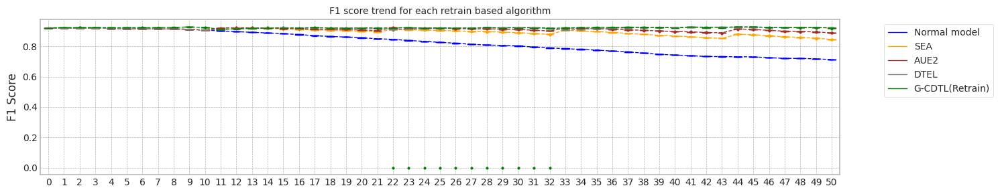

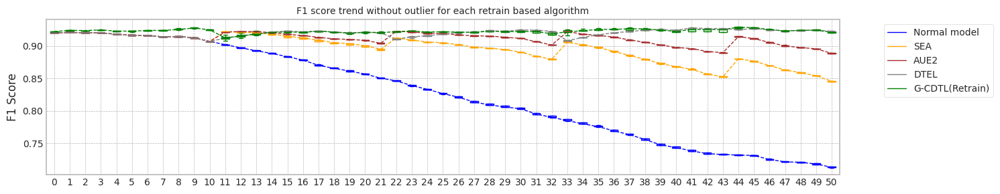

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.485473394393921
Base flops (train + inference flops of normal model, median): 3918915000.0


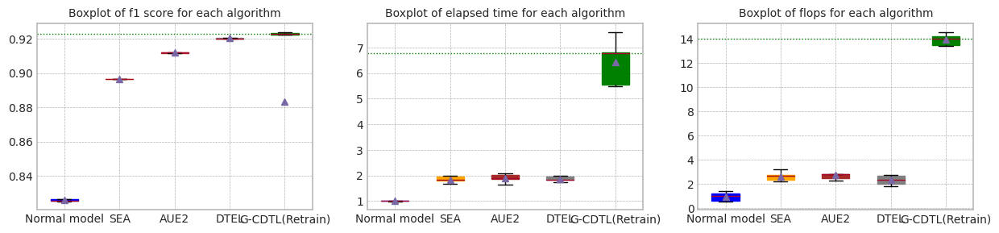

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.485473394393921


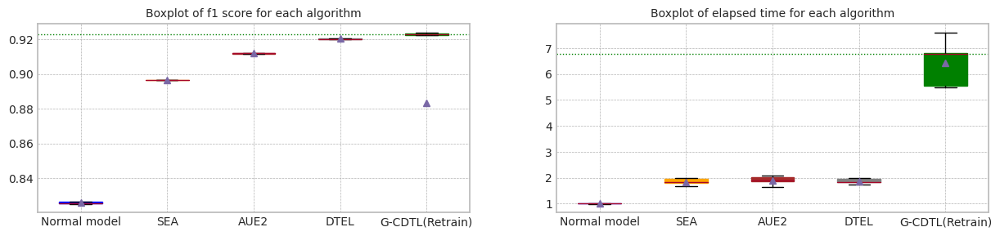

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.396806,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.483713,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.560670,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.485473,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.576208,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.485473,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.071785,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.447474,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.694436,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,9.572799,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.588680,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.600943,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.588680,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.088347,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.895933,0.845556,15.758847,3.713595e+09,6.982620e+09,1.069622e+10
1,1.0,0.920325,0.921341,0.896532,0.847302,17.118037,4.082040e+09,6.423210e+09,1.050525e+10
2,2.0,0.920255,0.921272,0.896469,0.845981,18.763826,4.260825e+09,8.320680e+09,1.258150e+10
3,3.0,0.920576,0.921592,0.896563,0.845664,18.594167,4.231245e+09,4.877220e+09,9.108465e+09
4,4.0,0.920325,0.921341,0.896457,0.843610,17.266760,3.933270e+09,4.704525e+09,8.637795e+09
5,median,0.920325,0.921341,0.896469,0.845664,17.266760,4.082040e+09,6.423210e+09,1.050525e+10
6,std,0.000125,0.000125,0.000260,0.001323,1.227433,2.263566e+08,1.510529e+09,1.548135e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.911837,0.888933,15.634023,3.714465e+09,7.183155e+09,1.089762e+10
1,1.0,0.920325,0.921341,0.911881,0.889198,17.933290,4.262565e+09,6.803400e+09,1.106596e+10
2,2.0,0.920255,0.921272,0.912155,0.891060,19.268909,4.446135e+09,8.705655e+09,1.315179e+10
3,3.0,0.920576,0.921592,0.911913,0.888911,19.619705,4.461360e+09,5.307000e+09,9.768360e+09
4,4.0,0.920325,0.921341,0.911491,0.888073,17.747508,4.017660e+09,4.988580e+09,9.006240e+09
5,median,0.920325,0.921341,0.911881,0.888933,17.933290,4.262565e+09,6.803400e+09,1.089762e+10
6,std,0.000125,0.000125,0.000238,0.001104,1.572526,3.161821e+08,1.506960e+09,1.572468e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.920682,0.923292,18.835647,4.582725e+09,6.208320e+09,1.079104e+10
1,1.0,0.920325,0.921341,0.920289,0.923143,17.379316,4.055070e+09,5.156490e+09,9.211560e+09
2,2.0,0.920255,0.921272,0.920245,0.922845,17.493884,4.088130e+09,6.518040e+09,1.060617e+10
3,3.0,0.920576,0.921592,0.920596,0.922645,16.569174,3.776670e+09,3.188550e+09,6.965220e+09
4,4.0,0.920325,0.921341,0.920298,0.922597,18.681170,4.265175e+09,3.564825e+09,7.830000e+09
5,median,0.920325,0.921341,0.920298,0.922845,17.493884,4.088130e+09,5.156490e+09,9.211560e+09
6,std,0.000125,0.000125,0.000201,0.000305,0.953193,2.969293e+08,1.508607e+09,1.681441e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.922995,0.921626,52.053979,5.263536e+10,62685000.0,5.269804e+10
1,1.0,0.922875,0.924630,0.924011,0.921176,52.663546,5.256280e+10,62685000.0,5.262549e+10
2,2.0,0.922514,0.924461,0.923335,0.916526,64.688491,5.569960e+10,62685000.0,5.576228e+10
3,3.0,0.921861,0.923788,0.724334,0.922152,64.169547,5.487411e+10,62685000.0,5.493680e+10
4,4.0,0.921318,0.923471,0.922550,0.923027,72.201244,5.699528e+10,62685000.0,5.705796e+10
5,median,0.922514,0.924461,0.922995,0.921626,64.169547,5.487411e+10,62685000.0,5.493680e+10
6,std,0.000668,0.000544,0.088947,0.002541,8.638952,1.937831e+09,0.0,1.937831e+09


trial_count: 5
Lambda :  0.8
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-29 21:39:14,138] [INFO] [profiler.py:80:start_profile] Flops profiler started


 59%|█████▉    | 1186/2000 [00:03<00:02, 374.96it/s]

Early stop: 1186
[2023-11-29 21:39:17,307] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4647105000
precision_recall_fscore: (array([0.92604356, 0.91310976]), array([0.91095738, 0.92786015]), array([0.91843852, 0.92042586]), array([4481, 4519]))
Test f1 score: 0.9204258588519373
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.21it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254606428957492
inference_flops: 199665000
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:39:27,143] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:39:27,146] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 18%|█▊        | 364/2000 [00:03<00:14, 114.63it/s]

[2023-11-29 21:39:41,723] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:39:41,724] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5748750000 1428975000 38677725000
precision_recall_fscore: (array([0.93162589, 0.91203804]), array([0.90917206, 0.93383492]), array([0.92026203, 0.92280778]), array([4481, 4519]))
Test f1 score: 0.9228077848239666
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.17it/s]


mean of drift:
x0    0.257991
x1    0.077935
x2    0.101534
x3    0.255187
z0    0.385057
dtype: float64
Mean F1 for all data: 0.9057820973769293
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9057820973769293
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-29 21:39:51,637] [INFO] [profiler.py:80:start_profile] Flops profiler started


 47%|████▋     | 949/2000 [00:02<00:02, 368.33it/s]

Early stop: 949
[2023-11-29 21:39:54,219] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 3719250000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.20it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8251714910775053
inference_flops: 199665000
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:40:04,076] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:40:04,078] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 45%|████▌     | 902/2000 [00:07<00:09, 119.72it/s]

[2023-11-29 21:40:20,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:40:20,037] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 23073750000 14222250000 3535245000 40831245000
precision_recall_fscore: (array([0.93124714, 0.91259195]), array([0.90984155, 0.93339234]), array([0.92041991, 0.92287496]), array([4481, 4519]))
Test f1 score: 0.9228749589760421
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]


mean of drift:
x0    0.134593
x1    0.100564
x2    0.052946
x3    0.032305
z0    0.253011
dtype: float64
Mean F1 for all data: 0.9108519483650425
inference_flops: 1002915000
Normal model median        : 0.8253160669866273
Drift tolerant model median: 0.9083170228709858
######################### Retrain 5 Trial 2 for Normal model ###########################
cuda:0
[2023-11-29 21:40:30,036] [INFO] [profiler.py:80:start_profile] Flops profiler started


 69%|██████▉   | 1388/2000 [00:03<00:01, 381.06it/s]

Early stop: 1388
[2023-11-29 21:40:33,683] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 5437935000
precision_recall_fscore: (array([0.92525481, 0.91363141]), array([0.91162687, 0.92697499]), array([0.91839029, 0.92025483]), array([4481, 4519]))
Test f1 score: 0.9202548330404218
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.18it/s]

mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265833566787452
inference_flops: 199665000
######################### Retrain 5 Trial 2 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:40:43,571] [INFO] [profiler.py:80:start_profile] Flops profiler started


[2023-11-29 21:40:43,574] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 21%|██▏       | 425/2000 [00:03<00:13, 120.09it/s]

[2023-11-29 21:40:58,514] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:40:58,515] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6709500000 1667790000 39877290000
precision_recall_fscore: (array([0.92040907, 0.92425589]), array([0.92390091, 0.92077893]), array([0.92215169, 0.92251413]), array([4481, 4519]))
Test f1 score: 0.9225141336880612
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.11it/s]

mean of drift:
x0    0.221022
x1    0.125050
x2    0.102092
x3    0.080410
z0    0.338359
dtype: float64
Mean F1 for all data: 0.9060679617969004
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9060679617969004
######################### Retrain 5 Trial 3 for Normal model ###########################
cuda:0
[2023-11-29 21:41:08,551] [INFO] [profiler.py:80:start_profile] Flops profiler started



 26%|██▌       | 516/2000 [00:01<00:03, 372.96it/s]

Early stop: 516
[2023-11-29 21:41:09,941] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2024055000
precision_recall_fscore: (array([0.92549819, 0.91404887]), array([0.9120732 , 0.92719628]), array([0.91873665, 0.92057563]), array([4481, 4519]))
Test f1 score: 0.9205756344062397
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.14it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8265768957384185
inference_flops: 199665000
######################### Retrain 5 Trial 3 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:41:19,905] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:41:19,908] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 22%|██▏       | 433/2000 [00:03<00:13, 118.87it/s]

[2023-11-29 21:41:35,055] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:41:35,058] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 6835500000 1699110000 40034610000
precision_recall_fscore: (array([0.92761516, 0.91443501]), array([0.91229636, 0.92940916]), array([0.91989199, 0.92186128]), array([4481, 4519]))
Test f1 score: 0.9218612818261633
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.13it/s]


mean of drift:
x0    0.079547
x1    0.366906
x2    0.062390
x3    0.155000
z0    0.350752
dtype: float64
Mean F1 for all data: 0.9137359370496808
inference_flops: 1002915000
Normal model median        : 0.8260187693170838
Drift tolerant model median: 0.9084599550809714
######################### Retrain 5 Trial 4 for Normal model ###########################
cuda:0
[2023-11-29 21:41:45,067] [INFO] [profiler.py:80:start_profile] Flops profiler started


 27%|██▋       | 548/2000 [00:01<00:03, 379.09it/s]

Early stop: 548
[2023-11-29 21:41:46,518] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 2149335000
precision_recall_fscore: (array([0.92602678, 0.91291095]), array([0.91073421, 0.92786015]), array([0.91831683, 0.92032485]), array([4481, 4519]))
Test f1 score: 0.9203248463564531
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.22it/s]


mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8254127745673665
inference_flops: 199665000
######################### Retrain 5 Trial 4 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-29 21:41:56,340] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:41:56,342] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 17%|█▋        | 339/2000 [00:02<00:13, 119.14it/s]

[2023-11-29 21:42:10,632] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:10,633] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5355000000 1331100000 38186100000
precision_recall_fscore: (array([0.91836735, 0.92408727]), array([0.92390091, 0.91856605]), array([0.92112582, 0.92131839]), array([4481, 4519]))
Test f1 score: 0.9213183886361114
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set (51, 9000, 6)


100%|██████████| 51/51 [00:09<00:00,  5.16it/s]


mean of drift:
x0    0.307612
x1    0.121105
x2    0.112281
x3    0.131155
z0    0.398351
dtype: float64
Mean F1 for all data: 0.9094332413453058
inference_flops: 1002915000
Normal model median        : 0.8254606428957492
Drift tolerant model median: 0.9094332413453058
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.17it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:42:22,342] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:42:22,345] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:42:37,036] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:37,037] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:16<02:18,  3.37s/it]

G-CDTL train flops: 3500000000 757750000 188355000 4446105000


 33%|███▎      | 17/51 [00:17<00:15,  2.24it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:42:38,777] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:42:38,779] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:42:42,623] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:42,625] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:22<00:50,  1.53s/it]

G-CDTL train flops: 73500000 773500000 192270000 1039270000


 51%|█████     | 26/51 [00:23<00:06,  3.65it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:42:44,417] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:42:44,420] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:42:58,717] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:42:58,718] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 55%|█████▍    | 28/51 [00:38<01:14,  3.24s/it]

G-CDTL train flops: 3500000000 698250000 173565000 4371815000


 69%|██████▊   | 35/51 [00:39<00:07,  2.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:43:00,445] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:43:00,447] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:43:15,692] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:43:15,693] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:55<00:49,  3.52s/it]

G-CDTL train flops: 3500000000 871500000 216630000 4588130000


 86%|████████▋ | 44/51 [00:56<00:03,  2.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:43:17,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:43:17,412] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:43:32,113] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:43:32,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 88%|████████▊ | 45/51 [01:11<00:28,  4.79s/it]

G-CDTL train flops: 3500000000 766500000 190530000 4457030000


100%|██████████| 51/51 [01:12<00:00,  1.43s/it]


Early stop at  [432, 441, 398, 497, 437]
Train flops  [4446105000, 1039270000, 4371815000, 4588130000, 4457030000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9239180403916785
G_CDTL+AUE median: 0.9239180403916785
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:30,  1.33it/s]

Ensemble_SEA train flops: 620310000


 37%|███▋      | 19/51 [00:07<00:13,  2.31it/s]

Ensemble_SEA train flops: 251430000


 55%|█████▍    | 28/51 [00:09<00:05,  4.42it/s]

Ensemble_SEA train flops: 27405000


 73%|███████▎  | 37/51 [00:12<00:07,  1.82it/s]

Ensemble_SEA train flops: 394545000


 90%|█████████ | 46/51 [00:15<00:02,  1.92it/s]

Ensemble_SEA train flops: 362790000


100%|██████████| 51/51 [00:16<00:00,  3.04it/s]


Early stop at  [1425, 577, 62, 906, 833]
Train flops  [620310000, 251430000, 27405000, 394545000, 362790000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8823174539230919
SEA median: 0.8823174539230919
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:32,  1.25it/s]

Ensemble_SEA train flops: 672510000


 37%|███▋      | 19/51 [00:07<00:13,  2.34it/s]

Ensemble_SEA train flops: 244470000


 55%|█████▍    | 28/51 [00:10<00:11,  2.00it/s]

Ensemble_SEA train flops: 339735000


 73%|███████▎  | 37/51 [00:14<00:10,  1.37it/s]

Ensemble_SEA train flops: 593775000


 90%|█████████ | 46/51 [00:18<00:02,  1.80it/s]

Ensemble_SEA train flops: 384105000


100%|██████████| 51/51 [00:19<00:00,  2.67it/s]


Early stop at  [1545, 561, 780, 1364, 882]
Train flops  [672510000, 244470000, 339735000, 593775000, 384105000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9094243068204417
AUE median: 0.9094243068204417
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:32,  1.28it/s]

Ensemble_DTEL train flops: 441960000
Ensemble_DTEL train flops: 3045000


 35%|███▌      | 18/51 [00:07<00:27,  1.21it/s]

Ensemble_DTEL train flops: 496770000
Ensemble_DTEL train flops: 2175000


 55%|█████▍    | 28/51 [00:10<00:11,  1.96it/s]

Ensemble_DTEL train flops: 354090000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 36/51 [00:14<00:15,  1.00s/it]

Ensemble_DTEL train flops: 631620000
Ensemble_DTEL train flops: 2175000


 90%|█████████ | 46/51 [00:18<00:02,  2.05it/s]

Ensemble_DTEL train flops: 311025000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:19<00:00,  2.68it/s]


Early stop at  [1015, 6, 1141, 4, 813, 3, 1451, 4, 714, 2]
Train flops  [441960000, 3045000, 496770000, 2175000, 354090000, 1740000, 631620000, 2175000, 311025000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9214461886758337
DTEL median: 0.9214461886758337
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:07,  5.39it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:44:30,044] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:44:30,046] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:44:34,501] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:44:34,503] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:06<00:47,  1.15s/it]

G-CDTL train flops: 73500000 922250000 229245000 1224995000


 33%|███▎      | 17/51 [00:07<00:09,  3.69it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:44:36,234] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:44:36,237] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:44:52,460] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:44:52,461] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:24<02:49,  5.12s/it]

G-CDTL train flops: 3500000000 1004500000 249690000 4754190000


 51%|█████     | 26/51 [00:25<00:12,  2.08it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:44:54,252] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:44:54,254] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:45:09,830] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:45:09,831] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:41<02:01,  5.07s/it]

G-CDTL train flops: 3500000000 899500000 223590000 4623090000


 69%|██████▊   | 35/51 [00:43<00:07,  2.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:45:11,566] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:45:11,568] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:45:15,151] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:45:15,152] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [00:46<00:22,  1.47s/it]

G-CDTL train flops: 66500000 694750000 172695000 933945000


 86%|████████▋ | 44/51 [00:48<00:01,  3.70it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:45:16,960] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:45:16,964] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:45:21,113] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:45:21,114] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [00:52<00:05,  1.11s/it]

G-CDTL train flops: 110250000 801500000 199230000 1110980000


100%|██████████| 51/51 [00:53<00:00,  1.06s/it]


Early stop at  [526, 573, 513, 396, 457]
Train flops  [1224995000, 4754190000, 4623090000, 933945000, 1110980000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9244507139559646
G_CDTL+AUE median: 0.9241843771738215
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:29,  1.40it/s]

Ensemble_SEA train flops: 566370000


 37%|███▋      | 19/51 [00:08<00:25,  1.27it/s]

Ensemble_SEA train flops: 643365000


 55%|█████▍    | 28/51 [00:12<00:15,  1.51it/s]

Ensemble_SEA train flops: 506340000


 73%|███████▎  | 37/51 [00:15<00:07,  1.84it/s]

Ensemble_SEA train flops: 378015000


 90%|█████████ | 46/51 [00:19<00:02,  2.04it/s]

Ensemble_SEA train flops: 306240000


100%|██████████| 51/51 [00:20<00:00,  2.54it/s]


Early stop at  [1301, 1478, 1163, 868, 703]
Train flops  [566370000, 643365000, 506340000, 378015000, 306240000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8908787124481276
SEA median: 0.8865980831856097
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:17,  2.28it/s]

Ensemble_SEA train flops: 274920000


 37%|███▋      | 19/51 [00:06<00:19,  1.67it/s]

Ensemble_SEA train flops: 448920000


 55%|█████▍    | 28/51 [00:09<00:11,  1.94it/s]

Ensemble_SEA train flops: 335385000


 73%|███████▎  | 37/51 [00:14<00:10,  1.38it/s]

Ensemble_SEA train flops: 576810000


 90%|█████████ | 46/51 [00:17<00:03,  1.65it/s]

Ensemble_SEA train flops: 438915000


100%|██████████| 51/51 [00:18<00:00,  2.74it/s]


Early stop at  [631, 1031, 770, 1325, 1008]
Train flops  [274920000, 448920000, 335385000, 576810000, 438915000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9094257739130951
AUE median: 0.9094250403667684
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:36,  1.17it/s]

Ensemble_DTEL train flops: 497640000
Ensemble_DTEL train flops: 3045000


 35%|███▌      | 18/51 [00:07<00:29,  1.12it/s]

Ensemble_DTEL train flops: 524175000
Ensemble_DTEL train flops: 2175000


 55%|█████▍    | 28/51 [00:10<00:09,  2.40it/s]

Ensemble_DTEL train flops: 232290000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 36/51 [00:14<00:10,  1.38it/s]

Ensemble_DTEL train flops: 408900000
Ensemble_DTEL train flops: 2175000


 88%|████████▊ | 45/51 [00:17<00:04,  1.23it/s]

Ensemble_DTEL train flops: 441090000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:18<00:00,  2.70it/s]


Early stop at  [1143, 6, 1204, 4, 533, 3, 939, 4, 1013, 2]
Train flops  [497640000, 3045000, 524175000, 2175000, 232290000, 1740000, 408900000, 2175000, 441090000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9213262098710174
DTEL median: 0.9213861992734256
######################### Retrain 5 Trial 2 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 2 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.23it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:46:21,700] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:46:21,703] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:46:37,716] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:46:37,717] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:17<02:29,  3.65s/it]

G-CDTL train flops: 3500000000 962500000 239250000 4701750000


 33%|███▎      | 17/51 [00:19<00:16,  2.12it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:46:39,463] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:46:39,465] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:46:54,978] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:46:54,979] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:35<01:54,  3.59s/it]

G-CDTL train flops: 3500000000 805000000 200100000 4505100000


 51%|█████     | 26/51 [00:36<00:11,  2.10it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:46:56,748] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:46:56,751] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:47:22,884] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:47:22,885] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [01:02<03:17,  8.24s/it]

G-CDTL train flops: 3500000000 3076500000 764730000 7341230000


 69%|██████▊   | 35/51 [01:04<00:10,  1.50it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:47:24,918] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:47:24,920] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:47:38,840] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:47:38,841] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 71%|███████   | 36/51 [01:18<01:10,  4.71s/it]

G-CDTL train flops: 3500000000 539000000 133980000 4172980000


 86%|████████▋ | 44/51 [01:20<00:03,  2.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:47:40,567] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:47:40,569] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:47:55,708] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:47:55,709] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:35<00:17,  3.50s/it]

G-CDTL train flops: 3500000000 764750000 190095000 4454845000


100%|██████████| 51/51 [01:36<00:00,  1.90s/it]


Early stop at  [549, 459, 1757, 307, 436]
Train flops  [4701750000, 4505100000, 7341230000, 4172980000, 4454845000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9250723991492842
G_CDTL+AUE median: 0.9244507139559646
######################### Retrain 5 Trial 2 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:25,  1.59it/s]

Ensemble_SEA train flops: 462840000


 35%|███▌      | 18/51 [00:06<00:17,  1.88it/s]

Ensemble_SEA train flops: 240120000


 55%|█████▍    | 28/51 [00:10<00:14,  1.54it/s]

Ensemble_SEA train flops: 498075000


 71%|███████   | 36/51 [00:13<00:10,  1.40it/s]

Ensemble_SEA train flops: 380190000


 90%|█████████ | 46/51 [00:17<00:02,  1.83it/s]

Ensemble_SEA train flops: 365400000


100%|██████████| 51/51 [00:18<00:00,  2.78it/s]


Early stop at  [1063, 551, 1144, 873, 839]
Train flops  [462840000, 240120000, 498075000, 380190000, 365400000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8906749520618745
SEA median: 0.8906749520618745
######################### Retrain 5 Trial 2 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:27,  1.47it/s]

Ensemble_SEA train flops: 525480000


 37%|███▋      | 19/51 [00:08<00:25,  1.27it/s]

Ensemble_SEA train flops: 641190000


 55%|█████▍    | 28/51 [00:12<00:13,  1.75it/s]

Ensemble_SEA train flops: 386715000


 73%|███████▎  | 37/51 [00:16<00:11,  1.19it/s]

Ensemble_SEA train flops: 709485000


 90%|█████████ | 46/51 [00:20<00:02,  1.78it/s]

Ensemble_SEA train flops: 383670000


100%|██████████| 51/51 [00:21<00:00,  2.42it/s]


Early stop at  [1207, 1473, 888, 1630, 881]
Train flops  [525480000, 641190000, 386715000, 709485000, 383670000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9096233301470481
AUE median: 0.9094257739130951
######################### Retrain 5 Trial 2 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:01<00:08,  5.02it/s]

Ensemble_DTEL train flops: 1305000
Ensemble_DTEL train flops: 3045000


 37%|███▋      | 19/51 [00:06<00:24,  1.28it/s]

Ensemble_DTEL train flops: 654240000
Ensemble_DTEL train flops: 1740000


 55%|█████▍    | 28/51 [00:09<00:13,  1.76it/s]

Ensemble_DTEL train flops: 396285000
Ensemble_DTEL train flops: 1740000


 71%|███████   | 36/51 [00:14<00:18,  1.26s/it]

Ensemble_DTEL train flops: 785610000
Ensemble_DTEL train flops: 1740000


 90%|█████████ | 46/51 [00:18<00:02,  1.81it/s]

Ensemble_DTEL train flops: 362790000
Ensemble_DTEL train flops: 1740000


100%|██████████| 51/51 [00:19<00:00,  2.64it/s]


Early stop at  [2, 6, 1503, 3, 910, 3, 1805, 3, 833, 3]
Train flops  [1305000, 3045000, 654240000, 1740000, 396285000, 1740000, 785610000, 1740000, 362790000, 1740000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9212957648249197
DTEL median: 0.9213262098710174
######################### Retrain 5 Trial 3 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 3 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.21it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:48:57,463] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:48:57,466] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:16,908] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:16,910] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 20%|█▉        | 10/51 [00:21<03:00,  4.40s/it]

G-CDTL train flops: 3500000000 1548750000 384975000 5433725000


 33%|███▎      | 17/51 [00:22<00:18,  1.89it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:18,648] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:18,650] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:34,782] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:34,783] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 35%|███▌      | 18/51 [00:39<02:54,  5.28s/it]

G-CDTL train flops: 3500000000 894250000 222285000 4616535000


 51%|█████     | 26/51 [00:40<00:12,  2.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:36,507] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:36,509] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:51,932] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:51,934] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:56<02:00,  5.03s/it]

G-CDTL train flops: 3500000000 749000000 186180000 4435180000


 69%|██████▊   | 35/51 [00:57<00:07,  2.11it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:53,703] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:53,706] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:49:56,818] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:49:56,819] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [01:01<00:13,  1.01it/s]

G-CDTL train flops: 68250000 582750000 144855000 795855000


 86%|████████▋ | 44/51 [01:02<00:01,  3.88it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:49:58,564] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:49:58,566] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:50:00,313] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:50:00,314] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [01:04<00:02,  1.69it/s]

G-CDTL train flops: 78750000 295750000 73515000 448015000


100%|██████████| 51/51 [01:05<00:00,  1.29s/it]


Early stop at  [884, 510, 427, 332, 168]
Train flops  [5433725000, 4616535000, 4435180000, 795855000, 448015000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.894149097689885
G_CDTL+AUE median: 0.9241843771738215
######################### Retrain 5 Trial 3 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:01<00:07,  5.25it/s]

Ensemble_SEA train flops: 1740000


 37%|███▋      | 19/51 [00:06<00:24,  1.33it/s]

Ensemble_SEA train flops: 596385000


 55%|█████▍    | 28/51 [00:09<00:10,  2.24it/s]

Ensemble_SEA train flops: 251865000


 73%|███████▎  | 37/51 [00:12<00:07,  1.93it/s]

Ensemble_SEA train flops: 343650000


 90%|█████████ | 46/51 [00:15<00:02,  2.20it/s]

Ensemble_SEA train flops: 264045000


100%|██████████| 51/51 [00:16<00:00,  3.13it/s]


Early stop at  [3, 1370, 578, 789, 606]
Train flops  [1740000, 596385000, 251865000, 343650000, 264045000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8952009817472405
SEA median: 0.890776832255001
######################### Retrain 5 Trial 3 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:04<00:28,  1.42it/s]

Ensemble_SEA train flops: 547230000


 37%|███▋      | 19/51 [00:09<00:32,  1.01s/it]

Ensemble_SEA train flops: 870000000


 53%|█████▎    | 27/51 [00:13<00:21,  1.09it/s]

Ensemble_SEA train flops: 502425000


 73%|███████▎  | 37/51 [00:18<00:12,  1.11it/s]

Ensemble_SEA train flops: 770385000


 90%|█████████ | 46/51 [00:22<00:02,  1.74it/s]

Ensemble_SEA train flops: 400200000


100%|██████████| 51/51 [00:23<00:00,  2.20it/s]


Early stop at  [1257, 1999, 1154, 1770, 919]
Train flops  [547230000, 870000000, 502425000, 770385000, 400200000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9096308494419446
AUE median: 0.9095245520300717
######################### Retrain 5 Trial 3 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:03<00:36,  1.14it/s]

Ensemble_DTEL train flops: 498075000
Ensemble_DTEL train flops: 3045000


 35%|███▌      | 18/51 [00:07<00:24,  1.33it/s]

Ensemble_DTEL train flops: 403680000
Ensemble_DTEL train flops: 2175000


 55%|█████▍    | 28/51 [00:10<00:12,  1.88it/s]

Ensemble_DTEL train flops: 355395000
Ensemble_DTEL train flops: 1305000


 71%|███████   | 36/51 [00:14<00:13,  1.12it/s]

Ensemble_DTEL train flops: 524610000
Ensemble_DTEL train flops: 2175000


 90%|█████████ | 46/51 [00:19<00:04,  1.10it/s]

Ensemble_DTEL train flops: 771255000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:20<00:00,  2.46it/s]


Early stop at  [1144, 6, 927, 4, 816, 2, 1205, 4, 1772, 2]
Train flops  [498075000, 3045000, 403680000, 2175000, 355395000, 1305000, 524610000, 2175000, 771255000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9209953913558663
DTEL median: 0.9213109873479686
######################### Retrain 5 Trial 4 for Normal model ###########################
retrain_interval: 9
######################### Retrain 5 Trial 4 for G_CDTL+AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 16%|█▌        | 8/51 [00:01<00:08,  5.26it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:03,591] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:03,593] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:20,054] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:20,056] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 18%|█▊        | 9/51 [00:18<03:44,  5.34s/it]

G-CDTL train flops: 3500000000 939750000 233595000 4673345000


 33%|███▎      | 17/51 [00:19<00:16,  2.07it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:21,866] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:21,869] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:36,997] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:36,998] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 19/51 [00:35<01:52,  3.52s/it]

G-CDTL train flops: 3500000000 654500000 162690000 4317190000


 51%|█████     | 26/51 [00:36<00:11,  2.16it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:38,704] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:38,706] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:42,704] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:42,706] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 53%|█████▎    | 27/51 [00:40<00:37,  1.58s/it]

G-CDTL train flops: 68250000 777000000 193140000 1038390000


 69%|██████▊   | 35/51 [00:42<00:04,  3.72it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:44,408] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:44,410] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:49,397] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:49,398] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 73%|███████▎  | 37/51 [00:47<00:17,  1.28s/it]

G-CDTL train flops: 71750000 955500000 237510000 1264760000


 86%|████████▋ | 44/51 [00:49<00:01,  3.60it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-29 21:51:51,104] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-29 21:51:51,107] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-29 21:51:55,475] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-29 21:51:55,477] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 90%|█████████ | 46/51 [00:53<00:05,  1.15s/it]

G-CDTL train flops: 87500000 815500000 202710000 1105710000


100%|██████████| 51/51 [00:54<00:00,  1.07s/it]


Early stop at  [536, 373, 443, 545, 465]
Train flops  [4673345000, 4317190000, 1038390000, 1264760000, 1105710000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9241980430535522
G_CDTL+AUE median: 0.9241980430535522
######################### Retrain 5 Trial 4 for SEA ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:03<00:24,  1.70it/s]

Ensemble_SEA train flops: 411510000


 37%|███▋      | 19/51 [00:07<00:17,  1.87it/s]

Ensemble_SEA train flops: 358875000


 55%|█████▍    | 28/51 [00:10<00:11,  1.95it/s]

Ensemble_SEA train flops: 330600000


 73%|███████▎  | 37/51 [00:13<00:08,  1.68it/s]

Ensemble_SEA train flops: 417600000


 90%|█████████ | 46/51 [00:17<00:03,  1.59it/s]

Ensemble_SEA train flops: 449790000


100%|██████████| 51/51 [00:18<00:00,  2.76it/s]


Early stop at  [945, 824, 759, 959, 1033]
Train flops  [411510000, 358875000, 330600000, 417600000, 449790000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.8910548923349816
SEA median: 0.8908787124481276
######################### Retrain 5 Trial 4 for AUE ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 20%|█▉        | 10/51 [00:05<00:35,  1.16it/s]

Ensemble_SEA train flops: 716445000


 37%|███▋      | 19/51 [00:07<00:15,  2.06it/s]

Ensemble_SEA train flops: 271875000


 55%|█████▍    | 28/51 [00:11<00:14,  1.59it/s]

Ensemble_SEA train flops: 456750000


 73%|███████▎  | 37/51 [00:15<00:07,  1.80it/s]

Ensemble_SEA train flops: 381495000


 88%|████████▊ | 45/51 [00:19<00:05,  1.00it/s]

Ensemble_SEA train flops: 592035000


100%|██████████| 51/51 [00:20<00:00,  2.50it/s]


Early stop at  [1646, 624, 1049, 876, 1360]
Train flops  [716445000, 271875000, 456750000, 381495000, 592035000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.909145217600684
AUE median: 0.9094257739130951
######################### Retrain 5 Trial 4 for DTEL ###########################
X_live.shape (59000, 6)
Truncate 8000 rows from live_set (59000, 6)
Search MI & Drift...for X_live_set torch.Size([51, 9000, 6])


 18%|█▊        | 9/51 [00:05<00:52,  1.25s/it]

Ensemble_DTEL train flops: 766470000
Ensemble_DTEL train flops: 3045000


 37%|███▋      | 19/51 [00:08<00:13,  2.29it/s]

Ensemble_DTEL train flops: 231420000
Ensemble_DTEL train flops: 2175000


 53%|█████▎    | 27/51 [00:12<00:27,  1.16s/it]

Ensemble_DTEL train flops: 735585000
Ensemble_DTEL train flops: 1740000


 73%|███████▎  | 37/51 [00:16<00:07,  1.84it/s]

Ensemble_DTEL train flops: 351915000
Ensemble_DTEL train flops: 2175000


 90%|█████████ | 46/51 [00:19<00:02,  2.15it/s]

Ensemble_DTEL train flops: 284925000
Ensemble_DTEL train flops: 1305000


100%|██████████| 51/51 [00:20<00:00,  2.53it/s]


Early stop at  [1761, 6, 531, 4, 1690, 3, 808, 4, 654, 2]
Train flops  [766470000, 3045000, 231420000, 2175000, 735585000, 1740000, 351915000, 2175000, 284925000, 1305000]
Mean of drift:
x0    0.013529
x1    0.011288
x2    0.013153
x3    0.011946
z0    0.406129
dtype: float64
Mean F1 for all data: 0.9211502427357361
DTEL median: 0.9212957648249197


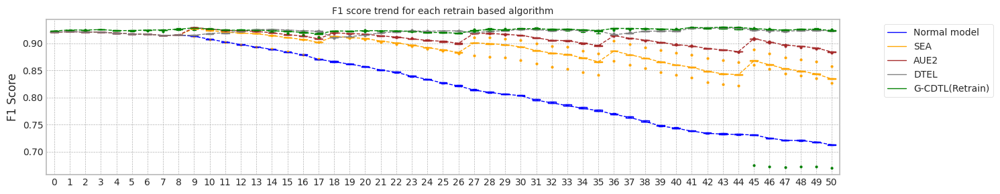

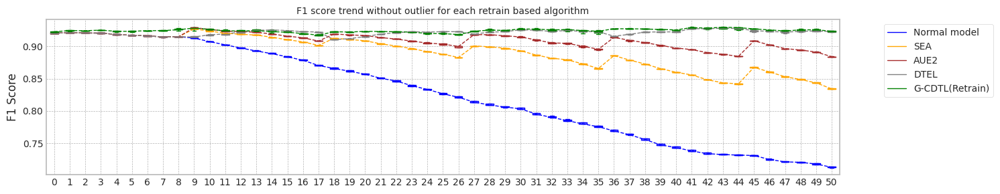

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.837863445281982
Base flops (train + inference flops of normal model, median): 3918915000.0


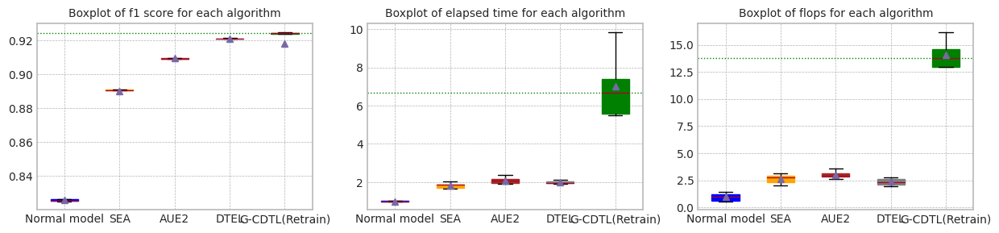

Base elapsed time (inference elapsed time of normal model, median (ms)): 9.837863445281982


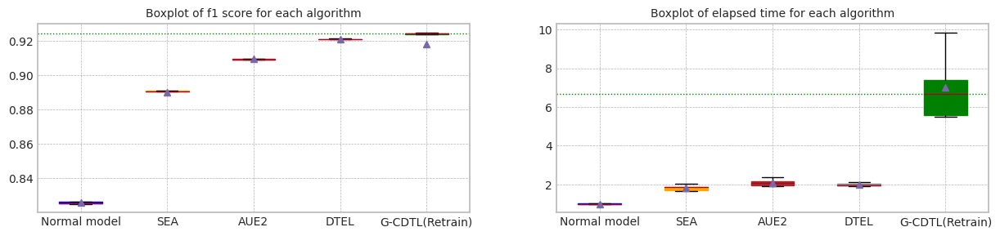

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.825461,0.712593,9.816301,4.647105e+09,199665000.0,4.846770e+09
1,1.0,0.920325,0.921341,0.825171,0.712370,9.837863,3.719250e+09,199665000.0,3.918915e+09
2,2.0,0.920255,0.921272,0.826583,0.713769,9.870718,5.437935e+09,199665000.0,5.637600e+09
3,3.0,0.920576,0.921592,0.826577,0.713769,9.944789,2.024055e+09,199665000.0,2.223720e+09
4,4.0,0.920325,0.921341,0.825413,0.712929,9.802790,2.149335e+09,199665000.0,2.349000e+09
5,median,0.920325,0.921341,0.825461,0.712929,9.837863,3.719250e+09,199665000.0,3.918915e+09
6,std,0.000125,0.000125,0.000684,0.000655,0.056624,1.506369e+09,0.0,1.506369e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.905782,0.881666,9.895763,3.867772e+10,1.002915e+09,3.968064e+10
1,1.0,0.922875,0.924630,0.910852,0.889883,9.978657,4.083124e+10,1.002915e+09,4.183416e+10
2,2.0,0.922514,0.924461,0.906068,0.868550,10.014286,3.987729e+10,1.002915e+09,4.088020e+10
3,3.0,0.921861,0.923788,0.913736,0.896489,9.987937,4.003461e+10,1.002915e+09,4.103752e+10
4,4.0,0.921318,0.923471,0.909433,0.878450,9.918757,3.818610e+10,1.002915e+09,3.918902e+10
5,median,0.922514,0.924461,0.909433,0.881666,9.978657,3.987729e+10,1.002915e+09,4.088020e+10
6,std,0.000668,0.000544,0.003348,0.010731,0.049746,1.072445e+09,0.000000e+00,1.072445e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.882317,0.826484,16.795054,3.805815e+09,7.176630e+09,1.098244e+10
1,1.0,0.920325,0.921341,0.890879,0.834303,20.077430,4.549665e+09,6.992625e+09,1.154229e+10
2,2.0,0.920255,0.921272,0.890675,0.834072,18.375469,4.095960e+09,8.257605e+09,1.235356e+10
3,3.0,0.920576,0.921592,0.895201,0.858014,16.315333,3.607020e+09,4.354785e+09,7.961805e+09
4,4.0,0.920325,0.921341,0.891055,0.835228,18.530532,4.117710e+09,4.990755e+09,9.108465e+09
5,median,0.920325,0.921341,0.890879,0.834303,18.375469,4.095960e+09,6.992625e+09,1.098244e+10
6,std,0.000125,0.000125,0.004701,0.011929,1.502198,3.574666e+08,1.625082e+09,1.807817e+09


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.909424,0.884285,19.156946,4.383930e+09,7.954410e+09,1.233834e+10
1,1.0,0.920325,0.921341,0.909426,0.883785,18.651304,4.224285e+09,6.866910e+09,1.109120e+10
2,2.0,0.920255,0.921272,0.909623,0.884157,21.142786,4.795875e+09,9.157185e+09,1.395306e+10
3,3.0,0.920576,0.921592,0.909631,0.884047,23.228118,5.239575e+09,6.187005e+09,1.142658e+10
4,4.0,0.920325,0.921341,0.909145,0.881966,20.432128,4.567935e+09,5.640645e+09,1.020858e+10
5,median,0.920325,0.921341,0.909426,0.884047,20.432128,4.567935e+09,6.866910e+09,1.142658e+10
6,std,0.000125,0.000125,0.000198,0.000958,1.808273,3.960254e+08,1.410752e+09,1.423014e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920426,0.921442,0.921446,0.923579,19.071882,4.395240e+09,5.771145e+09,1.016638e+10
1,1.0,0.920325,0.921341,0.921326,0.923294,18.924329,4.263870e+09,4.973355e+09,9.237225e+09
2,2.0,0.920255,0.921272,0.921296,0.921870,19.332378,4.359570e+09,6.613305e+09,1.097288e+10
3,3.0,0.920576,0.921592,0.920995,0.922793,20.805198,4.712355e+09,3.607890e+09,8.320245e+09
4,4.0,0.920325,0.921341,0.921150,0.922408,20.153708,4.530090e+09,3.247275e+09,7.777365e+09
5,median,0.920325,0.921341,0.921296,0.922793,19.332378,4.395240e+09,4.973355e+09,9.237225e+09
6,std,0.000125,0.000125,0.000174,0.000683,0.798377,1.739543e+08,1.421642e+09,1.306836e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.922808,0.924679,0.923918,0.925853,72.734859,5.708845e+10,53730000.0,5.714218e+10
1,1.0,0.922875,0.924630,0.924451,0.923376,53.956977,5.083330e+10,53730000.0,5.088703e+10
2,2.0,0.922514,0.924461,0.925072,0.924087,96.904042,6.336200e+10,53730000.0,6.341574e+10
3,3.0,0.921861,0.923788,0.894149,0.670802,65.789368,5.391541e+10,53730000.0,5.396914e+10
4,4.0,0.921318,0.923471,0.924198,0.922928,54.777335,5.058550e+10,53730000.0,5.063922e+10
5,median,0.922514,0.924461,0.924198,0.923376,65.789368,5.391541e+10,53730000.0,5.396914e+10
6,std,0.000668,0.000544,0.013540,0.113266,17.545152,5.295923e+09,0.0,5.295923e+09


Test F1 Score: 0.9203812038023009
G-CDTL, 1-retrain: 0.919057124116446


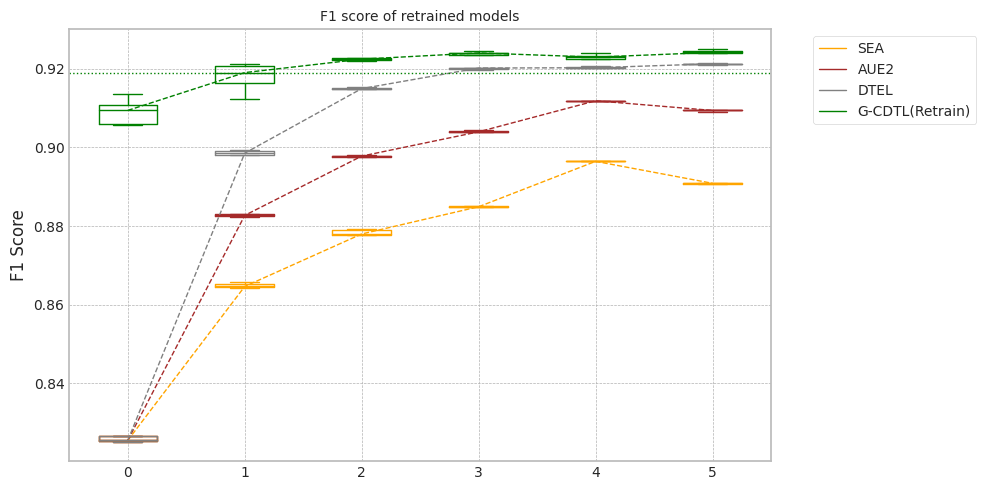

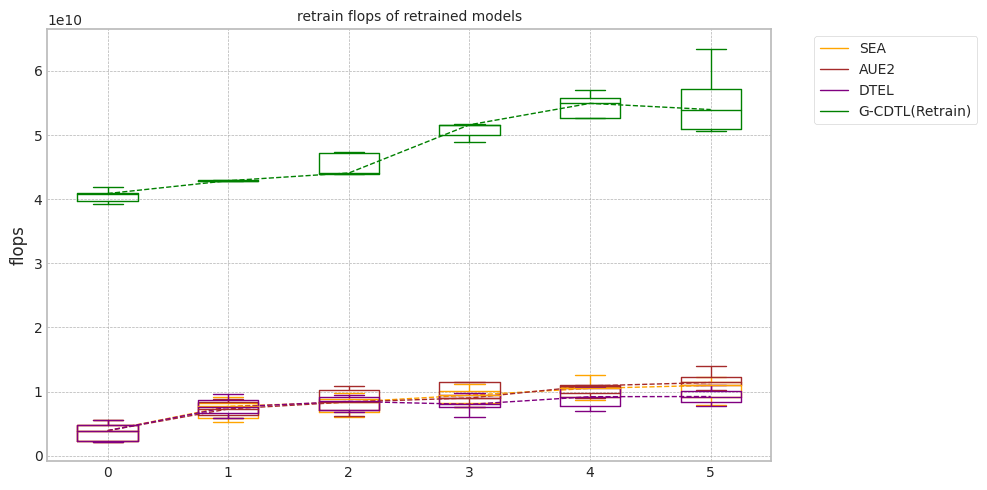

In [ ]:
experiment_all(2000,'case4',X1, Y1,train_size, test_size,avaible_range = 300,
               lambda_f2=0.8,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

## synthetic data의 생성 (Case #5 - Case #1,2,3,4의 상황이 각 feature에 혼재되어 있는 경우)

+ $P_t(y,X) \ne P_{t+w}(y,X) $ 이고 $P_t(y|X) \ne P_{t+w}(y|X) $
+ 전체적으로는 Real concept drift
+ 즉, P(y|X)와 P(X)의 변화가 연관되어 나타남.
+ $x_0$ : No drift
+ $x_1$ : $P_t(y|X) = P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Virtual Drift
+ $x_2$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Real Concept Drift, MI 감소, Drift 증가
+ $x_3$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) \ne P_{t+w}(X)$ 인 Real Concept Drift, MI 증가, Drift 증가
+ $z_0$ : $P_t(y|X) \ne P_{t+w}(y|X)$ 이면서 $P_t(X) = P_{t+w}(X)$ 인 Actual Drift, MI 감소, Drift 고정


### Dataset 준비

In [165]:
seed_everything()

data_size = 40000
cor = np.asarray([1.5, 1.2, 0.5 , 0.7, 2.5])

x4 = np.zeros((data_size,5))
for ix,cor_ in enumerate(cor):
    x4[:,ix] = np.random.normal(1,cor_,data_size)

y4_array = []
cor_const = cor[4]
cor_const2 = 3/x4.shape[0]
for ii in range(x4.shape[0]):
    # Case #2, MI의 증감(상대적), Drift의 고정 - z0
    cor[4] = cor[4] - cor_const / x4.shape[0]
    e = np.random.normal(0.0, 2.0)
    # Case #3 MI의 증감(상대적), Drift의 증가 - x3
    e1 = np.random.normal(0.0, 3*cor_const2 * ii)
    x4[ii,3] = x4[ii,3] + e1
    y4_array.append(np.sum(cor * x4[ii])+e)

y4 = [1 if y_ > 5 else 0 for y_ in y4_array]

for i in range(len(y4)):
    #Case #1 MI의 감소, Drift의 증가 - x2
    x4[i,2] = y4[i] + np.random.normal(1,0.5+8*(i/data_size))
    #Case #4 MI의 고정, Drift의 증가 - x1
    x4[i,1] = y4[i] + np.random.normal(0.0 + 6*(i/data_size),cor[1])

### 실험

MI Analysis MI Max 0.14553, Min 0.01000, Mean 0.06134, Std 0.05133
Dataset structure X_train, (9000, 5) X_test, (9000, 5) X_live (39000, 5)
Truncate 8000 rows from live_set (39000, 5)
Search MI & Drift...for X_live_set (31, 9000, 5)


100%|██████████| 31/31 [00:05<00:00,  5.38it/s]


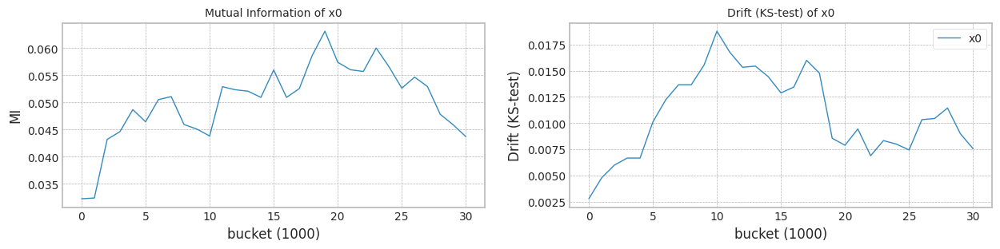

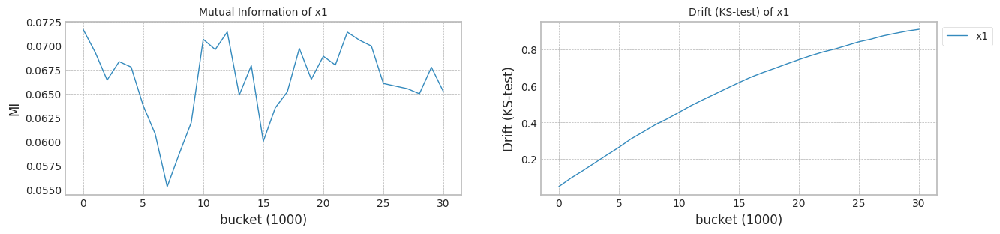

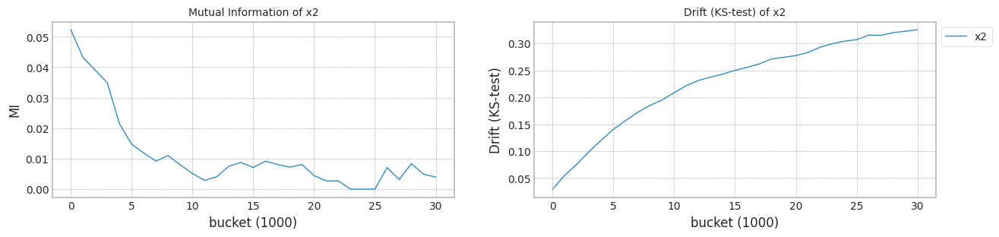

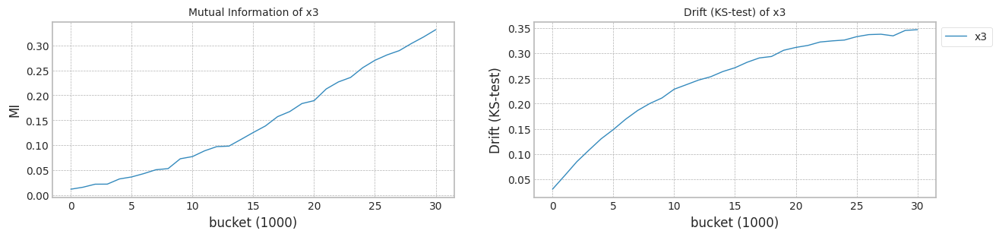

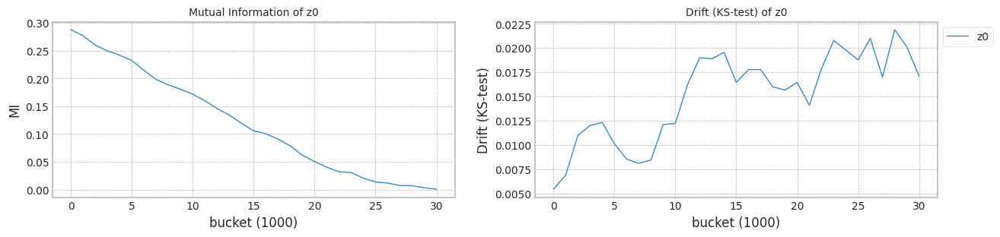

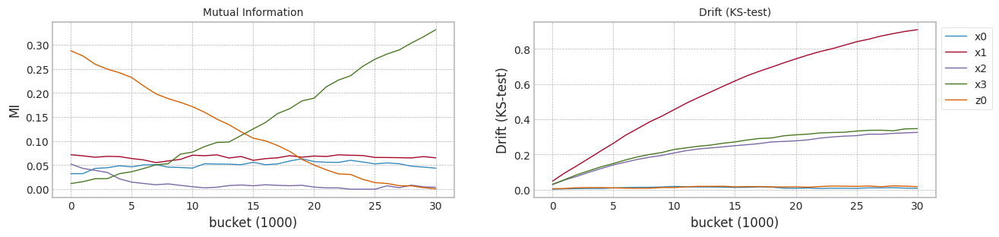

In [166]:
columns=['x0','x1','x2','x3','z0']
X4 = pd.DataFrame(x4,columns=columns)

train_size = 9000
test_size = 1000

X1,Y1 = check_mi_drift(X4, y4,train_size, test_size)

In [167]:
bucket_size = 500
X1['b'] = [int(b/bucket_size) for b in X1.index.values]
X1

,x0,x1,x2,x3,z0,b
0,0.525799,0.324392,0.415368,0.544992,0.366139,0
1,0.610533,0.473190,0.444502,0.555701,0.662926,0
2,0.556874,0.334137,0.509646,0.605806,0.486574,0
3,0.344341,0.450478,0.574312,0.537806,0.611850,0
4,0.503142,0.508093,0.414551,0.515854,0.487044,0
...,...,...,...,...,...,...
39995,0.333622,0.823940,0.110829,0.657291,0.709407,79
39996,0.358451,1.225533,-0.200613,0.366003,0.695384,79
39997,0.559469,1.135604,0.651833,1.326009,0.504288,79
39998,0.433692,1.209585,0.192664,0.802431,0.762158,79


trial_count: 1
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 01:40:53,777] [INFO] [profiler.py:80:start_profile] Flops profiler started


 53%|█████▎    | 1055/2000 [00:02<00:02, 379.18it/s]

Early stop: 1055
[2023-11-30 01:40:56,566] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4134240000
precision_recall_fscore: (array([0.89355969, 0.89903573]), array([0.8612987 , 0.92330097]), array([0.87713265, 0.9110068 ]), array([3850, 5150]))
Test f1 score: 0.9110068014177602
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.26it/s]


mean of drift:
x0    0.010828
x1    0.565957
x2    0.227326
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8268066744997805
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 01:41:02,533] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 01:41:02,535] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


 19%|█▊        | 373/2000 [00:03<00:13, 124.23it/s]

[2023-11-30 01:41:16,601] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 01:41:16,603] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 31500000000 5890500000 1464210000 38854710000
precision_recall_fscore: (array([0.89813059, 0.89922773]), array([0.86103896, 0.92699029]), array([0.87919374, 0.91289798]), array([3850, 5150]))
Test f1 score: 0.9128979825987188
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:06<00:00,  5.09it/s]


mean of drift:
x0    0.176957
x1    0.533878
x2    0.291154
x3    0.207907
z0    0.314477
dtype: float64
Mean F1 for all data: 0.8324601671373157
inference_flops: 609615000
Normal model median        : 0.8268066744997805
Drift tolerant model median: 0.8324601671373157
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 16
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:03<00:03,  5.05it/s]

G-CDTL Train: torch.Size([1000, 6])
[2023-11-30 01:41:25,999] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 01:41:26,002] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-30 01:41:39,659] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-30 01:41:39,660] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 52%|█████▏    | 16/31 [00:16<01:04,  4.31s/it]

G-CDTL train flops: 3500000000 654500000 162690000 4317190000


100%|██████████| 31/31 [00:19<00:00,  1.57it/s]


Early stop at  [373]
Train flops  [4317190000]
Mean of drift:
x0    0.010828
x1    0.565957
x2    0.227326
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8714031799189219
G_CDTL+AUE median: 0.8714031799189219
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:05<00:09,  1.42it/s]

Ensemble_SEA train flops: 528090000


100%|██████████| 31/31 [00:08<00:00,  3.70it/s]


Early stop at  [1213]
Train flops  [528090000]
Mean of drift:
x0    0.010828
x1    0.565957
x2    0.227326
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8458468828554762
SEA median: 0.8458468828554762
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 55%|█████▍    | 17/31 [00:04<00:07,  1.90it/s]

Ensemble_SEA train flops: 355395000


100%|██████████| 31/31 [00:07<00:00,  4.12it/s]


Early stop at  [816]
Train flops  [355395000]
Mean of drift:
x0    0.010828
x1    0.565957
x2    0.227326
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8576994010134287
AUE median: 0.8576994010134287
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set torch.Size([31, 9000, 6])


 48%|████▊     | 15/31 [00:02<00:03,  5.07it/s]

Ensemble_DTEL train flops: 394545000


 55%|█████▍    | 17/31 [00:06<00:12,  1.11it/s]

Ensemble_DTEL train flops: 357135000


100%|██████████| 31/31 [00:09<00:00,  3.32it/s]


Early stop at  [906, 820]
Train flops  [394545000, 357135000]
Mean of drift:
x0    0.010828
x1    0.565957
x2    0.227326
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8625719148216914
DTEL median: 0.8625719148216914


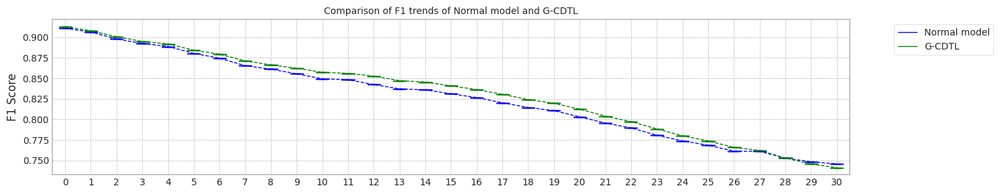

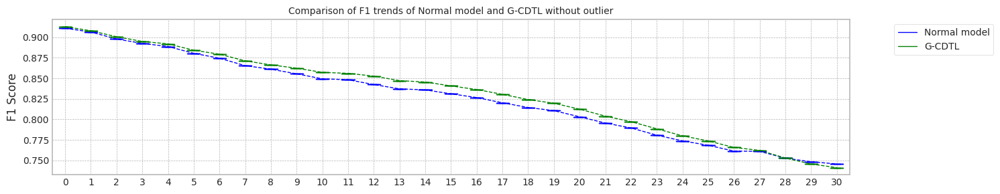

max_mean_trial= 0


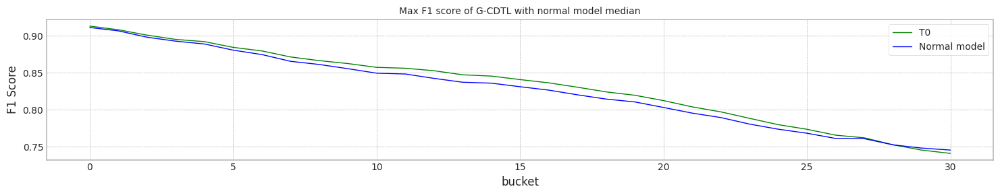

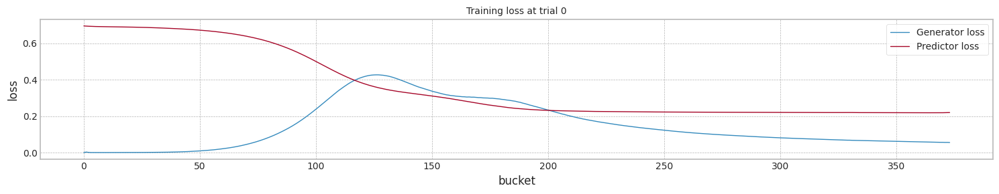

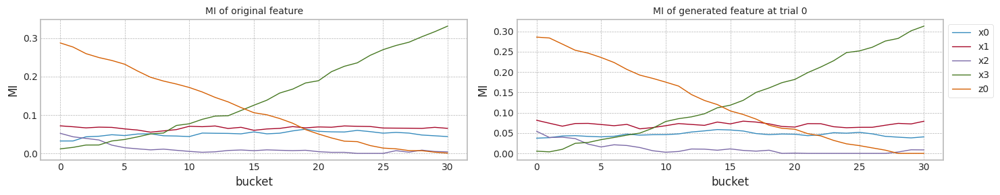

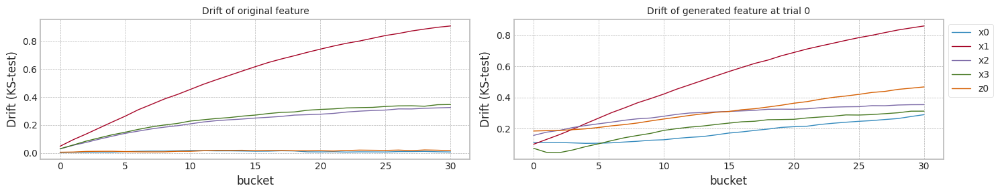

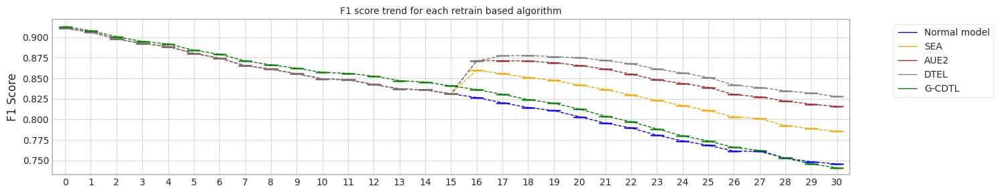

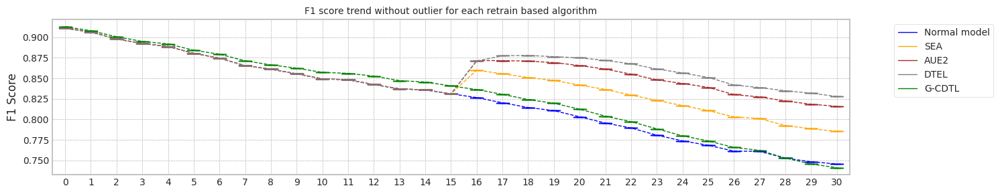

Base elapsed time (inference elapsed time of normal model, median (ms)): 5.946544408798218
Base flops (inference flops of normal model, median): 121365000.0


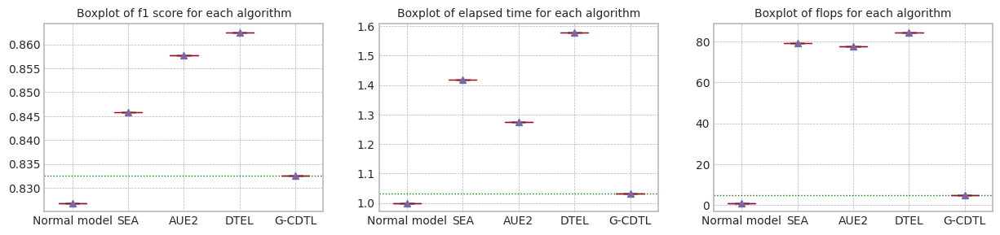

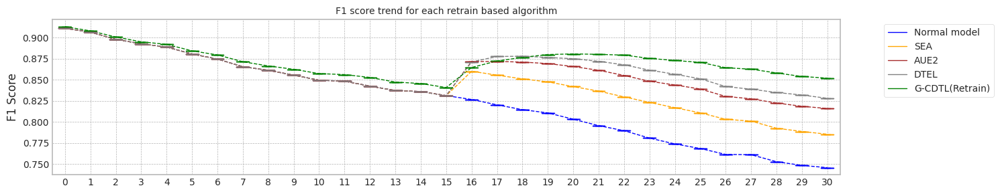

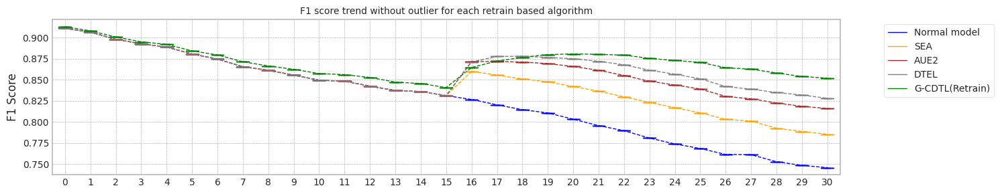

Base elapsed time (inference elapsed time of normal model, median (ms)): 5.946544408798218
Base flops (train + inference flops of normal model, median): 4255605000.0


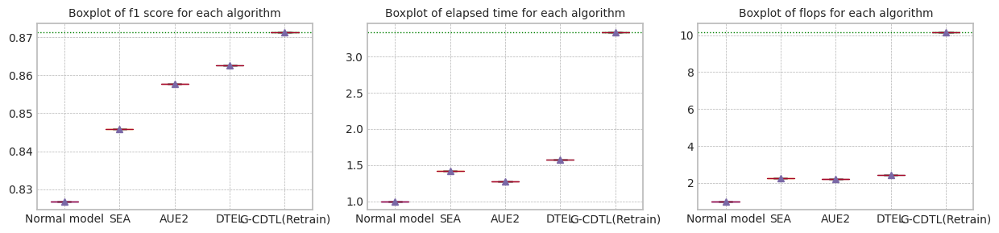

Base elapsed time (inference elapsed time of normal model, median (ms)): 5.946544408798218


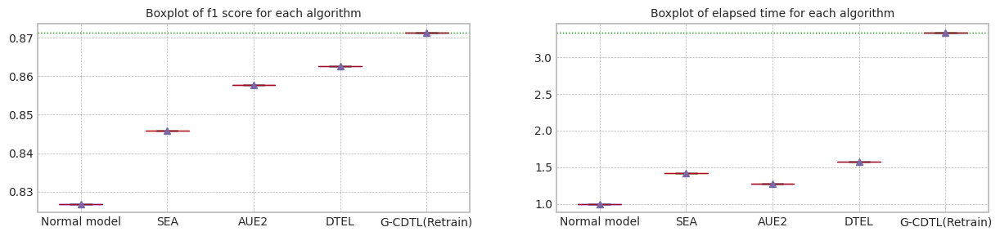

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.911007,0.90642,0.826807,0.745752,5.946544,4.134240e+09,121365000.0,4.255605e+09
1,median,0.911007,0.90642,0.826807,0.745752,5.946544,4.134240e+09,121365000.0,4.255605e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.912898,0.907941,0.83246,0.741267,6.132642,3.885471e+10,609615000.0,3.946432e+10
1,median,0.912898,0.907941,0.83246,0.741267,6.132642,3.885471e+10,609615000.0,3.946432e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.911007,0.90642,0.845847,0.785375,8.440005,4.662330e+09,4.967700e+09,9.630030e+09
1,median,0.911007,0.90642,0.845847,0.785375,8.440005,4.662330e+09,4.967700e+09,9.630030e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.911007,0.90642,0.857699,0.815855,7.582699,4.489635e+09,4.916370e+09,9.406005e+09
1,median,0.911007,0.90642,0.857699,0.815855,7.582699,4.489635e+09,4.916370e+09,9.406005e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.911007,0.90642,0.862572,0.827963,9.389762,4.885920e+09,5.375295e+09,1.026122e+10
1,median,0.911007,0.90642,0.862572,0.827963,9.389762,4.885920e+09,5.375295e+09,1.026122e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.912898,0.907941,0.871403,0.851856,19.847254,4.317190e+10,134325000.0,4.330622e+10
1,median,0.912898,0.907941,0.871403,0.851856,19.847254,4.317190e+10,134325000.0,4.330622e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [168]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'case5',X1, Y1,train_size, test_size,avaible_range = 400,
                                                            lambda_f2=0.9,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

In [ ]:
experiment_all(2000,'case5',X1, Y1,train_size, test_size,avaible_range = 400,
               lambda_f2=0.9,trial_count=5,lr_g=0.002,retrain_count=5,weight_init=True)

trial_count: 5
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-30 01:42:42,228] [INFO] [profiler.py:80:start_profile] Flops profiler started


 53%|█████▎    | 1055/2000 [00:02<00:02, 369.96it/s]

Early stop: 1055
[2023-11-30 01:42:45,088] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 4134240000
precision_recall_fscore: (array([0.89355969, 0.89903573]), array([0.8612987 , 0.92330097]), array([0.87713265, 0.9110068 ]), array([3850, 5150]))
Test f1 score: 0.9110068014177602
X_live.shape (39000, 6)
Truncate 8000 rows from live_set (39000, 6)
Search MI & Drift...for X_live_set (31, 9000, 6)


100%|██████████| 31/31 [00:05<00:00,  5.18it/s]


mean of drift:
x0    0.010828
x1    0.565957
x2    0.227326
x3    0.246330
z0    0.015151
dtype: float64
Mean F1 for all data: 0.8268066744997805
inference_flops: 121365000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([9000, 6])
[2023-11-30 01:42:51,145] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-30 01:42:51,147] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0


# Real-world data 의 실험

In [ ]:
from more_itertools import locate
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler

plt.style.use('bmh')
plt.rcParams['axes.facecolor'] = 'white'

def find_indices(list_to_check, item_to_find):
    indices = locate(list_to_check, lambda x: x == item_to_find)
    return list(indices)

def check_mi_drift(X:pd.DataFrame,Y:np.array,train_size:int,test_size:int,scaling=True):

    columns = X.columns
    is_Has_bucket = False
    # 'b' 즉, bucket count 가 있으며, 'b'를 제외 시킨다.
    if 'b' in columns:
        print('Dataset has buckets!')
        columns = columns[0:-1]
        buckets = list(X['b'])
        X = X[columns]
        is_Has_bucket = True

    mi_scores = make_mi_scores(X, Y, discrete_features="auto")
    #print(mi_scores)
    print(f'MI Analysis MI Max {np.max(mi_scores):.5f}, Min {np.min(mi_scores):.5f}, Mean {np.mean(mi_scores):.5f}, Std {np.std(mi_scores):.5f}')

    if scaling:
        scaler_c1 = MinMaxScaler()
        # trainset을 가지고 Scaler를 fit하고, testset을 포함한 그 이후의 Data를 모두 transform 한다.
        X = pd.DataFrame(np.concatenate((scaler_c1.fit_transform(X[0:train_size]), scaler_c1.transform(X[train_size:])),axis=0), columns=columns)
    else:
        X = pd.DataFrame(np.concatenate((X[0:train_size], X[train_size:]),axis=0), columns=columns)

    X_train = X[:train_size]
    Y_train = Y[:train_size]

    X_test = X[test_size:train_size+test_size]
    Y_test = Y[test_size:train_size+test_size]

    X_live = X[test_size:]
    Y_live = Y[test_size:]

    print('Dataset structure X_train,',X_train.shape,'X_test,',X_test.shape,'X_live',X_live.shape)
    X_live_set = []
    Y_live_set = []
    truncate_count = 0
    if is_Has_bucket:
        b_min = min(buckets[-X_live.shape[0]:])
        b_max = max(buckets[-X_live.shape[0]:])
        print(f'bucket range in live set {b_min}~{b_max}')
        for i in range(b_min,b_max+1):
            s = find_indices(buckets,i)
            if len(s) > 0:
                xl = X.iloc[s]
                yl = Y[s]
                X_live_set.append(xl)
                Y_live_set.append(yl)
    else:
        for i in range(int(X_live.shape[0]/test_size)):
            xl = X_live[i*test_size:i*test_size+train_size]
            yl = Y_live[i*test_size:i*test_size+train_size]

            if len(xl) ==  train_size:
                X_live_set.append(xl)
                Y_live_set.append(yl)
            else:
                #print(xl.shape)
                truncate_count = xl.shape[0] #truncate_count + len(xl)
                break

    print(f'Truncate {truncate_count} rows from live_set {X_live.shape}')
    X_live_set = np.asarray(X_live_set)
    Y_live_set = np.asarray(Y_live_set)

    MIS = {}
    DRF = {}
    for col in columns:
        MIS[col] = []
        DRF[col] = []

    print('Search MI & Drift...for X_live_set',X_live_set.shape)
    for X_live_unit,Y_live_unit in zip(tqdm(X_live_set),Y_live_set):
        X_live_unit = pd.DataFrame(X_live_unit,columns = columns)
        mi_scores = make_mi_scores(X_live_unit, Y_live_unit, discrete_features="auto")
        ks = __ks_drift(X_train.values,X_live_unit.values)
        for ix,col in enumerate(columns):
            MIS[col].append(mi_scores[col])
            DRF[col].append(ks[:,0][ix])

    df_mis = pd.DataFrame(MIS)
    df_drf = pd.DataFrame(DRF)

    for c_name in df_mis.columns:
        fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
        df_mis[c_name].plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
        ax[0].set_title(f'Mutual Information of {c_name}',fontdict={'fontsize':10})

        df_drf[c_name].plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
        ax[1].set_title(f'Drift (KS-test) of {c_name}',fontdict={'fontsize':10})
        ax[1].legend(bbox_to_anchor=(1.0, 1.0))
        plt.show()

    fig, ax = plt.subplots(figsize=main_figsize,nrows=1, ncols=2)
    df_mis.plot(ax=ax[0],linewidth=1,ylabel='MI',xlabel=f'bucket ({test_size})',legend=None)
    ax[0].set_title(f'Mutual Information',fontdict={'fontsize':10})

    df_drf.plot(ax=ax[1],linewidth=1,ylabel='Drift (KS-test)',xlabel=f'bucket ({test_size})')
    ax[1].set_title(f'Drift (KS-test)',fontdict={'fontsize':10})
    ax[1].legend(bbox_to_anchor=(1.0, 1.0))
    plt.show()

    if is_Has_bucket:
        X['b'] = buckets
    return X,Y

## Loan data 실험

### Dataset 준비

#### Data load

In [ ]:

df_accepted = pd.read_csv("/content/drive/MyDrive/Drift/accepted_2007_to_2018Q4.csv")

print(df_accepted.shape)

(2260701, 151)


#### Data 정제

In [ ]:
# for the sake of simplicity, let's consider only Fully Paid and Charged Off values:
df_accepted = df_accepted[df_accepted.loan_status.isin(['Fully Paid', 'Charged Off'])]
print(df_accepted.shape)

cols_to_drop = df_accepted.isnull().sum().sort_values(ascending=False).head(50).index
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# maybe we can go further, and eliminate columns up to title:
cols_to_drop = df_accepted.isnull().sum().sort_values(ascending=False).head(45).index
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# Remaining columns have missing data points, but they account for less than 0.2% of the total data. Let's remove the rows that are missing those values in those columns with dropna():
df_accepted = df_accepted.dropna()
print(df_accepted.shape)

# These are constant columns. We can drop it either.
cols_to_drop = ['out_prncp', 'out_prncp_inv', 'policy_code']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

# It seems we have many "duplicated" information. Let's drop some columns, based on visual inspection at corr_pairs dataframe:
cols_to_drop = ['fico_range_low', 'funded_amnt_inv', 'funded_amnt', 'total_pymnt_inv', 'total_pymnt', 'installment', 'collection_recovery_fee', 'total_rec_prncp', 'last_fico_range_low']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)

values = df_accepted.loan_status.unique()
encode = [1,0]
d = dict(zip(values, encode))
df_accepted['loan_paid'] = df_accepted['loan_status'].map(d)
df_accepted = df_accepted.drop(columns=['loan_status'])

df_accepted

(1345310, 151)
(1345310, 101)
(1345310, 56)
(1341026, 56)
(1341026, 53)
(1341026, 44)


,id,loan_amnt,term,int_rate,grade,sub_grade,home_ownership,annual_inc,verification_status,issue_d,...,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens,hardship_flag,disbursement_method,debt_settlement_flag,loan_paid
0,68407277,3600.0,36 months,13.99,C,C4,MORTGAGE,55000.0,Not Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
1,68355089,24700.0,36 months,11.99,C,C1,MORTGAGE,65000.0,Not Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2,68341763,20000.0,60 months,10.78,B,B4,MORTGAGE,63000.0,Not Verified,Dec-2015,...,Joint App,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
4,68476807,10400.0,60 months,22.45,F,F1,MORTGAGE,104433.0,Source Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
5,68426831,11950.0,36 months,13.44,C,C3,RENT,34000.0,Source Verified,Dec-2015,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2260688,89905081,18000.0,60 months,9.49,B,B2,OWN,130000.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2260690,88948836,29400.0,60 months,13.99,C,C3,MORTGAGE,180792.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,1
2260691,89996426,32000.0,60 months,14.49,C,C4,MORTGAGE,157000.0,Source Verified,Oct-2016,...,Individual,0.0,0.0,0.0,0.0,0.0,N,Cash,N,0
2260692,90006534,16000.0,60 months,12.79,C,C1,RENT,150000.0,Not Verified,Oct-2016,...,Individual,0.0,0.0,0.0,3.0,0.0,N,Cash,N,1


In [ ]:
# droping constant columns
print(df_accepted.pymnt_plan.value_counts())
print(df_accepted.hardship_flag.value_counts())
cols_to_drop = ['id', 'pymnt_plan', 'hardship_flag']
df_accepted = df_accepted.drop(columns=cols_to_drop)
print(df_accepted.shape)
cat_cols = df_accepted.select_dtypes(include=['object']).columns
print(cat_cols)

print(df_accepted.term.value_counts())

# convert term into either a 36 or 60 integer numeric data type

l1 = df_accepted.term.unique()
l2 = [36, 60]
d = dict(zip(l1, l2))

df_accepted['term'] = df_accepted['term'].map(d)

# as grade is part of sub_grade, so let's just drop the grade feature.

df_accepted = df_accepted.drop(columns='grade')

df_accepted = pd.get_dummies(df_accepted, columns = ['sub_grade'], prefix='', prefix_sep='', drop_first=True)

cat_cols = df_accepted.select_dtypes(include=['object']).columns
print(cat_cols)

# for these columns, let's just create dummy variables, concatenate them with the original dataframe and drop original columns.

df_accepted = pd.get_dummies(df_accepted, columns = ['verification_status'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['application_type'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['initial_list_status'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['purpose'], prefix='', prefix_sep='', drop_first=True)
print(df_accepted.shape)

df_accepted['home_ownership'] = df_accepted.home_ownership.replace('NONE', 'ANY')
df_accepted = pd.get_dummies(df_accepted, columns = ['home_ownership'], prefix='', prefix_sep='', drop_first=True)
df_accepted = df_accepted.drop(columns=[ 'url', 'last_pymnt_d', 'last_credit_pull_d'])
df_accepted = df_accepted.drop(columns=['zip_code', 'addr_state'])
df_accepted = pd.get_dummies(df_accepted, columns = ['disbursement_method'], prefix='', prefix_sep='', drop_first=True)
df_accepted = pd.get_dummies(df_accepted, columns = ['debt_settlement_flag'], prefix='', prefix_sep='', drop_first=True)
df_accepted = df_accepted.drop(columns=['earliest_cr_line'])
print(df_accepted.shape)


df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jan','01')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Feb','02')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Mar','03')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Apr','04')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('May','05')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jun','06')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Jul','07')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Aug','08')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Sep','09')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Oct','10')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Dec','11')
df_accepted['issue_d'] = df_accepted['issue_d'].str.replace('Nov','12')

def reorder_issue_d(dt):
    a = dt.split('-')
    return a[1]+a[0]

reorder_issue_d('01-2009')

df_accepted['issue_d'] = df_accepted['issue_d'].apply(reorder_issue_d)
df_accepted = df_accepted.sort_values(by='issue_d')
df_accepted.reset_index(drop=True, inplace=True)

df_accepted.info()

n    1341026
Name: pymnt_plan, dtype: int64
N    1341026
Name: hardship_flag, dtype: int64
(1341026, 41)
Index(['term', 'grade', 'sub_grade', 'home_ownership', 'verification_status',
       'issue_d', 'url', 'purpose', 'zip_code', 'addr_state',
       'earliest_cr_line', 'initial_list_status', 'last_pymnt_d',
       'last_credit_pull_d', 'application_type', 'disbursement_method',
       'debt_settlement_flag'],
      dtype='object')
 36 months    1017398
 60 months     323628
Name: term, dtype: int64
Index(['home_ownership', 'verification_status', 'issue_d', 'url', 'purpose',
       'zip_code', 'addr_state', 'earliest_cr_line', 'initial_list_status',
       'last_pymnt_d', 'last_credit_pull_d', 'application_type',
       'disbursement_method', 'debt_settlement_flag'],
      dtype='object')
(1341026, 86)
(1341026, 83)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1341026 entries, 0 to 1341025
Data columns (total 83 columns):
 #   Column                      Non-Null Count    Dtype  

#### Dataset 만들기

In [ ]:
X = {}
Y = {}

df = df_accepted[df_accepted['issue_d'].str.startswith('2007') + df_accepted['issue_d'].str.startswith('2008') + df_accepted['issue_d'].str.startswith('2009')].copy()
df = df.drop(columns=['issue_d'])


X[2009] = df.loc[:, df.columns != 'loan_paid'].values
Y[2009] = df.loan_paid.values


for year in range(2010,2019):
    print(year)
    df = df_accepted[df_accepted['issue_d'].str.startswith(str(year))].copy()
    df = df.drop(columns=['issue_d'])
    X[year] = df.loc[:, df.columns != 'loan_paid'].values
    Y[year] = df.loan_paid.values

2010
2011
2012
2013
2014
2015
2016
2017
2018


In [ ]:

X[2010].shape

(11497, 81)

In [ ]:
COLUMNS = df.loc[:, df.columns != 'loan_paid'].columns
COLUMNS

Index(['loan_amnt', 'term', 'int_rate', 'annual_inc', 'dti', 'delinq_2yrs',
       'fico_range_high', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'last_pymnt_amnt', 'last_fico_range_high',
       'collections_12_mths_ex_med', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5', 'C1',
       'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2', 'E3',
       'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3', 'G4', 'G5',
       'Source Verified', 'Verified', 'Joint App', 'w', 'credit_card',
       'debt_consolidation', 'educational', 'home_improvement', 'house',
       'major_purchase', 'medical', 'moving', 'other', 'renewable_energy',
       'small_business', 'vacation', 'wedding', 'MORTGAGE', 'OTHER', 'OWN',
       'RENT', 'DirectPay', 'Y'],
      dtype

In [ ]:
seed_everything(12)

X_df = pd.DataFrame(X[2010],columns=COLUMNS)
mi_scores = make_mi_scores(X_df, Y[2010], discrete_features="auto")
print(mi_scores)

recoveries                  0.375327
last_fico_range_high        0.090427
last_pymnt_amnt             0.085496
total_rec_late_fee          0.038954
int_rate                    0.016850
                              ...   
F2                          0.000000
chargeoff_within_12_mths    0.000000
G1                          0.000000
G3                          0.000000
D3                          0.000000
Name: MI Scores, Length: 81, dtype: float64


In [ ]:
# MI Top 5, columns
top_columns = list(mi_scores[1:6].index)
top_columns

['last_fico_range_high',
 'last_pymnt_amnt',
 'total_rec_late_fee',
 'int_rate',
 'term']

### #1 고정 size로 bucket 만들기

In [ ]:
# 1/10 로 사이즈 줄이기...
seed_everything()

X2 = np.concatenate((X[2010],X[2011],X[2012],X[2013],X[2014],X[2015],X[2016],X[2017]))
Y2 = np.concatenate((Y[2010],Y[2011],Y[2012],Y[2013],Y[2014],Y[2015],Y[2016],Y[2017]))
s = np.sort(np.random.choice(X2.shape[0],int(X2.shape[0]/10),replace= False))
#print(s.shape)
X3 = pd.DataFrame(X2[s],columns=COLUMNS)
Y3 = Y2[s]

##### do

columns: ['last_pymnt_amnt', 'total_rec_late_fee', 'inq_last_6mths', 'total_rec_int', 'Y']
MI Analysis MI Max 0.27267, Min 0.00456, Mean 0.07066, Std 0.10189
Dataset structure X_train, (20000, 5) X_test, (20000, 5) X_live (123968, 5)
Truncate 19968 rows from live_set (123968, 5)
Search MI & Drift...for X_live_set (26, 20000, 5)


100%|██████████| 26/26 [00:11<00:00,  2.26it/s]


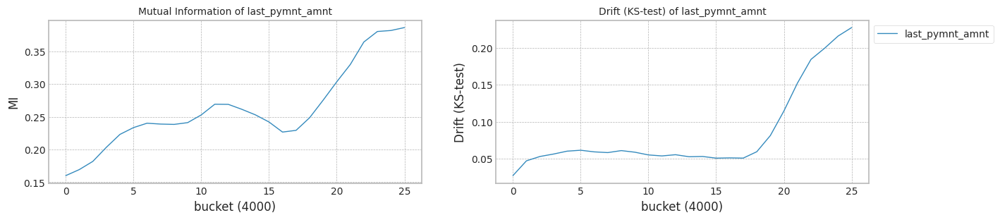

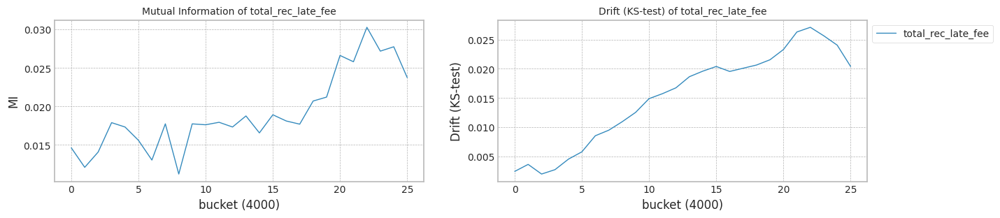

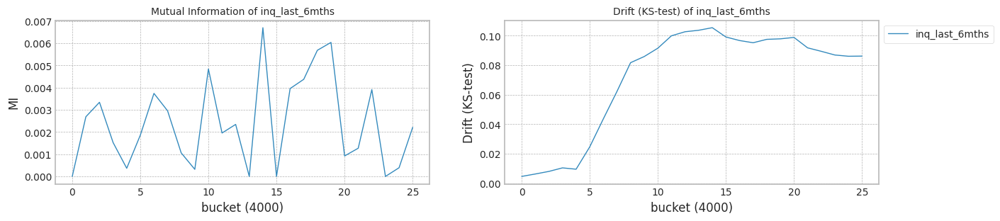

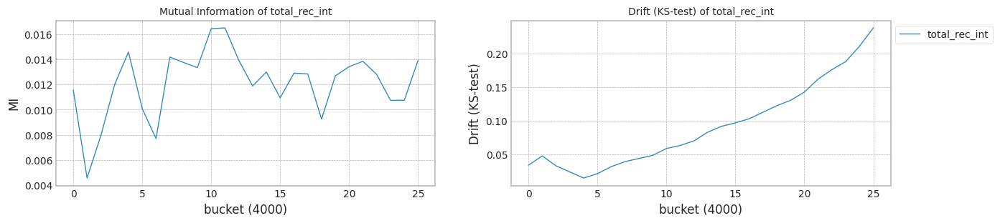

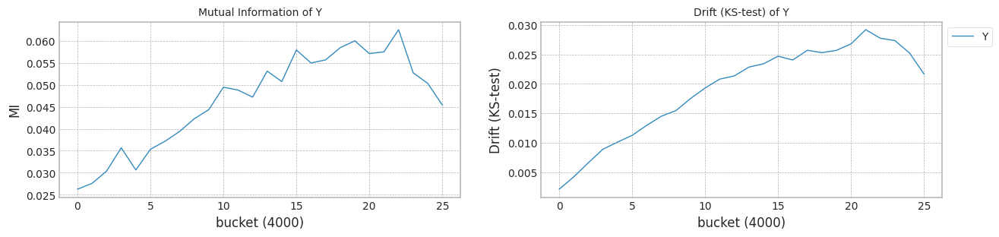

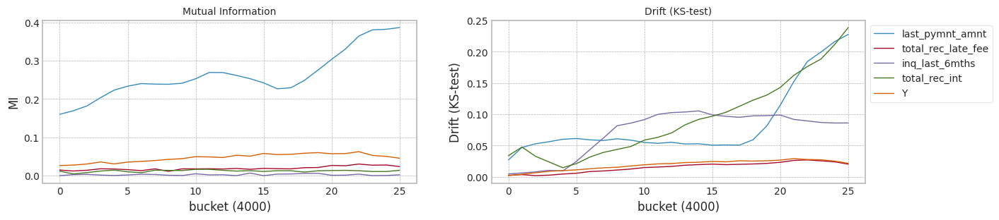

In [ ]:
seed_everything()

#s = np.sort(np.random.choice(len(COLUMNS),2,replace= False))
top_columns = list(mi_scores[0:15].index)
top_columns = ['last_pymnt_amnt', 'total_rec_late_fee', 'inq_last_6mths', 'total_rec_int', 'Y']
print('columns:',top_columns)
#print(s.shape)
X4 = X3[top_columns]

train_size = 10000*2
test_size = 2000*2

X1,Y1 = check_mi_drift(X4, Y3, train_size, test_size)

bucket_size = 500*2
X1['b'] = [int(b/bucket_size) for b in X1.index.values]

In [ ]:
bucket_size = 1000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]

trial_count: 1
Lambda :  0.9
######################### Retrain 1 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 13:15:52,341] [INFO] [profiler.py:80:start_profile] Flops profiler started


 40%|████      | 808/2000 [00:04<00:06, 180.64it/s]

Early stop: 808
[2023-11-27 13:15:56,821] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7038300000
precision_recall_fscore: (array([0.75324675, 0.85296967]), array([0.09136736, 0.99435398]), array([0.16296713, 0.91825142]), array([ 3174, 16826]))
Test f1 score: 0.9182514201037292
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.19it/s]

mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9013939150966132
inference_flops: 226200000
######################### Retrain 1 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([20000, 6])
[2023-11-27 13:16:08,751] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:16:08,753] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 31%|███       | 617/2000 [00:04<00:09, 147.10it/s]

[2023-11-27 13:16:15,664] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:16:15,666] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 20580000000 21630000000 5376600000 47586600000
precision_recall_fscore: (array([0.73384615, 0.86062016]), array([0.15028355, 0.98971829]), array([0.24947699, 0.92066563]), array([ 3174, 16826]))
Test f1 score: 0.9206656346749227
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (26, 20000, 6)


100%|██████████| 26/26 [00:11<00:00,  2.26it/s]


mean of drift:
last_pymnt_amnt       0.462000
total_rec_late_fee    0.889998
inq_last_6mths        0.540313
total_rec_int         0.561587
Y                     0.929040
dtype: float64
Mean F1 for all data: 0.9027406999703776
inference_flops: 1136200000
Normal model median        : 0.9013939150966132
Drift tolerant model median: 0.9027406999703776
######################### Retrain 1 Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Retrain 1 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 50%|█████     | 13/26 [00:05<00:06,  2.16it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:16:33,697] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:16:33,700] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:16:44,012] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:16:44,014] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 54%|█████▍    | 14/26 [00:16<00:42,  3.57s/it]

G-CDTL train flops: 11228000000 4298000000 1068360000 16594360000


100%|██████████| 26/26 [00:22<00:00,  1.16it/s]


Early stop at  [613]
Train flops  [16594360000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9126608998962714
G_CDTL+AUE median: 0.9126608998962714
######################### Retrain 1 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:12,  1.01s/it]

Ensemble_SEA train flops: 2152380000


100%|██████████| 26/26 [00:13<00:00,  1.89it/s]


Early stop at  [1236]
Train flops  [2152380000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9017504256009694
SEA median: 0.9017504256009694
######################### Retrain 1 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.23s/it]

Ensemble_SEA train flops: 3020640000


100%|██████████| 26/26 [00:14<00:00,  1.79it/s]


Early stop at  [1735]
Train flops  [3020640000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9020292166109656
AUE median: 0.9020292166109656
######################### Retrain 1 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


 54%|█████▍    | 14/26 [00:08<00:14,  1.20s/it]

Ensemble_DTEL train flops: 2949300000
Ensemble_DTEL train flops: 8700000


100%|██████████| 26/26 [00:14<00:00,  1.80it/s]


Early stop at  [1694, 4]
Train flops  [2949300000, 8700000]
Mean of drift:
last_pymnt_amnt       0.084537
total_rec_late_fee    0.021850
inq_last_6mths        0.210100
total_rec_int         0.091921
Y                     0.019027
dtype: float64
Mean F1 for all data: 0.9004837430281006
DTEL median: 0.9004837430281006


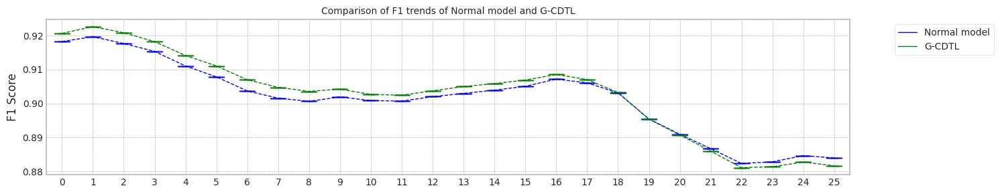

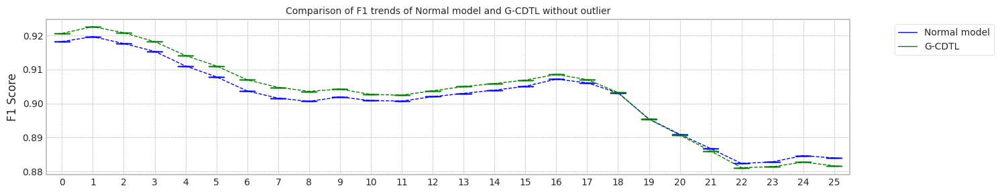

max_mean_trial= 0


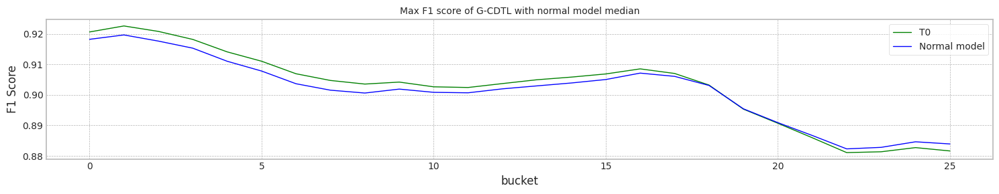

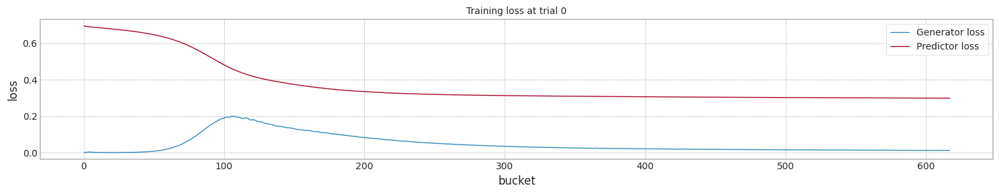

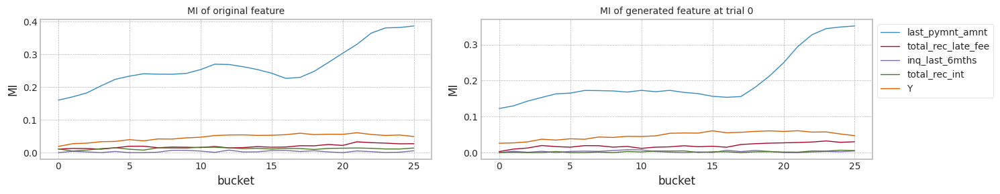

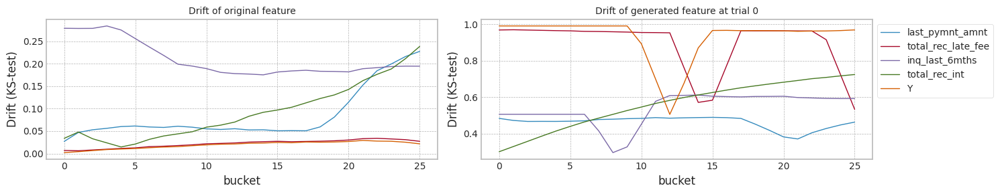

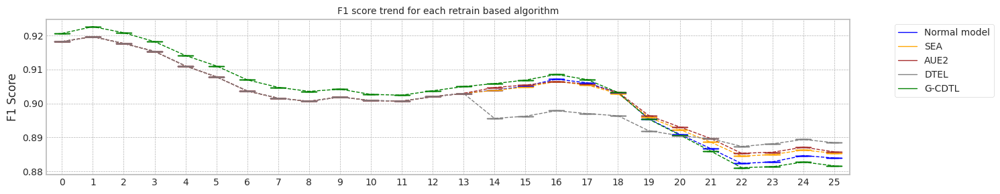

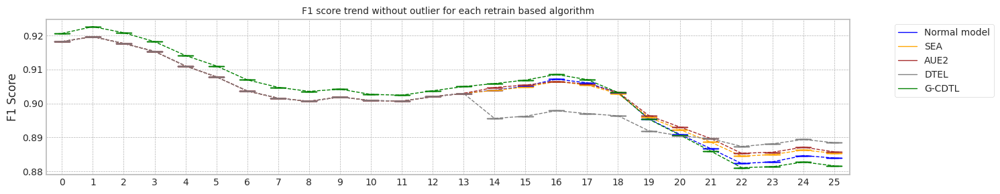

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.908618211746216
Base flops (inference flops of normal model, median): 226200000.0


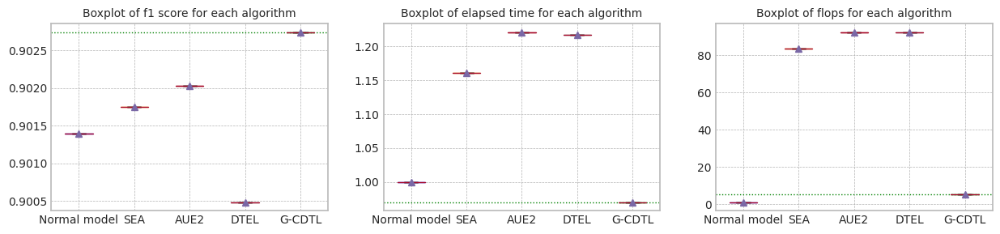

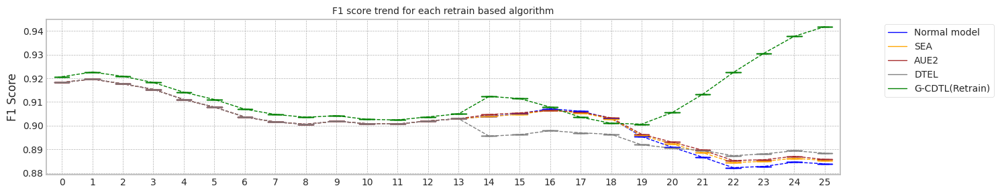

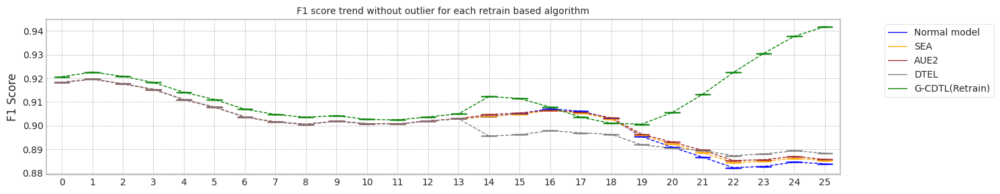

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.908618211746216
Base flops (train + inference flops of normal model, median): 7264500000.0


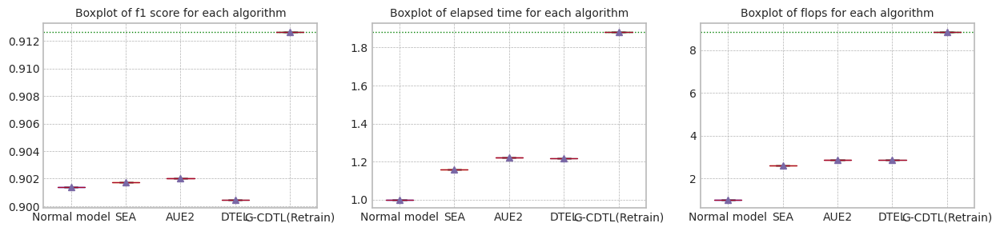

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.908618211746216


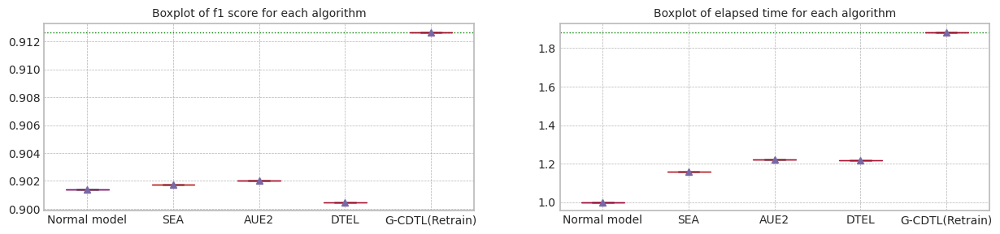

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.901394,0.883918,11.908618,7.038300e+09,226200000.0,7.264500e+09
1,median,0.918251,0.919688,0.901394,0.883918,11.908618,7.038300e+09,226200000.0,7.264500e+09
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920666,0.922638,0.902741,0.88162,11.553947,4.758660e+10,1.136200e+09,4.872280e+10
1,median,0.920666,0.922638,0.902741,0.88162,11.553947,4.758660e+10,1.136200e+09,4.872280e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.90175,0.885321,13.815026,9.190680e+09,9.756180e+09,1.894686e+10
1,median,0.918251,0.919688,0.90175,0.885321,13.815026,9.190680e+09,9.756180e+09,1.894686e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.902029,0.885747,14.536184,1.005894e+10,1.085064e+10,2.090958e+10
1,median,0.918251,0.919688,0.902029,0.885747,14.536184,1.005894e+10,1.085064e+10,2.090958e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918251,0.919688,0.900484,0.888422,14.482605,9.996300e+09,1.090980e+10,2.090610e+10
1,median,0.918251,0.919688,0.900484,0.888422,14.482605,9.996300e+09,1.090980e+10,2.090610e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920666,0.922638,0.912661,0.941794,22.427958,6.418096e+10,238800000.0,6.441976e+10
1,median,0.920666,0.922638,0.912661,0.941794,22.427958,6.418096e+10,238800000.0,6.441976e+10
2,std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'LC_A',X1, Y1,train_size, test_size,avaible_range = 1000,
                                                            lambda_f2=0.9,trial_count=1,lr_g=0.002,
                                                            retrain_count=1,weight_init=True)

trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 824.19it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867796026890064
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 232.23it/s]


precision_recall_fscore: (array([1.        , 0.88791557]), array([0.33081285, 1.        ]), array([0.49715909, 0.94063059]), array([ 3174, 16826]))
Test f1 score: 0.9406305903398926
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.05it/s]


mean of drift:
recoveries              0.841225
last_fico_range_high    0.347154
last_pymnt_amnt         0.490915
total_rec_late_fee      0.920042
int_rate                0.152225
dtype: float64
Mean F1 for all data: 0.9206478624704398
Normal model median        : 0.8867796026890064
Drift tolerant model median: 0.9206478624704398
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 796.94it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868058824094563
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 235.70it/s]


precision_recall_fscore: (array([1.        , 0.90185989]), array([0.42312539, 1.        ]), array([0.59464246, 0.94839782]), array([ 3174, 16826]))
Test f1 score: 0.9483978243102331
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.856183
last_fico_range_high    0.445502
last_pymnt_amnt         0.347467
total_rec_late_fee      0.966137
int_rate                0.123500
dtype: float64
Mean F1 for all data: 0.9090284719288496
Normal model median        : 0.8867927425492313
Drift tolerant model median: 0.9148381671996447
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 848.58it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867807649556808
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.61it/s]


precision_recall_fscore: (array([1.        , 0.85281298]), array([0.08506616, 1.        ]), array([0.15679443, 0.92056024]), array([ 3174, 16826]))
Test f1 score: 0.9205602363497101
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.825440
last_fico_range_high    0.198187
last_pymnt_amnt         0.523052
total_rec_late_fee      0.967523
int_rate                0.553154
dtype: float64
Mean F1 for all data: 0.8903642163170178
Normal model median        : 0.8867807649556808
Drift tolerant model median: 0.9090284719288496
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 804.77it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867861910860791
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 232.04it/s]


precision_recall_fscore: (array([1.        , 0.86996536]), array([0.20762445, 1.        ]), array([0.34385599, 0.93046147]), array([ 3174, 16826]))
Test f1 score: 0.9304614704011945
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.835263
last_fico_range_high    0.313650
last_pymnt_amnt         0.492958
total_rec_late_fee      0.867046
int_rate                0.269581
dtype: float64
Mean F1 for all data: 0.90326029739122
Normal model median        : 0.88678347802088
Drift tolerant model median: 0.9061443846600348
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 796.60it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.06it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.886784854031226
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.87it/s]


precision_recall_fscore: (array([1.        , 0.87859642]), array([0.26748582, 1.        ]), array([0.42207308, 0.93537538]), array([ 3174, 16826]))
Test f1 score: 0.9353753787141785
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.861004
last_fico_range_high    0.344687
last_pymnt_amnt         0.527025
total_rec_late_fee      0.966488
int_rate                0.240369
dtype: float64
Mean F1 for all data: 0.91758194578029
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9090284719288496
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 820.73it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.05it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867861910860791
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.23it/s]


precision_recall_fscore: (array([1.        , 0.86799071]), array([0.19376181, 1.        ]), array([0.32462391, 0.92933087]), array([ 3174, 16826]))
Test f1 score: 0.9293308663113419
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.857058
last_fico_range_high    0.259265
last_pymnt_amnt         0.374685
total_rec_late_fee      0.936950
int_rate                0.392975
dtype: float64
Mean F1 for all data: 0.9402007124154911
Normal model median        : 0.8867855225586525
Drift tolerant model median: 0.9133052088545698
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 806.51it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.01it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867786117691027
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.01it/s]


precision_recall_fscore: (array([1.        , 0.87868818]), array([0.26811594, 1.        ]), array([0.42285714, 0.93542738]), array([ 3174, 16826]))
Test f1 score: 0.9354273801250869
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.846146
last_fico_range_high    0.371567
last_pymnt_amnt         0.484277
total_rec_late_fee      0.954515
int_rate                0.199246
dtype: float64
Mean F1 for all data: 0.9032010310670172
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9090284719288496
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 785.87it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.03it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868011438966228
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 231.14it/s]


precision_recall_fscore: (array([1.        , 0.89906492]), array([0.40485192, 1.        ]), array([0.57636241, 0.94685012]), array([ 3174, 16826]))
Test f1 score: 0.9468501167665513
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.09it/s]


mean of drift:
recoveries              0.853127
last_fico_range_high    0.446237
last_pymnt_amnt         0.451069
total_rec_late_fee      0.852865
int_rate                0.185412
dtype: float64
Mean F1 for all data: 0.9239163190162529
Normal model median        : 0.8867855225586525
Drift tolerant model median: 0.9133052088545698
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 771.51it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.04it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867895997648609
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.53it/s]


precision_recall_fscore: (array([1.        , 0.85974145]), array([0.13516068, 1.        ]), array([0.23813489, 0.9245817 ]), array([ 3174, 16826]))
Test f1 score: 0.9245816962936505
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.845519
last_fico_range_high    0.264865
last_pymnt_amnt         0.455987
total_rec_late_fee      0.968412
int_rate                0.269888
dtype: float64
Mean F1 for all data: 0.891313259395962
Normal model median        : 0.8867861910860791
Drift tolerant model median: 0.9090284719288496
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 744.56it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.01it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867754020036018
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 226.37it/s]


precision_recall_fscore: (array([1.       , 0.9376428]), array([0.64744802, 1.        ]), array([0.78600115, 0.96781801]), array([ 3174, 16826]))
Test f1 score: 0.9678180092605908
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.861237
last_fico_range_high    0.347075
last_pymnt_amnt         0.489787
total_rec_late_fee      0.953802
int_rate                0.109481
dtype: float64
Mean F1 for all data: 0.9540626754464031
Normal model median        : 0.8867855225586525
Drift tolerant model median: 0.9133052088545698
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 783.03it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.04it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867786726059038
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 228.78it/s]


precision_recall_fscore: (array([1.        , 0.86495656]), array([0.17233774, 1.        ]), array([0.29400699, 0.92758896]), array([ 3174, 16826]))
Test f1 score: 0.9275889633121089
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.831679
last_fico_range_high    0.184571
last_pymnt_amnt         0.504933
total_rec_late_fee      0.921235
int_rate                0.492740
dtype: float64
Mean F1 for all data: 0.8999985523090415
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9090284719288496
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 772.05it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.04it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867834016373002
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 233.95it/s]


precision_recall_fscore: (array([1.        , 0.88875977]), array([0.33648393, 1.        ]), array([0.50353607, 0.94110409]), array([ 3174, 16826]))
Test f1 score: 0.941104088595559
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.843748
last_fico_range_high    0.328108
last_pymnt_amnt         0.526538
total_rec_late_fee      0.923485
int_rate                0.367077
dtype: float64
Mean F1 for all data: 0.9433048343591127
Normal model median        : 0.8867841278342631
Drift tolerant model median: 0.9133052088545698
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 817.25it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.88677671444041
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 235.16it/s]


precision_recall_fscore: (array([1.        , 0.91905178]), array([0.53308129, 1.        ]), array([0.69543773, 0.95781864]), array([ 3174, 16826]))
Test f1 score: 0.9578186372175101
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.849660
last_fico_range_high    0.390948
last_pymnt_amnt         0.504362
total_rec_late_fee      0.954475
int_rate                0.315600
dtype: float64
Mean F1 for all data: 0.9362629554733252
Normal model median        : 0.8867834016373002
Drift tolerant model median: 0.91758194578029
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 773.71it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867855442132868
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.17it/s]


precision_recall_fscore: (array([1.        , 0.90642676]), array([0.45274102, 1.        ]), array([0.62329213, 0.95091695]), array([ 3174, 16826]))
Test f1 score: 0.9509169515951283
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.861277
last_fico_range_high    0.374588
last_pymnt_amnt         0.508663
total_rec_late_fee      0.898817
int_rate                0.143008
dtype: float64
Mean F1 for all data: 0.9505253248563446
Normal model median        : 0.8867841278342631
Drift tolerant model median: 0.9191149041253649
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 790.69it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.06it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867861910860791
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 235.04it/s]


precision_recall_fscore: (array([1.        , 0.93105356]), array([0.60743541, 1.        ]), array([0.75578205, 0.96429595]), array([ 3174, 16826]))
Test f1 score: 0.9642959481918734
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.11it/s]


mean of drift:
recoveries              0.858067
last_fico_range_high    0.314831
last_pymnt_amnt         0.346844
total_rec_late_fee      0.972694
int_rate                0.346935
dtype: float64
Mean F1 for all data: 0.933827250504141
Normal model median        : 0.886784854031226
Drift tolerant model median: 0.9206478624704398
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 785.50it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.07it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868071041269603
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.01it/s]


precision_recall_fscore: (array([1.        , 0.91035005]), array([0.47794581, 1.        ]), array([0.64677041, 0.95307145]), array([ 3174, 16826]))
Test f1 score: 0.9530714548698632
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.861123
last_fico_range_high    0.341837
last_pymnt_amnt         0.519623
total_rec_late_fee      0.895123
int_rate                0.341340
dtype: float64
Mean F1 for all data: 0.9512326632848241
Normal model median        : 0.8867851991222564
Drift tolerant model median: 0.9222820907433464
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 803.96it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.06it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867902729342192
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 236.58it/s]


precision_recall_fscore: (array([1.        , 0.86951579]), array([0.20447385, 1.        ]), array([0.33952393, 0.93020427]), array([ 3174, 16826]))
Test f1 score: 0.930204273433397
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.861123
last_fico_range_high    0.254379
last_pymnt_amnt         0.472546
total_rec_late_fee      0.977633
int_rate                0.249965
dtype: float64
Mean F1 for all data: 0.8952638618057308
Normal model median        : 0.8867855442132868
Drift tolerant model median: 0.9206478624704398
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 810.48it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867881500305259
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.09it/s]


precision_recall_fscore: (array([1.        , 0.86996536]), array([0.20762445, 1.        ]), array([0.34385599, 0.93046147]), array([ 3174, 16826]))
Test f1 score: 0.9304614704011945
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.12it/s]


mean of drift:
recoveries              0.841308
last_fico_range_high    0.328954
last_pymnt_amnt         0.470383
total_rec_late_fee      0.953802
int_rate                0.222977
dtype: float64
Mean F1 for all data: 0.9014639785678307
Normal model median        : 0.8867858676496829
Drift tolerant model median: 0.9191149041253649
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 793.03it/s]


precision_recall_fscore: (array([0.    , 0.8413]), array([0., 1.]), array([0.        , 0.91381089]), array([ 3174, 16826]))
Test f1 score: 0.9138108944767285
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.08it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867807649556808
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 238.94it/s]


precision_recall_fscore: (array([0.99908341, 0.88978793]), array([0.34341525, 0.99994057]), array([0.51113716, 0.94165384]), array([ 3174, 16826]))
Test f1 score: 0.941653840772352
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.848004
last_fico_range_high    0.354413
last_pymnt_amnt         0.518235
total_rec_late_fee      0.968510
int_rate                0.175631
dtype: float64
Mean F1 for all data: 0.9313877960433784
Normal model median        : 0.8867855442132868
Drift tolerant model median: 0.9206478624704398
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 791.69it/s]


precision_recall_fscore: (array([0.        , 0.84129206]), array([0.        , 0.99994057]), array([0.       , 0.9137814]), array([ 3174, 16826]))
Test f1 score: 0.9137813985064493
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.10it/s]


mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8867786117691027
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.96it/s]


precision_recall_fscore: (array([1.        , 0.90074946]), array([0.41587902, 1.        ]), array([0.58744993, 0.94778347]), array([ 3174, 16826]))
Test f1 score: 0.9477834732157945
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.850475
last_fico_range_high    0.372606
last_pymnt_amnt         0.519292
total_rec_late_fee      0.864425
int_rate                0.192704
dtype: float64
Mean F1 for all data: 0.9480642645723194
Normal model median        : 0.8867851991222564
Drift tolerant model median: 0.9222820907433464
######################### Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8877796775359938
SEA median: 0.8877796775359938
######################### Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869213340489015
AUE median: 0.8869213340489015
######################### Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.901544511287731
DTEL median: 0.901544511287731
######################### Trial 1 for Normal model ###########################
retrain_interval: 14
######################### Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8881917954573137
SEA median: 0.8879857364966538
######################### Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870343322136438
AUE median: 0.8869778331312727
######################### Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9018391545486701
DTEL median: 0.9016918329182007
######################### Trial 2 for Normal model ###########################
retrain_interval: 14
######################### Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8878394447878842
SEA median: 0.8878394447878842
######################### Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.58it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869208801364654
AUE median: 0.8869213340489015
######################### Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.31it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9020620457071234
DTEL median: 0.9018391545486701
######################### Trial 3 for Normal model ###########################
retrain_interval: 14
######################### Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8882072955006675
SEA median: 0.888015620122599
######################### Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.58it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870027248186564
AUE median: 0.886962029433779
######################### Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.31it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9030431432797903
DTEL median: 0.9019506001278967
######################### Trial 4 for Normal model ###########################
retrain_interval: 14
######################### Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8876683111928477
SEA median: 0.8878394447878842
######################### Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870555672593636
AUE median: 0.8870027248186564
######################### Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9014747738599213
DTEL median: 0.9018391545486701
######################### Trial 5 for Normal model ###########################
retrain_interval: 14
######################### Trial 5 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.888502232650745
SEA median: 0.888015620122599
######################### Trial 5 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870071823755408
AUE median: 0.8870049535970985
######################### Trial 5 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9024883878250023
DTEL median: 0.9019506001278967
######################### Trial 6 for Normal model ###########################
retrain_interval: 14
######################### Trial 6 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8877792410318618
SEA median: 0.8878394447878842
######################### Trial 6 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868823148335099
AUE median: 0.8870027248186564
######################### Trial 6 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.902749341023045
DTEL median: 0.9020620457071234
######################### Trial 7 for Normal model ###########################
retrain_interval: 14
######################### Trial 7 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8886379505800316
SEA median: 0.888015620122599
######################### Trial 7 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870528049811727
AUE median: 0.8870049535970985
######################### Trial 7 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9019069707902982
DTEL median: 0.9019845082487108
######################### Trial 8 for Normal model ###########################
retrain_interval: 14
######################### Trial 8 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8876393063630398
SEA median: 0.8878394447878842
######################### Trial 8 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869269843509049
AUE median: 0.8870027248186564
######################### Trial 8 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.31it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9016969558221182
DTEL median: 0.9019069707902982
######################### Trial 9 for Normal model ###########################
retrain_interval: 14
######################### Trial 9 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.59it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8876242295719875
SEA median: 0.887809561161939
######################### Trial 9 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.60it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869311190991772
AUE median: 0.8869669219589168
######################### Trial 9 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9020445484999328
DTEL median: 0.9019757596451154
######################### Trial 10 for Normal model ###########################
retrain_interval: 14
######################### Trial 10 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.887727224074966
SEA median: 0.8877796775359938
######################### Trial 10 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869557244762414
AUE median: 0.8869557244762414
######################### Trial 10 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9019731893613425
DTEL median: 0.9019731893613425
######################### Trial 11 for Normal model ###########################
retrain_interval: 14
######################### Trial 11 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8879719528310519
SEA median: 0.887809561161939
######################### Trial 11 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870113894214848
AUE median: 0.8869792246474488
######################### Trial 11 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9007546433853827
DTEL median: 0.9019400800758204
######################### Trial 12 for Normal model ###########################
retrain_interval: 14
######################### Trial 12 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8878306261020655
SEA median: 0.8878306261020655
######################### Trial 12 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869386963286101
AUE median: 0.8869557244762414
######################### Trial 12 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9015808712265615
DTEL median: 0.9019069707902982
######################### Trial 13 for Normal model ###########################
retrain_interval: 14
######################### Trial 13 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8886360141914923
SEA median: 0.8878350354449749
######################### Trial 13 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.886977680239975
AUE median: 0.8869667023581083
######################### Trial 13 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9030315289882327
DTEL median: 0.9019400800758204
######################### Trial 14 for Normal model ###########################
retrain_interval: 14
######################### Trial 14 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.887898722559926
SEA median: 0.8878394447878842
######################### Trial 14 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870055983565284
AUE median: 0.886977680239975
######################### Trial 14 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9017967621230538
DTEL median: 0.9019069707902982
######################### Trial 15 for Normal model ###########################
retrain_interval: 14
######################### Trial 15 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.888809514714343
SEA median: 0.8878690836739052
######################### Trial 15 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870979132281713
AUE median: 0.8869902025293157
######################### Trial 15 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.36it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9017748222422666
DTEL median: 0.9018730626694842
######################### Trial 16 for Normal model ###########################
retrain_interval: 14
######################### Trial 16 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8881594713022717
SEA median: 0.887898722559926
######################### Trial 16 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.61it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869672951565589
AUE median: 0.886977680239975
######################### Trial 16 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.902458839012908
DTEL median: 0.9019069707902982
######################### Trial 17 for Normal model ###########################
retrain_interval: 14
######################### Trial 17 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8883014570051061
SEA median: 0.8879353376954889
######################### Trial 17 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8870777279480062
AUE median: 0.8869902025293157
######################### Trial 17 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9006433590694426
DTEL median: 0.9018730626694842
######################### Trial 18 for Normal model ###########################
retrain_interval: 14
######################### Trial 18 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8874392314924844
SEA median: 0.887898722559926
######################### Trial 18 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8868395109226799
AUE median: 0.886977680239975
######################### Trial 18 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:18<00:00,  1.38it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9021386337388919
DTEL median: 0.9019069707902982
######################### Trial 19 for Normal model ###########################
retrain_interval: 14
######################### Trial 19 for SEA ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8884057731210054
SEA median: 0.8879353376954889
######################### Trial 19 for AUE ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:15<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.8869866728575115
AUE median: 0.8869821765487433
######################### Trial 19 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 19968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([26, 20000, 6])


100%|██████████| 26/26 [00:18<00:00,  1.38it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034250
last_fico_range_high    0.060517
last_pymnt_amnt         0.084537
total_rec_late_fee      0.021850
int_rate                0.149954
dtype: float64
Mean F1 for all data: 0.9024913343605073
DTEL median: 0.9019400800758204


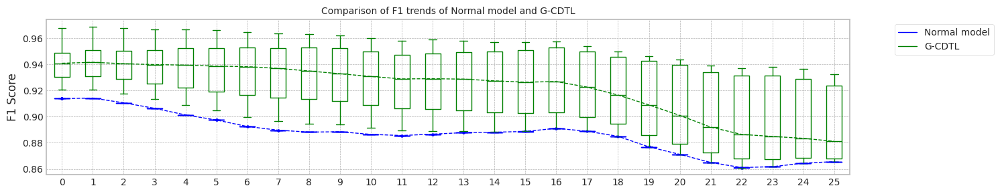

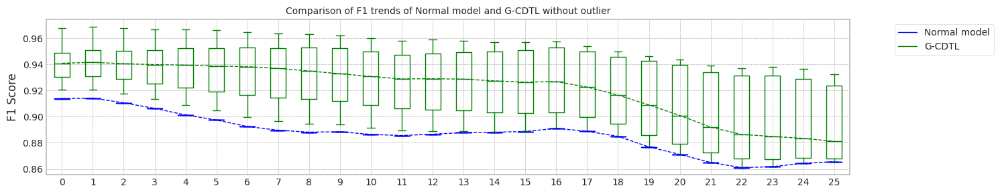

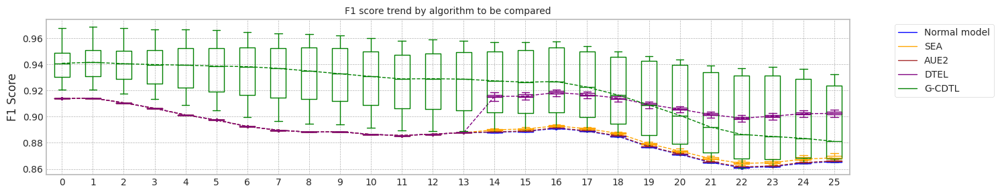

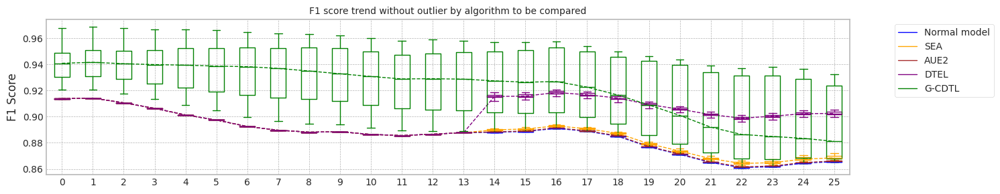

max_mean_trial= 9


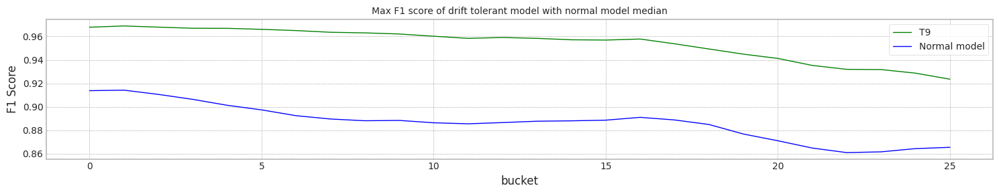

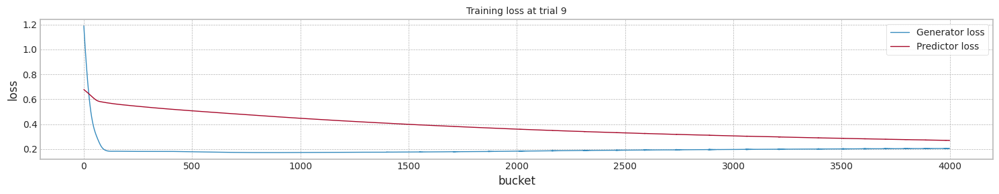

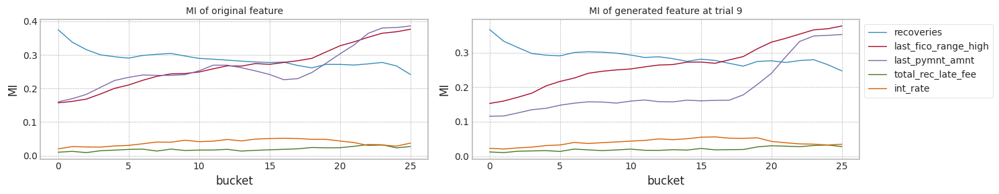

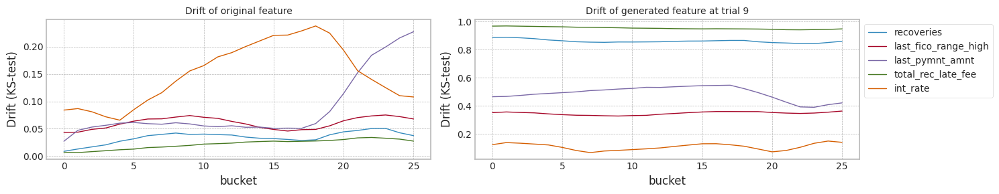

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.886780,0.865530,12.431451
1,1.0,0.913781,0.914224,0.886806,0.865579,12.560030
2,2.0,0.913811,0.914253,0.886781,0.865538,12.312283
3,3.0,0.913781,0.914224,0.886786,0.865555,12.510426
4,4.0,0.913781,0.914224,0.886785,0.865555,12.622650
5,5.0,0.913781,0.914224,0.886786,0.865555,12.713731
6,6.0,0.913781,0.914224,0.886779,0.865530,12.951437
7,7.0,0.913781,0.914224,0.886801,0.865579,12.860854
8,8.0,0.913781,0.914224,0.886790,0.865555,12.783993
9,9.0,0.913781,0.914224,0.886775,0.865555,12.956068


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.887780,0.868169,15.986910
1,1.0,0.913781,0.914224,0.888192,0.869374,16.261284
2,2.0,0.913811,0.914253,0.887839,0.868367,16.269277
3,3.0,0.913781,0.914224,0.888207,0.870051,16.138654
4,4.0,0.913781,0.914224,0.887668,0.867767,16.300297
5,5.0,0.913781,0.914224,0.888502,0.871194,16.146134
6,6.0,0.913781,0.914224,0.887779,0.868120,15.826242
7,7.0,0.913781,0.914224,0.888638,0.871685,15.825403
8,8.0,0.913781,0.914224,0.887639,0.867693,16.144972
9,9.0,0.913781,0.914224,0.887624,0.867626,16.357098


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.886921,0.865908,16.119529
1,1.0,0.913781,0.914224,0.887034,0.866212,16.195912
2,2.0,0.913811,0.914253,0.886921,0.865842,16.462799
3,3.0,0.913781,0.914224,0.887003,0.866211,16.528657
4,4.0,0.913781,0.914224,0.887056,0.866309,16.086814
5,5.0,0.913781,0.914224,0.887007,0.866235,16.137364
6,6.0,0.913781,0.914224,0.886882,0.865761,15.918563
7,7.0,0.913781,0.914224,0.887053,0.866311,15.859974
8,8.0,0.913781,0.914224,0.886927,0.865933,16.324810
9,9.0,0.913781,0.914224,0.886931,0.865950,16.254127


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913811,0.914253,0.901545,0.901569,19.604799
1,1.0,0.913781,0.914224,0.901839,0.902168,19.659170
2,2.0,0.913811,0.914253,0.902062,0.902828,19.870819
3,3.0,0.913781,0.914224,0.903043,0.905330,19.874404
4,4.0,0.913781,0.914224,0.901475,0.901737,19.545136
5,5.0,0.913781,0.914224,0.902488,0.903858,19.602668
6,6.0,0.913781,0.914224,0.902749,0.904621,19.648706
7,7.0,0.913781,0.914224,0.901907,0.902433,19.466405
8,8.0,0.913781,0.914224,0.901697,0.902192,19.945555
9,9.0,0.913781,0.914224,0.902045,0.902818,19.456614


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.940631,0.940785,0.920648,0.891687,12.696167
1,1.0,0.948398,0.948976,0.909028,0.865562,12.290117
2,2.0,0.920560,0.920751,0.890364,0.865587,12.233184
3,3.0,0.930461,0.930211,0.903260,0.868247,12.434235
4,4.0,0.935375,0.936600,0.917582,0.884144,12.253472
5,5.0,0.929331,0.931317,0.940201,0.924312,12.418374
6,6.0,0.935427,0.935351,0.903201,0.868444,12.420944
7,7.0,0.946850,0.947934,0.923916,0.878089,12.495809
8,8.0,0.924582,0.924035,0.891313,0.865562,12.613283
9,9.0,0.967818,0.968876,0.954063,0.923556,12.539150


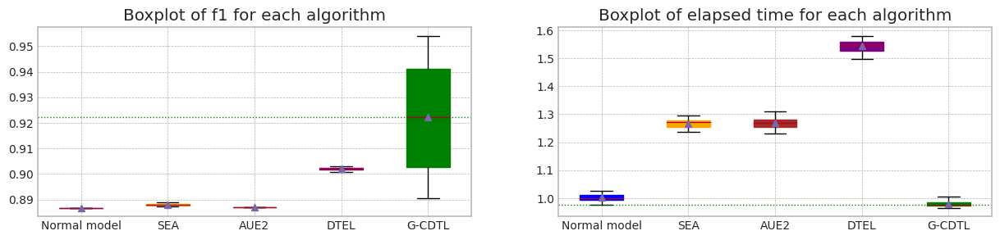

In [ ]:
_,_,_,_,_,_ = drift_tolerant2('LC_A',X1, Y1,train_size, test_size,avaible_range = 2000,lambda_f2=0.8,trial_count=20,lr_g=0.0002,weight_init= True)

### #2 날짜 단위로 bucket 만들기

#### data 정제

In [ ]:
X = {}
Y = {}

df = df_accepted[df_accepted['issue_d'].str.startswith('2007') + df_accepted['issue_d'].str.startswith('2008') + df_accepted['issue_d'].str.startswith('2009')].copy()
#df = df.drop(columns=['issue_d'])


X[2009] = df.loc[:, df.columns != 'loan_paid'].values
Y[2009] = df.loan_paid.values


for year in range(2010,2019):
    print(year)
    df = df_accepted[df_accepted['issue_d'].str.startswith(str(year))].copy()
    #df = df.drop(columns=['issue_d'])
    X[year] = df.loc[:, df.columns != 'loan_paid'].values
    Y[year] = df.loan_paid.values


2010
2011
2012
2013
2014
2015
2016
2017
2018


In [ ]:
COLUMNS = df.loc[:, df.columns != 'loan_paid'].columns
COLUMNS

Index(['loan_amnt', 'term', 'int_rate', 'annual_inc', 'issue_d', 'dti',
       'delinq_2yrs', 'fico_range_high', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'last_pymnt_amnt',
       'last_fico_range_high', 'collections_12_mths_ex_med', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5', 'C1',
       'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2', 'E3',
       'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3', 'G4', 'G5',
       'Source Verified', 'Verified', 'Joint App', 'w', 'credit_card',
       'debt_consolidation', 'educational', 'home_improvement', 'house',
       'major_purchase', 'medical', 'moving', 'other', 'renewable_energy',
       'small_business', 'vacation', 'wedding', 'MORTGAGE', 'OTHER', 'OWN',
       'RENT', 'DirectPay', 'Y'],


In [ ]:
X2 = np.concatenate((X[2010],X[2011],X[2012],X[2013],X[2014],X[2015],X[2016],X[2017]))
Y2 = np.concatenate((Y[2010],Y[2011],Y[2012],Y[2013],Y[2014],Y[2015],Y[2016],Y[2017]))
X2 = pd.DataFrame(X2,columns = list(COLUMNS))#[top_columns+['issue_d']]

In [ ]:
X2

,loan_amnt,term,int_rate,annual_inc,issue_d,dti,delinq_2yrs,fico_range_high,inq_last_6mths,open_acc,...,renewable_energy,small_business,vacation,wedding,MORTGAGE,OTHER,OWN,RENT,DirectPay,Y
0,12000.0,36,13.57,42000.0,201001,21.77,0.0,684.0,2.0,10.0,...,0,0,0,0,0,0,0,1,0,0
1,7500.0,36,12.18,26000.0,201001,0.0,0.0,764.0,3.0,5.0,...,0,0,0,0,0,0,0,1,0,0
2,10000.0,36,14.61,62400.0,201001,8.46,0.0,714.0,1.0,7.0,...,0,0,0,0,1,0,0,0,0,0
3,15000.0,36,16.0,96000.0,201001,11.13,2.0,664.0,2.0,13.0,...,0,0,0,0,0,0,0,1,0,0
4,20000.0,36,11.83,105000.0,201001,13.87,0.0,759.0,0.0,9.0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1279675,4800.0,36,9.93,90000.0,201712,20.81,0.0,704.0,0.0,11.0,...,0,0,0,0,0,0,0,1,0,0
1279676,15000.0,36,9.93,150000.0,201712,10.16,0.0,739.0,0.0,6.0,...,0,0,0,0,1,0,0,0,0,0
1279677,9600.0,36,7.97,40500.0,201712,13.75,0.0,709.0,1.0,21.0,...,0,0,0,0,0,0,0,1,0,0
1279678,32000.0,36,5.32,45000.0,201712,28.96,0.0,779.0,0.0,17.0,...,0,0,0,0,1,0,0,0,0,0


In [ ]:
from datetime import date
from datetime import datetime

def date_bucket_num(d,start_day='20100101'):
    date1 = datetime.strptime(start_day, '%Y%m%d')
    date2 = datetime.strptime(str(d)+'01', '%Y%m%d')
    delta = date2 - date1
    return int(delta.days/30)

In [ ]:
X2['b'] = [date_bucket_num(d) for d in X2['issue_d']]

In [ ]:
b_cnt = X2.groupby(['b'])['b'].count()

In [ ]:
# 1/10 로 사이즈 줄이기...
seed_everything()
s = np.sort(np.random.choice(X2.shape[0],int(X2.shape[0]/10),replace= False))
#print(s.shape)
X3 = X2.iloc[s,:]
Y3 = Y2[s]

In [ ]:
b_cnt2 = X3.groupby(['b'])['b'].count()

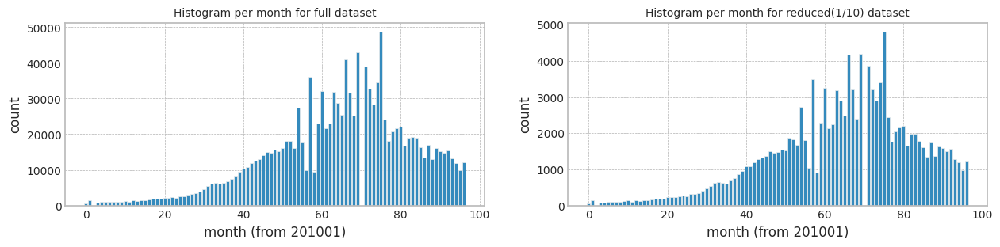

In [ ]:
fig, ax = plt.subplots(figsize=main_figsize, nrows=1, ncols=2)
ax[0].bar(b_cnt.index,b_cnt.values)
ax[0].set_ylabel('count')
ax[0].set_xlabel('month (from 201001)')
ax[0].set_title(f'Histogram per month for full dataset',fontdict={'fontsize':10})

ax[1].bar(b_cnt2.index,b_cnt2.values)
ax[1].set_ylabel('count')
ax[1].set_xlabel('month (from 201001)')
ax[1].set_title(f'Histogram per month for reduced(1/10) dataset',fontdict={'fontsize':10})

plt.show()

In [ ]:
X3.drop(columns=['issue_d'],inplace=True)

In [ ]:
X3

,loan_amnt,term,int_rate,annual_inc,dti,delinq_2yrs,fico_range_high,inq_last_6mths,open_acc,pub_rec,...,small_business,vacation,wedding,MORTGAGE,OTHER,OWN,RENT,DirectPay,Y,b
8,9000.0,36,8.94,44000.0,8.97,0.0,749.0,1.0,14.0,0.0,...,0,0,0,0,0,0,1,0,0,0
19,21125.0,36,13.92,87000.0,18.33,0.0,704.0,1.0,9.0,0.0,...,0,0,0,1,0,0,0,0,0,0
41,24250.0,36,12.53,287000.0,13.89,0.0,729.0,2.0,15.0,0.0,...,0,0,0,0,0,0,1,0,0,0
43,5000.0,36,13.92,38000.0,5.68,0.0,689.0,1.0,5.0,0.0,...,0,0,0,0,0,0,1,0,0,0
52,13000.0,36,8.59,100000.0,18.35,0.0,784.0,2.0,18.0,0.0,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1279596,8000.0,36,7.35,27000.0,22.36,0.0,719.0,0.0,14.0,0.0,...,0,0,0,0,0,0,1,0,0,96
1279609,29375.0,60,30.75,90000.0,44.94,0.0,689.0,1.0,20.0,0.0,...,0,0,0,0,0,0,1,0,0,96
1279627,2500.0,36,10.42,48000.0,25.23,0.0,794.0,1.0,9.0,0.0,...,0,0,0,0,0,0,1,0,0,96
1279639,18500.0,36,13.59,45000.0,35.71,1.0,709.0,0.0,14.0,0.0,...,0,0,0,1,0,0,0,0,0,96


#### Drift tolerant 학습

train_size 19361
Dataset has buckets!
MI Analysis MI Max 0.27250, Min 0.00322, Mean 0.07070, Std 0.10188
Dataset structure X_train, (19361, 5) X_test, (19361, 5) X_live (123968, 5)
bucket range in live set 26~96
Truncate 0 rows from live_set (123968, 5)
Search MI & Drift...for X_live_set (70,)


100%|██████████| 70/70 [00:03<00:00, 21.30it/s]


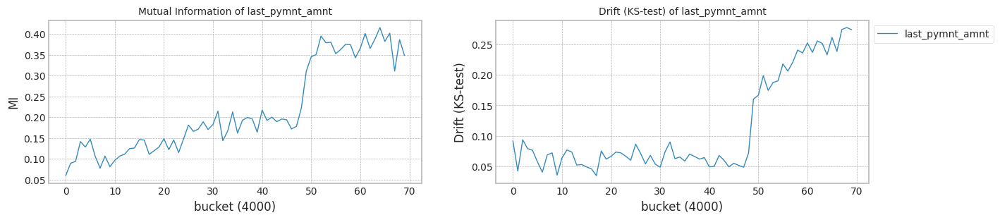

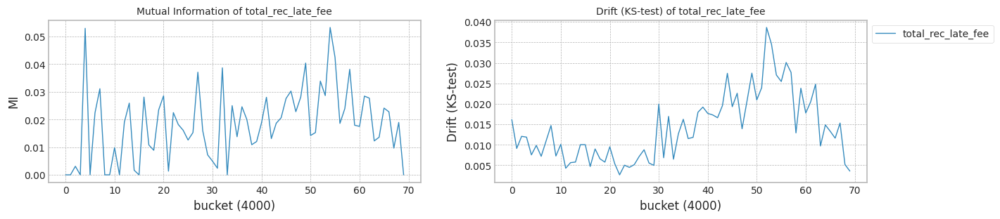

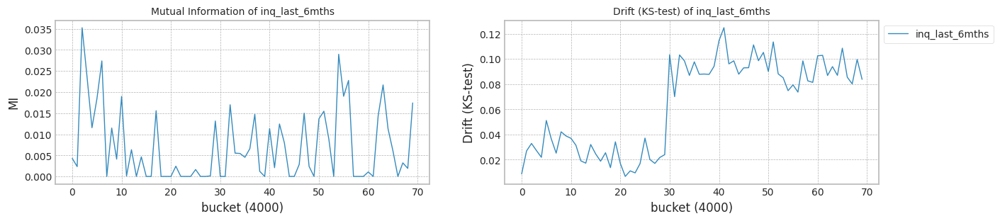

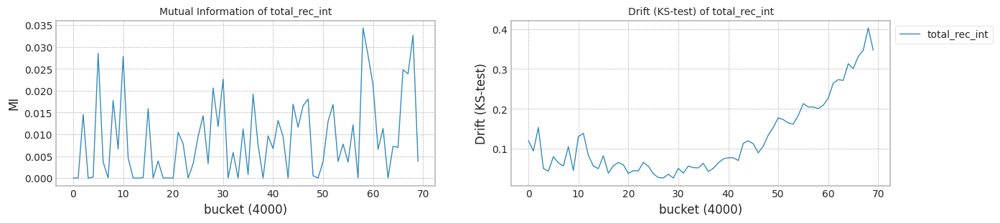

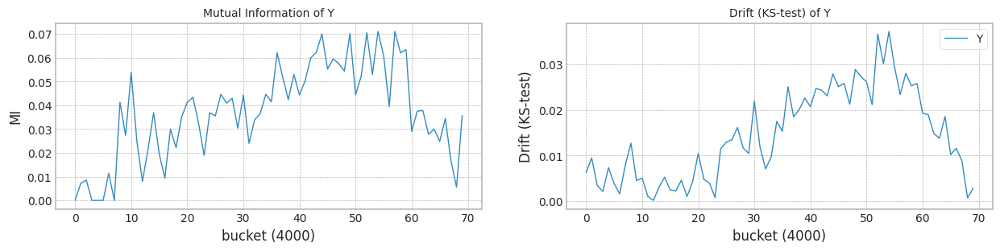

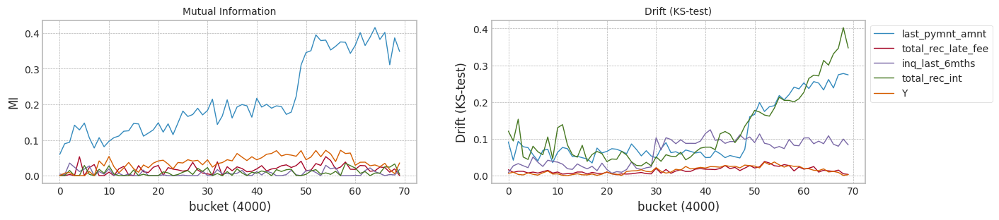

In [ ]:
top_columns = list(mi_scores[0:5].index)
top_columns = ['last_pymnt_amnt', 'total_rec_late_fee', 'inq_last_6mths', 'total_rec_int', 'Y']

train_size = X3[X3['b'] < 46].shape[0] # 2010년 1월에서 39개월 (약 3년6개월간의 data)
print('train_size',train_size)
test_size = 4000

X1,Y1 = check_mi_drift(X3[top_columns+['b']], Y3, train_size, test_size)

trial_count: 2
Lambda :  0.9
######################### Retrain 5 Trial 0 for Normal model ###########################
cuda:0
[2023-11-27 13:32:33,594] [INFO] [profiler.py:80:start_profile] Flops profiler started


 44%|████▍     | 890/2000 [00:02<00:02, 441.73it/s]

Early stop: 890
[2023-11-27 13:32:35,619] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 7504033185
precision_recall_fscore: (array([0.75471698, 0.85323855]), array([0.09129442, 0.99441512]), array([0.1628854 , 0.91843328]), array([ 3067, 16294]))
Test f1 score: 0.9184332842081396
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:11<00:00,  2.36it/s]

mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9009597604647868
inference_flops: 227394945
######################### Retrain 5 Trial 0 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19361, 6])
[2023-11-27 13:32:47,127] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:32:47,129] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 32%|███▏      | 644/2000 [00:04<00:09, 147.34it/s]

[2023-11-27 13:32:53,688] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:32:53,689] [INFO] [profiler.py:226:end_profile] Flops profiler finished


G-CDTL train flops: 15788895500 21853728750 5432212575 43074836825
precision_recall_fscore: (array([0.77351248, 0.85859873]), array([0.13139876, 0.99275807]), array([0.22463768, 0.92081744]), array([ 3067, 16294]))
Test f1 score: 0.9208174417942733
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:10<00:00,  2.46it/s]

mean of drift:
last_pymnt_amnt       0.480982
total_rec_late_fee    0.954089
inq_last_6mths        0.521746
total_rec_int         0.164447
Y                     0.945300
dtype: float64
Mean F1 for all data: 0.9034030227314815
inference_flops: 1142202195
Normal model median        : 0.9009597604647868
Drift tolerant model median: 0.9034030227314815
######################### Retrain 5 Trial 1 for Normal model ###########################
cuda:0
[2023-11-27 13:33:04,737] [INFO] [profiler.py:80:start_profile] Flops profiler started



 69%|██████▊   | 1372/2000 [00:03<00:01, 450.01it/s]

Early stop: 1372
[2023-11-27 13:33:07,794] [INFO] [profiler.py:226:end_profile] Flops profiler finished


Normal discriminator train flops : 11563454055
precision_recall_fscore: (array([0.69333333, 0.85649819]), array([0.11868275, 0.99011906]), array([0.20267261, 0.91847424]), array([ 3067, 16294]))
Test f1 score: 0.9184742385425562
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:10<00:00,  2.47it/s]

mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9017397610350697
inference_flops: 227394945
######################### Retrain 5 Trial 1 for G-CDTL ###########################
cuda:0
G-CDTL Train: torch.Size([19361, 6])
[2023-11-27 13:33:18,784] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:33:18,787] [INFO] [profiler.py:80:start_profile] Flops profiler started


min_bucket_num: 0.0


 24%|██▍       | 484/2000 [00:03<00:10, 149.34it/s]

[2023-11-27 13:33:23,363] [INFO] [profiler.py:226:end_profile] Flops profiler finished


[2023-11-27 13:33:23,364] [INFO] [profiler.py:226:end_profile] Flops profiler finished
G-CDTL train flops: 9283599500 16432648750 4084686975 29800935225
precision_recall_fscore: (array([0.73703704, 0.85819032]), array([0.1297685 , 0.99128514]), array([0.22068201, 0.91994874]), array([ 3067, 16294]))
Test f1 score: 0.9199487398547629
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set (27, 19361, 6)


100%|██████████| 27/27 [00:10<00:00,  2.46it/s]


mean of drift:
last_pymnt_amnt       0.488619
total_rec_late_fee    0.921080
inq_last_6mths        0.555496
total_rec_int         0.243707
Y                     0.971286
dtype: float64
Mean F1 for all data: 0.9037890939256946
inference_flops: 1142202195
Normal model median        : 0.9013497607499282
Drift tolerant model median: 0.903596058328588
######################### Retrain 5 Trial 0 for Normal model ###########################
retrain_interval: 5
######################### Retrain 5 Trial 0 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 15%|█▍        | 4/27 [00:01<00:09,  2.40it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:33:36,488] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:33:36,490] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:33:44,418] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:33:44,419] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▊        | 5/27 [00:10<01:12,  3.28s/it]

G-CDTL train flops: 5243000000 5397000000 1341540000 11981540000


 33%|███▎      | 9/27 [00:11<00:18,  1.01s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:33:46,519] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:33:46,522] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:33:51,850] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:33:51,851] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 10/27 [00:17<00:42,  2.48s/it]

G-CDTL train flops: 2429000000 4375000000 1087500000 7891500000


 52%|█████▏    | 14/27 [00:19<00:11,  1.13it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:33:53,852] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:33:53,854] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:33:58,015] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:33:58,016] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 56%|█████▌    | 15/27 [00:23<00:23,  2.00s/it]

G-CDTL train flops: 2975000000 2695000000 669900000 6339900000


 70%|███████   | 19/27 [00:25<00:06,  1.27it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:34:00,092] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:34:00,094] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:34:09,697] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:34:09,698] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 20/27 [00:35<00:24,  3.57s/it]

G-CDTL train flops: 3647000000 8274000000 2056680000 13977680000


 89%|████████▉ | 24/27 [00:37<00:03,  1.18s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:34:11,848] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:34:11,851] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:34:19,927] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:34:19,929] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 93%|█████████▎| 25/27 [00:45<00:06,  3.38s/it]

G-CDTL train flops: 2072000000 7539000000 1873980000 11484980000


100%|██████████| 27/27 [00:46<00:00,  1.72s/it]


Early stop at  [770, 624, 384, 1181, 1076]
Train flops  [11981540000, 7891500000, 6339900000, 13977680000, 11484980000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9204145477714611
G_CDTL+AUE median: 0.9204145477714611
######################### Retrain 5 Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 19%|█▊        | 5/27 [00:03<00:20,  1.10it/s]

Ensemble_SEA train flops: 1463340000


 37%|███▋      | 10/27 [00:07<00:19,  1.15s/it]

Ensemble_SEA train flops: 2413380000


 56%|█████▌    | 15/27 [00:12<00:14,  1.22s/it]

Ensemble_SEA train flops: 2533440000


 74%|███████▍  | 20/27 [00:16<00:07,  1.13s/it]

Ensemble_SEA train flops: 2199360000


 93%|█████████▎| 25/27 [00:19<00:02,  1.07s/it]

Ensemble_SEA train flops: 1952280000


100%|██████████| 27/27 [00:20<00:00,  1.29it/s]


Early stop at  [840, 1386, 1455, 1263, 1121]
Train flops  [1463340000, 2413380000, 2533440000, 2199360000, 1952280000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9026462459154807
SEA median: 0.9026462459154807
######################### Retrain 5 Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 19%|█▊        | 5/27 [00:03<00:23,  1.06s/it]

Ensemble_SEA train flops: 1997520000


 37%|███▋      | 10/27 [00:07<00:14,  1.15it/s]

Ensemble_SEA train flops: 1301520000


 56%|█████▌    | 15/27 [00:11<00:14,  1.24s/it]

Ensemble_SEA train flops: 2799660000


 74%|███████▍  | 20/27 [00:16<00:10,  1.48s/it]

Ensemble_SEA train flops: 3480000000


 93%|█████████▎| 25/27 [00:22<00:03,  1.53s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 27/27 [00:22<00:00,  1.18it/s]


Early stop at  [1147, 747, 1608, 1999, 1999]
Train flops  [1997520000, 1301520000, 2799660000, 3480000000, 3480000000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9058169124993478
AUE median: 0.9058169124993478
######################### Retrain 5 Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 19%|█▊        | 5/27 [00:03<00:24,  1.11s/it]

Ensemble_DTEL train flops: 2166300000
Ensemble_DTEL train flops: 8700000


 37%|███▋      | 10/27 [00:07<00:17,  1.05s/it]

Ensemble_DTEL train flops: 1964460000
Ensemble_DTEL train flops: 5220000


 56%|█████▌    | 15/27 [00:11<00:12,  1.01s/it]

Ensemble_DTEL train flops: 1997520000
Ensemble_DTEL train flops: 5220000


 74%|███████▍  | 20/27 [00:14<00:06,  1.13it/s]

Ensemble_DTEL train flops: 1442460000
Ensemble_DTEL train flops: 12180000


 93%|█████████▎| 25/27 [00:19<00:02,  1.41s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 6960000


100%|██████████| 27/27 [00:20<00:00,  1.30it/s]


Early stop at  [1244, 4, 1128, 2, 1147, 2, 828, 6, 1999, 3]
Train flops  [2166300000, 8700000, 1964460000, 5220000, 1997520000, 5220000, 1442460000, 12180000, 3480000000, 6960000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9060458758684101
DTEL median: 0.9060458758684101
######################### Retrain 5 Trial 1 for Normal model ###########################
retrain_interval: 5
######################### Retrain 5 Trial 1 for G_CDTL+AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 15%|█▍        | 4/27 [00:01<00:09,  2.45it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:35:27,723] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:35:27,726] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:35:32,263] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:35:32,265] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 19%|█▊        | 5/27 [00:06<00:45,  2.06s/it]

G-CDTL train flops: 1589000000 3857000000 958740000 6404740000


 33%|███▎      | 9/27 [00:08<00:13,  1.32it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:35:34,348] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:35:34,351] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:35:41,014] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:35:41,016] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 37%|███▋      | 10/27 [00:15<00:46,  2.71s/it]

G-CDTL train flops: 4053000000 4431000000 1101420000 9585420000


 52%|█████▏    | 14/27 [00:17<00:12,  1.05it/s]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:35:43,079] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:35:43,081] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:35:50,247] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:35:50,248] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 56%|█████▌    | 15/27 [00:24<00:35,  2.95s/it]

G-CDTL train flops: 3773000000 5236000000 1301520000 10310520000


 70%|███████   | 19/27 [00:26<00:08,  1.03s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:35:52,375] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:35:52,378] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:36:02,240] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:36:02,241] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 74%|███████▍  | 20/27 [00:36<00:26,  3.81s/it]

G-CDTL train flops: 4396000000 7672000000 1907040000 13975040000


 89%|████████▉ | 24/27 [00:38<00:03,  1.24s/it]

G-CDTL Train: torch.Size([4000, 6])
[2023-11-27 13:36:04,416] [INFO] [profiler.py:80:start_profile] Flops profiler started
[2023-11-27 13:36:04,419] [INFO] [profiler.py:80:start_profile] Flops profiler started
min_bucket_num: 0.0
[2023-11-27 13:36:14,931] [INFO] [profiler.py:226:end_profile] Flops profiler finished
[2023-11-27 13:36:14,933] [INFO] [profiler.py:226:end_profile] Flops profiler finished


 93%|█████████▎| 25/27 [00:49<00:08,  4.16s/it]

G-CDTL train flops: 8281000000 5579000000 1386780000 15246780000


100%|██████████| 27/27 [00:50<00:00,  1.86s/it]


Early stop at  [550, 632, 747, 1095, 796]
Train flops  [6404740000, 9585420000, 10310520000, 13975040000, 15246780000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9171669586686128
G_CDTL+AUE median: 0.918790753220037
######################### Retrain 5 Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 19%|█▊        | 5/27 [00:03<00:17,  1.23it/s]

Ensemble_SEA train flops: 1233660000


 37%|███▋      | 10/27 [00:06<00:15,  1.08it/s]

Ensemble_SEA train flops: 1602540000


 56%|█████▌    | 15/27 [00:10<00:10,  1.10it/s]

Ensemble_SEA train flops: 1496400000


 74%|███████▍  | 20/27 [00:14<00:07,  1.13s/it]

Ensemble_SEA train flops: 2342040000


 93%|█████████▎| 25/27 [00:18<00:02,  1.09s/it]

Ensemble_SEA train flops: 1988820000


100%|██████████| 27/27 [00:19<00:00,  1.40it/s]


Early stop at  [708, 920, 859, 1345, 1142]
Train flops  [1233660000, 1602540000, 1496400000, 2342040000, 1988820000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9026487078023793
SEA median: 0.90264747685893
######################### Retrain 5 Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 19%|█▊        | 5/27 [00:05<00:33,  1.54s/it]

Ensemble_SEA train flops: 3480000000


 37%|███▋      | 10/27 [00:08<00:17,  1.02s/it]

Ensemble_SEA train flops: 1646040000


 56%|█████▌    | 15/27 [00:13<00:17,  1.44s/it]

Ensemble_SEA train flops: 3480000000


 74%|███████▍  | 20/27 [00:17<00:07,  1.04s/it]

Ensemble_SEA train flops: 1672140000


 93%|█████████▎| 25/27 [00:22<00:02,  1.45s/it]

Ensemble_SEA train flops: 3480000000


100%|██████████| 27/27 [00:23<00:00,  1.15it/s]


Early stop at  [1999, 945, 1999, 960, 1999]
Train flops  [3480000000, 1646040000, 3480000000, 1672140000, 3480000000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.910776870114615
AUE median: 0.9082968913069813
######################### Retrain 5 Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


 19%|█▊        | 5/27 [00:03<00:23,  1.09s/it]

Ensemble_DTEL train flops: 2070600000
Ensemble_DTEL train flops: 6960000


 33%|███▎      | 9/27 [00:05<00:09,  1.81it/s]

Ensemble_DTEL train flops: 1799160000


 37%|███▋      | 10/27 [00:09<00:24,  1.45s/it]

Ensemble_DTEL train flops: 1666920000


 56%|█████▌    | 15/27 [00:14<00:18,  1.50s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 5220000


 74%|███████▍  | 20/27 [00:19<00:10,  1.53s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 12180000


 93%|█████████▎| 25/27 [00:24<00:03,  1.54s/it]

Ensemble_DTEL train flops: 3480000000
Ensemble_DTEL train flops: 8700000


100%|██████████| 27/27 [00:25<00:00,  1.06it/s]


Early stop at  [1189, 3, 1033, 957, 1999, 2, 1999, 6, 1999, 4]
Train flops  [2070600000, 6960000, 1799160000, 1666920000, 3480000000, 5220000, 3480000000, 12180000, 3480000000, 8700000]
Mean of drift:
last_pymnt_amnt       0.091342
total_rec_late_fee    0.021963
inq_last_6mths        0.208648
total_rec_int         0.097422
Y                     0.019210
dtype: float64
Mean F1 for all data: 0.9082524365455085
DTEL median: 0.9071491562069594


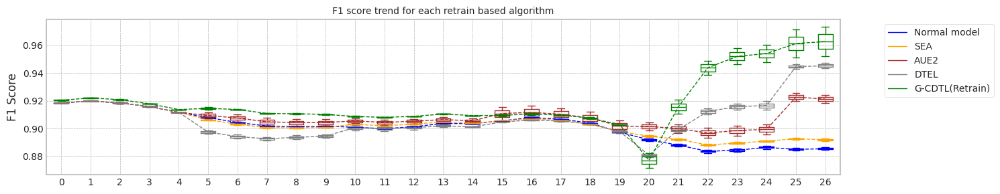

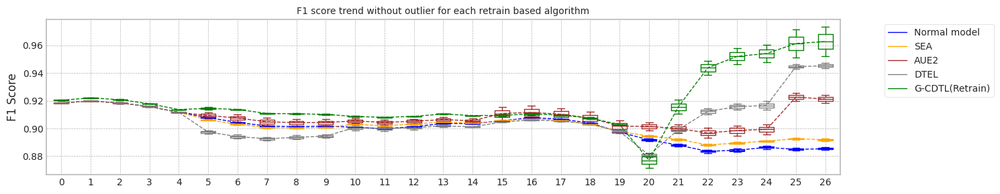

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.228456854820251
Base flops (train + inference flops of normal model, median): 9761138565.0


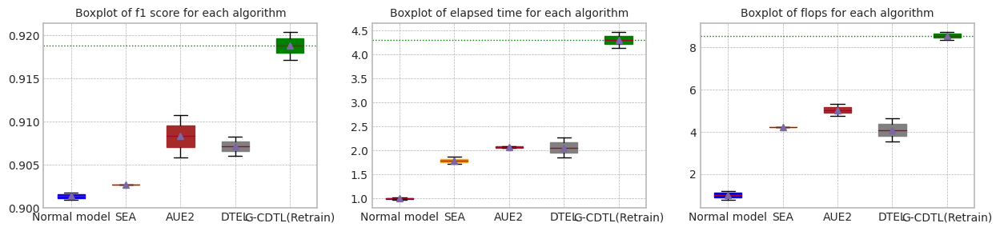

Base elapsed time (inference elapsed time of normal model, median (ms)): 11.228456854820251


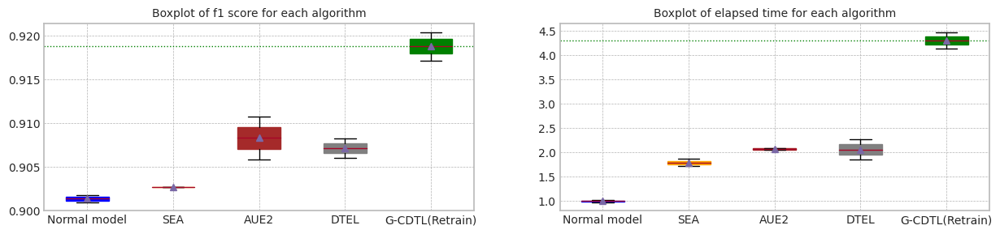

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918433,0.919699,0.900960,0.884448,11.487450,7.504033e+09,227394945.0,7.731428e+09
1,1.0,0.918474,0.919965,0.901740,0.886312,10.969464,1.156345e+10,227394945.0,1.179085e+10
2,median,0.918454,0.919832,0.901350,0.885380,11.228457,9.533744e+09,227394945.0,9.761139e+09
3,std,0.000029,0.000188,0.000552,0.001318,0.366271,2.870444e+09,0.0,2.870444e+09


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920817,0.922472,0.903403,0.887328,11.026536,4.307484e+10,1.142202e+09,4.421704e+10
1,1.0,0.919949,0.921774,0.903789,0.889550,10.987072,2.980094e+10,1.142202e+09,3.094314e+10
2,median,0.920383,0.922123,0.903596,0.888439,11.006804,3.643789e+10,1.142202e+09,3.758009e+10
3,std,0.000614,0.000493,0.000273,0.001571,0.027905,9.386066e+09,0.000000e+00,9.386066e+09


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918433,0.919699,0.902646,0.892781,20.907363,2.212525e+10,1.903437e+10,4.115962e+10
1,1.0,0.918474,0.919965,0.902649,0.890988,19.268015,2.022691e+10,2.119545e+10,4.142236e+10
2,median,0.918454,0.919832,0.902647,0.891885,20.087689,2.117608e+10,2.011491e+10,4.129099e+10
3,std,0.000029,0.000188,0.000002,0.001268,1.159194,1.342329e+09,1.528115e+09,1.857859e+08


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918433,0.919699,0.905817,0.918491,23.008294,2.462215e+10,2.175866e+10,4.638082e+10
1,1.0,0.918474,0.919965,0.910777,0.923988,23.480535,2.532163e+10,2.651756e+10,5.183920e+10
2,median,0.918454,0.919832,0.908297,0.921239,23.244415,2.497189e+10,2.413811e+10,4.911001e+10
3,std,0.000029,0.000188,0.003507,0.003887,0.333925,4.946071e+08,3.365051e+09,3.859658e+09


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.918433,0.919699,0.906046,0.943399,20.847912,2.265247e+10,1.194032e+10,3.459279e+10
1,1.0,0.918474,0.919965,0.908252,0.947169,25.410375,2.757319e+10,1.766144e+10,4.523463e+10
2,median,0.918454,0.919832,0.907149,0.945284,23.129143,2.511283e+10,1.480088e+10,3.991371e+10
3,std,0.000029,0.000188,0.001560,0.002666,3.226149,3.479474e+09,4.045443e+09,7.524918e+09


@ G-CDTL+Retrain


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time,Train flops,Inference flops,flops
0,0.0,0.920817,0.922472,0.920415,0.973553,46.486289,8.147654e+10,38528390.0,8.151506e+10
1,1.0,0.919949,0.921774,0.917167,0.952047,50.197439,8.532344e+10,38528390.0,8.536196e+10
2,median,0.920383,0.922123,0.918791,0.962800,48.341864,8.339999e+10,38528390.0,8.343851e+10
3,std,0.000614,0.000493,0.002296,0.015207,2.624179,2.720169e+09,0.0,2.720169e+09


In [ ]:
org_df,gcd_df,sea_df,aue_df,dte_df,gea_df = drift_tolerant2(2000,'LC_B',X1, Y1,train_size, test_size,avaible_range = 1000,
                                                            lambda_f2=0.9,trial_count=2,lr_g=0.002,
                                                            retrain_count=5,weight_init=True)

trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 774.61it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863458257161829
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 240.37it/s]


precision_recall_fscore: (array([1.        , 0.88945903]), array([0.33974568, 1.        ]), array([0.50717936, 0.94149597]), array([ 3067, 16294]))
Test f1 score: 0.9414959697223586
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.20it/s]


mean of drift:
recoveries              0.853313
last_fico_range_high    0.356255
last_pymnt_amnt         0.492372
total_rec_late_fee      0.923060
int_rate                0.127467
dtype: float64
Mean F1 for all data: 0.9281967667585215
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 798.01it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863578217676831
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 243.20it/s]


precision_recall_fscore: (array([1.        , 0.90051951]), array([0.41310727, 1.        ]), array([0.58467928, 0.94765616]), array([ 3067, 16294]))
Test f1 score: 0.9476561591252762
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.19it/s]


mean of drift:
recoveries              0.857225
last_fico_range_high    0.414801
last_pymnt_amnt         0.310714
total_rec_late_fee      0.924621
int_rate                0.123337
dtype: float64
Mean F1 for all data: 0.9338725399638771
Normal model median        : 0.886351823741933
Drift tolerant model median: 0.9310346533611993
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 798.10it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863401150175781
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 241.09it/s]


precision_recall_fscore: (array([1.        , 0.85313367]), array([0.0854255, 1.       ]), array([0.15740463, 0.92074704]), array([ 3067, 16294]))
Test f1 score: 0.9207470403752154
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.22it/s]


mean of drift:
recoveries              0.853983
last_fico_range_high    0.212611
last_pymnt_amnt         0.489395
total_rec_late_fee      0.940497
int_rate                0.416584
dtype: float64
Mean F1 for all data: 0.8974220349316648
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 793.93it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863464726130549
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.10it/s]


precision_recall_fscore: (array([1.        , 0.87040598]), array([0.20899902, 1.        ]), array([0.34573894, 0.93071343]), array([ 3067, 16294]))
Test f1 score: 0.9307134289141487
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.853531
last_fico_range_high    0.336191
last_pymnt_amnt         0.492458
total_rec_late_fee      0.946230
int_rate                0.194465
dtype: float64
Mean F1 for all data: 0.9134861554900527
Normal model median        : 0.886346149164619
Drift tolerant model median: 0.9208414611242871
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 815.97it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863427159629517
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.45it/s]


precision_recall_fscore: (array([1.        , 0.87899876]), array([0.26866645, 1.        ]), array([0.42354151, 0.93560334]), array([ 3067, 16294]))
Test f1 score: 0.9356033418506503
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.19it/s]


mean of drift:
recoveries              0.861499
last_fico_range_high    0.349661
last_pymnt_amnt         0.476521
total_rec_late_fee      0.935028
int_rate                0.183630
dtype: float64
Mean F1 for all data: 0.928461248906517
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 801.30it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863464726130549
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 241.18it/s]


precision_recall_fscore: (array([1.       , 0.8673942]), array([0.18780567, 1.        ]), array([0.31622289, 0.92898885]), array([ 3067, 16294]))
Test f1 score: 0.9289888537301519
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.858434
last_fico_range_high    0.248101
last_pymnt_amnt         0.331803
total_rec_late_fee      0.936707
int_rate                0.297781
dtype: float64
Mean F1 for all data: 0.9241493170128591
Normal model median        : 0.886346149164619
Drift tolerant model median: 0.9261730418856903
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 806.86it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863379927039984
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 244.34it/s]


precision_recall_fscore: (array([1.        , 0.88061395]), array([0.2797522, 1.       ]), array([0.43719745, 0.93651752]), array([ 3067, 16294]))
Test f1 score: 0.9365175158778055
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:11<00:00,  2.26it/s]


mean of drift:
recoveries              0.855180
last_fico_range_high    0.399319
last_pymnt_amnt         0.488558
total_rec_late_fee      0.953817
int_rate                0.154859
dtype: float64
Mean F1 for all data: 0.9193328890787023
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9241493170128591
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 801.99it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.14it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.886367278510997
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 241.96it/s]


precision_recall_fscore: (array([1.      , 0.895078]), array([0.3772416, 1.       ]), array([0.54782197, 0.94463447]), array([ 3067, 16294]))
Test f1 score: 0.944634471563569
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.857155
last_fico_range_high    0.414418
last_pymnt_amnt         0.465981
total_rec_late_fee      0.924788
int_rate                0.147699
dtype: float64
Mean F1 for all data: 0.9380314918041862
Normal model median        : 0.886346149164619
Drift tolerant model median: 0.9261730418856903
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 807.19it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863451492716822
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 242.27it/s]


precision_recall_fscore: (array([1.        , 0.86120507]), array([0.14378872, 1.        ]), array([0.25142531, 0.92542739]), array([ 3067, 16294]))
Test f1 score: 0.9254273868347815
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.25it/s]


mean of drift:
recoveries              0.856345
last_fico_range_high    0.280111
last_pymnt_amnt         0.486474
total_rec_late_fee      0.935259
int_rate                0.207062
dtype: float64
Mean F1 for all data: 0.9036356961632586
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9241493170128591
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 802.71it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.24it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863366899611954
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 247.64it/s]


precision_recall_fscore: (array([1.        , 0.93729867]), array([0.64460385, 1.        ]), array([0.78390167, 0.96763466]), array([ 3067, 16294]))
Test f1 score: 0.9676346576400023
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.861872
last_fico_range_high    0.350843
last_pymnt_amnt         0.478032
total_rec_late_fee      0.953800
int_rate                0.122857
dtype: float64
Mean F1 for all data: 0.9569288176689028
Normal model median        : 0.8863454874939325
Drift tolerant model median: 0.9261730418856903
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 789.35it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.20it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863461101438772
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.84it/s]


precision_recall_fscore: (array([1.        , 0.86605719]), array([0.17835018, 1.        ]), array([0.30271168, 0.92822149]), array([ 3067, 16294]))
Test f1 score: 0.9282214879799476
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.18it/s]


mean of drift:
recoveries              0.855180
last_fico_range_high    0.199188
last_pymnt_amnt         0.490901
total_rec_late_fee      0.922946
int_rate                0.362470
dtype: float64
Mean F1 for all data: 0.9088735062676576
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9241493170128591
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 766.30it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.13it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863498708141287
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:17<00:00, 234.78it/s]


precision_recall_fscore: (array([1.        , 0.88921633]), array([0.33811542, 1.        ]), array([0.50536062, 0.94135999]), array([ 3067, 16294]))
Test f1 score: 0.9413599861343809
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.19it/s]


mean of drift:
recoveries              0.855414
last_fico_range_high    0.374860
last_pymnt_amnt         0.475350
total_rec_late_fee      0.923089
int_rate                0.247560
dtype: float64
Mean F1 for all data: 0.9349914641993967
Normal model median        : 0.8863459679300301
Drift tolerant model median: 0.9261730418856903
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 771.44it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863342322838098
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.21it/s]


precision_recall_fscore: (array([1.        , 0.91999322]), array([0.537985, 1.      ]), array([0.6995972 , 0.95832966]), array([ 3067, 16294]))
Test f1 score: 0.9583296574033231
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.856743
last_fico_range_high    0.473460
last_pymnt_amnt         0.483997
total_rec_late_fee      0.953800
int_rate                0.220152
dtype: float64
Mean F1 for all data: 0.9475308512334829
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9281967667585215
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 778.61it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.17it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863458257161829
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 235.65it/s]


precision_recall_fscore: (array([1.        , 0.90769316]), array([0.45973264, 1.        ]), array([0.62988608, 0.95161337]), array([ 3067, 16294]))
Test f1 score: 0.951613374215214
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.861855
last_fico_range_high    0.368348
last_pymnt_amnt         0.463392
total_rec_late_fee      0.924941
int_rate                0.119708
dtype: float64
Mean F1 for all data: 0.9467901550543234
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9283290078325193
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 759.33it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.18it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863417493541016
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.73it/s]


precision_recall_fscore: (array([1.        , 0.93140505]), array([0.60873818, 1.        ]), array([0.75678962, 0.96448443]), array([ 3067, 16294]))
Test f1 score: 0.9644844323428436
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.858867
last_fico_range_high    0.300960
last_pymnt_amnt         0.313869
total_rec_late_fee      0.953802
int_rate                0.236246
dtype: float64
Mean F1 for all data: 0.9526430646135106
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.928461248906517
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 788.31it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.22it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863757760311738
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 240.17it/s]


precision_recall_fscore: (array([1.        , 0.91145047]), array([0.48386045, 1.        ]), array([0.65216436, 0.95367417]), array([ 3067, 16294]))
Test f1 score: 0.9536741681542829
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.861828
last_fico_range_high    0.363736
last_pymnt_amnt         0.480896
total_rec_late_fee      0.923592
int_rate                0.251213
dtype: float64
Mean F1 for all data: 0.9455453568686125
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9311668944351971
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 782.63it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.18it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863495861363716
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 238.49it/s]


precision_recall_fscore: (array([1.        , 0.87022004]), array([0.20769482, 1.        ]), array([0.34395248, 0.93060712]), array([ 3067, 16294]))
Test f1 score: 0.9306071163401679
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:11<00:00,  2.27it/s]


mean of drift:
recoveries              0.861809
last_fico_range_high    0.256715
last_pymnt_amnt         0.484512
total_rec_late_fee      0.953800
int_rate                0.209637
dtype: float64
Mean F1 for all data: 0.9187865588486569
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.928461248906517
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:04<00:00, 818.35it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.24it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863472409167413
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 244.01it/s]


precision_recall_fscore: (array([1.        , 0.87003417]), array([0.20639061, 1.        ]), array([0.34216216, 0.93050083]), array([ 3067, 16294]))
Test f1 score: 0.9305008280509394
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.25it/s]


mean of drift:
recoveries              0.854983
last_fico_range_high    0.345136
last_pymnt_amnt         0.487305
total_rec_late_fee      0.953800
int_rate                0.166769
dtype: float64
Mean F1 for all data: 0.9115785064728756
Normal model median        : 0.8863459679300301
Drift tolerant model median: 0.9283290078325193
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 726.82it/s]


precision_recall_fscore: (array([0.        , 0.84158876]), array([0., 1.]), array([0.        , 0.91398121]), array([ 3067, 16294]))
Test f1 score: 0.913981208806619
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.16it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863401150175781
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 237.28it/s]


precision_recall_fscore: (array([0.99906015, 0.89047385]), array([0.34659276, 0.99993863]), array([0.51464536, 0.94203695]), array([ 3067, 16294]))
Test f1 score: 0.9420369460264231
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.23it/s]


mean of drift:
recoveries              0.855879
last_fico_range_high    0.355857
last_pymnt_amnt         0.471054
total_rec_late_fee      0.953802
int_rate                0.137466
dtype: float64
Mean F1 for all data: 0.934165828504094
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.928461248906517
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:05<00:00, 786.60it/s]


precision_recall_fscore: (array([0.        , 0.84158058]), array([0.        , 0.99993863]), array([0.        , 0.91395075]), array([ 3067, 16294]))
Test f1 score: 0.9139507488640826
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.21it/s]


mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8863379927039984
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:16<00:00, 243.06it/s]


precision_recall_fscore: (array([1.        , 0.89982328]), array([0.40854255, 1.        ]), array([0.58009259, 0.94727051]), array([ 3067, 16294]))
Test f1 score: 0.9472705075286321
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:12<00:00,  2.22it/s]


mean of drift:
recoveries              0.856776
last_fico_range_high    0.402388
last_pymnt_amnt         0.483896
total_rec_late_fee      0.953800
int_rate                0.149843
dtype: float64
Mean F1 for all data: 0.9409450942512926
Normal model median        : 0.8863458257161829
Drift tolerant model median: 0.9311668944351971
######################### Trial 0 for Normal model ###########################
retrain_interval: 14
######################### Trial 0 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872067431560512
SEA median: 0.8872067431560512
######################### Trial 0 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864938893954694
AUE median: 0.8864938893954694
######################### Trial 0 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9004244143872702
DTEL median: 0.9004244143872702
######################### Trial 1 for Normal model ###########################
retrain_interval: 14
######################### Trial 1 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.887566274283023
SEA median: 0.8873865087195372
######################### Trial 1 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.69it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866054872743562
AUE median: 0.8865496883349128
######################### Trial 1 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.38it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9006291467464546
DTEL median: 0.9005267805668624
######################### Trial 2 for Normal model ###########################
retrain_interval: 14
######################### Trial 2 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872592834377194
SEA median: 0.8872592834377194
######################### Trial 2 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.70it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864832994576994
AUE median: 0.8864938893954694
######################### Trial 2 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.40it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9010312112682071
DTEL median: 0.9006291467464546
######################### Trial 3 for Normal model ###########################
retrain_interval: 14
######################### Trial 3 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.69it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.887563170189329
SEA median: 0.8874112268135241
######################### Trial 3 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865797663219493
AUE median: 0.8865368278587094
######################### Trial 3 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9020523092685833
DTEL median: 0.9008301790073308
######################### Trial 4 for Normal model ###########################
retrain_interval: 14
######################### Trial 4 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8871392646005852
SEA median: 0.8872592834377194
######################### Trial 4 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866389276476523
AUE median: 0.8865797663219493
######################### Trial 4 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9001805032270576
DTEL median: 0.9006291467464546
######################### Trial 5 for Normal model ###########################
retrain_interval: 14
######################### Trial 5 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8878665141239444
SEA median: 0.8874112268135241
######################### Trial 5 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865860875684342
AUE median: 0.8865829269451917
######################### Trial 5 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.33it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9013482677900797
DTEL median: 0.9008301790073308
######################### Trial 6 for Normal model ###########################
retrain_interval: 14
######################### Trial 6 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872355644699482
SEA median: 0.8872592834377194
######################### Trial 6 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864484157453479
AUE median: 0.8865797663219493
######################### Trial 6 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.36it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9017226946983696
DTEL median: 0.9010312112682071
######################### Trial 7 for Normal model ###########################
retrain_interval: 14
######################### Trial 7 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8880273718334044
SEA median: 0.8874112268135241
######################### Trial 7 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866252389104681
AUE median: 0.8865829269451917
######################### Trial 7 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9008586416152231
DTEL median: 0.9009449264417151
######################### Trial 8 for Normal model ###########################
retrain_interval: 14
######################### Trial 8 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8871387524845692
SEA median: 0.8872592834377194
######################### Trial 8 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864918920598387
AUE median: 0.8865797663219493
######################### Trial 8 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9006078222246747
DTEL median: 0.9008586416152231
######################### Trial 9 for Normal model ###########################
retrain_interval: 14
######################### Trial 9 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8871023377172974
SEA median: 0.8872474239538338
######################### Trial 9 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864995051849129
AUE median: 0.8865396357534312
######################### Trial 9 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9009426877664618
DTEL median: 0.9009006646908424
######################### Trial 10 for Normal model ###########################
retrain_interval: 14
######################### Trial 10 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.887169154039046
SEA median: 0.8872355644699482
######################### Trial 10 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865230488415677
AUE median: 0.8865230488415677
######################### Trial 10 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.40it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.900952307508486
DTEL median: 0.9009426877664618
######################### Trial 11 for Normal model ###########################
retrain_interval: 14
######################### Trial 11 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.68it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8873446500561296
SEA median: 0.8872474239538338
######################### Trial 11 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:15<00:00,  1.70it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865809997131474
AUE median: 0.8865514075817585
######################### Trial 11 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.899470517834214
DTEL median: 0.9009006646908424
######################### Trial 12 for Normal model ###########################
retrain_interval: 14
######################### Trial 12 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8872716035993874
SEA median: 0.8872592834377194
######################### Trial 12 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865089288897282
AUE median: 0.8865230488415677
######################### Trial 12 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9005245622364378
DTEL median: 0.9008586416152231
######################### Trial 13 for Normal model ###########################
retrain_interval: 14
######################### Trial 13 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8879575303595
SEA median: 0.8872654435185534
######################### Trial 13 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865473043414035
AUE median: 0.8865351765914856
######################### Trial 13 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.36it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9019446671242634
DTEL median: 0.9009006646908424
######################### Trial 14 for Normal model ###########################
retrain_interval: 14
######################### Trial 14 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8873227466721522
SEA median: 0.8872716035993874
######################### Trial 14 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865873308798471
AUE median: 0.8865473043414035
######################### Trial 14 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.39it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9006906172879163
DTEL median: 0.9008586416152231
######################### Trial 15 for Normal model ###########################
retrain_interval: 14
######################### Trial 15 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.67it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8881294550119541
SEA median: 0.8872971751357698
######################### Trial 15 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866799538928811
AUE median: 0.8865635353316764
######################### Trial 15 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:19<00:00,  1.37it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.90058983003913
DTEL median: 0.9007746294515697
######################### Trial 16 for Normal model ###########################
retrain_interval: 14
######################### Trial 16 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.65it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8875442259392707
SEA median: 0.8873227466721522
######################### Trial 16 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865303844037361
AUE median: 0.8865473043414035
######################### Trial 16 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9014981978260761
DTEL median: 0.9008586416152231
######################### Trial 17 for Normal model ###########################
retrain_interval: 14
######################### Trial 17 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8876497942194399
SEA median: 0.8873336983641409
######################### Trial 17 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.63it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8866726583261945
AUE median: 0.8865635353316764
######################### Trial 17 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.32it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8994344336331029
DTEL median: 0.9007746294515697
######################### Trial 18 for Normal model ###########################
retrain_interval: 14
######################### Trial 18 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.62it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.886925311756782
SEA median: 0.8873227466721522
######################### Trial 18 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8864051821090717
AUE median: 0.8865473043414035
######################### Trial 18 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.34it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9010324016886614
DTEL median: 0.9008586416152231
######################### Trial 19 for Normal model ###########################
retrain_interval: 14
######################### Trial 19 for SEA ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.64it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8877906463164313
SEA median: 0.8873336983641409
######################### Trial 19 for AUE ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:16<00:00,  1.66it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.8865722754693434
AUE median: 0.8865597899053734
######################### Trial 19 for DTEL ###########################
X_live.shape (123968, 6)
Truncate 15968 rows from live_set (123968, 6)
Search MI & Drift...for X_live_set torch.Size([27, 19361, 6])


100%|██████████| 27/27 [00:20<00:00,  1.35it/s]


Early stop at  nan
Mean of drift:
recoveries              0.034103
last_fico_range_high    0.060150
last_pymnt_amnt         0.091342
total_rec_late_fee      0.021963
int_rate                0.149369
dtype: float64
Mean F1 for all data: 0.9013758553317418
DTEL median: 0.9009006646908424


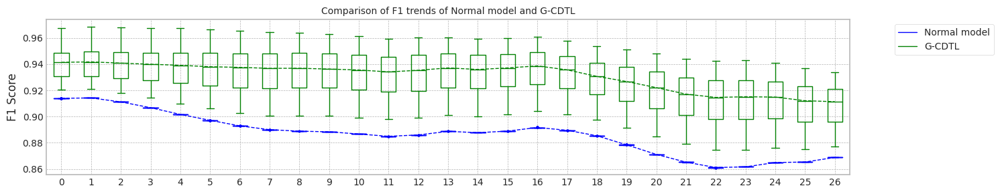

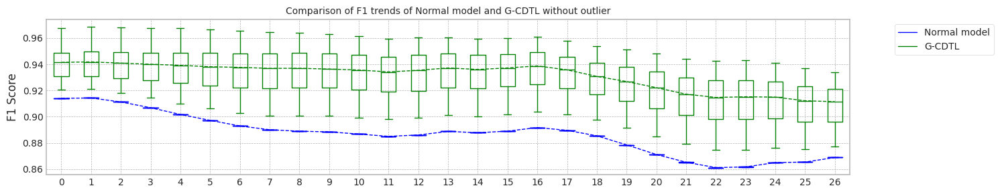

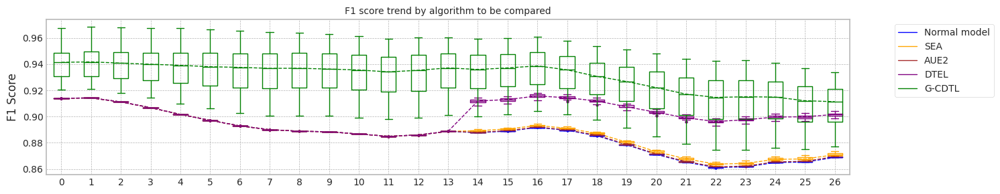

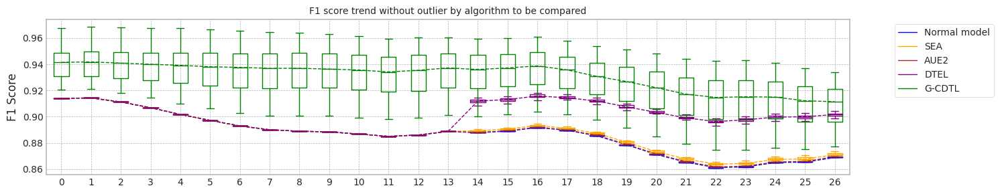

max_mean_trial= 9


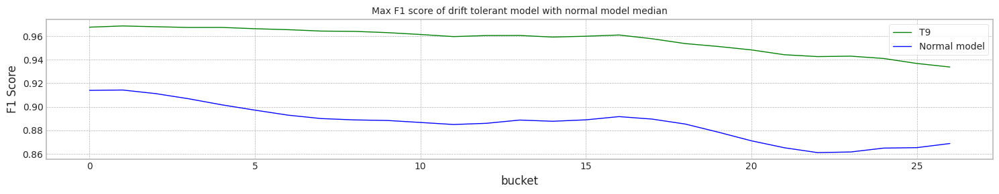

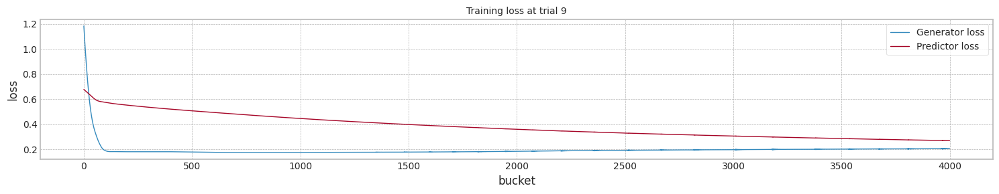

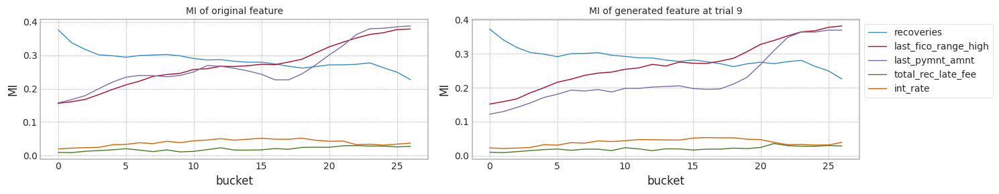

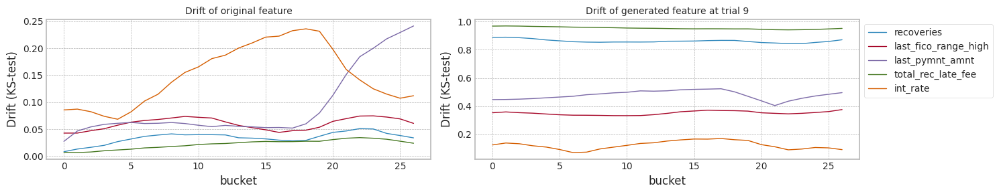

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.886346,0.868795,12.245021
1,1.0,0.913951,0.914255,0.886358,0.868821,12.472594
2,2.0,0.913981,0.914286,0.886340,0.868803,12.471803
3,3.0,0.913951,0.914255,0.886346,0.868821,12.691585
4,4.0,0.913951,0.914255,0.886343,0.868795,12.474317
5,5.0,0.913951,0.914255,0.886346,0.868821,12.444462
6,6.0,0.913951,0.914255,0.886338,0.868795,12.264839
7,7.0,0.913951,0.914255,0.886367,0.868821,12.648617
8,8.0,0.913951,0.914255,0.886345,0.868821,12.270430
9,9.0,0.913951,0.914255,0.886337,0.868821,12.078146


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.887207,0.870665,16.261974
1,1.0,0.913951,0.914255,0.887566,0.871442,16.184603
2,2.0,0.913981,0.914286,0.887259,0.870767,16.073094
3,3.0,0.913951,0.914255,0.887563,0.871679,16.010936
4,4.0,0.913951,0.914255,0.887139,0.870352,16.521270
5,5.0,0.913951,0.914255,0.887867,0.872985,16.642728
6,6.0,0.913951,0.914255,0.887236,0.870640,16.430265
7,7.0,0.913951,0.914255,0.888027,0.873439,16.457694
8,8.0,0.913951,0.914255,0.887139,0.870403,16.188048
9,9.0,0.913951,0.914255,0.887102,0.870334,16.451280


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.886494,0.869186,16.250835
1,1.0,0.913951,0.914255,0.886605,0.869509,15.987074
2,2.0,0.913981,0.914286,0.886483,0.869126,15.894400
3,3.0,0.913951,0.914255,0.886580,0.869558,16.077277
4,4.0,0.913951,0.914255,0.886639,0.869659,16.505480
5,5.0,0.913951,0.914255,0.886586,0.869583,16.259275
6,6.0,0.913951,0.914255,0.886448,0.869093,16.255456
7,7.0,0.913951,0.914255,0.886625,0.869586,16.324625
8,8.0,0.913951,0.914255,0.886492,0.869220,16.479846
9,9.0,0.913951,0.914255,0.886500,0.869263,16.352654


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.913981,0.914286,0.900424,0.900382,19.993799
1,1.0,0.913951,0.914255,0.900629,0.901046,19.541845
2,2.0,0.913981,0.914286,0.901031,0.901998,19.383046
3,3.0,0.913951,0.914255,0.902052,0.904042,19.791451
4,4.0,0.913951,0.914255,0.900181,0.900128,19.994394
5,5.0,0.913951,0.914255,0.901348,0.902708,20.270854
6,6.0,0.913951,0.914255,0.901723,0.903475,19.870533
7,7.0,0.913951,0.914255,0.900859,0.901716,19.709673
8,8.0,0.913951,0.914255,0.900608,0.901116,20.039375
9,9.0,0.913951,0.914255,0.900943,0.901526,19.813398


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.941496,0.941503,0.928197,0.906210,12.291449
1,1.0,0.947656,0.947907,0.933873,0.909864,12.398816
2,2.0,0.920747,0.920896,0.897422,0.877053,12.214325
3,3.0,0.930713,0.930700,0.913486,0.892771,12.245619
4,4.0,0.935603,0.936877,0.928461,0.912298,12.358444
5,5.0,0.928989,0.930063,0.924149,0.910455,12.160676
6,6.0,0.936518,0.936178,0.919333,0.896945,12.001160
7,7.0,0.944634,0.945543,0.938031,0.918071,12.162978
8,8.0,0.925427,0.924709,0.903636,0.881107,12.035777
9,9.0,0.967635,0.968660,0.956929,0.933781,12.161832


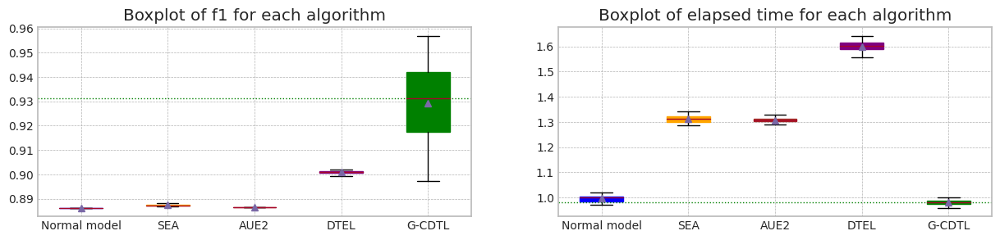

In [ ]:
_,_,_,_,_,_ = drift_tolerant2('LC_B',X1, Y1,train_size, test_size,avaible_range = 2000,lambda_f2=0.8,trial_count=20,lr_g=0.0002,weight_init=True)

## credit card transactions data 실험

### Dataset 준비

In [ ]:

df_cc = pd.read_csv("/content/drive/MyDrive/Drift/CC.csv",index_col=0)

print(df_cc.shape)

(284807, 31)


In [ ]:
df_cc.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
1,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
2,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
3,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
4,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
5,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [ ]:
seed_everything()

mi_scores = make_mi_scores(df_cc.drop(columns=['Time','Class']), df_cc['Class'], discrete_features="auto")
print(mi_scores)

V17       0.008258
V14       0.008136
V12       0.007601
V10       0.007530
V11       0.006831
V16       0.006144
V4        0.004976
V3        0.004952
V18       0.004317
V9        0.004277
V7        0.003951
V2        0.003228
V21       0.002452
V27       0.002444
V5        0.002391
V6        0.002388
V1        0.002127
V8        0.001898
V28       0.001871
V19       0.001472
Amount    0.001445
V20       0.001207
V23       0.000762
V24       0.000642
V26       0.000500
V25       0.000500
V13       0.000408
V22       0.000353
V15       0.000315
Name: MI Scores, dtype: float64


In [ ]:
# MI Top 5, columns
top_columns = list(mi_scores[0:5].index)
top_columns

['V17', 'V14', 'V12', 'V10', 'V11']

### 고정 bucket 크기

columns: ['V11', 'V16', 'V4', 'V3', 'V18']
MI Analysis MI Max 0.00683, Min 0.00432, Mean 0.00544, Std 0.00091
Dataset structure X_train, (40000, 5) X_test, (40000, 5) X_live (274807, 5)
Truncate 34807 rows from live_set (274807, 5)
Search MI & Drift...for X_live_set (24, 40000, 5)


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


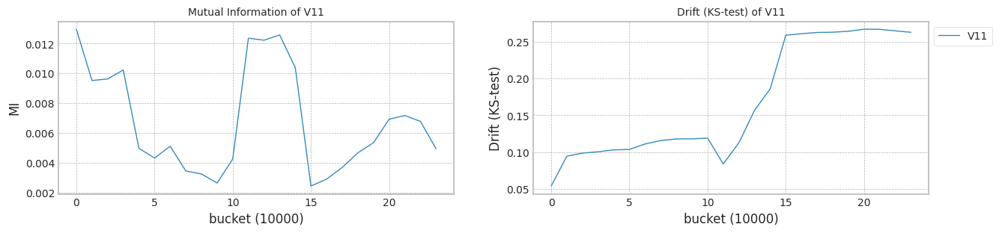

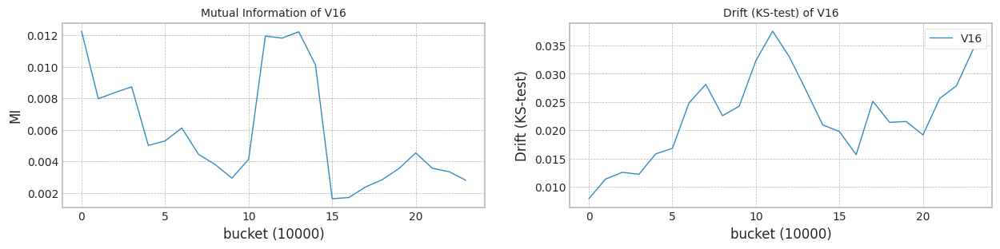

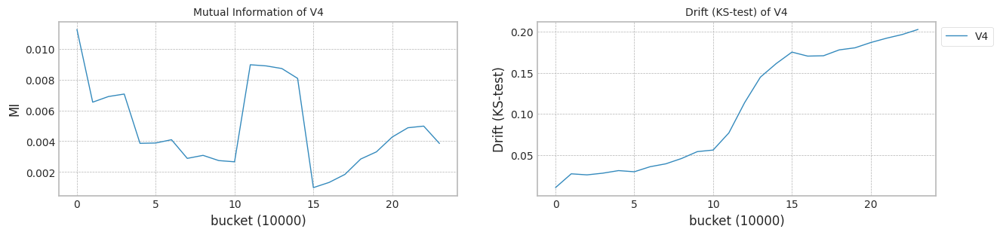

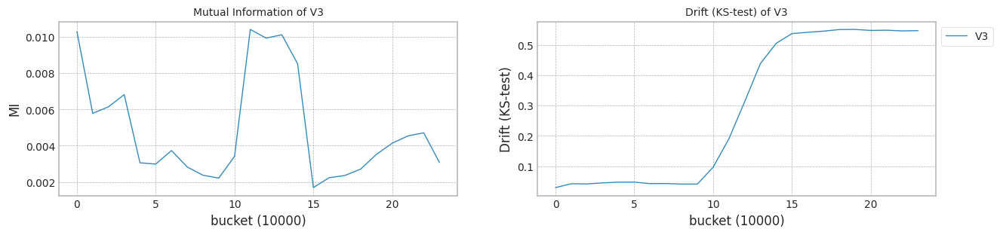

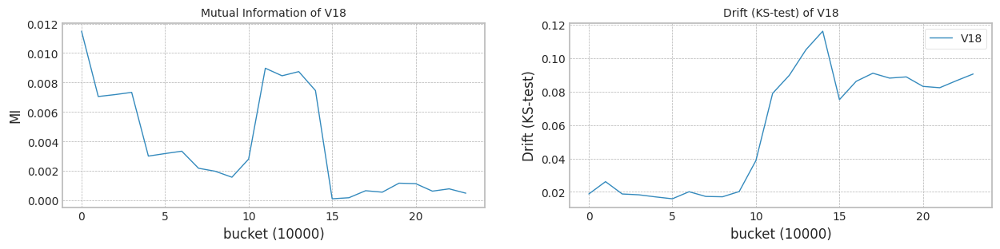

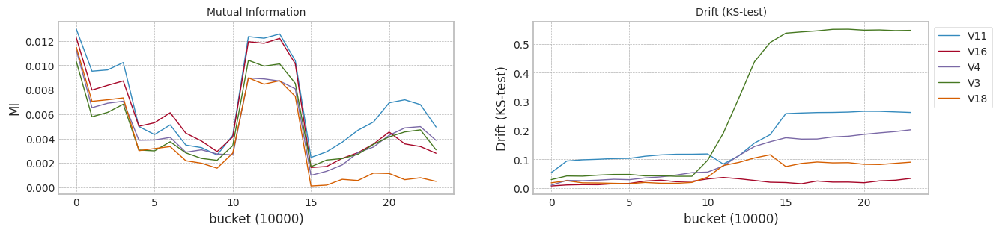

class 1 %: 0.26
(284807, 6)
(284807,)
(286783, 6)
(286783,)
class 1 %: 5.1975
trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:09<00:00, 412.91it/s]


precision_recall_fscore: (array([0.99525174, 0.94555645]), array([0.99823994, 0.86520147]), array([0.9967436 , 0.90359602]), array([38635,  1365]))
Test f1 score: 0.9035960214231064
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.532758360959969
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 209.92it/s]


precision_recall_fscore: (array([0.99679711, 0.96575875]), array([0.99886114, 0.90915751]), array([0.99782805, 0.93660377]), array([38635,  1365]))
Test f1 score: 0.9366037735849057
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.197428
V16    0.040625
V4     0.140023
V3     0.261000
V18    0.069360
dtype: float64
Mean F1 for all data: 0.5520900489112718
Normal model median        : 0.532758360959969
Drift tolerant model median: 0.5520900489112718
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 563.11it/s]


precision_recall_fscore: (array([0.99780333, 0.98084291]), array([0.99935292, 0.93772894]), array([0.99857752, 0.9588015 ]), array([38635,  1365]))
Test f1 score: 0.9588014981273407
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.45198324787296024
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 209.42it/s]


precision_recall_fscore: (array([0.99834523, 0.9826284 ]), array([0.99940468, 0.95311355]), array([0.99887468, 0.96764597]), array([38635,  1365]))
Test f1 score: 0.9676459650427668
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.194511
V16    0.043009
V4     0.135504
V3     0.263365
V18    0.066730
dtype: float64
Mean F1 for all data: 0.49313380975882753
Normal model median        : 0.49237080441646464
Drift tolerant model median: 0.5226119293350496
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 581.67it/s]


precision_recall_fscore: (array([0.99576501, 0.94196078]), array([0.99808464, 0.87985348]), array([0.99692347, 0.90984848]), array([38635,  1365]))
Test f1 score: 0.9098484848484849
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5240713644918757
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.78it/s]


precision_recall_fscore: (array([0.99520804, 0.99493671]), array([0.9998447 , 0.86373626]), array([0.99752098, 0.92470588]), array([38635,  1365]))
Test f1 score: 0.9247058823529412
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.193366
V16    0.045243
V4     0.137480
V3     0.261866
V18    0.068884
dtype: float64
Mean F1 for all data: 0.5843256398523163
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5520900489112718
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 572.88it/s]


precision_recall_fscore: (array([0.99772563, 0.97629969]), array([0.99919762, 0.93553114]), array([0.99846108, 0.95548073]), array([38635,  1365]))
Test f1 score: 0.955480733258511
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4789423734830458
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 207.71it/s]


precision_recall_fscore: (array([0.99713134, 0.96018377]), array([0.99865407, 0.91868132]), array([0.99789212, 0.93897417]), array([38635,  1365]))
Test f1 score: 0.9389741669786597
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.193399
V16    0.039601
V4     0.137697
V3     0.263059
V18    0.059841
dtype: float64
Mean F1 for all data: 0.474114145534587
Normal model median        : 0.5015068689874608
Drift tolerant model median: 0.5226119293350496
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 573.33it/s]


precision_recall_fscore: (array([0.99579398, 0.964687  ]), array([0.99886114, 0.88058608]), array([0.9973252 , 0.92072003]), array([38635,  1365]))
Test f1 score: 0.9207200306396017
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5671577287813395
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.53it/s]


precision_recall_fscore: (array([0.99837087, 0.97968397]), array([0.99930115, 0.95384615]), array([0.9988358 , 0.96659243]), array([38635,  1365]))
Test f1 score: 0.9665924276169265
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.196920
V16    0.045241
V4     0.136122
V3     0.258830
V18    0.063159
dtype: float64
Mean F1 for all data: 0.5022816982914677
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5022816982914677
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 586.24it/s]


precision_recall_fscore: (array([0.99510347, 0.98162072]), array([0.99943057, 0.86080586]), array([0.99726233, 0.91725215]), array([38635,  1365]))
Test f1 score: 0.9172521467603435
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6035587959986726
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.34it/s]


precision_recall_fscore: (array([0.9962784 , 0.93420046]), array([0.99777404, 0.89450549]), array([0.99702566, 0.91392216]), array([38635,  1365]))
Test f1 score: 0.9139221556886227
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.199030
V16    0.042197
V4     0.136181
V3     0.260129
V18    0.072449
dtype: float64
Mean F1 for all data: 0.4902171609333528
Normal model median        : 0.5284148627259224
Drift tolerant model median: 0.49770775402514766
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 592.50it/s]


precision_recall_fscore: (array([0.99628128, 0.95614722]), array([0.99855054, 0.89450549]), array([0.99741462, 0.92429977]), array([38635,  1365]))
Test f1 score: 0.9242997728993188
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5308562146366033
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 214.58it/s]


precision_recall_fscore: (array([0.99886158, 0.97851852]), array([0.99924939, 0.96776557]), array([0.99905544, 0.97311234]), array([38635,  1365]))
Test f1 score: 0.9731123388581951
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.195775
V16    0.041999
V4     0.141149
V3     0.260336
V18    0.064879
dtype: float64
Mean F1 for all data: 0.44800789326442797
Normal model median        : 0.5308562146366033
Drift tolerant model median: 0.49313380975882753
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 592.04it/s]


precision_recall_fscore: (array([0.99633369, 0.96375099]), array([0.99880937, 0.8959707 ]), array([0.99756999, 0.92862566]), array([38635,  1365]))
Test f1 score: 0.9286256643887623
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5180142779039042
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.02it/s]


precision_recall_fscore: (array([0.99824162, 0.97665663]), array([0.99919762, 0.95018315]), array([0.99871939, 0.96323802]), array([38635,  1365]))
Test f1 score: 0.9632380245079837
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.194233
V16    0.041168
V4     0.136360
V3     0.262089
V18    0.070614
dtype: float64
Mean F1 for all data: 0.5380283175695796
Normal model median        : 0.5274637895642396
Drift tolerant model median: 0.49770775402514766
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 583.68it/s]


precision_recall_fscore: (array([0.99674486, 0.95897833]), array([0.99862819, 0.90769231]), array([0.99768563, 0.93263079]), array([38635,  1365]))
Test f1 score: 0.9326307866014301
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5024153711346581
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.31it/s]


precision_recall_fscore: (array([0.9973396 , 0.98286604]), array([0.99943057, 0.92454212]), array([0.99838399, 0.95281238]), array([38635,  1365]))
Test f1 score: 0.9528123820309552
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.195939
V16    0.041831
V4     0.139088
V3     0.259484
V18    0.070163
dtype: float64
Mean F1 for all data: 0.5960151695253991
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5022816982914677
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 569.95it/s]


precision_recall_fscore: (array([0.99919776, 0.98232695]), array([0.9993788 , 0.97728938]), array([0.99928827, 0.97980169]), array([38635,  1365]))
Test f1 score: 0.9798016893132574
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4177171429409127
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.99it/s]


precision_recall_fscore: (array([0.99630787, 0.96296296]), array([0.99878349, 0.8952381 ]), array([0.99754414, 0.92786636]), array([38635,  1365]))
Test f1 score: 0.9278663629460896
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.197429
V16    0.043591
V4     0.134673
V3     0.260246
V18    0.072718
dtype: float64
Mean F1 for all data: 0.602271613502359
Normal model median        : 0.5210428211978899
Drift tolerant model median: 0.5201550079305237
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 551.07it/s]


precision_recall_fscore: (array([0.99813925, 0.99004594]), array([0.99966352, 0.94725275]), array([0.9989008 , 0.96817671]), array([38635,  1365]))
Test f1 score: 0.9681767128416323
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:23<00:00,  1.04it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.43964944742512824
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 204.34it/s]


precision_recall_fscore: (array([0.99653881, 0.95797665]), array([0.9986023, 0.9018315]), array([0.99756949, 0.9290566 ]), array([38635,  1365]))
Test f1 score: 0.9290566037735849
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.04it/s]


mean of drift:
V11    0.197244
V16    0.045017
V4     0.134741
V3     0.261410
V18    0.074856
dtype: float64
Mean F1 for all data: 0.45872006810033755
Normal model median        : 0.5180142779039042
Drift tolerant model median: 0.5022816982914677
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 565.32it/s]


precision_recall_fscore: (array([0.99733926, 0.97905353]), array([0.99930115, 0.92454212]), array([0.99831924, 0.95101733]), array([38635,  1365]))
Test f1 score: 0.9510173323285607
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.04it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5352095169567376
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.85it/s]


precision_recall_fscore: (array([0.99837037, 0.97091723]), array([0.99899055, 0.95384615]), array([0.99868036, 0.96230599]), array([38635,  1365]))
Test f1 score: 0.9623059866962306
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.195828
V16    0.038910
V4     0.135635
V3     0.261032
V18    0.061904
dtype: float64
Mean F1 for all data: 0.5038161341778603
Normal model median        : 0.5210428211978899
Drift tolerant model median: 0.5030489162346641
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 551.78it/s]


precision_recall_fscore: (array([0.99628147, 0.95764706]), array([0.9986023 , 0.89450549]), array([0.99744054, 0.925     ]), array([38635,  1365]))
Test f1 score: 0.9249999999999999
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:23<00:00,  1.02it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5444095144942068
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.69it/s]


precision_recall_fscore: (array([0.99726119, 0.97070162]), array([0.99901644, 0.92234432]), array([0.99813804, 0.94590533]), array([38635,  1365]))
Test f1 score: 0.9459053343350864
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.199619
V16    0.040914
V4     0.132203
V3     0.260784
V18    0.071576
dtype: float64
Mean F1 for all data: 0.48766114717168235
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5022816982914677
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 567.62it/s]


precision_recall_fscore: (array([0.99633331, 0.9607227 ]), array([0.99870584, 0.8959707 ]), array([0.99751816, 0.92721759]), array([38635,  1365]))
Test f1 score: 0.9272175890826384
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5618829105599521
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 206.64it/s]


precision_recall_fscore: (array([0.99726034, 0.9618029 ]), array([0.99870584, 0.92234432]), array([0.99798257, 0.94166043]), array([38635,  1365]))
Test f1 score: 0.9416604338070306
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.04it/s]


mean of drift:
V11    0.195336
V16    0.044296
V4     0.135944
V3     0.260959
V18    0.075574
dtype: float64
Mean F1 for all data: 0.6033273034960055
Normal model median        : 0.5274637895642396
Drift tolerant model median: 0.5030489162346641
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 545.45it/s]


precision_recall_fscore: (array([0.99782867, 0.97488584]), array([0.99914585, 0.93846154]), array([0.99848683, 0.95632699]), array([38635,  1365]))
Test f1 score: 0.9563269876819709
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.54024349856902
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 206.27it/s]


precision_recall_fscore: (array([0.9957661 , 0.94940711]), array([0.99834347, 0.87985348]), array([0.99705312, 0.91330798]), array([38635,  1365]))
Test f1 score: 0.9133079847908745
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.197183
V16    0.044035
V4     0.137020
V3     0.260385
V18    0.073438
dtype: float64
Mean F1 for all data: 0.6161297272313061
Normal model median        : 0.5308562146366033
Drift tolerant model median: 0.5038161341778603
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 554.48it/s]


precision_recall_fscore: (array([0.99674629, 0.97176471]), array([0.9990682 , 0.90769231]), array([0.99790589, 0.93863636]), array([38635,  1365]))
Test f1 score: 0.9386363636363637
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5619983865419826
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.61it/s]


precision_recall_fscore: (array([0.99731322, 0.97600619]), array([0.99919762, 0.92380952]), array([0.99825453, 0.94919082]), array([38635,  1365]))
Test f1 score: 0.9491908167105758
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.196875
V16    0.043693
V4     0.135924
V3     0.262376
V18    0.067175
dtype: float64
Mean F1 for all data: 0.47835789292054837
Normal model median        : 0.5318072877982861
Drift tolerant model median: 0.5030489162346641
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 562.67it/s]


precision_recall_fscore: (array([0.99684885, 0.96806854]), array([0.99893879, 0.91062271]), array([0.99789272, 0.93846735]), array([38635,  1365]))
Test f1 score: 0.9384673461683654
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.46310852049992013
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.35it/s]


precision_recall_fscore: (array([0.99782918, 0.9816092 ]), array([0.9993788 , 0.93846154]), array([0.99860339, 0.95955056]), array([38635,  1365]))
Test f1 score: 0.9595505617977529
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.201782
V16    0.040190
V4     0.140521
V3     0.260480
V18    0.066190
dtype: float64
Mean F1 for all data: 0.5263367419929069
Normal model median        : 0.5308562146366033
Drift tolerant model median: 0.5038161341778603
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 552.21it/s]


precision_recall_fscore: (array([0.99769943, 0.97108067]), array([0.99901644, 0.93479853]), array([0.9983575 , 0.95259425]), array([38635,  1365]))
Test f1 score: 0.9525942515864128
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.05it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5114789860377323
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 204.81it/s]


precision_recall_fscore: (array([0.9973137 , 0.98132296]), array([0.9993788 , 0.92380952]), array([0.99834518, 0.95169811]), array([38635,  1365]))
Test f1 score: 0.9516981132075472
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.198973
V16    0.041964
V4     0.140053
V3     0.259972
V18    0.070621
dtype: float64
Mean F1 for all data: 0.4858455191799787
Normal model median        : 0.5274637895642396
Drift tolerant model median: 0.5030489162346641
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 566.05it/s]


precision_recall_fscore: (array([0.99816457, 0.98253607]), array([0.99940468, 0.94798535]), array([0.99878424, 0.96495153]), array([38635,  1365]))
Test f1 score: 0.9649515287099181
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4185946582488142
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 208.85it/s]


precision_recall_fscore: (array([0.99829347, 0.98037736]), array([0.99932704, 0.95164835]), array([0.99880999, 0.96579926]), array([38635,  1365]))
Test f1 score: 0.9657992565055762
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.197908
V16    0.041027
V4     0.137950
V3     0.260875
V18    0.067716
dtype: float64
Mean F1 for all data: 0.5663808400159335
Normal model median        : 0.5240713644918757
Drift tolerant model median: 0.5038161341778603
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:07<00:00, 559.56it/s]


precision_recall_fscore: (array([0.99664369, 0.97474349]), array([0.99917174, 0.9047619 ]), array([0.99790611, 0.93844985]), array([38635,  1365]))
Test f1 score: 0.9384498480243161
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.07it/s]


mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5203053893305997
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 205.48it/s]


precision_recall_fscore: (array([0.99782918, 0.9816092 ]), array([0.9993788 , 0.93846154]), array([0.99860339, 0.95955056]), array([38635,  1365]))
Test f1 score: 0.9595505617977529
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:22<00:00,  1.06it/s]


mean of drift:
V11    0.191964
V16    0.041752
V4     0.133827
V3     0.262796
V18    0.062902
dtype: float64
Mean F1 for all data: 0.4933691286852933
Normal model median        : 0.5221883769112377
Drift tolerant model median: 0.5030489162346641
######################### Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Trial 0 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.15s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5544883322857022
SEA median: 0.5544883322857022
######################### Trial 0 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.16s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6046955946781541
AUE median: 0.6046955946781541
######################### Trial 0 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.28s/it]


Early stop at  2954.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4968341274778754
DTEL median: 0.4968341274778754
######################### Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Trial 1 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6076210367343412
SEA median: 0.5810546845100217
######################### Trial 1 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  2011.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5001779740134524
AUE median: 0.5524367843458033
######################### Trial 1 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  3491.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5447616306909707
DTEL median: 0.5207978790844231
######################### Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Trial 2 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5814730801057258
SEA median: 0.5814730801057258
######################### Trial 2 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.15s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6736839953094672
AUE median: 0.6046955946781541
######################### Trial 2 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  2780.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4592763468314402
DTEL median: 0.4968341274778754
######################### Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Trial 3 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6628609731192134
SEA median: 0.5945470584200335
######################### Trial 3 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.15s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5479324236694857
AUE median: 0.5763140091738199
######################### Trial 3 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:28<00:00,  1.19s/it]


Early stop at  2061.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.572594342187803
DTEL median: 0.5207978790844231
######################### Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Trial 4 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:23<00:00,  1.02it/s]


Early stop at  1587.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6297119714706197
SEA median: 0.6076210367343412
######################### Trial 4 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.7145379570554692
AUE median: 0.6046955946781541
######################### Trial 4 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  3234.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5754809626378885
DTEL median: 0.5447616306909707
######################### Trial 5 for Normal model ###########################
retrain_interval: 13
######################### Trial 5 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.09s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.703875232195467
SEA median: 0.6186665041024805
######################### Trial 5 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.7286722093629608
AUE median: 0.6391897949938107
######################### Trial 5 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.25s/it]


Early stop at  2863.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6239922664613804
DTEL median: 0.5586779864393869
######################### Trial 6 for Normal model ###########################
retrain_interval: 13
######################### Trial 6 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.09s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6134819147642012
SEA median: 0.6134819147642012
######################### Trial 6 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  2885.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6679858722668371
AUE median: 0.6679858722668371
######################### Trial 6 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.23s/it]


Early stop at  2770.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5502400889814728
DTEL median: 0.5502400889814728
######################### Trial 7 for Normal model ###########################
retrain_interval: 13
######################### Trial 7 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  2832.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5317261654353196
SEA median: 0.6105514757492712
######################### Trial 7 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6616562713189549
AUE median: 0.664821071792896
######################### Trial 7 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.27s/it]


Early stop at  3345.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6168847045177938
DTEL median: 0.561417215584638
######################### Trial 8 for Normal model ###########################
retrain_interval: 13
######################### Trial 8 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6097143842119539
SEA median: 0.6097143842119539
######################### Trial 8 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6742232024221746
AUE median: 0.6679858722668371
######################### Trial 8 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.25s/it]


Early stop at  3234.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5811746506147512
DTEL median: 0.572594342187803
######################### Trial 9 for Normal model ###########################
retrain_interval: 13
######################### Trial 9 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5888262741582504
SEA median: 0.6086677104731475
######################### Trial 9 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6574389586755064
AUE median: 0.664821071792896
######################### Trial 9 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6049977827162228
DTEL median: 0.5740376524128458
######################### Trial 10 for Normal model ###########################
retrain_interval: 13
######################### Trial 10 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:24<00:00,  1.01s/it]


Early stop at  1965.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5592479341466894
SEA median: 0.6076210367343412
######################### Trial 10 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6473217631517151
AUE median: 0.6616562713189549
######################### Trial 10 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5640396727114305
DTEL median: 0.572594342187803
######################### Trial 11 for Normal model ###########################
retrain_interval: 13
######################### Trial 11 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3393.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6471776889061
SEA median: 0.6086677104731475
######################### Trial 11 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  2553.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6878308012542593
AUE median: 0.664821071792896
######################### Trial 11 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.22s/it]


Early stop at  2394.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6318671620593203
DTEL median: 0.5740376524128458
######################### Trial 12 for Normal model ###########################
retrain_interval: 13
######################### Trial 12 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.05s/it]


Early stop at  3036.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.48474160857472987
SEA median: 0.6076210367343412
######################### Trial 12 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6993752256981779
AUE median: 0.6679858722668371
######################### Trial 12 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.23s/it]


Early stop at  2935.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5849874853754754
DTEL median: 0.5754809626378885
######################### Trial 13 for Normal model ###########################
retrain_interval: 13
######################### Trial 13 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.04s/it]


Early stop at  2882.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6068184238112891
SEA median: 0.6072197302728152
######################### Trial 13 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6976291897131107
AUE median: 0.6708349337881522
######################### Trial 13 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.27s/it]


Early stop at  3598.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6069379235489591
DTEL median: 0.5783278066263198
######################### Trial 14 for Normal model ###########################
retrain_interval: 13
######################### Trial 14 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.04s/it]


Early stop at  2847.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6513188704046257
SEA median: 0.6076210367343412
######################### Trial 14 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3087.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6817691627941594
AUE median: 0.6736839953094672
######################### Trial 14 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  2898.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6182580170785441
DTEL median: 0.5811746506147512
######################### Trial 15 for Normal model ###########################
retrain_interval: 13
######################### Trial 15 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.593516264988165
SEA median: 0.6072197302728152
######################### Trial 15 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.16s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.7077875214246734
AUE median: 0.673953598865821
######################### Trial 15 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.32s/it]


Early stop at  3526.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6430978376653995
DTEL median: 0.5830810679951133
######################### Trial 16 for Normal model ###########################
retrain_interval: 13
######################### Trial 16 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.639071912453777
SEA median: 0.6076210367343412
######################### Trial 16 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  2549.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6133225266852281
AUE median: 0.6736839953094672
######################### Trial 16 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.26s/it]


Early stop at  2765.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5376685924574329
DTEL median: 0.5811746506147512
######################### Trial 17 for Normal model ###########################
retrain_interval: 13
######################### Trial 17 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6607225812964498
SEA median: 0.6086677104731475
######################### Trial 17 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.16s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.690399587445833
AUE median: 0.673953598865821
######################### Trial 17 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:31<00:00,  1.33s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.5999437028827116
DTEL median: 0.5830810679951133
######################### Trial 18 for Normal model ###########################
retrain_interval: 13
######################### Trial 18 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6276909233819631
SEA median: 0.6097143842119539
######################### Trial 18 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.14s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6644438232112444
AUE median: 0.6736839953094672
######################### Trial 18 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:30<00:00,  1.28s/it]


Early stop at  3105.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.522703937739516
DTEL median: 0.5811746506147512
######################### Trial 19 for Normal model ###########################
retrain_interval: 13
######################### Trial 19 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6626154791201322
SEA median: 0.6115981494880776
######################### Trial 19 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:27<00:00,  1.17s/it]


Early stop at  nan
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.6738022456122557
AUE median: 0.6737431204608615
######################### Trial 19 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 40000, 6])


100%|██████████| 24/24 [00:29<00:00,  1.25s/it]


Early stop at  2583.0
Mean of drift:
V11    0.194476
V16    0.043799
V4     0.137994
V3     0.260017
V18    0.069606
dtype: float64
Mean F1 for all data: 0.4764699703478492
DTEL median: 0.5783278066263198


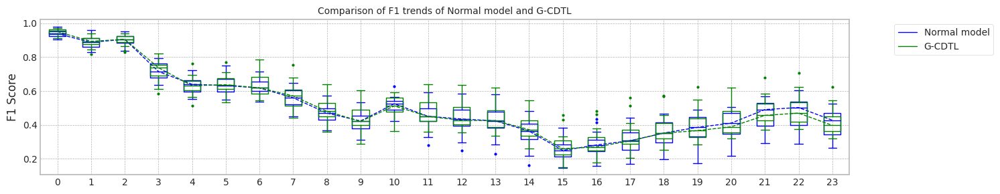

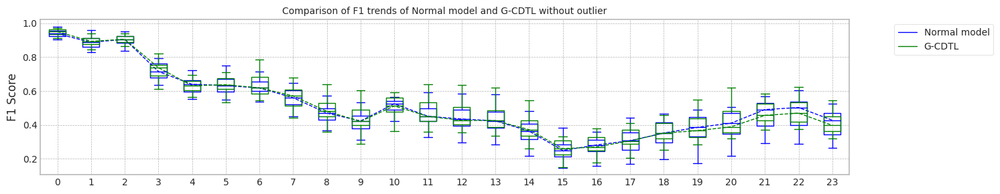

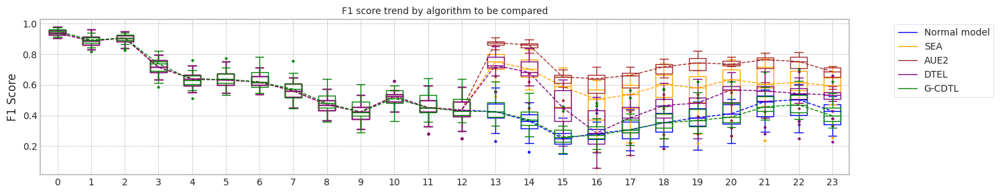

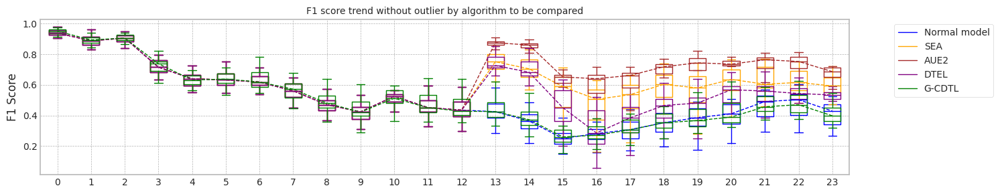

max_mean_trial= 14


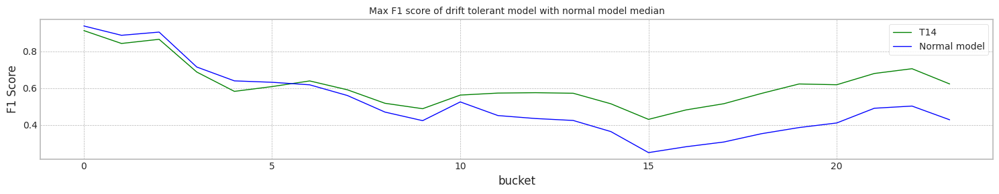

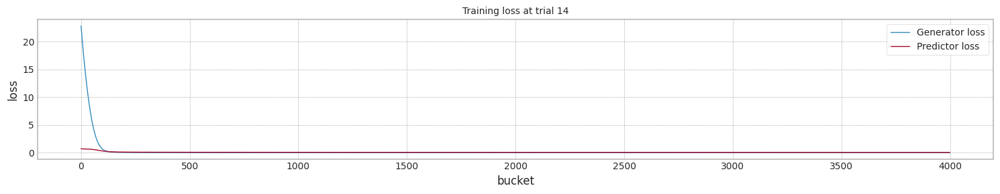

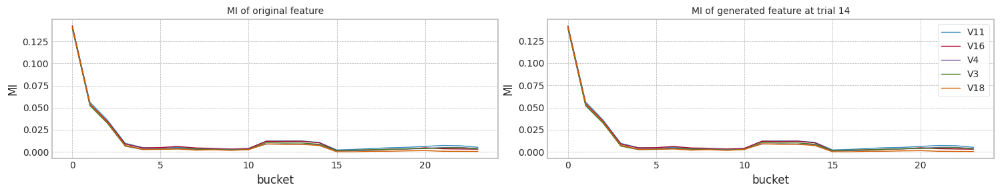

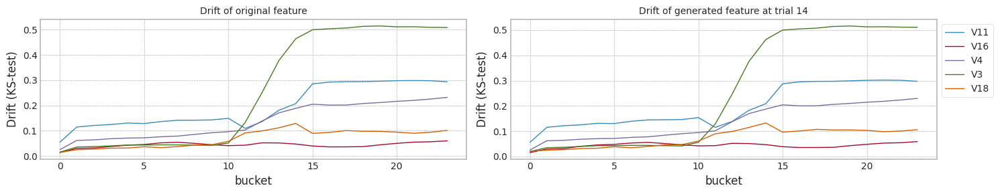

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.532758,0.500000,22.604949
1,1.0,0.958801,0.920333,0.451983,0.279570,22.301902
2,2.0,0.909848,0.830144,0.524071,0.516556,22.392032
3,3.0,0.955481,0.903073,0.478942,0.361446,22.393171
4,4.0,0.920720,0.866005,0.567158,0.465409,22.264989
5,5.0,0.917252,0.891358,0.603559,0.524272,22.038476
6,6.0,0.924300,0.848411,0.530856,0.493333,22.101784
7,7.0,0.928626,0.861009,0.518014,0.443114,22.067680
8,8.0,0.932631,0.870392,0.502415,0.349650,22.113849
9,9.0,0.979802,0.961098,0.417717,0.288557,22.823255


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.554488,0.533333,27.767516
1,1.0,0.958801,0.920333,0.607621,0.626506,27.228899
2,2.0,0.909848,0.830144,0.581473,0.589744,27.255702
3,3.0,0.955481,0.903073,0.662861,0.720930,27.066133
4,4.0,0.920720,0.866005,0.629712,0.513514,23.558422
5,5.0,0.917252,0.891358,0.703875,0.690476,26.308509
6,6.0,0.924300,0.848411,0.613482,0.571429,26.289440
7,7.0,0.928626,0.861009,0.531726,0.472222,25.187308
8,8.0,0.932631,0.870392,0.609714,0.589744,26.411865
9,9.0,0.979802,0.961098,0.588826,0.589744,26.533179


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.604696,0.571429,27.821007
1,1.0,0.958801,0.920333,0.500178,0.382353,25.296751
2,2.0,0.909848,0.830144,0.673684,0.712644,27.562958
3,3.0,0.955481,0.903073,0.547932,0.428571,27.656562
4,4.0,0.920720,0.866005,0.714538,0.697674,27.020303
5,5.0,0.917252,0.891358,0.728672,0.712644,26.940949
6,6.0,0.924300,0.848411,0.667986,0.720930,25.431475
7,7.0,0.928626,0.861009,0.661656,0.674699,26.897139
8,8.0,0.932631,0.870392,0.674223,0.666667,27.224512
9,9.0,0.979802,0.961098,0.657439,0.705882,27.092041


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.903596,0.833133,0.496834,0.382353,30.685280
1,1.0,0.958801,0.920333,0.544762,0.513514,31.166950
2,2.0,0.909848,0.830144,0.459276,0.225806,30.278729
3,3.0,0.955481,0.903073,0.572594,0.552632,28.498610
4,4.0,0.920720,0.866005,0.575481,0.533333,30.270837
5,5.0,0.917252,0.891358,0.623992,0.571429,29.981498
6,6.0,0.924300,0.848411,0.550240,0.533333,29.571269
7,7.0,0.928626,0.861009,0.616885,0.552632,30.517630
8,8.0,0.932631,0.870392,0.581175,0.533333,30.079707
9,9.0,0.979802,0.961098,0.604998,0.658537,31.507156


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.936604,0.892944,0.552090,0.437870,22.401973
1,1.0,0.967646,0.921429,0.493134,0.337349,22.624408
2,2.0,0.924706,0.875635,0.584326,0.543210,22.680193
3,3.0,0.938974,0.898585,0.474114,0.328358,22.617796
4,4.0,0.966592,0.912075,0.502282,0.383721,22.375201
5,5.0,0.913922,0.819362,0.490217,0.445714,21.684527
6,6.0,0.973112,0.905041,0.448008,0.320000,21.947330
7,7.0,0.963238,0.941725,0.538028,0.380368,22.034639
8,8.0,0.952812,0.902200,0.596015,0.462687,22.155315
9,9.0,0.927866,0.863861,0.602272,0.545455,22.729316


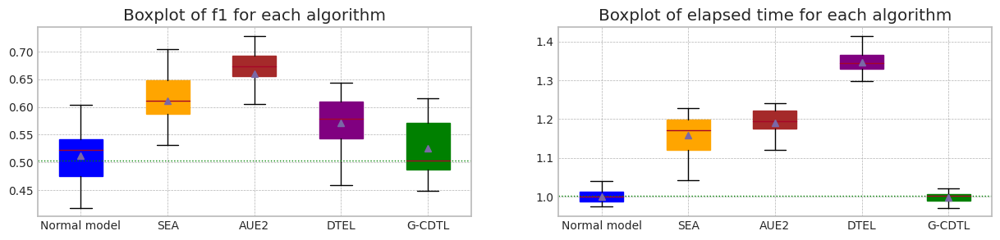

In [ ]:
seed_everything()

#s = np.sort(np.random.choice(len(COLUMNS),2,replace= False))
#top_columns = list(mi_scores[0:5].index)
top_columns = ['V11','V16','V4','V3','V18']
print('columns:',top_columns)
#print(s.shape)
X4 = df_cc[top_columns]
Y4 = df_cc['Class'].values
train_size = 40000
test_size = 10000

X1,Y1 = check_mi_drift(X4, Y4, train_size, test_size,scaling=False)

bucket_size = 5000
X1['b'] = [int(b/bucket_size) for b in X1.index.values]

print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

# class 1이 너무 숫자가 적어서 (unbalanced data) X 20으로 증가 시킨다.
print(X1.shape)
print(Y1.shape)

X2 = X1[0:train_size]
Y2 = Y1[0:train_size]

for idx,(row,yv) in enumerate(zip(X1[0:train_size].values,Y1[0:train_size])):
    if yv == 1:
        #print(idx)
        for j in range(19):
            X2 = pd.concat([X2[0:idx],pd.DataFrame([row],columns=X2.columns), X2[idx:]])
            Y2 = np.insert(Y2,idx,yv)
X1 = pd.concat([X2, X1[train_size:]])
Y1 = np.concatenate((Y2,Y1[train_size:]))

print(X1.shape)
print(Y1.shape)

print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

_,_,_,_,_,_ = drift_tolerant2('CC_A',X1, Y1,train_size, test_size,avaible_range = 1600,lambda_f2=0.8,trial_count=20,lr_g=0.001,weight_init= False)

### Time에 따른 bucket

In [ ]:
bucket_unit = 2000
df_cc['b'] = [int(b/bucket_unit) for b in df_cc['Time'].values]

df_cc

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V22,V23,V24,V25,V26,V27,V28,Amount,Class,b
1,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0,0
2,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0,0
3,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0,0
4,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0,0
5,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284803,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,...,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0,86
284804,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,...,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0,86
284805,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,...,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0,86
284806,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,...,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0,86


In [ ]:
b_cnt = df_cc.groupby(['b'])['b'].count()

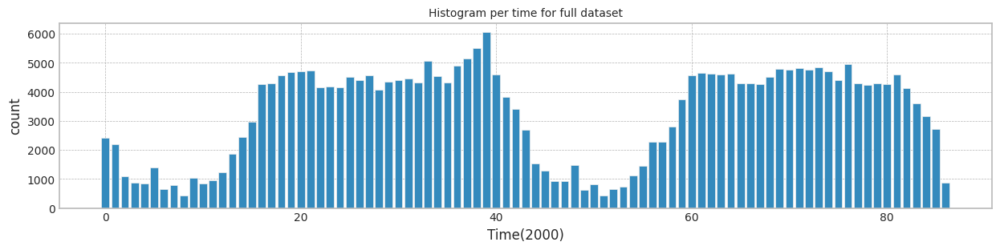

In [ ]:
plt.figure(figsize=main_figsize)
plt.bar(b_cnt.index,b_cnt.values)
plt.ylabel('count')
plt.xlabel('Time(2000)')
plt.title(f'Histogram per time for full dataset',fontdict={'fontsize':10})

plt.show()

In [ ]:
df_cc[df_cc['b'] < 20].shape[0]

39869

columns: ['V11', 'V16', 'V4', 'V3', 'V18']
Dataset has buckets!
MI Analysis MI Max 0.00683, Min 0.00432, Mean 0.00544, Std 0.00091
Dataset structure X_train, (39869, 5) X_test, (39869, 5) X_live (274807, 5)
bucket range in live set 7~86
Truncate 0 rows from live_set (274807, 5)
Search MI & Drift...for X_live_set (80,)


100%|██████████| 80/80 [00:07<00:00, 10.35it/s]


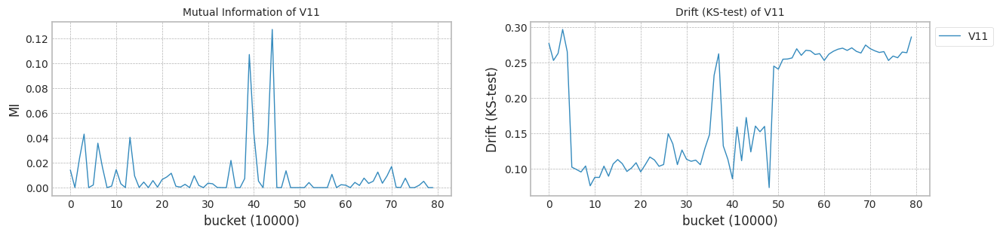

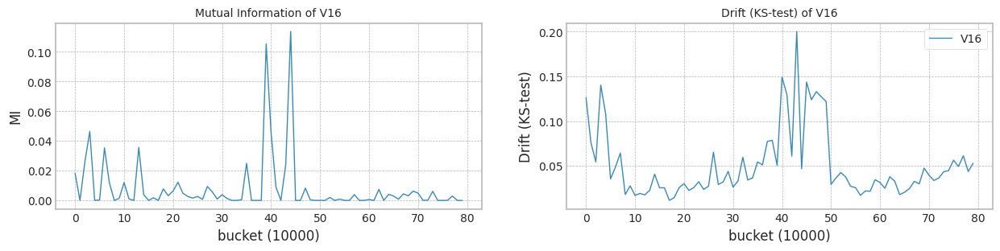

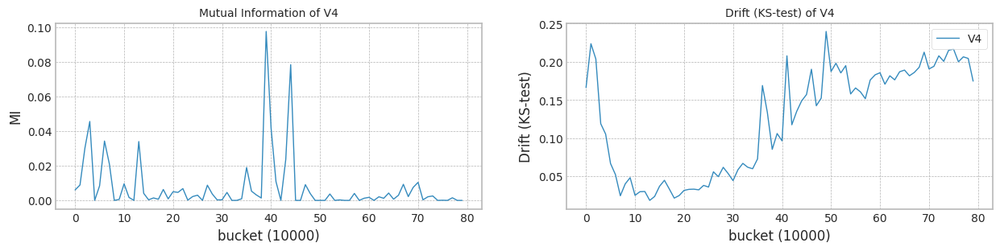

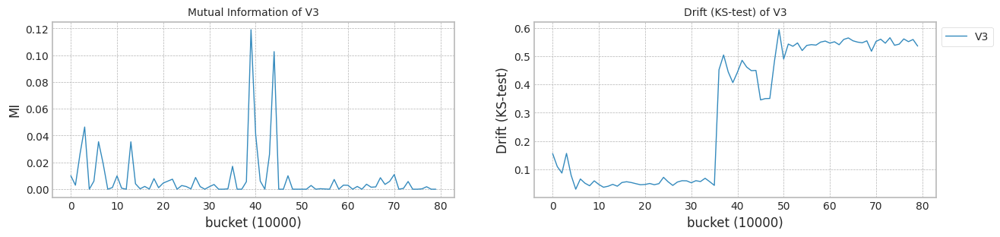

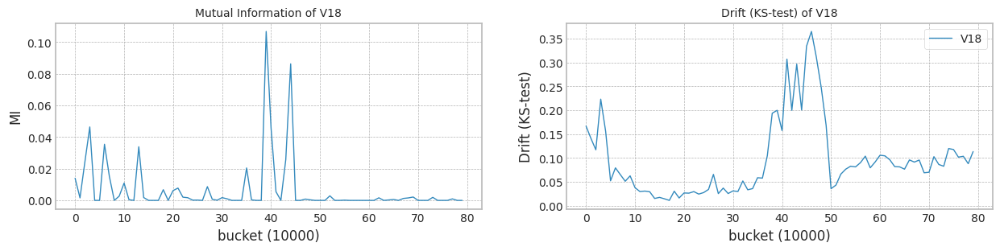

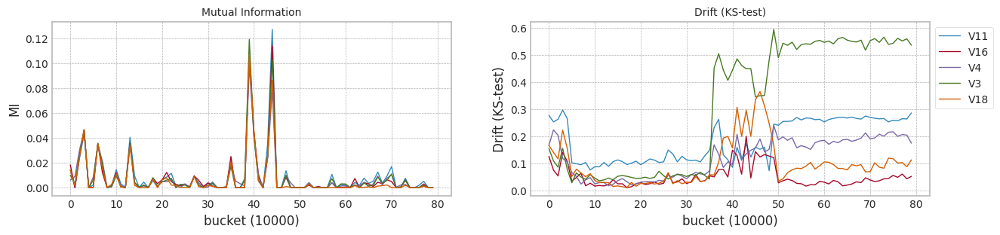

In [ ]:
seed_everything()

#s = np.sort(np.random.choice(len(COLUMNS),2,replace= False))
#top_columns = list(mi_scores[0:10].index)
top_columns = ['V11','V16','V4','V3','V18']
print('columns:',top_columns)
#print(s.shape)
X4 = df_cc[top_columns+['b']]
Y4 = df_cc['Class'].values
train_size = df_cc[df_cc['b'] < 20].shape[0]
test_size = 10000

X1,Y1 = check_mi_drift(X4, Y4, train_size, test_size)

class 1 %: 0.2608542978253781
(284807, 6)
(284807,)
(286783, 6)
(286783,)
class 1 %: 5.214577742105395
trial_count: 20
lambda_f2 0.8
######################### Trial 0 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:10<00:00, 399.26it/s]


precision_recall_fscore: (array([0.99476914, 0.92891374]), array([0.99768855, 0.85201465]), array([0.99622671, 0.88880397]), array([38504,  1365]))
Test f1 score: 0.8888039740160488
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4787726838313226
######################### Trial 0 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 215.82it/s]


precision_recall_fscore: (array([0.99528888, 0.956346  ]), array([0.99859755, 0.86666667]), array([0.99694047, 0.90930054]), array([38504,  1365]))
Test f1 score: 0.9093005380476556
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.126478
V16    0.442816
V4     0.629313
V3     0.469794
V18    0.085505
dtype: float64
Mean F1 for all data: 0.23525024380990414
Normal model median        : 0.4787726838313226
Drift tolerant model median: 0.23525024380990414
######################### Trial 1 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 595.89it/s]


precision_recall_fscore: (array([0.9942557 , 0.93535188]), array([0.99794827, 0.83736264]), array([0.99609856, 0.88364901]), array([38504,  1365]))
Test f1 score: 0.8836490143022807
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5444237395703128
######################### Trial 1 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.32it/s]


precision_recall_fscore: (array([0.99531428, 0.9540693 ]), array([0.99851963, 0.86739927]), array([0.99691438, 0.90867229]), array([38504,  1365]))
Test f1 score: 0.908672294704528
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.153201
V16    0.561932
V4     0.329702
V3     0.538752
V18    0.105970
dtype: float64
Mean F1 for all data: 0.3015784856452673
Normal model median        : 0.5115982117008177
Drift tolerant model median: 0.26841436472758573
######################### Trial 2 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 589.83it/s]


precision_recall_fscore: (array([0.99425466, 0.93002441]), array([0.99776647, 0.83736264]), array([0.99600747, 0.88126446]), array([38504,  1365]))
Test f1 score: 0.8812644564379336
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5014796235479714
######################### Trial 2 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.40it/s]


precision_recall_fscore: (array([0.99477374, 0.95484401]), array([0.99857158, 0.85201465]), array([0.99666904, 0.90050329]), array([38504,  1365]))
Test f1 score: 0.9005032907471933
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.09it/s]


mean of drift:
V11    0.111757
V16    0.403896
V4     0.290956
V3     0.374742
V18    0.081789
dtype: float64
Mean F1 for all data: 0.73661577829712
Normal model median        : 0.5014796235479714
Drift tolerant model median: 0.3015784856452673
######################### Trial 3 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 589.16it/s]


precision_recall_fscore: (array([0.99423191, 0.94536424]), array([0.99828589, 0.83663004]), array([0.99625478, 0.88767975]), array([38504,  1365]))
Test f1 score: 0.887679751263117
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.588224721366451
######################### Trial 3 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.29it/s]


precision_recall_fscore: (array([0.99528961, 0.96100731]), array([0.99875338, 0.86666667]), array([0.99701849, 0.91140216]), array([38504,  1365]))
Test f1 score: 0.911402157164869
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.357797
V16    0.207724
V4     0.391749
V3     0.226418
V18    0.038010
dtype: float64
Mean F1 for all data: 0.6676377059709543
Normal model median        : 0.5229516815591421
Drift tolerant model median: 0.4846080958081108
######################### Trial 4 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.12it/s]


precision_recall_fscore: (array([0.99474774, 0.95324036]), array([0.99851963, 0.85128205]), array([0.99663012, 0.8993808 ]), array([38504,  1365]))
Test f1 score: 0.8993808049535604
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6082246397721268
######################### Trial 4 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.18it/s]


precision_recall_fscore: (array([0.99529022, 0.96492659]), array([0.99888323, 0.86666667]), array([0.99708349, 0.91316094]), array([38504,  1365]))
Test f1 score: 0.9131609417213431
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.180493
V16    0.405048
V4     0.101466
V3     0.254991
V18    0.111243
dtype: float64
Mean F1 for all data: 0.5475566421733374
Normal model median        : 0.5444237395703128
Drift tolerant model median: 0.5475566421733374
######################### Trial 5 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 591.85it/s]


precision_recall_fscore: (array([0.99476914, 0.92891374]), array([0.99768855, 0.85201465]), array([0.99622671, 0.88880397]), array([38504,  1365]))
Test f1 score: 0.8888039740160488
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4967732233692998
######################### Trial 5 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.68it/s]


precision_recall_fscore: (array([0.99531404, 0.95253419]), array([0.99846769, 0.86739927]), array([0.99688837, 0.90797546]), array([38504,  1365]))
Test f1 score: 0.9079754601226994
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.075597
V16    0.300187
V4     0.120535
V3     0.387739
V18    0.082947
dtype: float64
Mean F1 for all data: 0.639704870280655
Normal model median        : 0.5229516815591421
Drift tolerant model median: 0.5936307562269962
######################### Trial 6 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 598.71it/s]


precision_recall_fscore: (array([0.9942554 , 0.93382353]), array([0.99789632, 0.83736264]), array([0.99607253, 0.8829664 ]), array([38504,  1365]))
Test f1 score: 0.8829663962920047
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5274612156087862
######################### Trial 6 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.48it/s]


precision_recall_fscore: (array([0.99474787, 0.95402299]), array([0.99854561, 0.85128205]), array([0.99664312, 0.899729  ]), array([38504,  1365]))
Test f1 score: 0.8997289972899728
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.090469
V16    0.080743
V4     0.413102
V3     0.473168
V18    0.074439
dtype: float64
Mean F1 for all data: 0.48576356004169
Normal model median        : 0.5274612156087862
Drift tolerant model median: 0.5475566421733374
######################### Trial 7 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 602.10it/s]


precision_recall_fscore: (array([0.99528522, 0.93370166]), array([0.99781841, 0.86666667]), array([0.9965502 , 0.89893617]), array([38504,  1365]))
Test f1 score: 0.898936170212766
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5363141141570084
######################### Trial 7 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.98it/s]


precision_recall_fscore: (array([0.99580322, 0.94873817]), array([0.99831186, 0.88131868]), array([0.99705596, 0.91378656]), array([38504,  1365]))
Test f1 score: 0.9137865552601594
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


mean of drift:
V11    0.323062
V16    0.269125
V4     0.365350
V3     0.700648
V18    0.312496
dtype: float64
Mean F1 for all data: 0.5491948700709962
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5483757561221668
######################### Trial 8 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.65it/s]


precision_recall_fscore: (array([0.9942551 , 0.93230016]), array([0.99784438, 0.83736264]), array([0.99604651, 0.88228483]), array([38504,  1365]))
Test f1 score: 0.882284832111154
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5474954018047594
######################### Trial 8 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.18it/s]


precision_recall_fscore: (array([0.99528815, 0.95172969]), array([0.99844172, 0.86666667]), array([0.99686244, 0.90720859]), array([38504,  1365]))
Test f1 score: 0.9072085889570554
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.157721
V16    0.326413
V4     0.117824
V3     0.337013
V18    0.083418
dtype: float64
Mean F1 for all data: 0.6739589543890494
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.5491948700709962
######################### Trial 9 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 611.91it/s]


precision_recall_fscore: (array([0.99476901, 0.92817239]), array([0.99766258, 0.85201465]), array([0.99621369, 0.88846448]), array([38504,  1365]))
Test f1 score: 0.8884644766997709
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.47618142093697563
######################### Trial 9 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.86it/s]


precision_recall_fscore: (array([0.99477361, 0.95406071]), array([0.99854561, 0.85201465]), array([0.99665604, 0.9001548 ]), array([38504,  1365]))
Test f1 score: 0.90015479876161
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.193856
V16    0.410265
V4     0.258524
V3     0.490354
V18    0.071942
dtype: float64
Mean F1 for all data: 0.38278063917075594
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5483757561221668
######################### Trial 10 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.70it/s]


precision_recall_fscore: (array([0.99425555, 0.93458708]), array([0.99792229, 0.83736264]), array([0.99608555, 0.88330757]), array([38504,  1365]))
Test f1 score: 0.8833075734157652
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5126807167720516
######################### Trial 10 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 210.42it/s]


precision_recall_fscore: (array([0.99526214, 0.95016077]), array([0.99838978, 0.86593407]), array([0.9968235 , 0.90609429]), array([38504,  1365]))
Test f1 score: 0.9060942889996169
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.660118
V16    0.214123
V4     0.310200
V3     0.343106
V18    0.131238
dtype: float64
Mean F1 for all data: 0.7278349653240905
Normal model median        : 0.5274612156087862
Drift tolerant model median: 0.5491948700709962
######################### Trial 11 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 608.36it/s]


precision_recall_fscore: (array([0.99528729, 0.9464    ]), array([0.99825992, 0.86666667]), array([0.99677139, 0.90478011]), array([38504,  1365]))
Test f1 score: 0.9047801147227533
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6160996239255615
######################### Trial 11 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 214.78it/s]


precision_recall_fscore: (array([0.99474814, 0.95559211]), array([0.99859755, 0.85128205]), array([0.99666913, 0.90042619]), array([38504,  1365]))
Test f1 score: 0.9004261913986827
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.071678
V16    0.084016
V4     0.330439
V3     0.411859
V18    0.037065
dtype: float64
Mean F1 for all data: 0.7130673553900646
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5944498701758256
######################### Trial 12 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 586.30it/s]


precision_recall_fscore: (array([0.99474733, 0.95090016]), array([0.99844172, 0.85128205]), array([0.9965911 , 0.89833784]), array([38504,  1365]))
Test f1 score: 0.8983378430614611
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.653055442415536
######################### Trial 12 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.46it/s]


precision_recall_fscore: (array([0.99528912, 0.95789474]), array([0.99864949, 0.86666667]), array([0.99696648, 0.91      ]), array([38504,  1365]))
Test f1 score: 0.91
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.541723
V16    0.436332
V4     0.178568
V3     0.539144
V18    0.037504
dtype: float64
Mean F1 for all data: 0.7430321613981216
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.639704870280655
######################### Trial 13 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.24it/s]


precision_recall_fscore: (array([0.99477117, 0.94017785]), array([0.99807812, 0.85201465]), array([0.9964219 , 0.89392775]), array([38504,  1365]))
Test f1 score: 0.8939277478862413
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5562852270676721
######################### Trial 13 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 213.01it/s]


precision_recall_fscore: (array([0.99477347, 0.95327869]), array([0.99851963, 0.85201465]), array([0.99664303, 0.89980658]), array([38504,  1365]))
Test f1 score: 0.8998065764023211
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.083157
V16    0.519531
V4     0.245338
V3     0.433662
V18    0.100006
dtype: float64
Mean F1 for all data: 0.660242558569755
Normal model median        : 0.5403689268636606
Drift tolerant model median: 0.649973714425205
######################### Trial 14 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 594.11it/s]


precision_recall_fscore: (array([0.99476928, 0.92965627]), array([0.99771452, 0.85201465]), array([0.99623972, 0.88914373]), array([38504,  1365]))
Test f1 score: 0.8891437308868502
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4632507515178362
######################### Trial 14 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 202.60it/s]


precision_recall_fscore: (array([0.99418289, 0.95798319]), array([0.99870143, 0.83516484]), array([0.99643704, 0.89236791]), array([38504,  1365]))
Test f1 score: 0.8923679060665363
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:22<00:00,  1.08it/s]


mean of drift:
V11    0.283402
V16    0.242521
V4     0.675271
V3     0.439212
V18    0.060931
dtype: float64
Mean F1 for all data: 0.30406642316629
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.639704870280655
######################### Trial 15 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 593.03it/s]


precision_recall_fscore: (array([0.99425496, 0.93154034]), array([0.99781841, 0.83736264]), array([0.99603349, 0.88194444]), array([38504,  1365]))
Test f1 score: 0.8819444444444444
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5211110996797381
######################### Trial 15 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 211.51it/s]


precision_recall_fscore: (array([0.96576287, 0.        ]), array([1., 0.]), array([0.98258329, 0.        ]), array([38504,  1365]))
Test f1 score: 0.0
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.193219
V16    0.044831
V4     0.137939
V3     0.245748
V18    0.068301
dtype: float64
Mean F1 for all data: 0.0
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5944498701758256
######################### Trial 16 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 596.33it/s]


precision_recall_fscore: (array([0.99315316, 0.94420601]), array([0.99831186, 0.80586081]), array([0.99572583, 0.86956522]), array([38504,  1365]))
Test f1 score: 0.8695652173913043
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5616057962839334
######################### Trial 16 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:19<00:00, 208.27it/s]


precision_recall_fscore: (array([0.99528864, 0.95480226]), array([0.99854561, 0.86666667]), array([0.99691446, 0.90860215]), array([38504,  1365]))
Test f1 score: 0.9086021505376345
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.079633
V16    0.578713
V4     0.375323
V3     0.456093
V18    0.077425
dtype: float64
Mean F1 for all data: 0.3420626265755921
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.5491948700709962
######################### Trial 17 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 590.13it/s]


precision_recall_fscore: (array([0.99425466, 0.93002441]), array([0.99776647, 0.83736264]), array([0.99600747, 0.88126446]), array([38504,  1365]))
Test f1 score: 0.8812644564379336
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5072328869769297
######################### Trial 17 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 210.91it/s]


precision_recall_fscore: (array([0.99526679, 0.9800995 ]), array([0.99937669, 0.86593407]), array([0.99731751, 0.91948658]), array([38504,  1365]))
Test f1 score: 0.9194865810968494
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.183100
V16    0.271472
V4     0.097573
V3     0.263971
V18    0.102241
dtype: float64
Mean F1 for all data: 0.7584358727734267
Normal model median        : 0.5318876648828973
Drift tolerant model median: 0.5944498701758256
######################### Trial 18 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 597.51it/s]


precision_recall_fscore: (array([0.99425585, 0.93611794]), array([0.99797424, 0.83736264]), array([0.99611157, 0.88399072]), array([38504,  1365]))
Test f1 score: 0.8839907192575407
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5505055921082221
######################### Trial 18 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 212.69it/s]


precision_recall_fscore: (array([0.99474787, 0.95402299]), array([0.99854561, 0.85128205]), array([0.99664312, 0.899729  ]), array([38504,  1365]))
Test f1 score: 0.8997289972899728
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.12it/s]


mean of drift:
V11    0.099727
V16    0.130703
V4     0.263276
V3     0.517618
V18    0.034033
dtype: float64
Mean F1 for all data: 0.6960290202218683
Normal model median        : 0.5363141141570084
Drift tolerant model median: 0.639704870280655
######################### Trial 19 for Normal model ###########################
cuda:0


100%|██████████| 4000/4000 [00:06<00:00, 603.70it/s]


precision_recall_fscore: (array([0.99474719, 0.95012265]), array([0.99841575, 0.85128205]), array([0.99657809, 0.89799073]), array([38504,  1365]))
Test f1 score: 0.8979907264296755
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.11it/s]


mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5989636104002379
######################### Trial 19 for Drift tolerant model ###########################
cuda:0


100%|██████████| 4000/4000 [00:18<00:00, 210.66it/s]


precision_recall_fscore: (array([0.99531295, 0.9456869 ]), array([0.99823395, 0.86739927]), array([0.99677131, 0.90485288]), array([38504,  1365]))
Test f1 score: 0.9048528849828048
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:21<00:00,  1.10it/s]


mean of drift:
V11    0.353475
V16    0.229488
V4     0.360345
V3     0.266763
V18    0.057526
dtype: float64
Mean F1 for all data: 0.733900584825911
Normal model median        : 0.5403689268636606
Drift tolerant model median: 0.649973714425205
######################### Trial 0 for Normal model ###########################
retrain_interval: 13
######################### Trial 0 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:24<00:00,  1.03s/it]


Early stop at  2451.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6228721303751991
SEA median: 0.6228721303751991
######################### Trial 0 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6215886239851872
AUE median: 0.6215886239851872
######################### Trial 0 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3750145103144398
DTEL median: 0.3750145103144398
######################### Trial 1 for Normal model ###########################
retrain_interval: 13
######################### Trial 1 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3721.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6312059079969287
SEA median: 0.6270390191860639
######################### Trial 1 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  3814.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.658410405019562
AUE median: 0.6399995145023747
######################### Trial 1 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.4296491926926982
DTEL median: 0.402331851503569
######################### Trial 2 for Normal model ###########################
retrain_interval: 13
######################### Trial 2 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3204418762820782
SEA median: 0.6228721303751991
######################### Trial 2 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.14s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6303940418488618
AUE median: 0.6303940418488618
######################### Trial 2 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.32s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6255419689217221
DTEL median: 0.4296491926926982
######################### Trial 3 for Normal model ###########################
retrain_interval: 13
######################### Trial 3 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6593388779295698
SEA median: 0.6270390191860639
######################### Trial 3 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  3444.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.687734388088647
AUE median: 0.6444022234342119
######################### Trial 3 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6665026880358226
DTEL median: 0.5275955808072101
######################### Trial 4 for Normal model ###########################
retrain_interval: 13
######################### Trial 4 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3359.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6750859612962373
SEA median: 0.6312059079969287
######################### Trial 4 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.14s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6911115937664721
AUE median: 0.658410405019562
######################### Trial 4 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6230513261581296
DTEL median: 0.6230513261581296
######################### Trial 5 for Normal model ###########################
retrain_interval: 13
######################### Trial 5 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6269856320723485
SEA median: 0.6290957700346386
######################### Trial 5 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.627360858290796
AUE median: 0.6444022234342119
######################### Trial 5 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6378489783531642
DTEL median: 0.6242966475399259
######################### Trial 6 for Normal model ###########################
retrain_interval: 13
######################### Trial 6 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3330555407485235
SEA median: 0.6269856320723485
######################### Trial 6 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5275628407829165
AUE median: 0.6303940418488618
######################### Trial 6 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.647220419993375
DTEL median: 0.6255419689217221
######################### Trial 7 for Normal model ###########################
retrain_interval: 13
######################### Trial 7 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6209951581924383
SEA median: 0.6249288812237738
######################### Trial 7 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.535308424422526
AUE median: 0.6288774500698289
######################### Trial 7 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.40464674501137265
DTEL median: 0.6242966475399259
######################### Trial 8 for Normal model ###########################
retrain_interval: 13
######################### Trial 8 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3651293167898437
SEA median: 0.6228721303751991
######################### Trial 8 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3388.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6571358413644757
AUE median: 0.6303940418488618
######################### Trial 8 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6343913405374465
DTEL median: 0.6255419689217221
######################### Trial 9 for Normal model ###########################
retrain_interval: 13
######################### Trial 9 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.31213748056185214
SEA median: 0.6219336442838187
######################### Trial 9 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.627198710470026
AUE median: 0.6288774500698289
######################### Trial 9 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.5674449721589903
DTEL median: 0.6242966475399259
######################### Trial 10 for Normal model ###########################
retrain_interval: 13
######################### Trial 10 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6263128024227679
SEA median: 0.6228721303751991
######################### Trial 10 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  3579.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6349629660686333
AUE median: 0.6303940418488618
######################### Trial 10 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6310172000298006
DTEL median: 0.6255419689217221
######################### Trial 11 for Normal model ###########################
retrain_interval: 13
######################### Trial 11 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.37141338722523826
SEA median: 0.6219336442838187
######################### Trial 11 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6964749530504607
AUE median: 0.6326785039587476
######################### Trial 11 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6220455718816155
DTEL median: 0.6242966475399259
######################### Trial 12 for Normal model ###########################
retrain_interval: 13
######################### Trial 12 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.38332673886372953
SEA median: 0.6209951581924383
######################### Trial 12 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6608517418632327
AUE median: 0.6349629660686333
######################### Trial 12 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.27s/it]


Early stop at  3363.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.7061430586413463
DTEL median: 0.6255419689217221
######################### Trial 13 for Normal model ###########################
retrain_interval: 13
######################### Trial 13 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  3162.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6409343096008545
SEA median: 0.6219336442838187
######################### Trial 13 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.09s/it]


Early stop at  3080.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6641536055813483
AUE median: 0.6460494037165545
######################### Trial 13 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6747063211773309
DTEL median: 0.6282795844757614
######################### Trial 14 for Normal model ###########################
retrain_interval: 13
######################### Trial 14 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.12s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.3514912291334462
SEA median: 0.6209951581924383
######################### Trial 14 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.07s/it]


Early stop at  3011.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.627764837138365
AUE median: 0.6349629660686333
######################### Trial 14 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6289307439793028
DTEL median: 0.6289307439793028
######################### Trial 15 for Normal model ###########################
retrain_interval: 13
######################### Trial 15 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.32891964743844926
SEA median: 0.5021609485280839
######################### Trial 15 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6435211503551841
AUE median: 0.6392420582119087
######################### Trial 15 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.31s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6522378384999784
DTEL median: 0.6299739720045516
######################### Trial 16 for Normal model ###########################
retrain_interval: 13
######################### Trial 16 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.630304499359687
SEA median: 0.6209951581924383
######################### Trial 16 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3359.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6476446443367351
AUE median: 0.6435211503551841
######################### Trial 16 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:29<00:00,  1.23s/it]


Early stop at  2647.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6351088303835772
DTEL median: 0.6310172000298006
######################### Trial 17 for Normal model ###########################
retrain_interval: 13
######################### Trial 17 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.11s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6176768194255638
SEA median: 0.6193359888090011
######################### Trial 17 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6594918224994396
AUE median: 0.6455828973459596
######################### Trial 17 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6343401518142744
DTEL median: 0.6326786759220375
######################### Trial 18 for Normal model ###########################
retrain_interval: 13
######################### Trial 18 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3881.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.64179785547746
SEA median: 0.6209951581924383
######################### Trial 18 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:27<00:00,  1.13s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6761711604811603
AUE median: 0.6476446443367351
######################### Trial 18 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:30<00:00,  1.29s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6362481595609869
DTEL median: 0.6343401518142744
######################### Trial 19 for Normal model ###########################
retrain_interval: 13
######################### Trial 19 for SEA ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:26<00:00,  1.10s/it]


Early stop at  3788.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6180044336548649
SEA median: 0.6194997959236517
######################### Trial 19 for AUE ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:25<00:00,  1.06s/it]


Early stop at  2880.0
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6939668209156152
AUE median: 0.6523902428506054
######################### Trial 19 for DTEL ###########################
X_live.shape (276783, 6)
Truncate 36783 rows from live_set (276783, 6)
Search MI & Drift...for X_live_set torch.Size([24, 39869, 6])


100%|██████████| 24/24 [00:31<00:00,  1.30s/it]


Early stop at  nan
Mean of drift:
V11    0.194731
V16    0.043959
V4     0.138009
V3     0.259872
V18    0.069733
dtype: float64
Mean F1 for all data: 0.6968639107783933
DTEL median: 0.6343657461758605


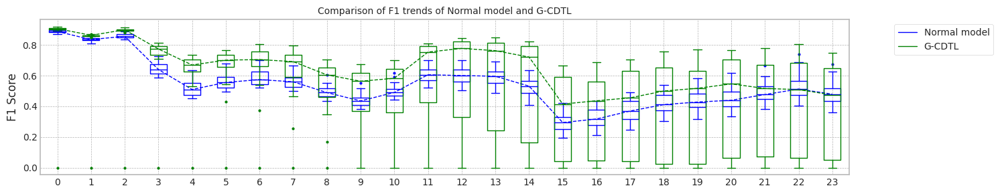

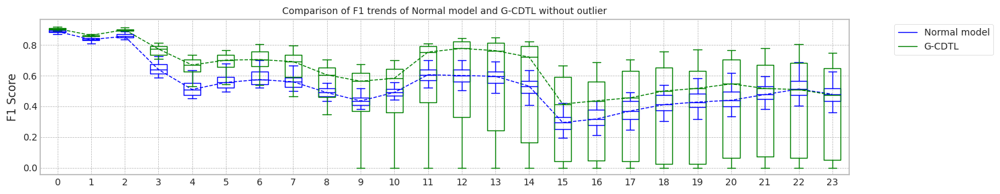

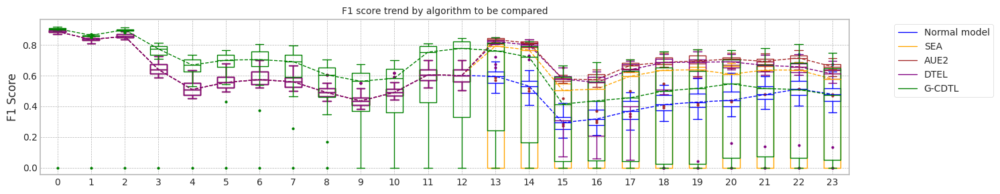

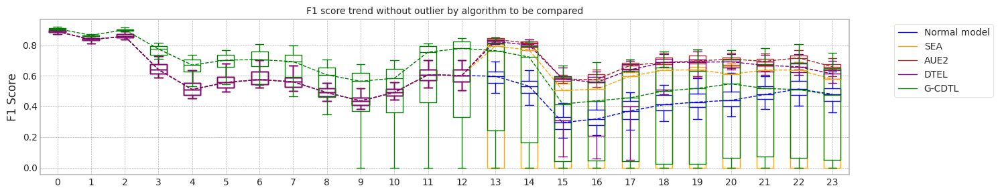

max_mean_trial= 17


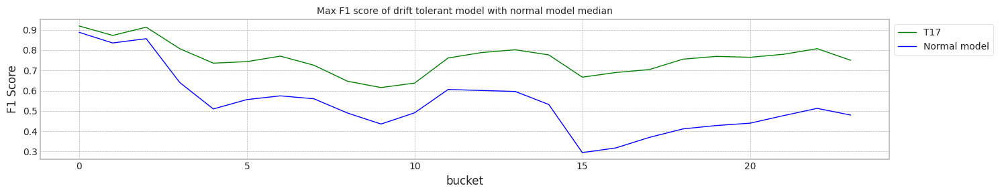

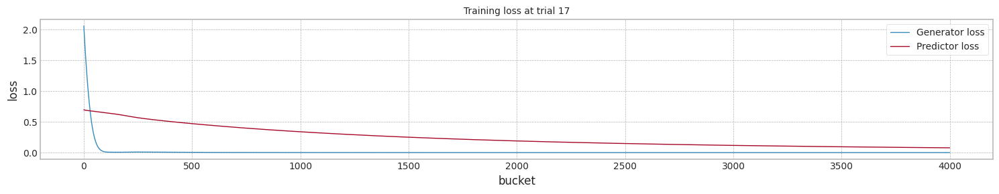

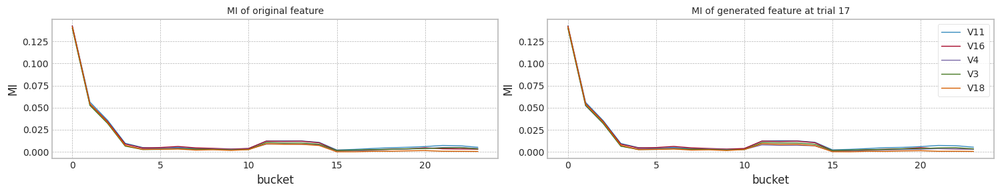

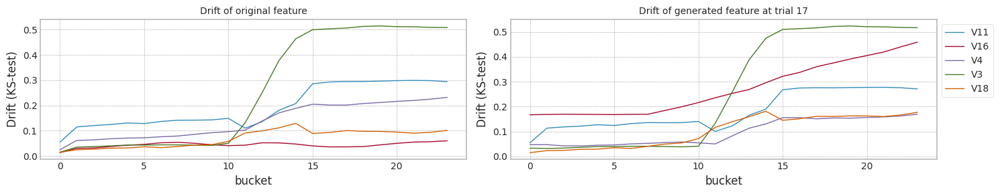

@ Normal model


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.478773,0.402235,21.990515
1,1.0,0.883649,0.836538,0.544424,0.492754,22.072859
2,2.0,0.881264,0.829559,0.501480,0.433735,21.695993
3,3.0,0.887680,0.848411,0.588225,0.545455,21.621090
4,4.0,0.899381,0.856442,0.608225,0.600000,21.699365
5,5.0,0.888804,0.828979,0.496773,0.404624,21.619682
6,6.0,0.882966,0.836538,0.527461,0.480000,21.788623
7,7.0,0.898936,0.834327,0.536314,0.469799,21.891496
8,8.0,0.882285,0.834532,0.547495,0.478873,21.772674
9,9.0,0.888464,0.827995,0.476181,0.402235,21.553158


@ SEA


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.622872,0.602151,24.796597
1,1.0,0.883649,0.836538,0.631206,0.613861,26.366068
2,2.0,0.881264,0.829559,0.320442,0.000000,26.883158
3,3.0,0.887680,0.848411,0.659339,0.622222,26.727025
4,4.0,0.899381,0.856442,0.675086,0.645833,25.724761
5,5.0,0.888804,0.828979,0.626986,0.640000,26.491176
6,6.0,0.882966,0.836538,0.333056,0.000000,26.589833
7,7.0,0.898936,0.834327,0.620995,0.568807,26.790983
8,8.0,0.882285,0.834532,0.365129,0.000000,26.388638
9,9.0,0.888464,0.827995,0.312137,0.000000,26.442418


@ AUE2


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.621589,0.630435,27.190527
1,1.0,0.883649,0.836538,0.658410,0.658824,26.792875
2,2.0,0.881264,0.829559,0.630394,0.642857,27.400304
3,3.0,0.887680,0.848411,0.687734,0.689655,26.668115
4,4.0,0.899381,0.856442,0.691112,0.674419,27.357188
5,5.0,0.888804,0.828979,0.627361,0.630435,27.024213
6,6.0,0.882966,0.836538,0.527563,0.480000,26.956413
7,7.0,0.898936,0.834327,0.535308,0.469799,27.240072
8,8.0,0.882285,0.834532,0.657136,0.674419,26.443192
9,9.0,0.888464,0.827995,0.627199,0.637363,27.024749


@ DTEL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.888804,0.827995,0.375015,0.000000,31.212564
1,1.0,0.883649,0.836538,0.429649,0.135593,31.043606
2,2.0,0.881264,0.829559,0.625542,0.602151,31.822471
3,3.0,0.887680,0.848411,0.666503,0.652174,31.292453
4,4.0,0.899381,0.856442,0.623051,0.600000,31.191338
5,5.0,0.888804,0.828979,0.637849,0.636364,31.477988
6,6.0,0.882966,0.836538,0.647220,0.615385,31.386991
7,7.0,0.898936,0.834327,0.404647,0.000000,31.260353
8,8.0,0.882285,0.834532,0.634391,0.577778,31.172172
9,9.0,0.888464,0.827995,0.567445,0.575000,31.188970


@ G-CDTL


,Trial,Testset F1,Initial F1,Mean F1,Last F1,Elapsed time
0,0.0,0.909301,0.864865,0.235250,0.004341,21.922944
1,1.0,0.908672,0.857837,0.301578,0.022349,21.950316
2,2.0,0.900503,0.864198,0.736616,0.697674,21.987438
3,3.0,0.911402,0.869136,0.667638,0.565657,21.558578
4,4.0,0.913161,0.859585,0.547557,0.390000,21.492231
5,5.0,0.907975,0.861689,0.639705,0.562963,21.682738
6,6.0,0.899729,0.856089,0.485764,0.135593,21.852888
7,7.0,0.913787,0.849879,0.549195,0.406977,22.093802
8,8.0,0.907209,0.865598,0.673959,0.644068,21.680247
9,9.0,0.900155,0.863469,0.382781,0.061493,21.667892


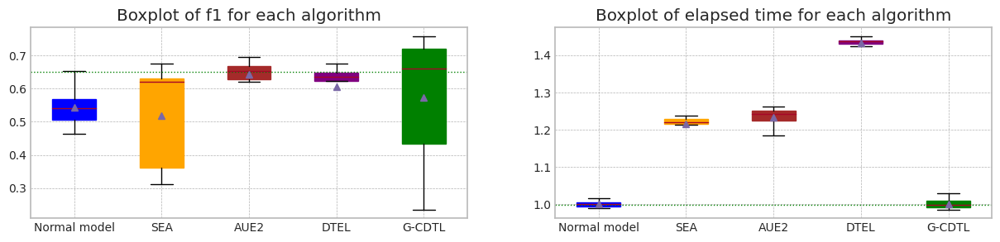

In [ ]:
print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

# class 1이 너무 숫자가 적어서 (unbalanced data) X 20으로 증가 시킨다.
print(X1.shape)
print(Y1.shape)

X2 = X1[0:train_size]
Y2 = Y1[0:train_size]

for idx,(row,yv) in enumerate(zip(X1[0:train_size].values,Y1[0:train_size])):
    if yv == 1:
        #print(idx)
        for j in range(19):
            X2 = pd.concat([X2[0:idx],pd.DataFrame([row],columns=X2.columns), X2[idx:]])
            Y2 = np.insert(Y2,idx,yv)
X1 = pd.concat([X2, X1[train_size:]])
Y1 = np.concatenate((Y2,Y1[train_size:]))

print(X1.shape)
print(Y1.shape)

print('class 1 %:',np.sum(Y1[0:train_size])/train_size * 100)

_,_,_,_,_,_ = drift_tolerant2('CC_B',X1, Y1,train_size, test_size,avaible_range = 1600,lambda_f2=0.8,trial_count=20,lr_g=0.001,weight_init= True)